In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from xgboost import XGBRegressor, plot_importance
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from matplotlib.dates import DateFormatter
pd.options.mode.chained_assignment = None 

In [19]:
def plot_observed_vs_predicted_with_text(y_test, y_pred_test, site, mse, rmse, mae, r2, params, target_col,plot_directory):
    # Plotting the observed vs predicted values for the test set
    plt.figure(figsize=(10, 6))
    plt.plot(pd.to_datetime(y_test.index), y_test, label='Observed', color='blue', linestyle='-')
    plt.plot(pd.to_datetime(y_test.index), y_pred_test, label='Predicted', color='red', linestyle='--')
    plt.xlabel('date')
    plt.ylabel('Value')
    plt.title('Observed vs Predicted '+site)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
    plt.gcf().autofmt_xdate()  # Rotate and align the date labels
    plt.text(0.86, 0.81, f'MSE : {mse:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.76, f'RMSE: {rmse:.3f}', transform=plt.gca().transAxes)
    # plt.text(0.86, 0.71, f'R^2: {r2:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.71, f'MAE: {mae:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.66, f'R^2 : {r2:.3f}', transform=plt.gca().transAxes)
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(plot_directory,f"XGBOOST_{site}_{target_col}_{params}.png"))
    plt.show()
    # plt.savefig(f'./plots/{site}_observed_vs_predicted.png')

def plot_observed_vs_predicted_with_text1(y_test, y_pred_test, site, mse, rmse, mae, r2, params, target_col,plot_directory):
    # Plotting the observed vs predicted values for the test set
    plt.figure(figsize=(10, 6))
    plt.plot(pd.to_datetime(y_test.index), y_test, label='Observed', color='blue', linestyle='-')
    plt.plot(pd.to_datetime(y_test.index), y_pred_test, label='Predicted', color='red', linestyle='--')
    plt.xlabel('date')
    plt.ylabel('Value')
    plt.title('Observed vs Predicted '+site)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    # plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
    plt.gcf().autofmt_xdate()  # Rotate and align the date labels
    plt.text(0.86, 0.81, f'MSE : {mse:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.76, f'RMSE: {rmse:.3f}', transform=plt.gca().transAxes)
    # plt.text(0.86, 0.71, f'R^2: {r2:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.71, f'MAE: {mae:.3f}', transform=plt.gca().transAxes)
    plt.text(0.86, 0.66, f'R^2 : {r2:.3f}', transform=plt.gca().transAxes)
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(plot_directory,f"XGBOOST_{site}_{target_col}_{params}.png"))
    plt.show()
    # plt.savefig(f'./plots/{site}_observed_vs_predicted.png')
def XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory,site, L=3,test_size=0.2):

    # Create lag features for each feature column
    for column in df.columns[:-1]:
        if column not in ['day', 'month', 'latitude', 'longitude', 'elevation', 'canopy_height',
       'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',
       'biom_grasslands', 'winter', 'spring', 'summer', 'fall']:
            # for i in range(1, L + 1):
            # for i in range(0, L):
            for i in range(1, L):
                df[f'{column}_lag_{i}'] = df[column].shift(i)

    # Drop rows with NaNs resulting from lag creation
    df.dropna(inplace=True)

    # Split data into features (X) and target variable (y)
    X = df.reindex(sorted(df.columns), axis=1).drop(columns=[target_col])  # Drop the target column
    # X = df
    y = df[target_col]

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, shuffle=False)

    # Initialize XGBoost model
    model = XGBRegressor(eta=eta,
                            max_depth=max_depth,
                            min_child_weight=min_child_weight,
                            gamma=gamma, 
                            alpha=alpha)

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions on the test set
    y_pred = model.predict(X_test)

    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y_test, y_pred)
    test_r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    # plot_observed_vs_predicted(y_test, y_pred, site)
    plot_observed_vs_predicted_with_text(y_test, y_pred, site, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    return model, X_train, X_test, y_train, y_test, y_pred, mse,rmse,mae, test_r2
def XGBoost_train_test_cont(model,site, df,target_col, L=3,test_size=0.2):

    # Create lag features for each feature column
    for column in df.columns[:-1]:
        if column not in ['day', 'month', 'latitude', 'longitude', 'elevation', 'canopy_height',
       'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',
       'biom_grasslands', 'winter', 'spring', 'summer', 'fall']:
            # for i in range(1, L + 1):
            # for i in range(0, L):
            for i in range(1, L):
                df[f'{column}_lag_{i}'] = df[column].shift(i)

    # Drop rows with NaNs resulting from lag creation
    df.dropna(inplace=True)

    # Split data into features (X) and target variable (y)
    X = df.reindex(sorted(df.columns), axis=1).drop(columns=[target_col])  # Drop the target column
    # X = df
    y = df[target_col]

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, shuffle=False)

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions on the test set
    y_pred = model.predict(X_test)

    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y_test, y_pred)
    test_r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    # plot_observed_vs_predicted(y_test, y_pred, site)
    # plot_observed_vs_predicted_with_text(y_test, y_pred, site, mse, rmse, mape, test_r2)
    return model, X_train, X_test, y_train, y_test, y_pred, mse,rmse,mae, test_r2



In [5]:
directory_insitu = r"input\NETFLUX"
plot_directory = r"plot\XGBOOST_retrain"
directory_input = r"input"
directory_sentinel = r"input\Sentinel"
directory_data = r"input\Preprocessed"
# load list of sites
list_site_file = "list_sites_without_Lonzee.xlsx"
df = pd.read_excel(list_site_file)
df_training = df[df['role']=='training']


In [6]:
# Load the data
# Initialize an empty dataframe to store the results
results = []
files = os.listdir(directory_data)
target_col = 'GPP_DT_VUT_USTAR50'
col2 = ['date','CLr', 'EVI', 'EVI2', 'LSWI',  'MNDVI', 'MNDWI', 'NDII', 'NDVI', 'H_F_MDS', 'LE_F_MDS',  'LW_IN_F', 'PA_F', 'P_F', 'SW_IN_F', 'TA_F', 'VPD_F', 'WS_F', target_col]

In [14]:
def f_importance(model, X_train, site, params, plot_directory):
    importance = model.feature_importances_
    importance_dict = {X_train.columns[i]: importance[i] for i in range(len(X_train.columns))}
    sorted_importance = sorted(importance_dict.items(), key=lambda item: item[1], reverse=True)
    print(sorted_importance)
    # Plot feature importance
    plot_importance(model, max_num_features=15)  # Shows top 10 features
    plt.savefig(os.path.join(plot_directory,f"feature_importance_XGBOOST_{site}_{target_col}_{params}.png"))
    plt.show()
def retrain_XGBOOST(files,columns, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory,params):
    #############################################################################################

    print('First training and testing the model on the first site')
    # Load the data
    filename = files[0]
    data = pd.read_csv(os.path.join(directory_data, filename))   
    site0 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
    f_importance(model_0, X_train_0, site0, params, plot_directory)
    #############################################################################################
    print('Retraining the model on the second site')
    # Load the data
    filename = files[1]
    data = pd.read_csv(os.path.join(directory_data, filename)) 
    site1 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    model_1, X_train_1, X_test_1, y_train_1, y_test_1, y_pred_1, mse_1, rmse_1, mae_1, test_r2_1 = XGBoost_train_test_cont(model_0,site1, df,target_col,L,test_size=0.2)
    f_importance(model_1, X_train_1, site1, params, plot_directory)

    # Retest the model on the first site
    print('Retesting the model on the first site')
    print(site0)
    # Make predictions on the test set
    y_pred = model_1.predict(X_test_0)
    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y_test_0, y_pred)
    test_r2 = r2_score(y_test_0, y_pred)
    mae = mean_absolute_error(y_test_0, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)

    print(site1)
    print('Mean Squared Error:', mse_1)
    print('Root Mean Squared Error:', rmse_1)
    print('MAE:', mae_1)
    print("Test R^2 Score:", test_r2_1)
    plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse_1, rmse_1, mae_1, test_r2_1, params, target_col,plot_directory)
    #############################################################################################
    print('Retraining the model on the third site')

    # Load the data
    filename = files[2]
    data = pd.read_csv(os.path.join(directory_data, filename)) 
    site2 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    model_2, X_train_2, X_test_2, y_train_2, y_test_2, y_pred_2, mse_2, rmse_2, mae_2, test_r2_2 = XGBoost_train_test_cont(model_1,site2, df,target_col,L,test_size=0.2)
    f_importance(model_2, X_train_2, site2, params, plot_directory) 

    # Retest the model on the first and second site
    # Make predictions on the test set
    print(site0)
    y_pred = model_2.predict(X_test_0)
    # Calculate Mean Squared Error (MSE)
    print('Retesting the model on the first and second site')
    mse = mean_squared_error(y_test_0, y_pred)
    test_r2 = r2_score(y_test_0, y_pred)
    mae = mean_absolute_error(y_test_0, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('mae:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)

    print(site1)
    y_pred_1 = model_2.predict(X_test_1)
    mse = mean_squared_error(y_test_1, y_pred_1)
    test_r2 = r2_score(y_test_1, y_pred_1)
    mae = mean_absolute_error(y_test_1, y_pred_1)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, mae, test_r2, params, target_col,plot_directory)

    print(site2)
    print('Mean Squared Error:', mse_2)
    print('Root Mean Squared Error:', rmse_2)
    print('MAE:', mae_2)
    print("Test R^2 Score:", test_r2_2)
    plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse_2, rmse_2, mae_2, test_r2_2, params, target_col,plot_directory)




    #############################################################################################
    print('Retraining the model on the fourth site')

    # Load the data
    filename = files[3]
    data = pd.read_csv(os.path.join(directory_data, filename)) 
    site3 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    mse_list,rmse_list, mae_list ,r2_list = [],[],[],[]
    model_3, X_train_3, X_test_3, y_train_3, y_test_3, y_pred_3, mse_3, rmse_3, mae_3, test_r2_3 = XGBoost_train_test_cont(model_2,site3, df,target_col,L,test_size=0.2)
    f_importance(model_3, X_train_3, site3, params, plot_directory)
    mse_list.append(mse_3)
    rmse_list.append(rmse_3)
    mae_list.append(mae_3)
    r2_list.append(test_r2_3)
    # Retest the model on the first and second site
    # Make predictions on the test set
    print(site0)
    y_pred = model_2.predict(X_test_0)
    # Calculate Mean Squared Error (MSE)
    print('Retesting the model on the first, second, and third site')
    mse = mean_squared_error(y_test_0, y_pred)
    test_r2 = r2_score(y_test_0, y_pred)
    mae = mean_absolute_error(y_test_0, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    # plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2)
    plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)

    print(site1)
    y_pred_1 = model_2.predict(X_test_1)
    mse = mean_squared_error(y_test_1, y_pred_1)
    test_r2 = r2_score(y_test_1, y_pred_1)
    mae = mean_absolute_error(y_test_1, y_pred_1)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    # plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, MAE, test_r2)
    plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)

    print(site2)
    y_pred_2 = model_2.predict(X_test_2)
    mse = mean_squared_error(y_test_2, y_pred_2)
    test_r2 = r2_score(y_test_2, y_pred_2)
    mae = mean_absolute_error(y_test_2, y_pred_2)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    # plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse, rmse, MAE, test_r2)
    plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)

    print(site3)
    print('Mean Squared Error:', mse_3)
    print('Root Mean Squared Error:', rmse_3)
    print('MAE:', mae_3)
    print("Test R^2 Score:", test_r2_3)
    # plot_observed_vs_predicted_with_text(y_test_3, y_pred_3, site3, mse_3, rmse_3, mape_3, test_r2_3)
    plot_observed_vs_predicted_with_text(y_test_3, y_pred_3, site3, mse_3, rmse_3, mae_3, test_r2_3, params, target_col,plot_directory)

    print("average MSE", np.mean(mse_list))     
    print("average RMSE", np.mean(rmse_list))
    print("average MAE", np.mean(mae_list))
    print("average R2", np.mean(r2_list))
    return model_3, X_test_0.columns

In [15]:
def test_predict(model, L, df, columns, target_col, site, plot_directory,params):
    # Create lag features for each feature column
    for column in df.columns[:-1]:
        if column not in ['day', 'month', 'latitude', 'longitude', 'elevation', 'canopy_height',
       'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',
       'biom_grasslands', 'winter', 'spring', 'summer', 'fall']:
            # for i in range(1, L + 1):
            # for i in range(0, L):
            for i in range(1, L):
                df[f'{column}_lag_{i}'] = df[column].shift(i)

    # Drop rows with NaNs resulting from lag creation
    df.dropna(inplace=True)

    # Split data into features (X) and target variable (y)
    X = df.reindex(sorted(df.columns), axis=1).drop(columns=[target_col])  # Drop the target column
    # X = df
    y = df[target_col]

    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    print('Mean Squared Error:', mse)  
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", r2)

    plot_observed_vs_predicted_with_text1(y, y_pred, site, mse, rmse, mae, r2, params, target_col,plot_directory)
    return mse, rmse, mae, r2

def predict_all(model,params,L,column):
    mse_list,rmse_list, mae_list ,r2_list = [],[],[],[]
    data1 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Fontainebleau-Barbeau_preprocessed_01012019_07092023.csv'))
    test1 = data1[column]
    # Assuming 'timestamp' is the index column
    test1['date'] = pd.to_datetime(test1['date'])
    test1.set_index('date', inplace=True)
    mse1, rmse1, mae1, r21 = test_predict(model, L, test1, column, target_col, 'Fontainebleau-Barbeau',plot_directory, params)
    mse_list.append(mse1)
    rmse_list.append(rmse1)
    mae_list.append(mae1)
    r2_list.append(r21)

    data2 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Grillenburg_preprocessed_24042017_28092023.csv'))
    test2 = data2[column]
    # Assuming 'timestamp' is the index column
    test2['date'] = pd.to_datetime(test2['date'])
    test2.set_index('date', inplace=True)
    mse2, rmse2, mae2, r22 = test_predict(model, L, test2, column, target_col, 'Grillenburg',plot_directory, params)
    mse_list.append(mse2)
    rmse_list.append(rmse2)
    mae_list.append(mae2)
    r2_list.append(r22)

    data3 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Klingenberg_preprocessed_01012018_25092023.csv'))
    test3 = data3[column]
    test3['date'] = pd.to_datetime(test3['date'])
    test3.set_index('date', inplace=True)
    mse3, rmse3, mae3, r23 = test_predict(model, L, test3, column, target_col, 'Klingenberg',plot_directory, params)    
    mse_list.append(mse3)
    rmse_list.append(rmse3)
    mae_list.append(mae3)
    r2_list.append(r23)


    data4 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Svartberget_preprocessed_01012019_21102023.csv'))
    test4 = data4[column]
    test4['date'] = pd.to_datetime(test4['date'])   
    test4.set_index('date', inplace=True)   
    mse4, rmse4, mae4, r24 = test_predict(model, L, test4, column, target_col, 'Svartberget',plot_directory, params)
    mse_list.append(mse4)   
    rmse_list.append(rmse4) 
    mae_list.append(mae4) 
    r2_list.append(r24) 

    print("average MSE", np.mean(mse_list))     
    print("average RMSE", np.mean(rmse_list))
    print("average MAE", np.mean(mae_list))
    print("average R2", np.mean(r2_list))

coba 3 sites

In [16]:
def predict_all_3(model,params,L,column):
    mse_list,rmse_list, mae_list ,r2_list = [],[],[],[]
    data1 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Fontainebleau-Barbeau_preprocessed_01012019_07092023.csv'))
    test1 = data1[column]
    # Assuming 'timestamp' is the index column
    test1['date'] = pd.to_datetime(test1['date'])
    test1.set_index('date', inplace=True)
    mse1, rmse1, mae1, r21 = test_predict(model, L, test1, column, target_col, 'Fontainebleau-Barbeau',plot_directory, params)
    mse_list.append(mse1)
    rmse_list.append(rmse1)
    mae_list.append(mae1)
    r2_list.append(r21)

    data2 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Grillenburg_preprocessed_24042017_28092023.csv'))
    test2 = data2[column]
    # Assuming 'timestamp' is the index column
    test2['date'] = pd.to_datetime(test2['date'])
    test2.set_index('date', inplace=True)
    mse2, rmse2, mae2, r22 = test_predict(model, L, test2, column, target_col, 'Grillenburg',plot_directory, params)
    mse_list.append(mse2)
    rmse_list.append(rmse2)
    mae_list.append(mae2)
    r2_list.append(r22)



    data4 = pd.read_csv(os.path.join(directory_data,'testing_sites', 'Svartberget_preprocessed_01012019_21102023.csv'))
    test4 = data4[column]
    test4['date'] = pd.to_datetime(test4['date'])   
    test4.set_index('date', inplace=True)   
    mse4, rmse4, mae4, r24 = test_predict(model, L, test4, column, target_col, 'Svartberget',plot_directory, params)
    mse_list.append(mse4)   
    rmse_list.append(rmse4) 
    mae_list.append(mae4) 
    r2_list.append(r24) 

    print("average MSE", np.mean(mse_list))     
    print("average RMSE", np.mean(rmse_list))
    print("average MAE", np.mean(mae_list))
    print("average R2", np.mean(r2_list))

def retrain_XGBOOST_3(files,columns, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory,params):
    #############################################################################################

    print('First training and testing the model on the first site')
    # Load the data
    filename = files[0]
    data = pd.read_csv(os.path.join(directory_data, filename))   
    site0 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
    f_importance(model_0, X_train_0, site0, params, plot_directory)
    #############################################################################################
    print('Retraining the model on the second site')
    # Load the data
    filename = files[1]
    data = pd.read_csv(os.path.join(directory_data, filename)) 
    site1 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    model_1, X_train_1, X_test_1, y_train_1, y_test_1, y_pred_1, mse_1, rmse_1, mae_1, test_r2_1 = XGBoost_train_test_cont(model_0,site1, df,target_col,L,test_size=0.2)
    f_importance(model_1, X_train_1, site1, params, plot_directory)

    # Retest the model on the first site
    print('Retesting the model on the first site')
    print(site0)
    # Make predictions on the test set
    y_pred = model_1.predict(X_test_0)
    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y_test_0, y_pred)
    test_r2 = r2_score(y_test_0, y_pred)
    mae = mean_absolute_error(y_test_0, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)

    print(site1)
    print('Mean Squared Error:', mse_1)
    print('Root Mean Squared Error:', rmse_1)
    print('MAE:', mae_1)
    print("Test R^2 Score:", test_r2_1)
    plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse_1, rmse_1, mae_1, test_r2_1, params, target_col,plot_directory)
    #############################################################################################
    print('Retraining the model on the third site')

    # Load the data
    filename = files[2]
    data = pd.read_csv(os.path.join(directory_data, filename)) 
    site2 = filename.split('_')[0]
    df = data[columns]
    # Assuming 'timestamp' is the index column
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)
    mse_list,rmse_list, mae_list ,r2_list = [],[],[],[]

    model_2, X_train_2, X_test_2, y_train_2, y_test_2, y_pred_2, mse_2, rmse_2, mae_2, test_r2_2 = XGBoost_train_test_cont(model_1,site2, df,target_col,L,test_size=0.2)
    f_importance(model_2, X_train_2, site2, params, plot_directory) 

    # Retest the model on the first and second site
    # Make predictions on the test set
    print(site0)
    y_pred = model_2.predict(X_test_0)
    # Calculate Mean Squared Error (MSE)
    print('Retesting the model on the first and second site')
    mse = mean_squared_error(y_test_0, y_pred)
    test_r2 = r2_score(y_test_0, y_pred)
    mae = mean_absolute_error(y_test_0, y_pred)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('mae:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)

    print(site1)
    y_pred_1 = model_2.predict(X_test_1)
    mse = mean_squared_error(y_test_1, y_pred_1)
    test_r2 = r2_score(y_test_1, y_pred_1)
    mae = mean_absolute_error(y_test_1, y_pred_1)
    rmse = np.sqrt(mse)
    print('Mean Squared Error:', mse)
    print('Root Mean Squared Error:', rmse)
    print('MAE:', mae)
    print("Test R^2 Score:", test_r2)
    plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)

    print(site2)
    print('Mean Squared Error:', mse_2)
    print('Root Mean Squared Error:', rmse_2)
    print('MAE:', mae_2)
    print("Test R^2 Score:", test_r2_2)
    plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse_2, rmse_2, mae_2, test_r2_2, params, target_col,plot_directory)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mae_list.append(mae)
    r2_list.append(test_r2)




    # #############################################################################################
    # print('Retraining the model on the fourth site')

    # # Load the data
    # filename = files[3]
    # data = pd.read_csv(os.path.join(directory_data, filename)) 
    # site3 = filename.split('_')[0]
    # df = data[columns]
    # # Assuming 'timestamp' is the index column
    # df['date'] = pd.to_datetime(df['date'])
    # df.set_index('date', inplace=True)

    # mse_list,rmse_list, mae_list ,r2_list = [],[],[],[]
    # model_3, X_train_3, X_test_3, y_train_3, y_test_3, y_pred_3, mse_3, rmse_3, mae_3, test_r2_3 = XGBoost_train_test_cont(model_2,site3, df,target_col,L,test_size=0.2)
    # f_importance(model_3, X_train_3, site3, params, plot_directory)
    # mse_list.append(mse_3)
    # rmse_list.append(rmse_3)
    # mae_list.append(mae_3)
    # r2_list.append(test_r2_3)
    # # Retest the model on the first and second site
    # # Make predictions on the test set
    # print(site0)
    # y_pred = model_2.predict(X_test_0)
    # # Calculate Mean Squared Error (MSE)
    # print('Retesting the model on the first, second, and third site')
    # mse = mean_squared_error(y_test_0, y_pred)
    # test_r2 = r2_score(y_test_0, y_pred)
    # mae = mean_absolute_error(y_test_0, y_pred)
    # rmse = np.sqrt(mse)
    # print('Mean Squared Error:', mse)
    # print('Root Mean Squared Error:', rmse)
    # print('MAE:', mae)
    # print("Test R^2 Score:", test_r2)
    # # plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2)
    # plot_observed_vs_predicted_with_text(y_test_0, y_pred, site0, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    
    # mse_list.append(mse)
    # rmse_list.append(rmse)
    # mae_list.append(mae)
    # r2_list.append(test_r2)

    # print(site1)
    # y_pred_1 = model_2.predict(X_test_1)
    # mse = mean_squared_error(y_test_1, y_pred_1)
    # test_r2 = r2_score(y_test_1, y_pred_1)
    # mae = mean_absolute_error(y_test_1, y_pred_1)
    # rmse = np.sqrt(mse)
    # print('Mean Squared Error:', mse)
    # print('Root Mean Squared Error:', rmse)
    # print('MAE:', mae)
    # print("Test R^2 Score:", test_r2)
    # # plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, MAE, test_r2)
    # plot_observed_vs_predicted_with_text(y_test_1, y_pred_1, site1, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    # mse_list.append(mse)
    # rmse_list.append(rmse)
    # mae_list.append(mae)
    # r2_list.append(test_r2)

    # print(site2)
    # y_pred_2 = model_2.predict(X_test_2)
    # mse = mean_squared_error(y_test_2, y_pred_2)
    # test_r2 = r2_score(y_test_2, y_pred_2)
    # mae = mean_absolute_error(y_test_2, y_pred_2)
    # rmse = np.sqrt(mse)
    # print('Mean Squared Error:', mse)
    # print('Root Mean Squared Error:', rmse)
    # print('MAE:', mae)
    # print("Test R^2 Score:", test_r2)
    # # plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse, rmse, MAE, test_r2)
    # plot_observed_vs_predicted_with_text(y_test_2, y_pred_2, site2, mse, rmse, mae, test_r2, params, target_col,plot_directory)
    # mse_list.append(mse)
    # rmse_list.append(rmse)
    # mae_list.append(mae)
    # r2_list.append(test_r2)

    # print(site3)
    # print('Mean Squared Error:', mse_3)
    # print('Root Mean Squared Error:', rmse_3)
    # print('MAE:', mae_3)
    # print("Test R^2 Score:", test_r2_3)
    # # plot_observed_vs_predicted_with_text(y_test_3, y_pred_3, site3, mse_3, rmse_3, mape_3, test_r2_3)
    # plot_observed_vs_predicted_with_text(y_test_3, y_pred_3, site3, mse_3, rmse_3, mae_3, test_r2_3, params, target_col,plot_directory)

    print("average MSE", np.mean(mse_list))     
    print("average RMSE", np.mean(rmse_list))
    print("average MAE", np.mean(mae_list))
    print("average R2", np.mean(r2_list))
    return model_2, X_test_0.columns

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


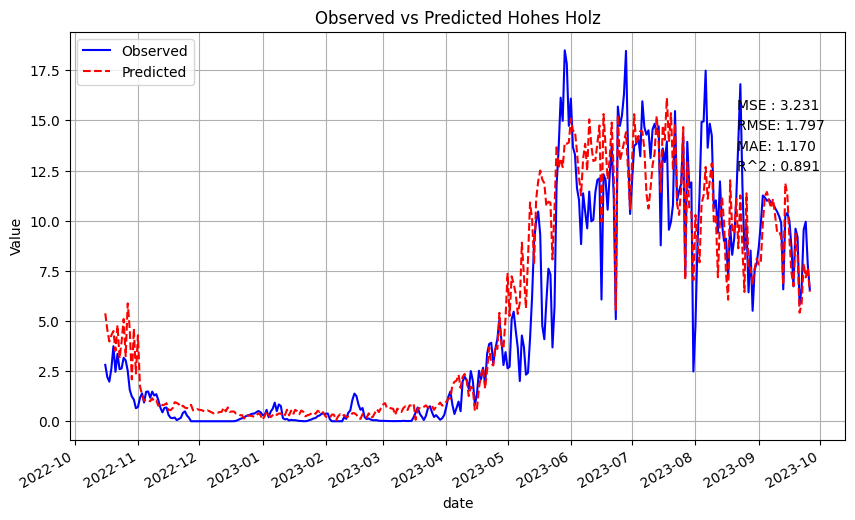

[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802763), ('CLr_lag_3', 0.004137076), ('MNDVI_lag_1', 0.0038376315), ('VPD_F_lag_1', 0.003605907), ('MNDVI_lag_4', 0.0035686286), ('H_F_MDS_lag_2', 0.0035593002), ('LW_IN_F', 0.003524408

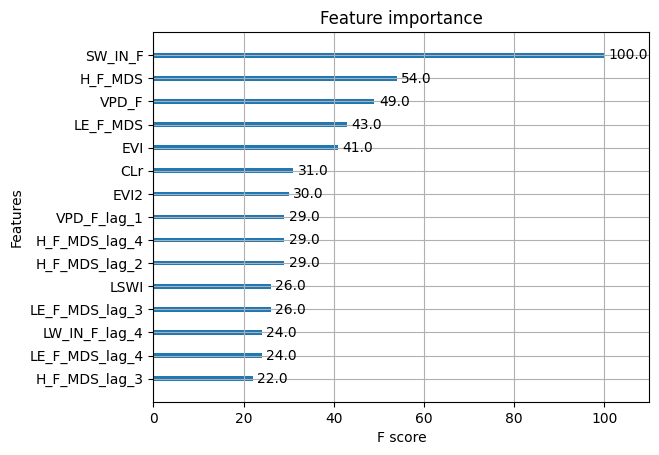

Retraining the model on the second site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675)

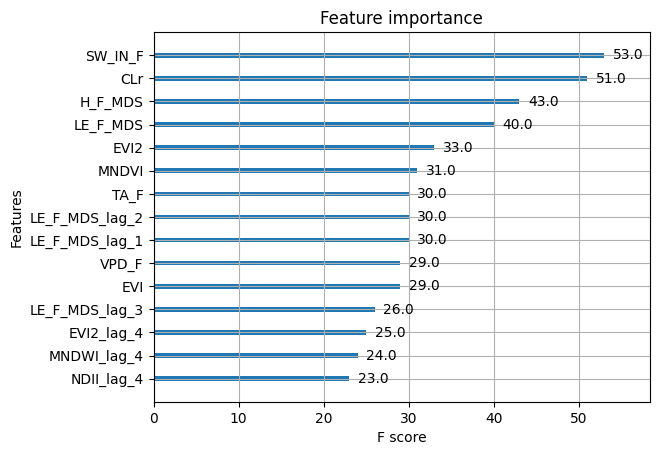

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
MAE: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


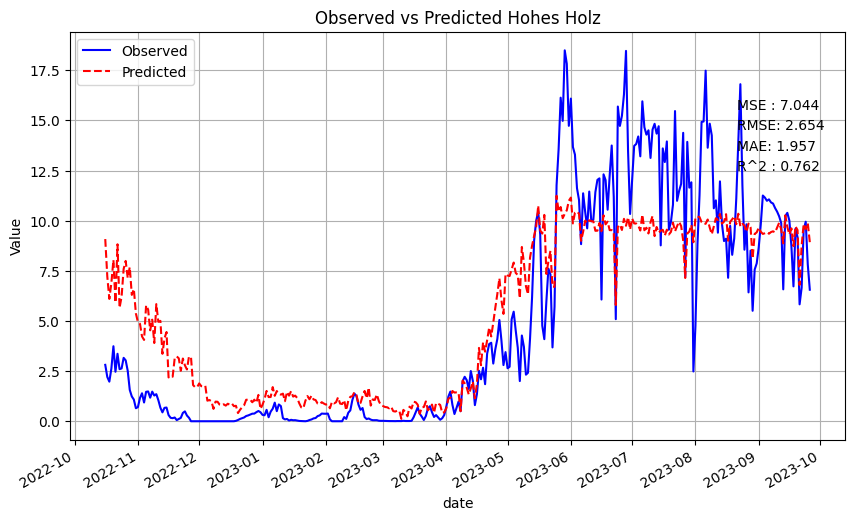

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


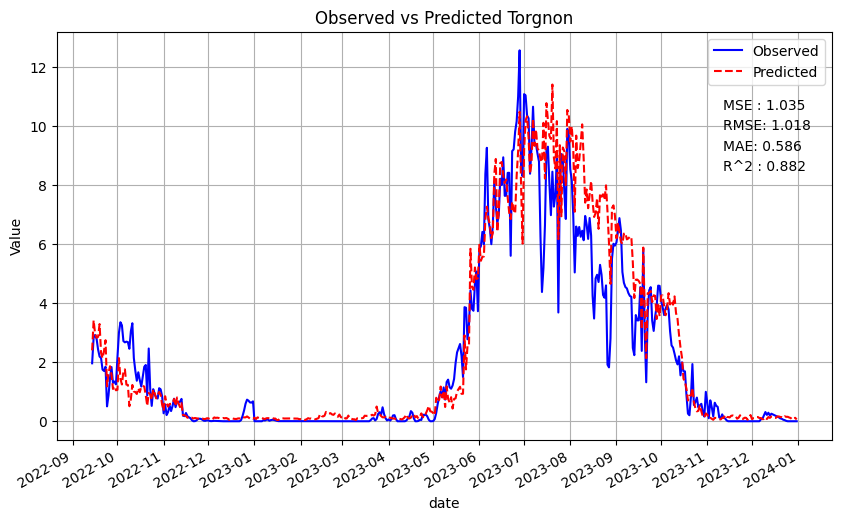

Retraining the model on the third site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.00305

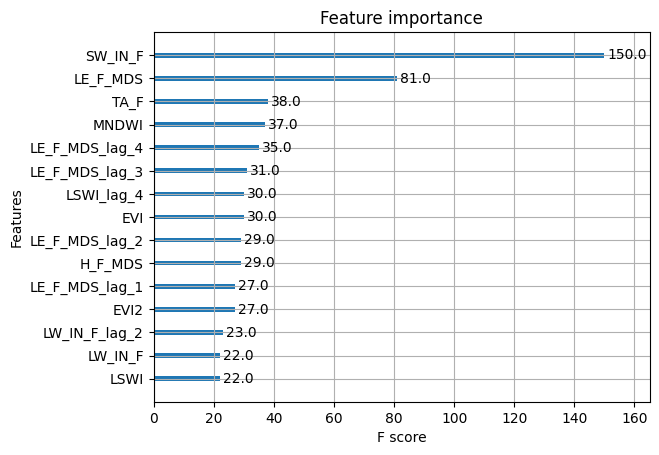

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
mae: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


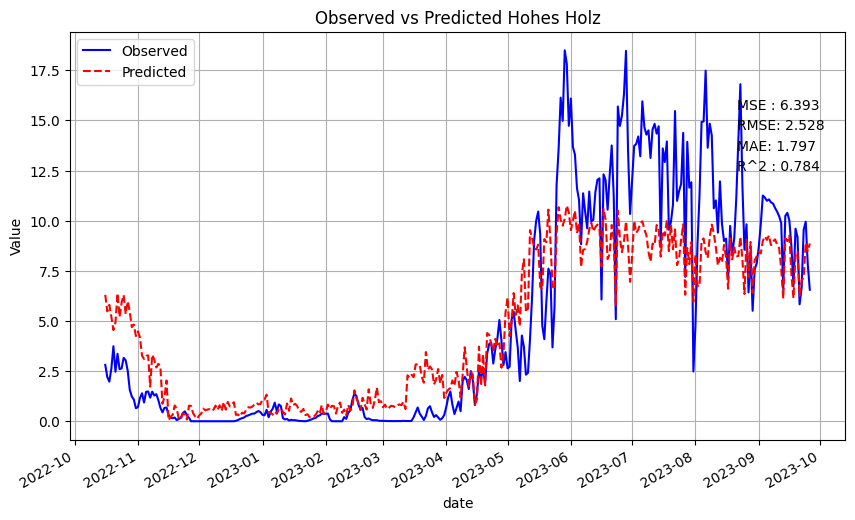

Torgnon
Mean Squared Error: 1.9876067368234545
Root Mean Squared Error: 1.4098250731290938
MAE: 1.077782998667483
Test R^2 Score: 0.7732033722618405


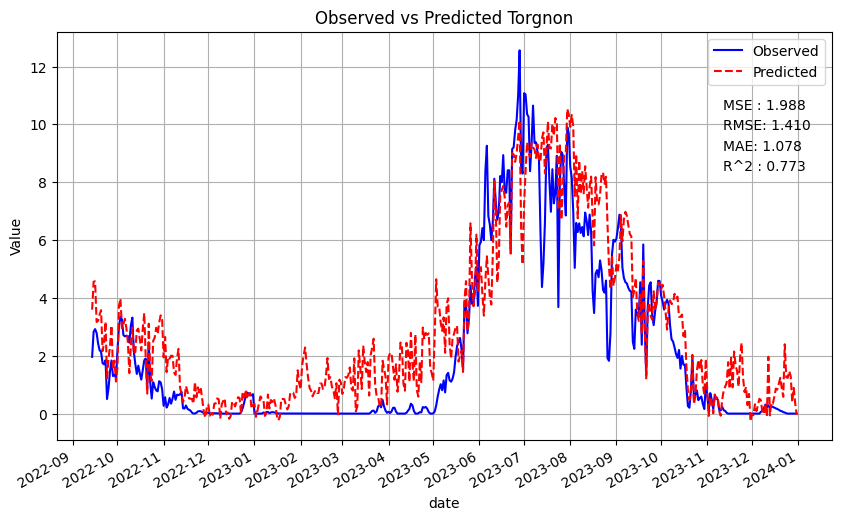

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


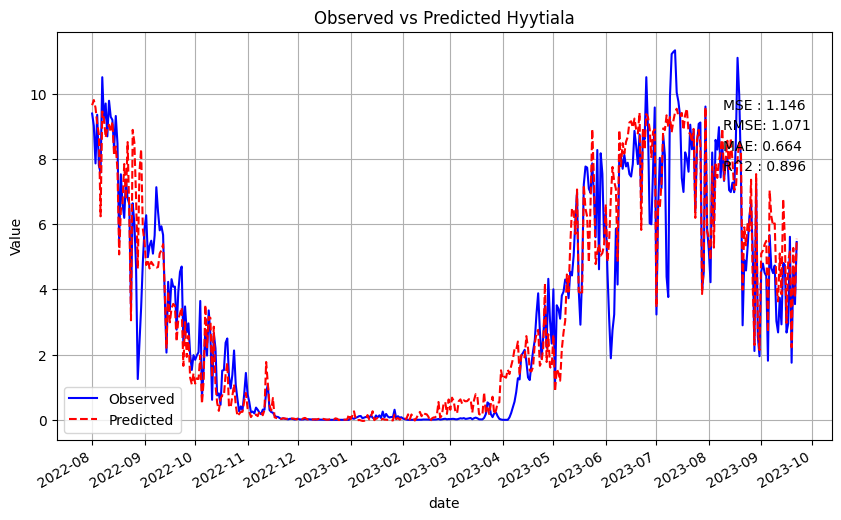

average MSE 3.4560296653842513
average RMSE 1.7826879279332293
average MAE 1.3175953772228775
average R2 0.776810072988655
Mean Squared Error: 5.2195083189560005
Root Mean Squared Error: 2.2846243277519394
MAE: 1.7052134868950815
Test R^2 Score: 0.7529765202824721


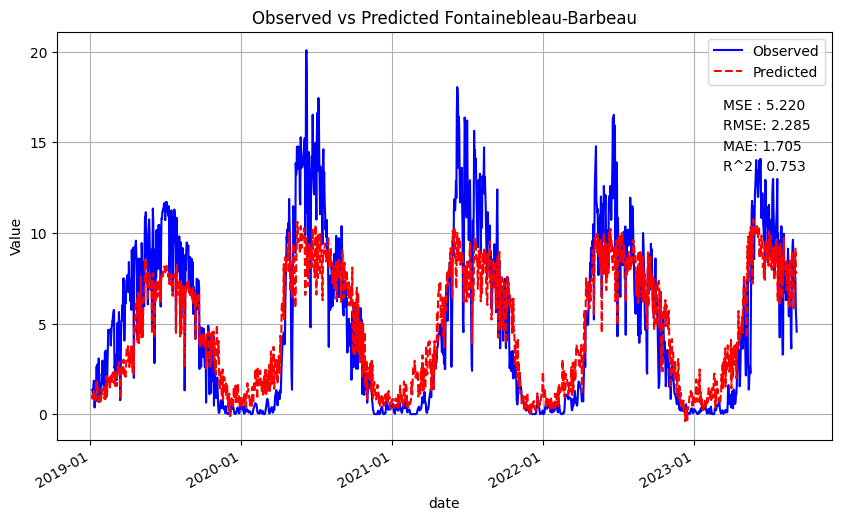

Mean Squared Error: 5.737907885112456
Root Mean Squared Error: 2.3953930544093294
MAE: 1.693880853430192
Test R^2 Score: 0.6171961658290377


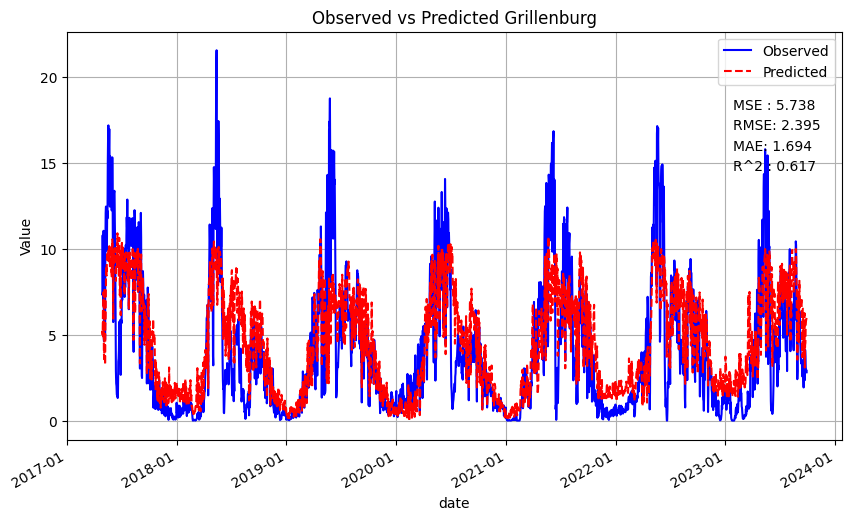

Mean Squared Error: 1.8724242897449048
Root Mean Squared Error: 1.368365554135628
MAE: 0.8839389400033311
Test R^2 Score: 0.842111511583598


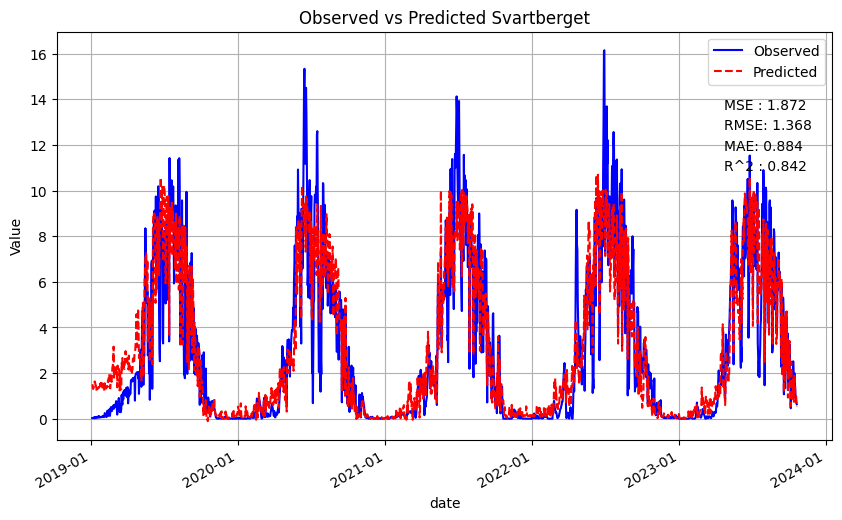

average MSE 4.276613497937787
average RMSE 2.016127645432299
average MAE 1.4276777601095347
average R2 0.7374280658983693


In [20]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST_3(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all_3(model,params,L,column)

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.031081357130977
Root Mean Squared Error: 1.7410001025648956
MAE: 1.1408278184132254
Test R^2 Score: 0.8975981281207066


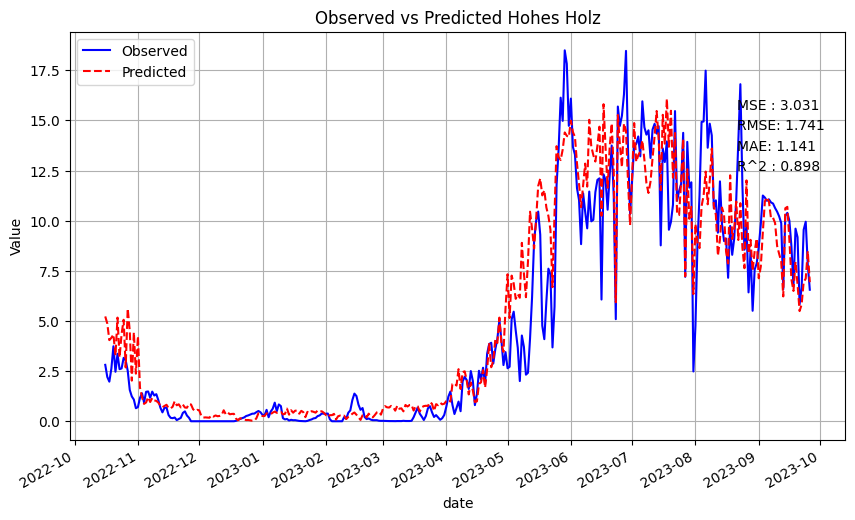

[('LE_F_MDS', 0.43509555), ('EVI2_lag_1', 0.066355385), ('EVI', 0.04445842), ('fall', 0.043572657), ('SW_IN_F', 0.038222708), ('LE_F_MDS_lag_3', 0.029863877), ('LSWI', 0.02845436), ('LE_F_MDS_lag_2', 0.025130989), ('NDII', 0.0141784735), ('EVI2', 0.011771101), ('NDII_lag_2', 0.008401199), ('LSWI_lag_3', 0.008317275), ('H_F_MDS', 0.008097194), ('summer', 0.0073425747), ('spring', 0.0073275957), ('NDII_lag_1', 0.0071020206), ('LE_F_MDS_lag_4', 0.0066276095), ('NDVI_lag_3', 0.0065844767), ('H_F_MDS_lag_3', 0.0063925064), ('VPD_F', 0.0062999483), ('LSWI_lag_1', 0.0062449044), ('EVI_lag_1', 0.005883799), ('LSWI_lag_2', 0.00578594), ('H_F_MDS_lag_4', 0.005693709), ('NDVI_lag_2', 0.005636861), ('NDVI_lag_4', 0.005488703), ('EVI2_lag_2', 0.0052697714), ('NDVI', 0.0052477606), ('EVI2_lag_3', 0.0050696954), ('MNDWI_lag_1', 0.004884129), ('CLr', 0.004739481), ('CLr_lag_2', 0.0046728626), ('NDII_lag_4', 0.0046339217), ('TA_F_lag_2', 0.0044016247), ('MNDVI', 0.004351525), ('MNDVI_lag_1', 0.00422786

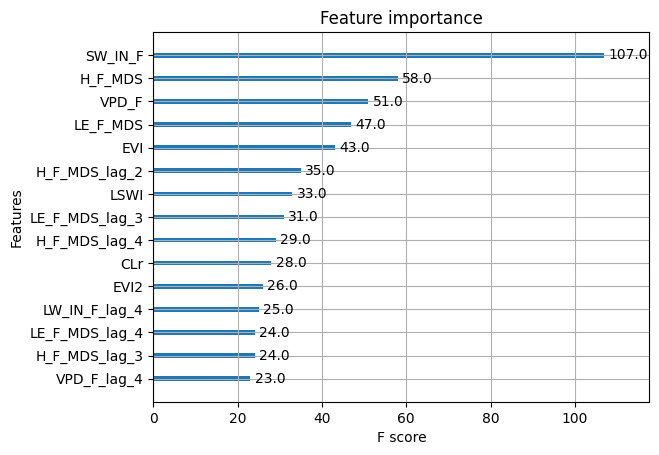

Retraining the model on the second site
Mean Squared Error: 1.0467921994619496
Root Mean Squared Error: 1.0231286329010392
MAE: 0.585763625711768
Test R^2 Score: 0.8805553752750898
[('CLr', 0.50969654), ('LE_F_MDS', 0.09113358), ('MNDVI', 0.028618203), ('MNDVI_lag_1', 0.027077379), ('LE_F_MDS_lag_4', 0.02116374), ('fall', 0.014937773), ('SW_IN_F', 0.013907312), ('EVI', 0.01188406), ('NDVI_lag_1', 0.011584234), ('NDVI_lag_4', 0.010376034), ('MNDWI_lag_2', 0.010056663), ('NDII_lag_2', 0.009485113), ('CLr_lag_4', 0.009445069), ('MNDVI_lag_4', 0.009224699), ('EVI2', 0.009162926), ('CLr_lag_1', 0.008744412), ('MNDWI_lag_1', 0.007952242), ('NDVI', 0.0071098306), ('EVI2_lag_2', 0.0064940634), ('P_F_lag_3', 0.006394811), ('H_F_MDS', 0.0063626827), ('MNDWI', 0.00612918), ('TA_F', 0.005797764), ('PA_F_lag_2', 0.005793946), ('NDII', 0.0055356803), ('LSWI_lag_3', 0.0051717726), ('LE_F_MDS_lag_1', 0.0051214993), ('SW_IN_F_lag_3', 0.0046625077), ('LSWI_lag_1', 0.0046152077), ('PA_F', 0.0045619486), 

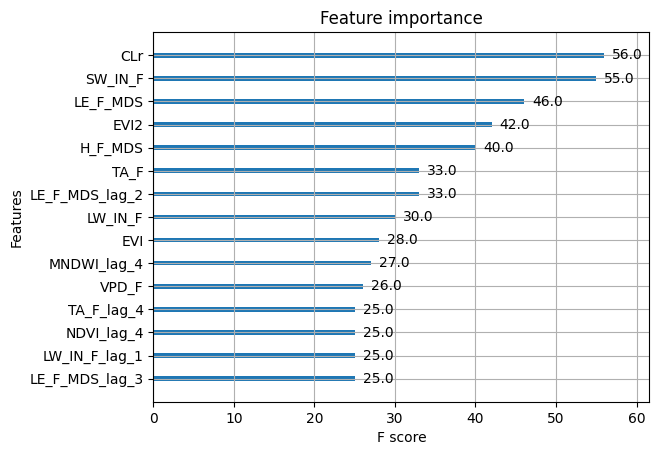

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 7.101066618182018
Root Mean Squared Error: 2.664782658713843
MAE: 1.9962989778078708
Test R^2 Score: 0.7600979886829278


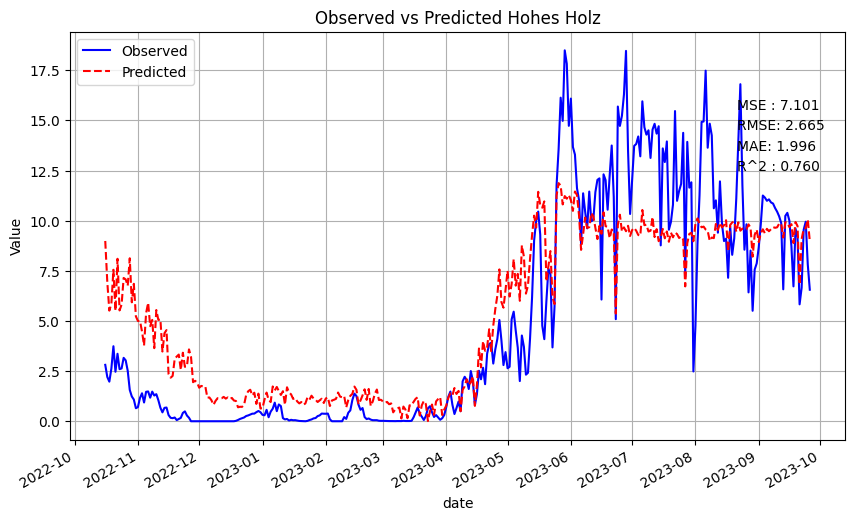

Torgnon
Mean Squared Error: 1.0467921994619496
Root Mean Squared Error: 1.0231286329010392
MAE: 0.585763625711768
Test R^2 Score: 0.8805553752750898


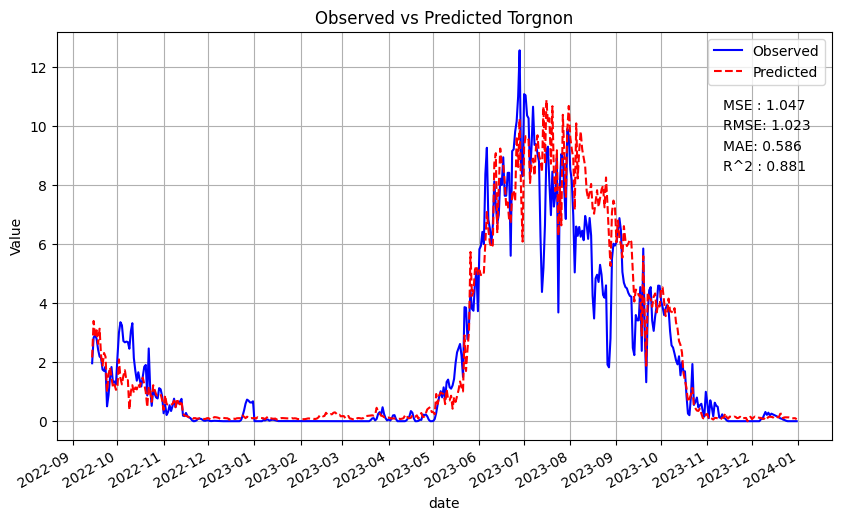

Retraining the model on the third site
Mean Squared Error: 1.1344391287770847
Root Mean Squared Error: 1.0651005251980137
MAE: 0.6615034832163347
Test R^2 Score: 0.8973302095102618
[('TA_F', 0.35670227), ('TA_F_lag_1', 0.17475922), ('summer', 0.08497182), ('TA_F_lag_4', 0.054991674), ('MNDVI', 0.03772882), ('SW_IN_F', 0.031178951), ('LE_F_MDS', 0.025257343), ('TA_F_lag_2', 0.024571747), ('TA_F_lag_3', 0.020874334), ('CLr_lag_4', 0.01654706), ('VPD_F', 0.012679953), ('CLr_lag_3', 0.0115252165), ('CLr_lag_2', 0.007676596), ('LSWI', 0.0058067883), ('SW_IN_F_lag_4', 0.005239786), ('LSWI_lag_4', 0.0047899634), ('NDVI_lag_1', 0.0046468694), ('MNDWI', 0.0045256815), ('CLr_lag_1', 0.004245012), ('EVI', 0.0040784967), ('CLr', 0.003546477), ('LE_F_MDS_lag_4', 0.003429091), ('EVI_lag_2', 0.0033716513), ('EVI2', 0.0032999334), ('H_F_MDS', 0.0032789789), ('LE_F_MDS_lag_2', 0.0032717113), ('LSWI_lag_3', 0.0032119076), ('NDVI_lag_2', 0.0031987089), ('LW_IN_F_lag_2', 0.0031312727), ('fall', 0.00312231

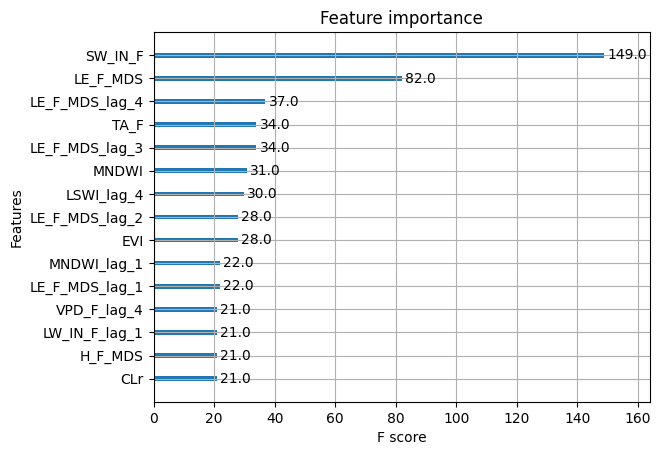

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 7.618491357356511
Root Mean Squared Error: 2.7601614730585076
mae: 1.9845113892349644
Test R^2 Score: 0.7426173421395846


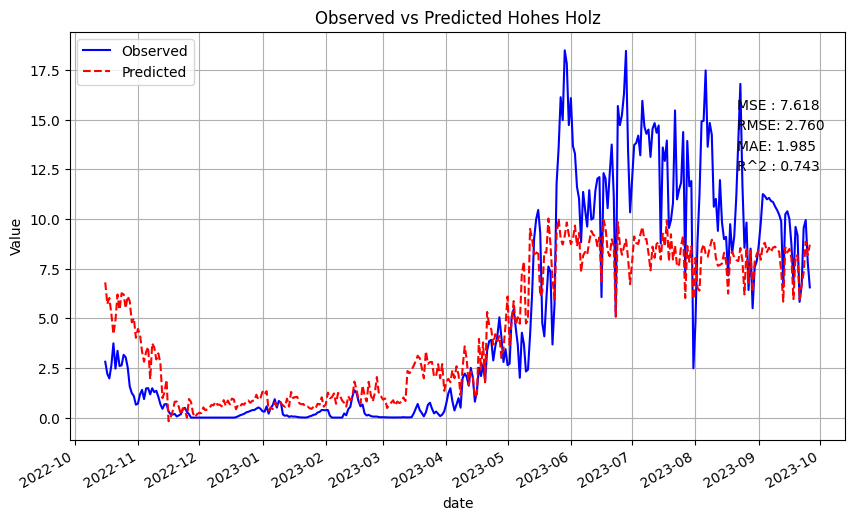

Torgnon
Mean Squared Error: 1.968742905699051
Root Mean Squared Error: 1.4031189919957079
MAE: 1.093498898046552
Test R^2 Score: 0.7753558369350455


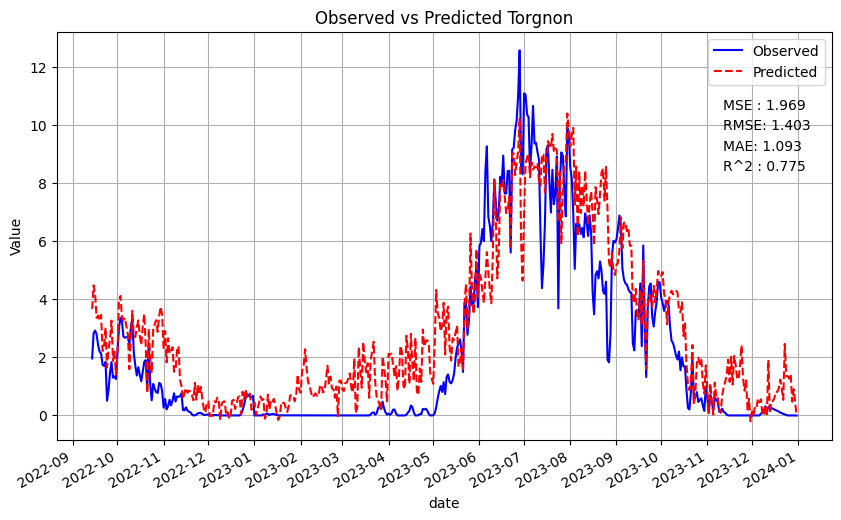

Hyytiala
Mean Squared Error: 1.1344391287770847
Root Mean Squared Error: 1.0651005251980137
MAE: 0.6615034832163347
Test R^2 Score: 0.8973302095102618


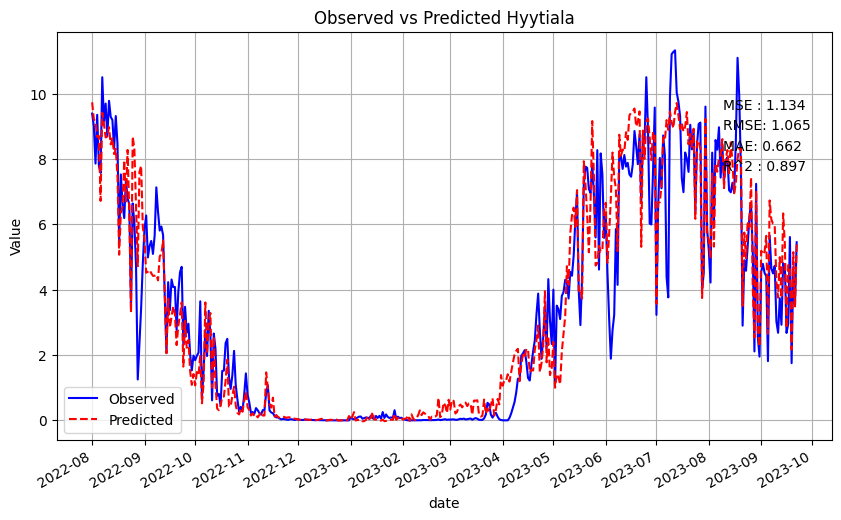

average MSE 3.8519923895848707
average RMSE 1.8554664856833079
average MAE 1.390503061776023
average R2 0.7644430053365586
Mean Squared Error: 5.8795590511280444
Root Mean Squared Error: 2.4247802067668
MAE: 1.8230084631321313
Test R^2 Score: 0.7217383233704968


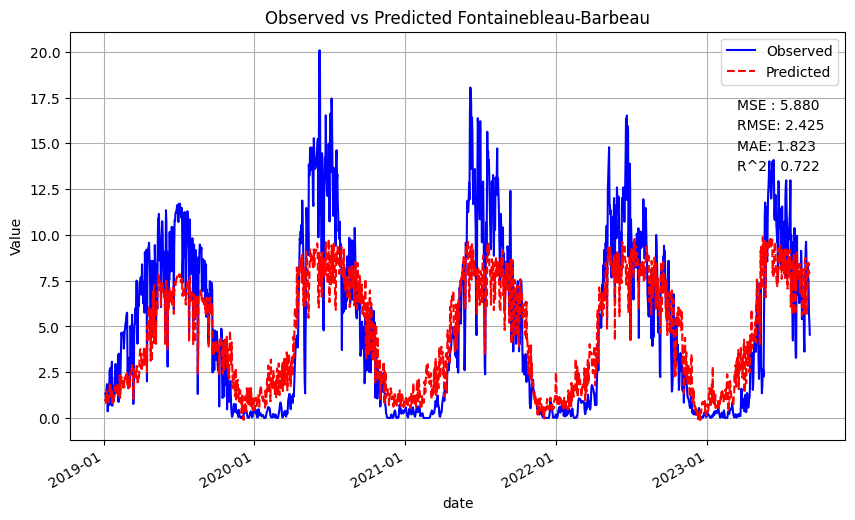

Mean Squared Error: 6.099521080360425
Root Mean Squared Error: 2.469720850695565
MAE: 1.7876242181708772
Test R^2 Score: 0.593071185017321


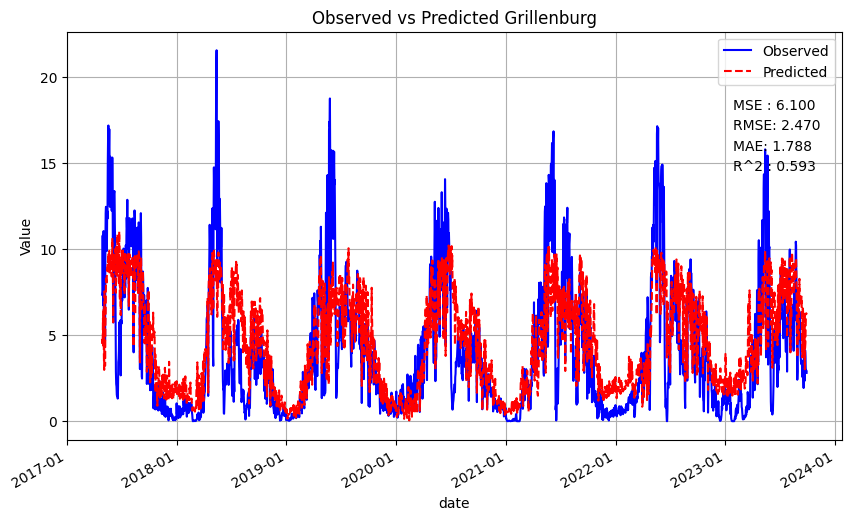

Mean Squared Error: 1.8342194955551478
Root Mean Squared Error: 1.3543335983261835
MAE: 0.8614157717399479
Test R^2 Score: 0.8453330555669344


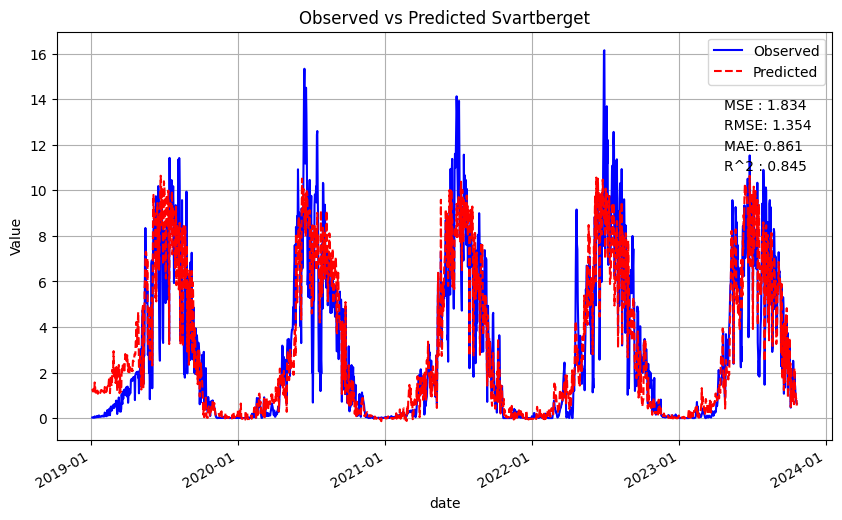

average MSE 4.604433209014539
average RMSE 2.0829448852628496
average MAE 1.4906828176809854
average R2 0.7200475213182508


In [21]:
col_general = ['date',
        
        'latitude',
 'longitude',
 'elevation',
 'canopy_height',
 'instrument_height',
 'biom_croplands',
 'biom_dbf',
 'biom_enf',
 'biom_grasslands',
 'winter',
 'spring',
 'summer',
 'fall','CLr', 'EVI', 'EVI2', 'LSWI',  'MNDVI', 'MNDWI', 'NDII', 'NDVI', 'H_F_MDS', 'LE_F_MDS',  'LW_IN_F', 'PA_F', 'P_F', 'SW_IN_F', 'TA_F', 'VPD_F', 'WS_F', target_col]
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col_general
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST_3(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all_3(model,params,L,column)

coba klo satu model aja

In [14]:
directory_data

'input\\Preprocessed'

Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


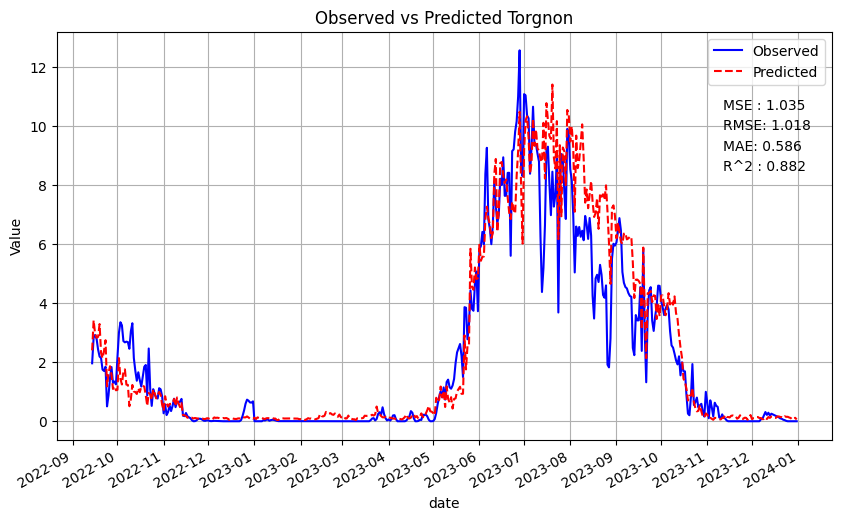

[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675), ('LE_F_MDS_lag_1', 0.0039296094), ('LE_F_MDS_lag_3', 0.003664046), ('NDVI_lag_2', 0.0036306973), ('TA_F_lag_3', 0.0036025718), ('MNDVI_lag_2', 0.0035057212), ('LW_IN_F_lag_1', 0.00

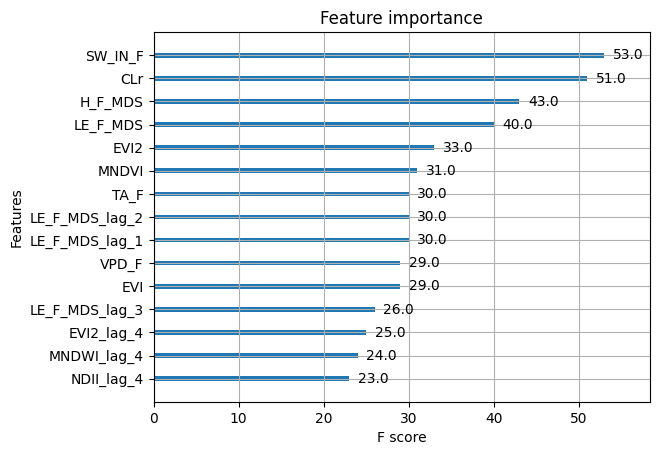

Mean Squared Error: 7.010887217546346
Root Mean Squared Error: 2.6478080023948762
MAE: 2.169188281177406
Test R^2 Score: 0.6681959965279184


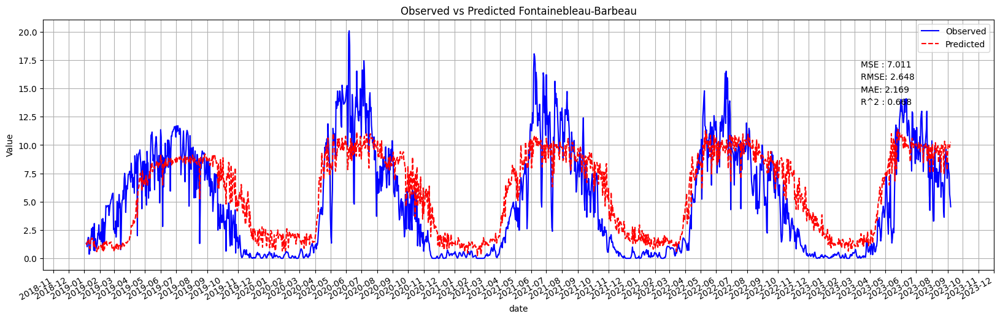

Mean Squared Error: 7.964564135762367
Root Mean Squared Error: 2.822155937534701
MAE: 2.243109424285924
Test R^2 Score: 0.46864506197791334


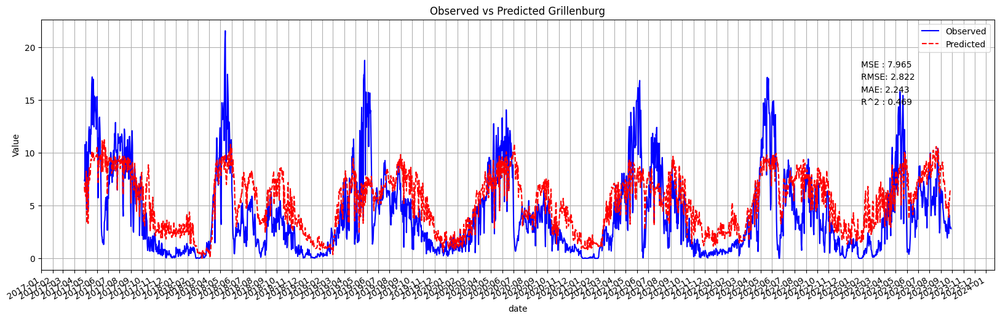

Mean Squared Error: 6.932499642925979
Root Mean Squared Error: 2.632964041327944
MAE: 1.6707181600318461
Test R^2 Score: 0.6136343769565649


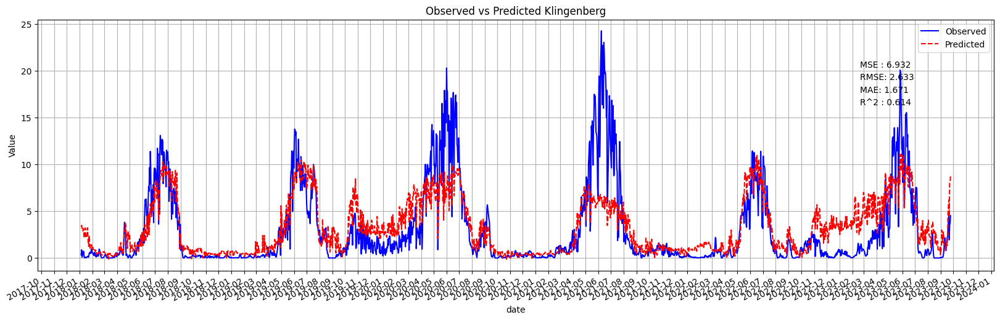

Mean Squared Error: 11.050387002417414
Root Mean Squared Error: 3.3242122378719166
MAE: 2.9661880328847645
Test R^2 Score: 0.06819789201429383


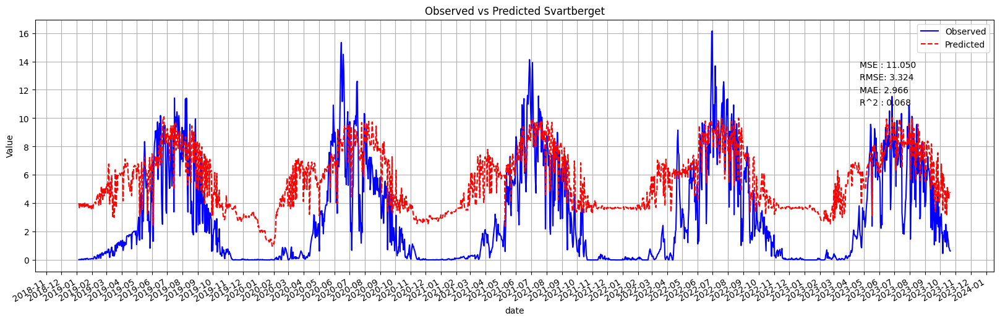

average MSE 8.239584499663026
average RMSE 2.85678505478236
average MAE 2.2623009745949854
average R2 0.4546683318691726


In [16]:
filename = 'Torgnon_preprocessed_06072017_31122023.csv'
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1
# Load the data
params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
data = pd.read_csv(os.path.join(directory_data, filename))   
site0 = filename.split('_')[0]
df = data[column]
# Assuming 'timestamp' is the index column
df['date'] = pd.to_datetime(df['date'])
df.set_index('date', inplace=True)
model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
f_importance(model_0, X_train_0, site0, params, plot_directory)
predict_all(model_0,params,L,col2)

Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


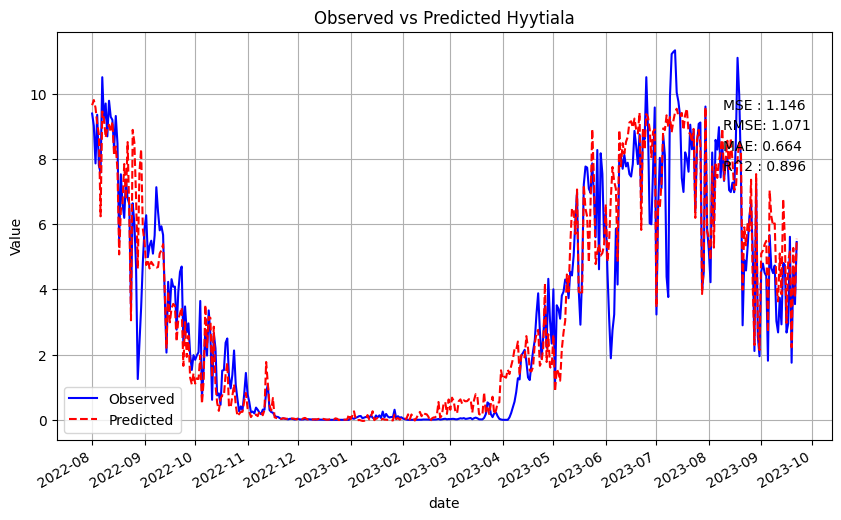

[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.0030569758), ('EVI_lag_4', 0.003034627), ('MNDWI_lag_2', 0.0029975902), ('NDVI_lag_4', 0.0027935465), ('LE_F_MDS_lag_1', 0.0027576576), ('EVI_lag_1', 0.002674856), ('NDII_lag_2', 0.00265

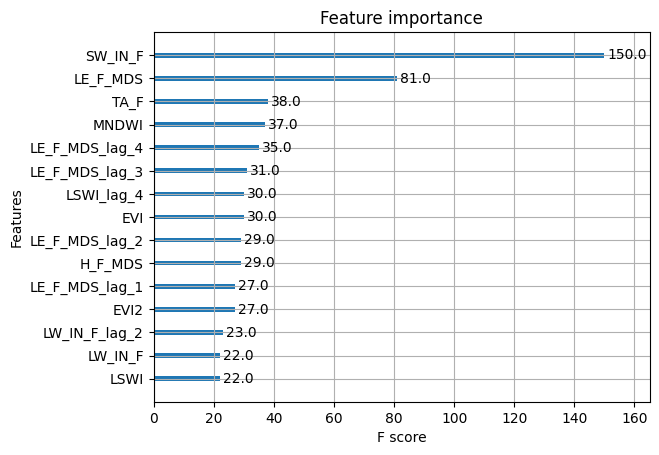

Mean Squared Error: 5.2195083189560005
Root Mean Squared Error: 2.2846243277519394
MAE: 1.7052134868950815
Test R^2 Score: 0.7529765202824721


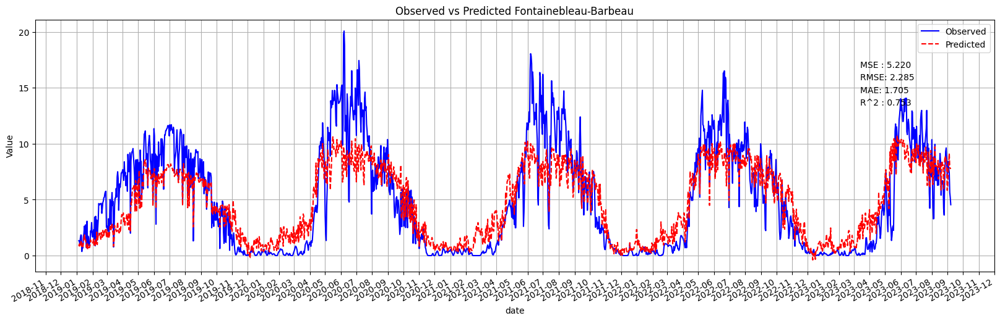

Mean Squared Error: 5.737907885112456
Root Mean Squared Error: 2.3953930544093294
MAE: 1.693880853430192
Test R^2 Score: 0.6171961658290377


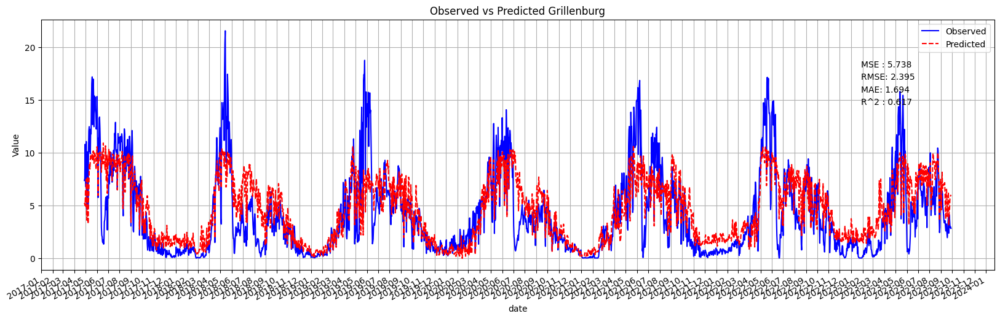

Mean Squared Error: 8.980963341236599
Root Mean Squared Error: 2.996825544010962
MAE: 2.134626296332218
Test R^2 Score: 0.4994683482734975


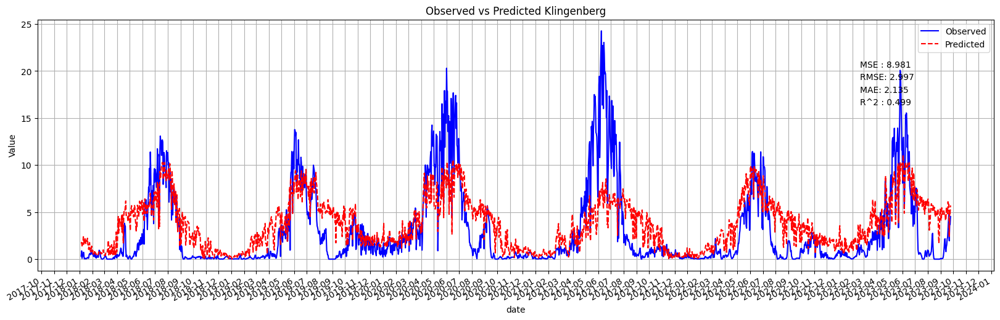

Mean Squared Error: 1.8724242897449048
Root Mean Squared Error: 1.368365554135628
MAE: 0.8839389400033311
Test R^2 Score: 0.842111511583598


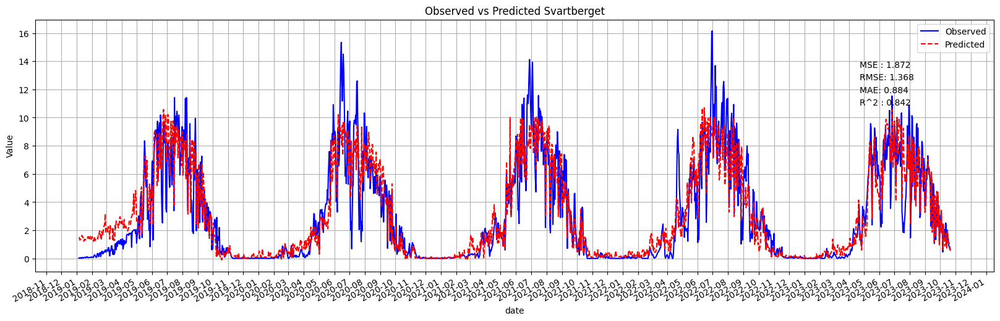

average MSE 5.45270095876249
average RMSE 2.261302120076965
average MAE 1.6044148941652057
average R2 0.6779381364921513


In [17]:
filename = 'Hyytiala_preprocessed_01012018_22092023.csv'
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1
# Load the data
params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
data = pd.read_csv(os.path.join(directory_data, filename))   
site0 = filename.split('_')[0]
df = data[column]
# Assuming 'timestamp' is the index column
df['date'] = pd.to_datetime(df['date'])
df.set_index('date', inplace=True)
model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
f_importance(model_0, X_train_0, site0, params, plot_directory)
predict_all(model_0,params,L,col2)

Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


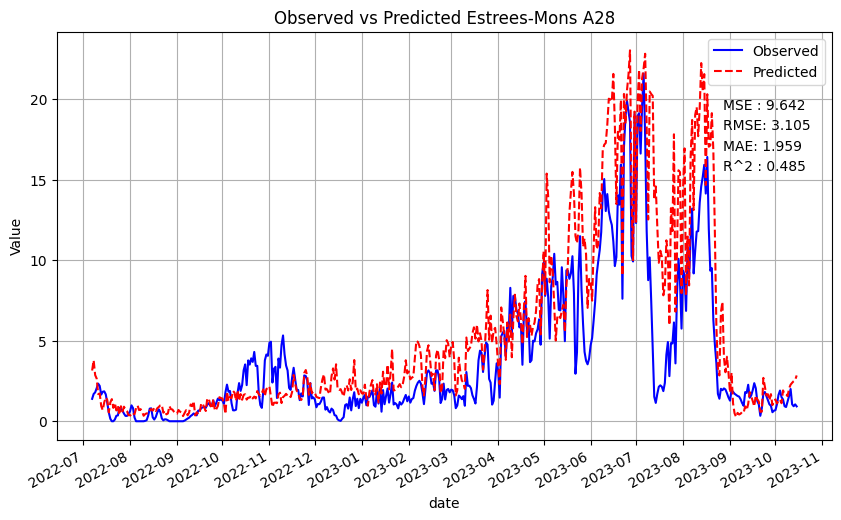

[('LE_F_MDS', 0.30837235), ('MNDVI', 0.1285871), ('MNDVI_lag_2', 0.026809068), ('LE_F_MDS_lag_2', 0.025664987), ('LE_F_MDS_lag_1', 0.025533214), ('MNDVI_lag_1', 0.024662469), ('MNDWI_lag_2', 0.024579242), ('LE_F_MDS_lag_3', 0.01966997), ('MNDWI', 0.015823487), ('EVI2', 0.013936798), ('EVI2_lag_4', 0.013723886), ('CLr_lag_2', 0.013663443), ('NDII_lag_1', 0.013500438), ('SW_IN_F', 0.013464811), ('CLr', 0.012967375), ('H_F_MDS_lag_2', 0.01279354), ('SW_IN_F_lag_2', 0.01272974), ('NDII', 0.0126902545), ('CLr_lag_4', 0.011405543), ('TA_F_lag_2', 0.011063257), ('TA_F_lag_3', 0.009907789), ('H_F_MDS_lag_3', 0.009108452), ('LE_F_MDS_lag_4', 0.008946519), ('LSWI_lag_2', 0.008938457), ('MNDWI_lag_4', 0.008272043), ('CLr_lag_3', 0.008150633), ('NDVI_lag_3', 0.0079636), ('H_F_MDS_lag_4', 0.007940694), ('CLr_lag_1', 0.006987298), ('LW_IN_F', 0.0065393858), ('LW_IN_F_lag_3', 0.0061915186), ('EVI2_lag_1', 0.006149974), ('NDII_lag_2', 0.00602621), ('NDVI', 0.0055614747), ('MNDWI_lag_3', 0.0054917517),

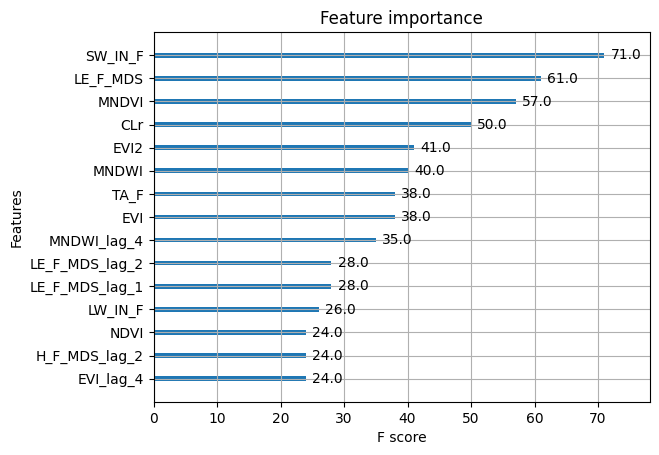

Mean Squared Error: 7.175162585699337
Root Mean Squared Error: 2.678649395814864
MAE: 1.9131615220478682
Test R^2 Score: 0.6604213421748151


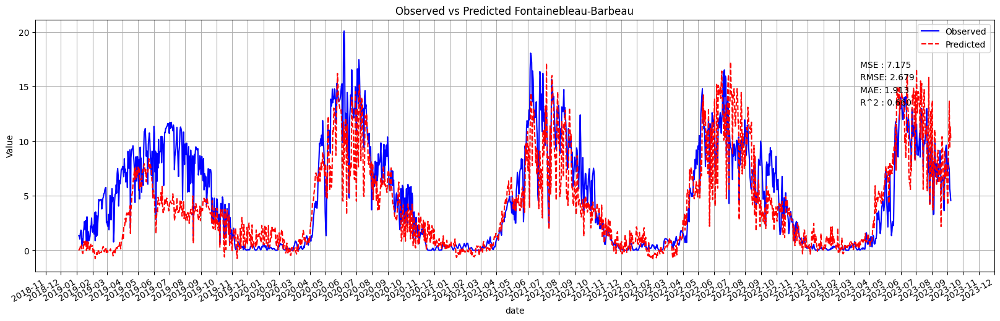

Mean Squared Error: 9.26160410031285
Root Mean Squared Error: 3.043288369562249
MAE: 2.057447317519474
Test R^2 Score: 0.38211319680260425


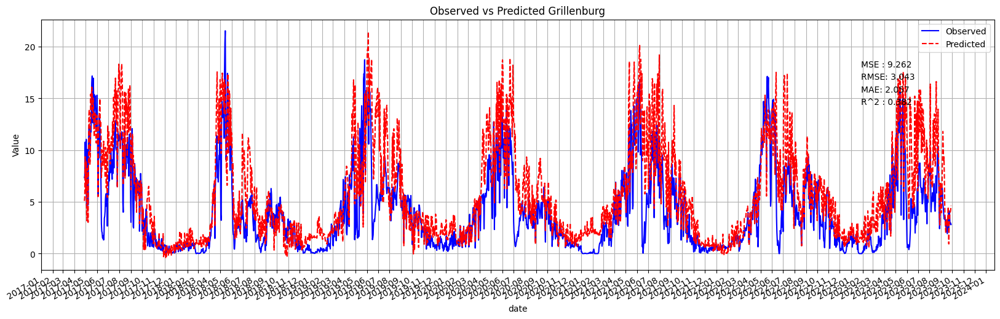

Mean Squared Error: 4.85189855818361
Root Mean Squared Error: 2.202702557810203
MAE: 1.4370204335371695
Test R^2 Score: 0.7295915029308324


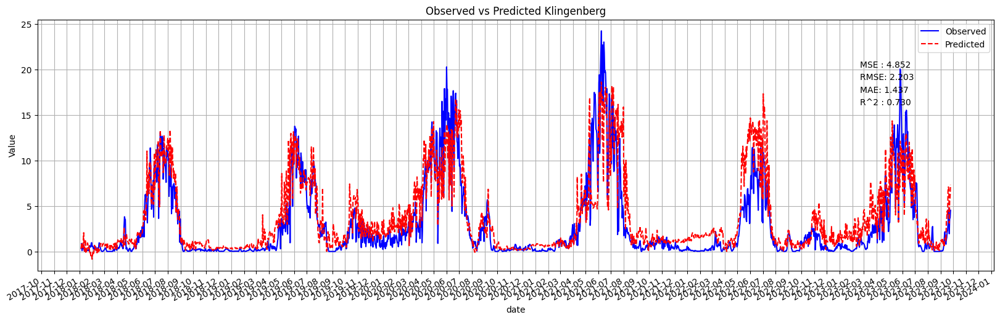

Mean Squared Error: 7.8654617796036685
Root Mean Squared Error: 2.8045430607504795
MAE: 2.307363446358672
Test R^2 Score: 0.3367604351854486


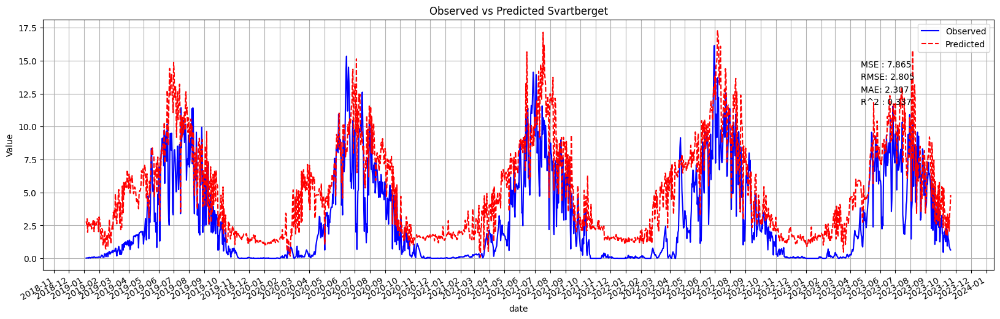

average MSE 7.288531755949867
average RMSE 2.682295845984449
average MAE 1.9287481798657957
average R2 0.5272216192734251


In [18]:
filename = 'Estrees-Mons A28_preprocessed_26052017_15102023.csv'
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1
# Load the data
params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
data = pd.read_csv(os.path.join(directory_data, filename))   
site0 = filename.split('_')[0]
df = data[column]
# Assuming 'timestamp' is the index column
df['date'] = pd.to_datetime(df['date'])
df.set_index('date', inplace=True)
model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
f_importance(model_0, X_train_0, site0, params, plot_directory)
predict_all(model_0,params,L,col2)

Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


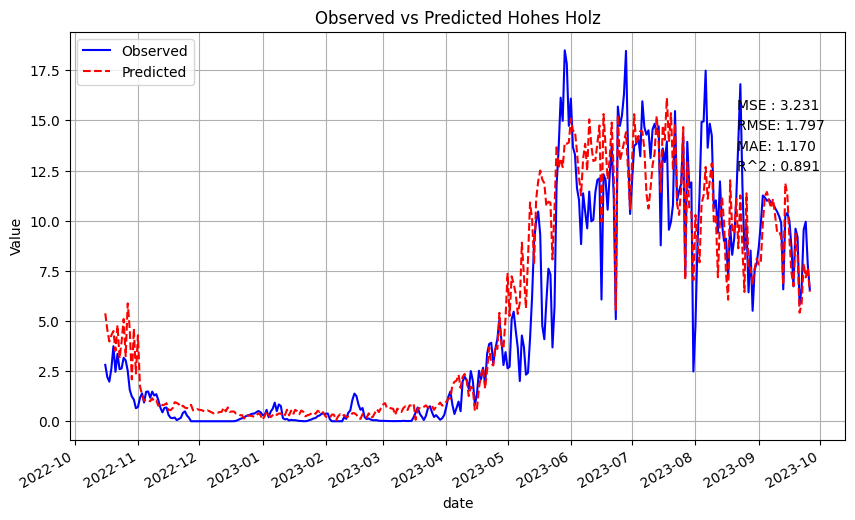

[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802763), ('CLr_lag_3', 0.004137076), ('MNDVI_lag_1', 0.0038376315), ('VPD_F_lag_1', 0.003605907), ('MNDVI_lag_4', 0.0035686286), ('H_F_MDS_lag_2', 0.0035593002), ('LW_IN_F', 0.003524408

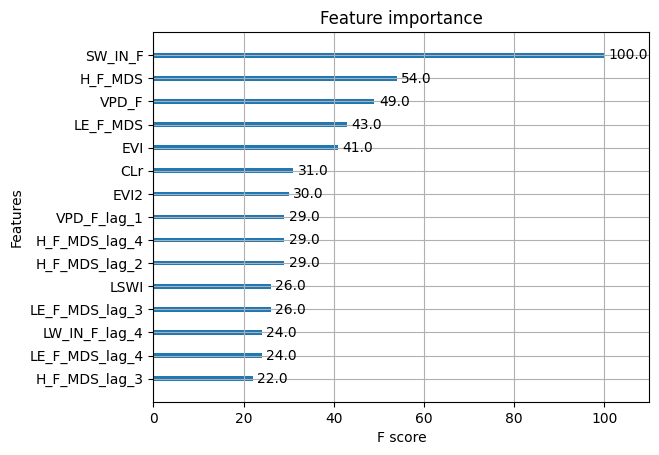

Mean Squared Error: 6.5521343604239695
Root Mean Squared Error: 2.5597137262639293
MAE: 1.7850032643869769
Test R^2 Score: 0.6899073762540827


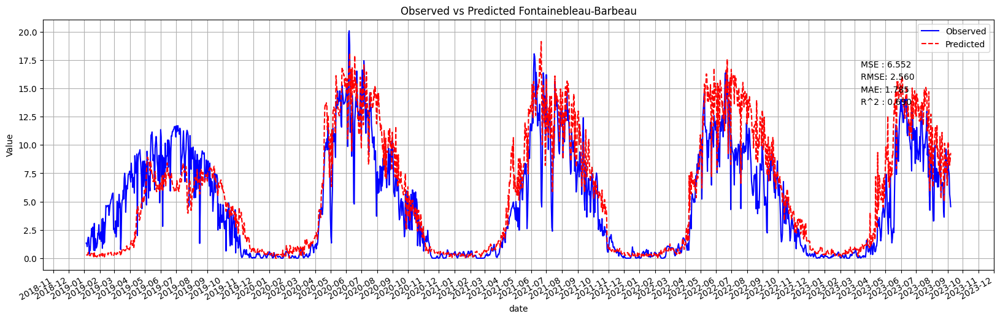

Mean Squared Error: 12.567412422995078
Root Mean Squared Error: 3.5450546431606775
MAE: 2.777539653970349
Test R^2 Score: 0.16156659230927795


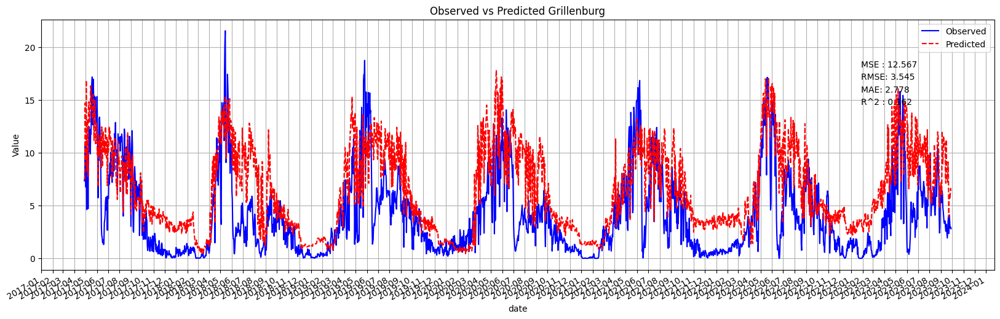

Mean Squared Error: 15.108933619113287
Root Mean Squared Error: 3.887021175542177
MAE: 2.776888946323226
Test R^2 Score: 0.15794116812867787


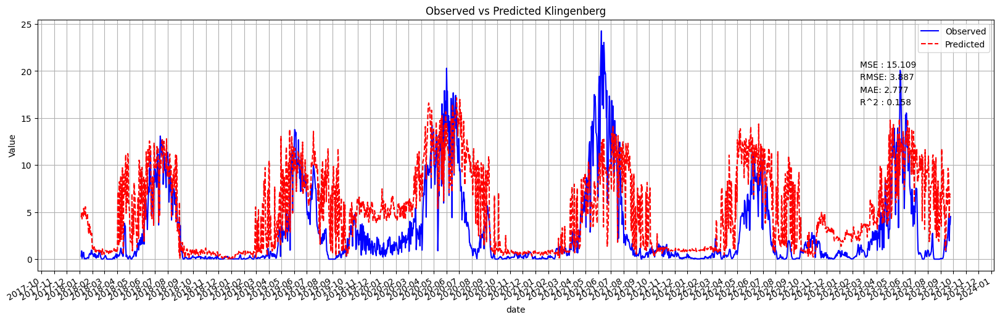

Mean Squared Error: 5.492827227551377
Root Mean Squared Error: 2.3436781407760274
MAE: 1.804609920995409
Test R^2 Score: 0.5368281682520281


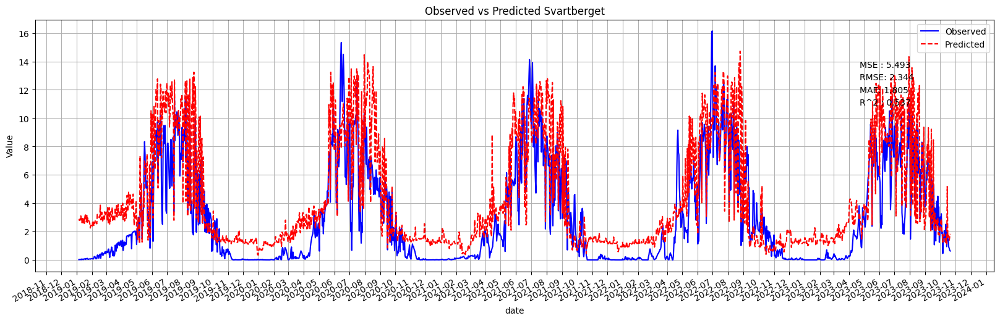

average MSE 9.930326907520929
average RMSE 3.083866921435703
average MAE 2.2860104464189903
average R2 0.3865608262360166


In [19]:
filename = 'Hohes Holz_preprocessed_01012019_26092023.csv'
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1
# Load the data
params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
data = pd.read_csv(os.path.join(directory_data, filename))   
site0 = filename.split('_')[0]
df = data[column]
# Assuming 'timestamp' is the index column
df['date'] = pd.to_datetime(df['date'])
df.set_index('date', inplace=True)
model_0, X_train_0, X_test_0, y_train_0, y_test_0, y_pred_0, mse_0, rmse_0, mae_0, test_r2_0 = XGBoost_train_test(df,target_col, eta, max_depth, min_child_weight, gamma, alpha, params, plot_directory, site0, L,test_size=0.2)
f_importance(model_0, X_train_0, site0, params, plot_directory)
predict_all(model_0,params,L,col2)

change order

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


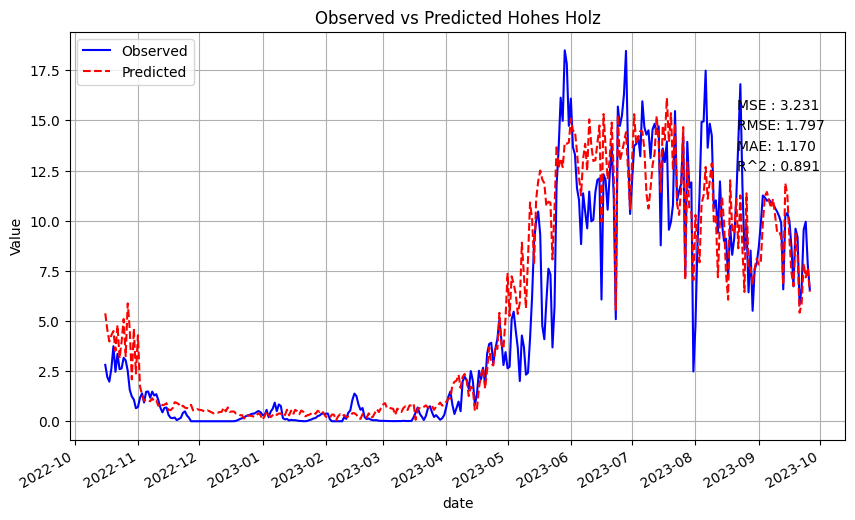

[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802763), ('CLr_lag_3', 0.004137076), ('MNDVI_lag_1', 0.0038376315), ('VPD_F_lag_1', 0.003605907), ('MNDVI_lag_4', 0.0035686286), ('H_F_MDS_lag_2', 0.0035593002), ('LW_IN_F', 0.003524408

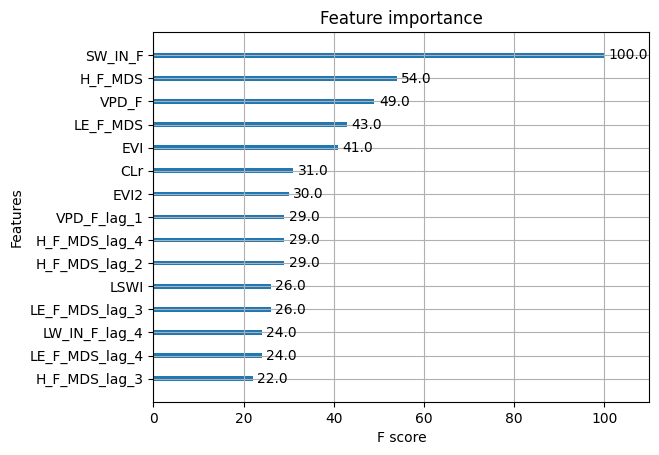

Retraining the model on the second site
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971
[('LE_F_MDS', 0.30837235), ('MNDVI', 0.1285871), ('MNDVI_lag_2', 0.026809068), ('LE_F_MDS_lag_2', 0.025664987), ('LE_F_MDS_lag_1', 0.025533214), ('MNDVI_lag_1', 0.024662469), ('MNDWI_lag_2', 0.024579242), ('LE_F_MDS_lag_3', 0.01966997), ('MNDWI', 0.015823487), ('EVI2', 0.013936798), ('EVI2_lag_4', 0.013723886), ('CLr_lag_2', 0.013663443), ('NDII_lag_1', 0.013500438), ('SW_IN_F', 0.013464811), ('CLr', 0.012967375), ('H_F_MDS_lag_2', 0.01279354), ('SW_IN_F_lag_2', 0.01272974), ('NDII', 0.0126902545), ('CLr_lag_4', 0.011405543), ('TA_F_lag_2', 0.011063257), ('TA_F_lag_3', 0.009907789), ('H_F_MDS_lag_3', 0.009108452), ('LE_F_MDS_lag_4', 0.008946519), ('LSWI_lag_2', 0.008938457), ('MNDWI_lag_4', 0.008272043), ('CLr_lag_3', 0.008150633), ('NDVI_lag_3', 0.0079636), ('H_F_MDS_lag_4', 0.007940694), ('CLr_lag_1', 0.00

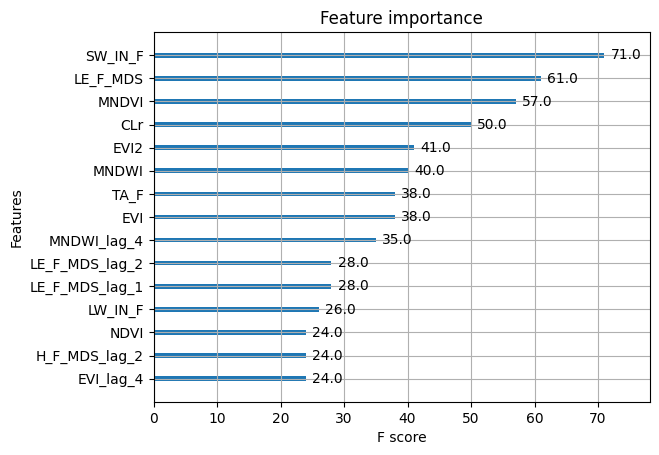

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 6.778769022325301
Root Mean Squared Error: 2.6036069254642302
MAE: 1.9021045773770613
Test R^2 Score: 0.7709864714484194


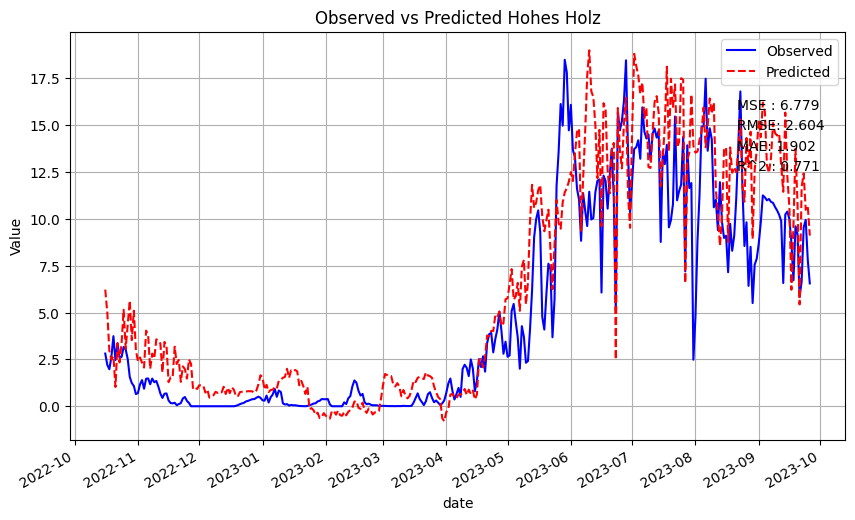

Estrees-Mons A28
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


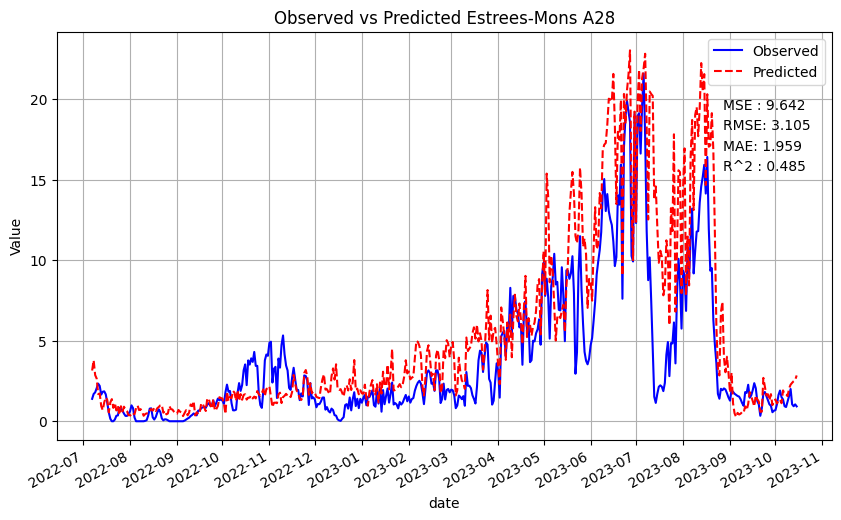

Retraining the model on the third site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675),

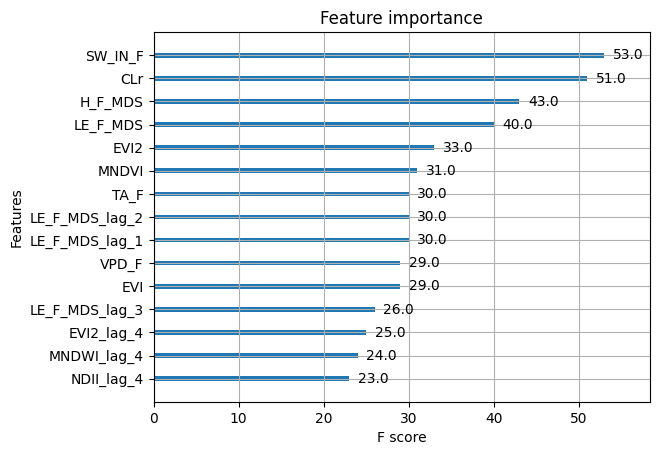

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
mae: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


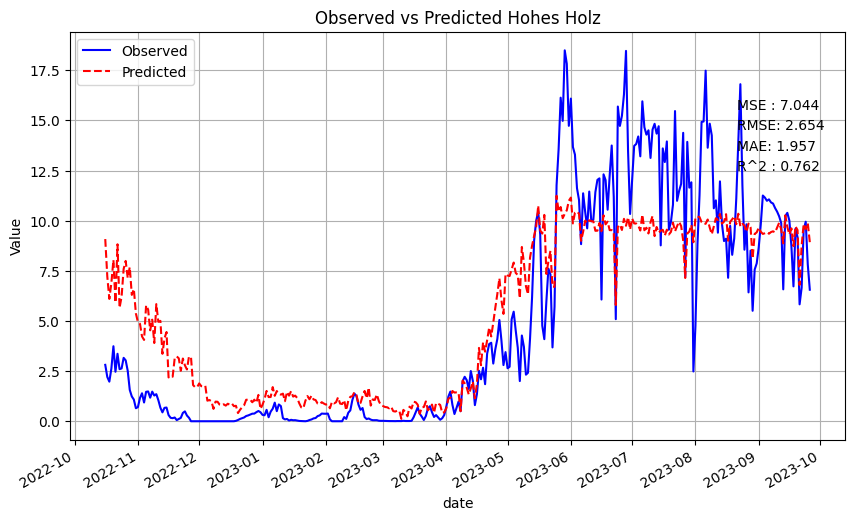

Estrees-Mons A28
Mean Squared Error: 7.6692101714802465
Root Mean Squared Error: 2.769333885879463
MAE: 1.9817319979385093
Test R^2 Score: 0.5902446861717345


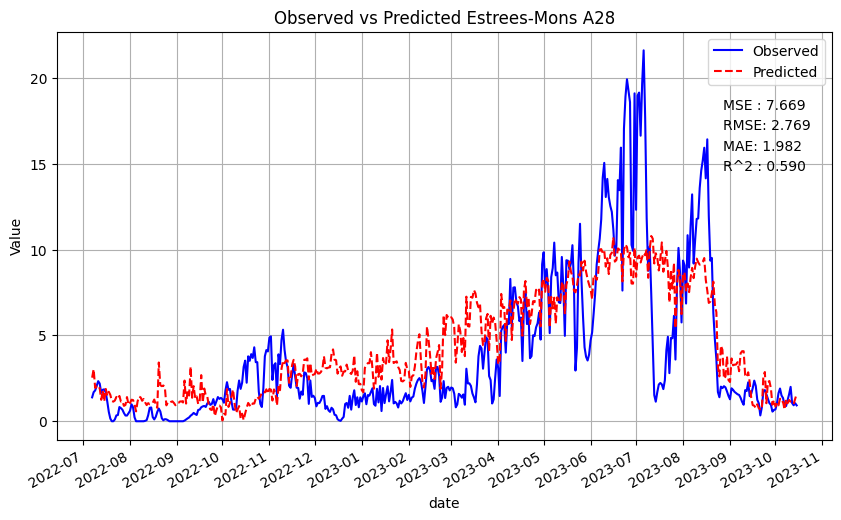

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


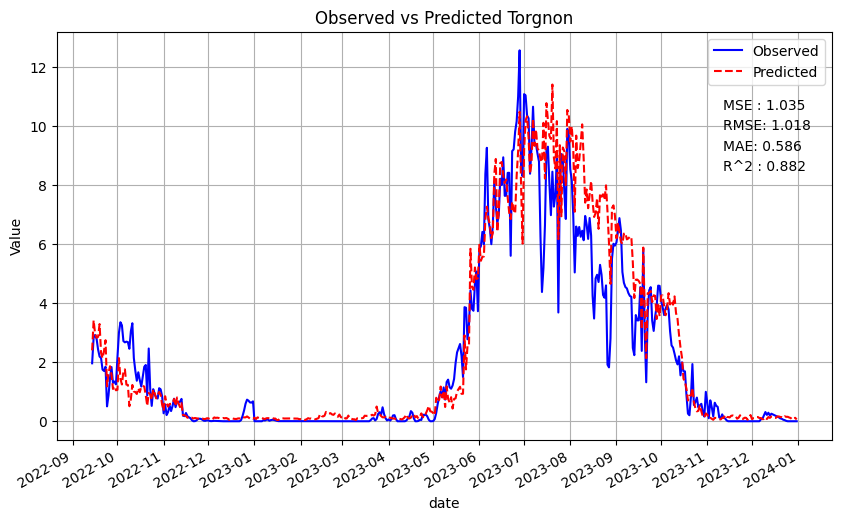

Retraining the model on the fourth site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.0030

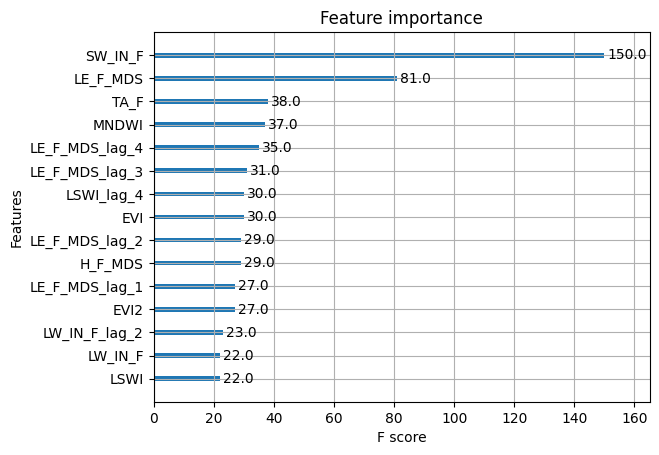

Hohes Holz
Retesting the model on the first, second, and third site
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
MAE: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


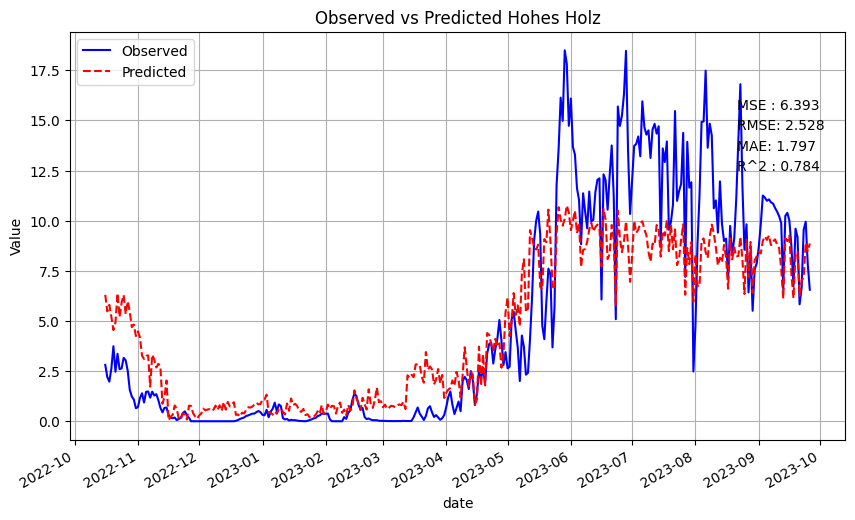

Estrees-Mons A28
Mean Squared Error: 10.316906012265028
Root Mean Squared Error: 3.211994086586248
MAE: 2.515258459566576
Test R^2 Score: 0.4487819519521088


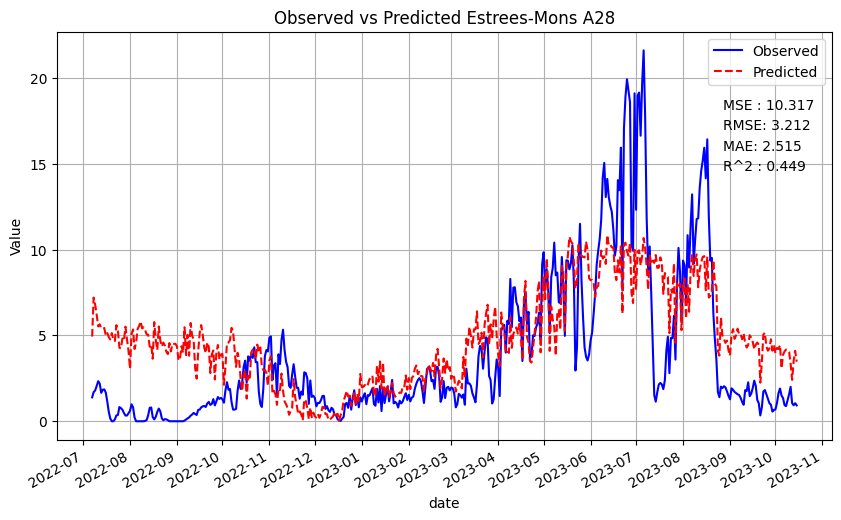

Torgnon
Mean Squared Error: 1.9876067368234545
Root Mean Squared Error: 1.4098250731290938
MAE: 1.077782998667483
Test R^2 Score: 0.7732033722618405


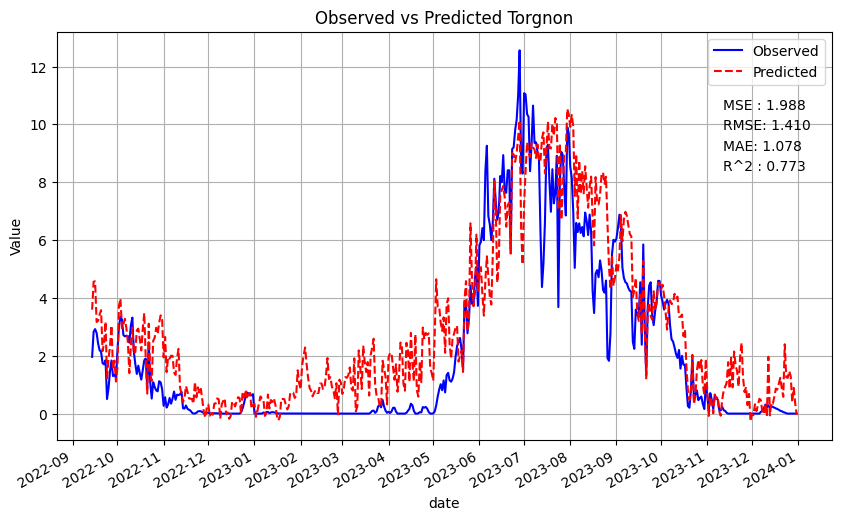

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


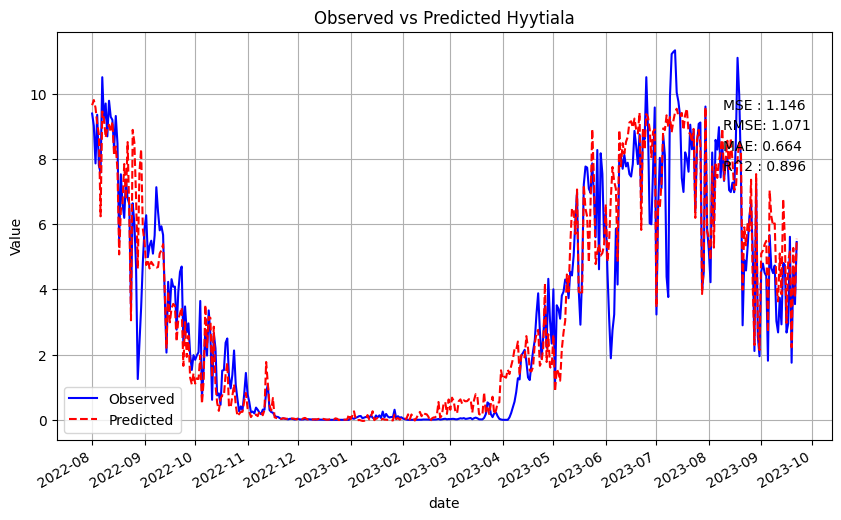

average MSE 4.960896337796415
average RMSE 2.0552096844108907
average MAE 1.513536099646507
average R2 0.7255687205032043
Mean Squared Error: 5.2195083189560005
Root Mean Squared Error: 2.2846243277519394
MAE: 1.7052134868950815
Test R^2 Score: 0.7529765202824721


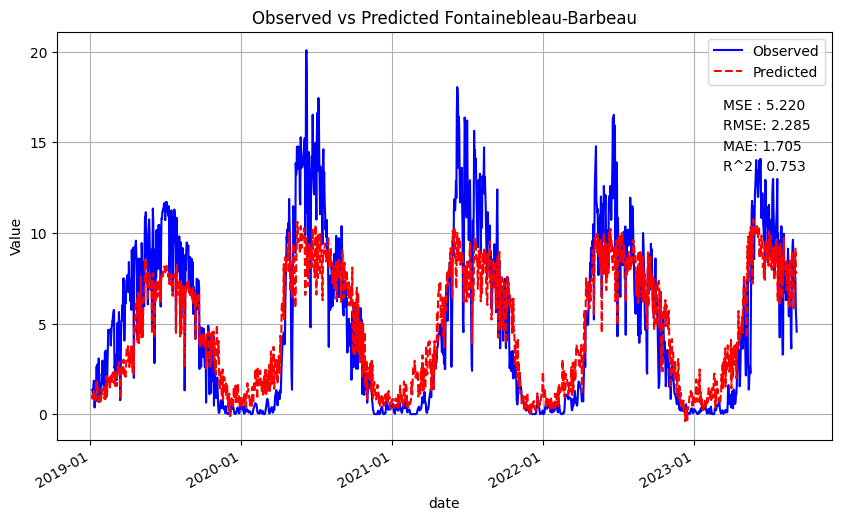

Mean Squared Error: 5.737907885112456
Root Mean Squared Error: 2.3953930544093294
MAE: 1.693880853430192
Test R^2 Score: 0.6171961658290377


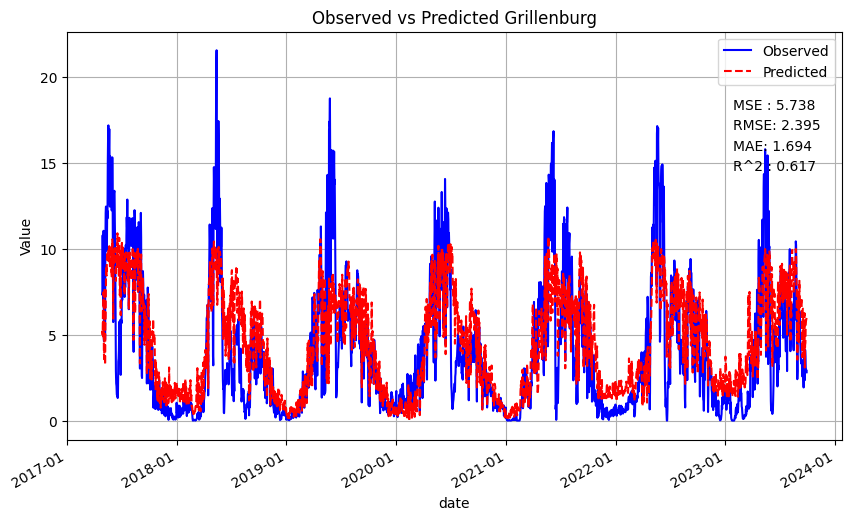

Mean Squared Error: 8.980963341236599
Root Mean Squared Error: 2.996825544010962
MAE: 2.134626296332218
Test R^2 Score: 0.4994683482734975


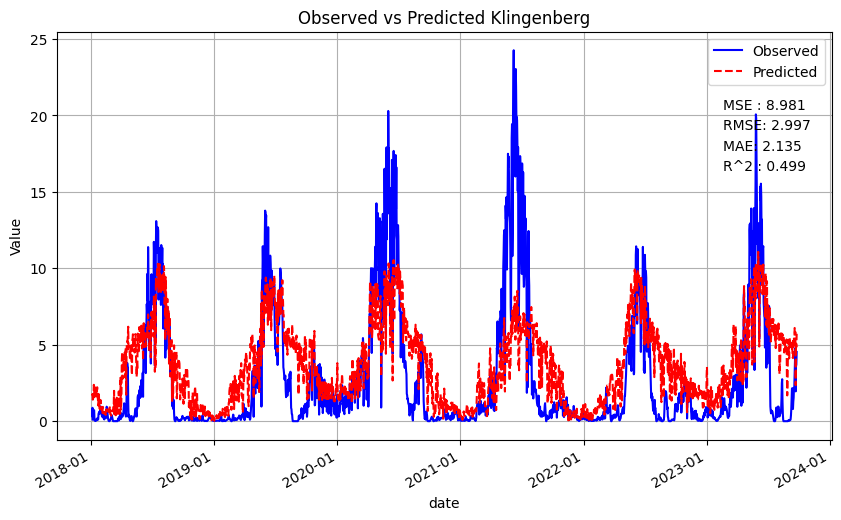

Mean Squared Error: 1.8724242897449048
Root Mean Squared Error: 1.368365554135628
MAE: 0.8839389400033311
Test R^2 Score: 0.842111511583598


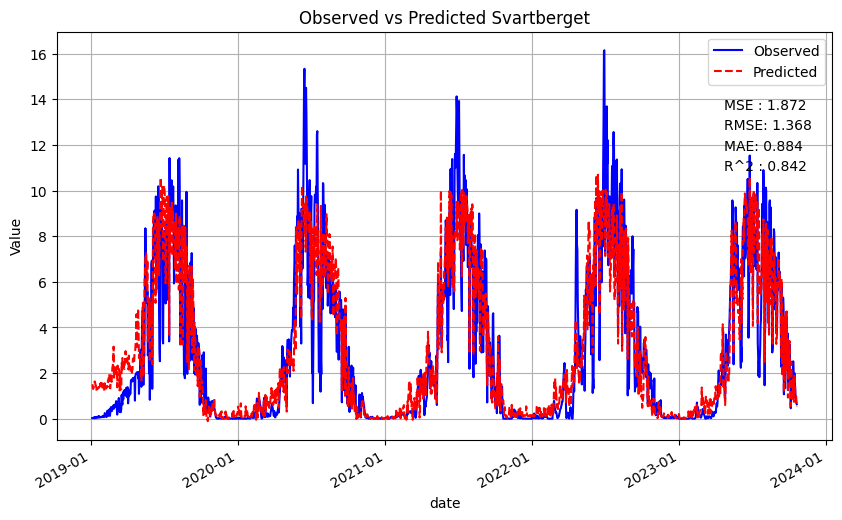

average MSE 5.45270095876249
average RMSE 2.261302120076965
average MAE 1.6044148941652057
average R2 0.6779381364921513


In [22]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,col2)

eta_0.1_max_depth_6_min_child_weight_5_gamma_0.1_alpha_1_L_5
First training and testing the model on the first site
Mean Squared Error: 2.850468494840017
Root Mean Squared Error: 1.6883330521079118
MAE: 1.1292717658066524
Test R^2 Score: 0.9036999422935791


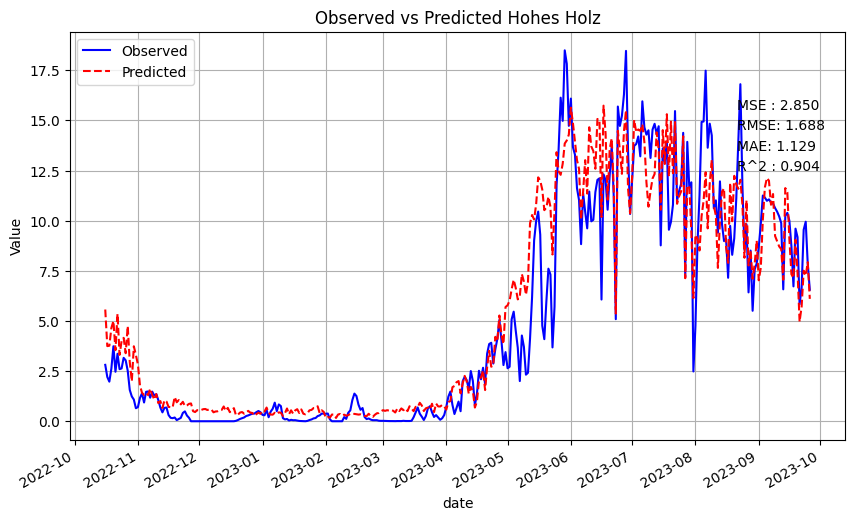

[('LE_F_MDS', 0.5729041), ('EVI2_lag_1', 0.09020393), ('EVI', 0.047820777), ('SW_IN_F', 0.036308505), ('LE_F_MDS_lag_3', 0.01325409), ('LSWI', 0.011442038), ('EVI2', 0.009490286), ('LE_F_MDS_lag_2', 0.009345492), ('CLr_lag_4', 0.008206035), ('EVI2_lag_4', 0.0076884734), ('H_F_MDS_lag_3', 0.006922634), ('CLr_lag_2', 0.0067805075), ('H_F_MDS', 0.0061385166), ('MNDWI_lag_3', 0.0055380184), ('NDVI_lag_2', 0.0054861866), ('NDII_lag_1', 0.0054622404), ('H_F_MDS_lag_4', 0.0054354174), ('VPD_F', 0.0052197664), ('NDVI', 0.0050306567), ('MNDVI_lag_2', 0.004866622), ('LE_F_MDS_lag_4', 0.0048091384), ('EVI2_lag_2', 0.004658614), ('EVI2_lag_3', 0.004469526), ('NDII_lag_2', 0.0042861854), ('CLr', 0.0042293845), ('NDII', 0.0039955727), ('H_F_MDS_lag_2', 0.0038213395), ('MNDWI_lag_2', 0.0038088744), ('MNDVI', 0.0037375353), ('NDVI_lag_4', 0.0037318158), ('H_F_MDS_lag_1', 0.0036640032), ('LSWI_lag_1', 0.0032632805), ('TA_F', 0.003231917), ('MNDWI', 0.003115551), ('NDII_lag_3', 0.0030285034), ('LSWI_lag

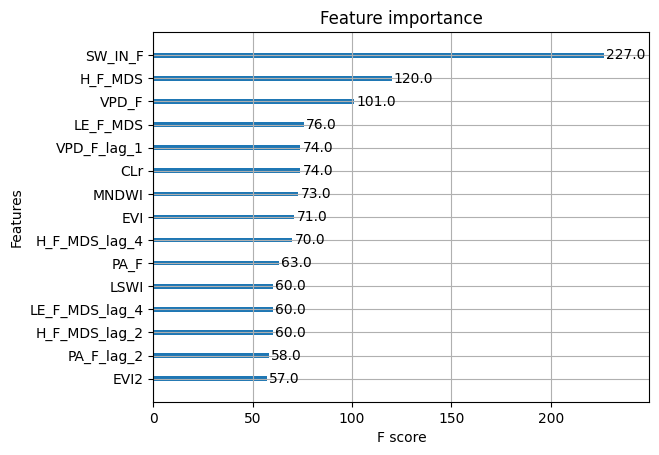

Retraining the model on the second site
Mean Squared Error: 7.287254769065315
Root Mean Squared Error: 2.6994915760315523
MAE: 1.750551249902648
Test R^2 Score: 0.6106520361185315
[('LE_F_MDS', 0.34907332), ('MNDVI', 0.16070881), ('MNDVI_lag_1', 0.068399355), ('MNDVI_lag_2', 0.03887628), ('LE_F_MDS_lag_1', 0.022265483), ('EVI2', 0.020536056), ('CLr_lag_4', 0.013876095), ('SW_IN_F', 0.012934775), ('LE_F_MDS_lag_3', 0.012508036), ('MNDWI', 0.012034573), ('EVI2_lag_1', 0.012022462), ('EVI2_lag_2', 0.01184446), ('LE_F_MDS_lag_2', 0.011398836), ('CLr', 0.010963845), ('EVI2_lag_4', 0.010626825), ('MNDWI_lag_4', 0.009801456), ('H_F_MDS_lag_2', 0.008832881), ('TA_F', 0.0071757985), ('EVI', 0.0071432027), ('CLr_lag_1', 0.007114656), ('LE_F_MDS_lag_4', 0.0069090105), ('CLr_lag_3', 0.0063297306), ('H_F_MDS_lag_1', 0.006082334), ('MNDWI_lag_3', 0.0057590473), ('EVI_lag_3', 0.0054734084), ('TA_F_lag_3', 0.0053090034), ('LSWI', 0.005012273), ('H_F_MDS_lag_4', 0.0049583614), ('TA_F_lag_4', 0.00488768

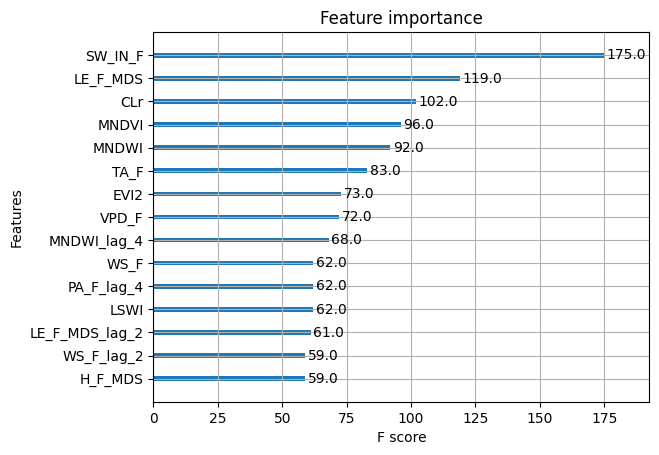

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 9.385438669425586
Root Mean Squared Error: 3.063566331814212
MAE: 2.2636809532163675
Test R^2 Score: 0.6829228994806044


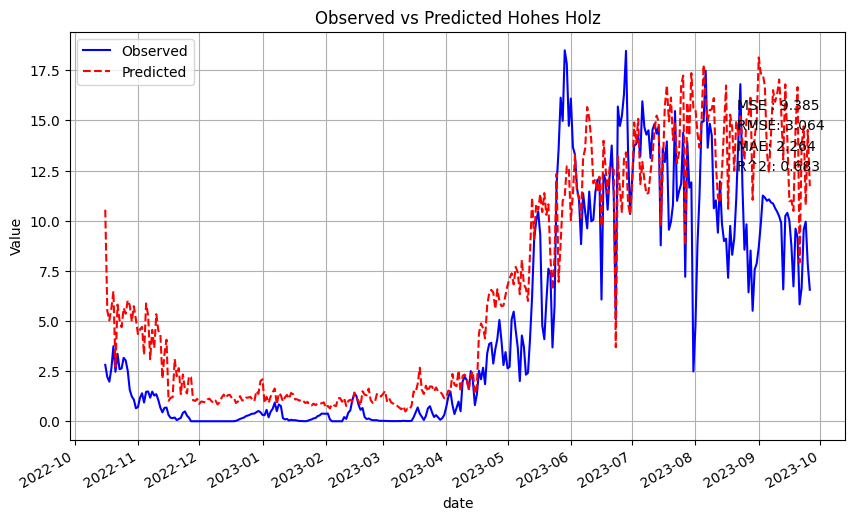

Estrees-Mons A28
Mean Squared Error: 7.287254769065315
Root Mean Squared Error: 2.6994915760315523
MAE: 1.750551249902648
Test R^2 Score: 0.6106520361185315


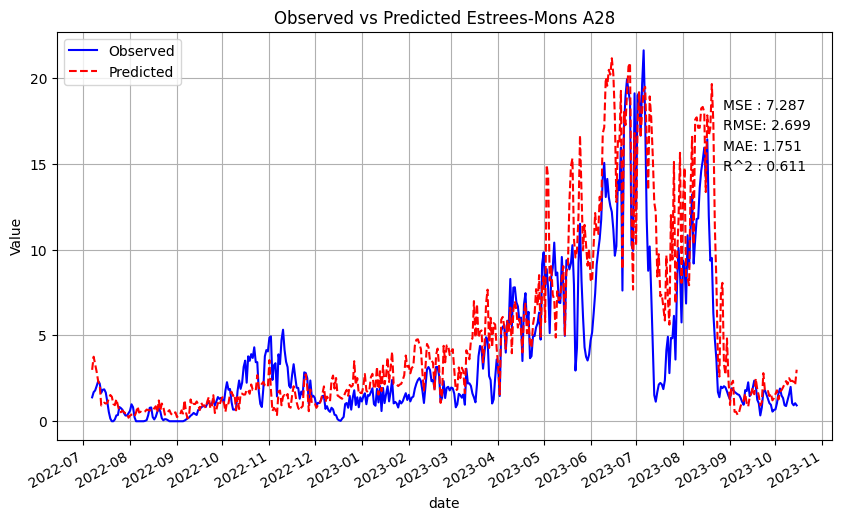

Retraining the model on the third site
Mean Squared Error: 1.1014576938142284
Root Mean Squared Error: 1.0495035463561944
MAE: 0.6056970737785177
Test R^2 Score: 0.874317748111202
[('CLr', 0.552749), ('LE_F_MDS', 0.043791115), ('MNDVI', 0.0430143), ('LE_F_MDS_lag_4', 0.019895954), ('NDVI_lag_4', 0.01832001), ('SW_IN_F', 0.018162426), ('EVI', 0.016514663), ('MNDWI_lag_2', 0.010750518), ('MNDWI_lag_1', 0.010511126), ('NDVI', 0.01020695), ('NDII', 0.00992751), ('CLr_lag_2', 0.008791791), ('MNDVI_lag_1', 0.008510612), ('CLr_lag_4', 0.008248277), ('NDVI_lag_1', 0.008016389), ('MNDWI_lag_4', 0.0078696), ('EVI2_lag_2', 0.007593284), ('EVI2', 0.007260561), ('EVI_lag_1', 0.0072382228), ('EVI2_lag_1', 0.0070110294), ('LSWI_lag_3', 0.006971147), ('TA_F', 0.0064555514), ('MNDVI_lag_4', 0.0063872384), ('CLr_lag_1', 0.0060112863), ('H_F_MDS', 0.0058272043), ('NDII_lag_2', 0.005217583), ('EVI_lag_2', 0.005191165), ('LSWI_lag_2', 0.005066007), ('EVI2_lag_4', 0.004998072), ('MNDWI_lag_3', 0.0047163703)

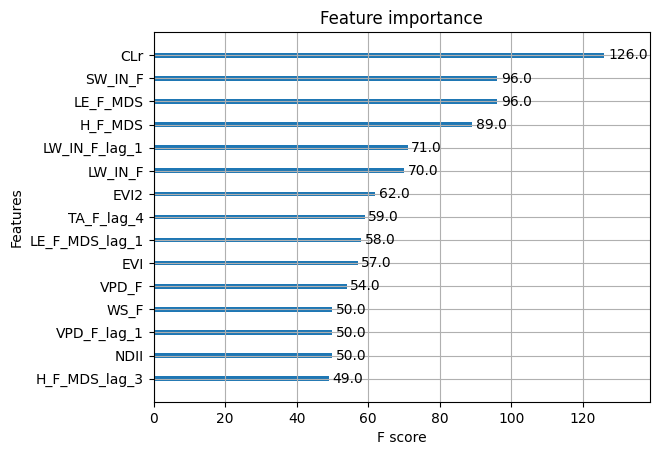

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 7.796057687145388
Root Mean Squared Error: 2.7921421323323403
mae: 2.13497718789989
Test R^2 Score: 0.7366184518391514


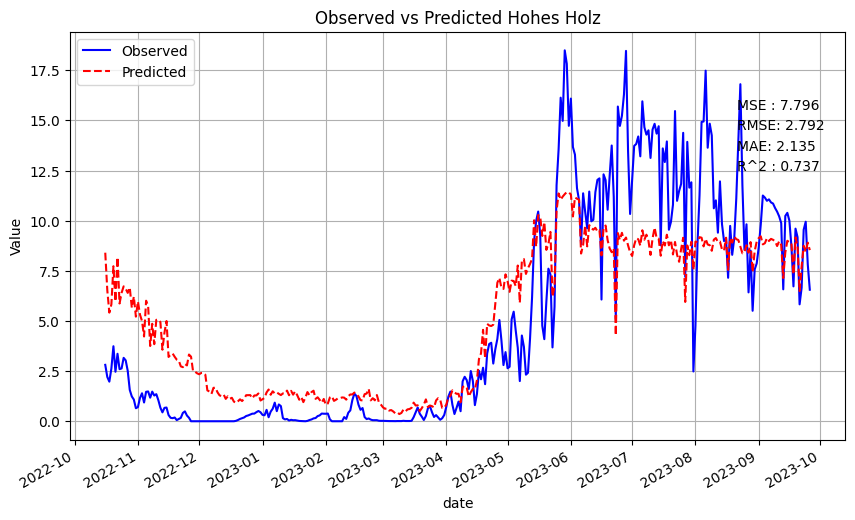

Estrees-Mons A28
Mean Squared Error: 7.990793907329055
Root Mean Squared Error: 2.826799233643779
MAE: 2.1255743078071703
Test R^2 Score: 0.5730629110399467


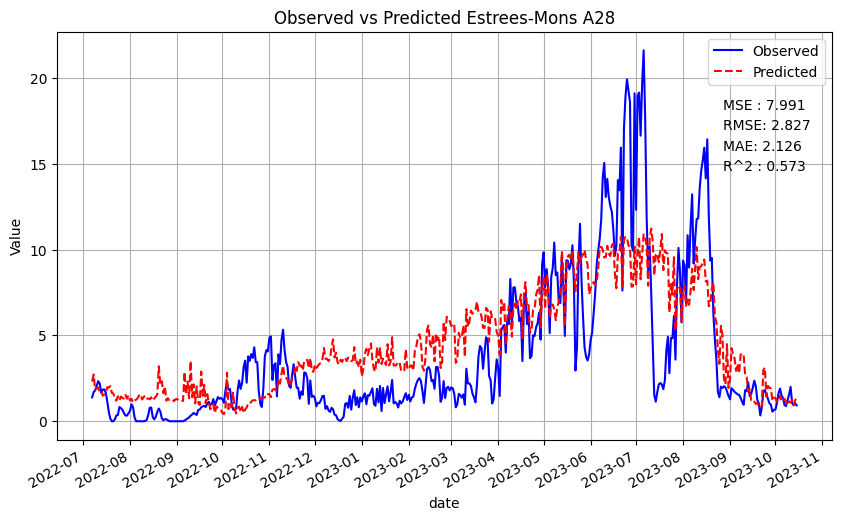

Torgnon
Mean Squared Error: 1.1014576938142284
Root Mean Squared Error: 1.0495035463561944
MAE: 0.6056970737785177
Test R^2 Score: 0.874317748111202


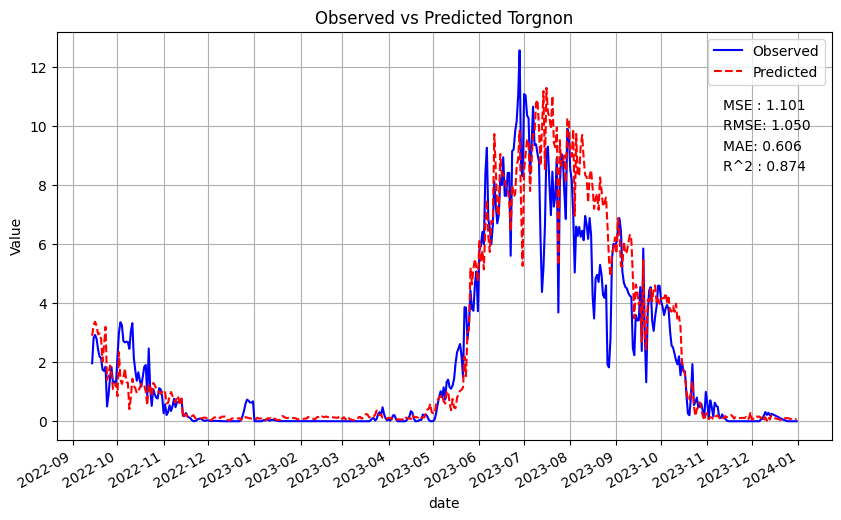

Retraining the model on the fourth site
Mean Squared Error: 1.246815144518409
Root Mean Squared Error: 1.116608769676474
MAE: 0.6931278259375214
Test R^2 Score: 0.8871598780226034
[('TA_F', 0.61317146), ('TA_F_lag_1', 0.081800744), ('MNDVI', 0.061352763), ('SW_IN_F', 0.028259866), ('LE_F_MDS', 0.025876809), ('TA_F_lag_4', 0.010035301), ('CLr_lag_3', 0.008417318), ('TA_F_lag_3', 0.007735057), ('LSWI_lag_4', 0.007304949), ('CLr_lag_4', 0.0069398372), ('LSWI_lag_1', 0.006769128), ('MNDVI_lag_3', 0.006140497), ('CLr', 0.00585292), ('CLr_lag_1', 0.0058153383), ('LSWI', 0.0049064877), ('NDII_lag_2', 0.0048698755), ('CLr_lag_2', 0.004702807), ('LW_IN_F_lag_2', 0.0045940513), ('TA_F_lag_2', 0.003731761), ('LE_F_MDS_lag_2', 0.0036474552), ('MNDVI_lag_2', 0.003637645), ('MNDWI_lag_4', 0.0036205857), ('VPD_F', 0.0035829353), ('EVI_lag_1', 0.00305981), ('NDVI_lag_4', 0.0026839564), ('LE_F_MDS_lag_3', 0.0026727342), ('LW_IN_F_lag_3', 0.0026640077), ('MNDWI', 0.002581177), ('EVI2_lag_3', 0.002507496

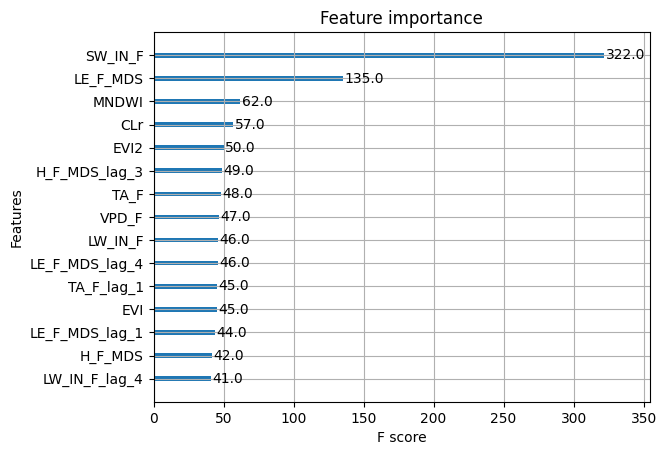

Hohes Holz
Retesting the model on the first, second, and third site
Mean Squared Error: 7.390021765786813
Root Mean Squared Error: 2.718459447147743
MAE: 1.9591778589510918
Test R^2 Score: 0.7503359452015558


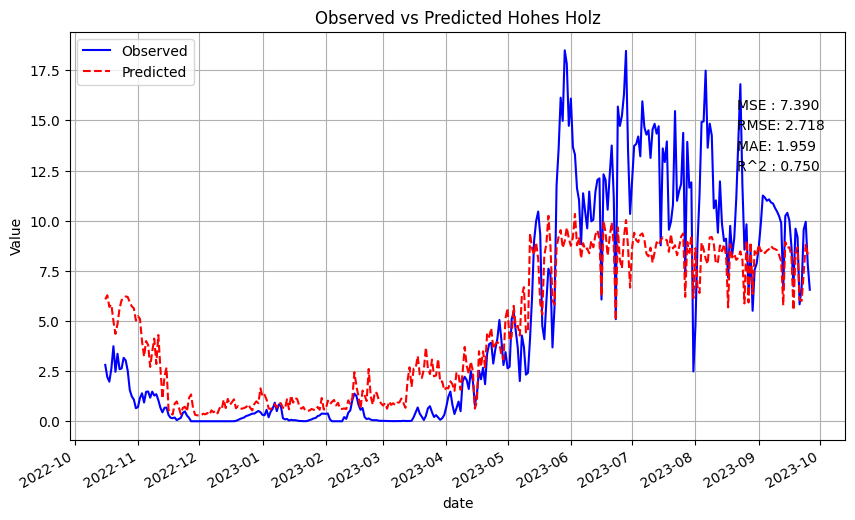

Estrees-Mons A28
Mean Squared Error: 10.42321776012018
Root Mean Squared Error: 3.2285008533559627
MAE: 2.4310615137280034
Test R^2 Score: 0.4431018620038617


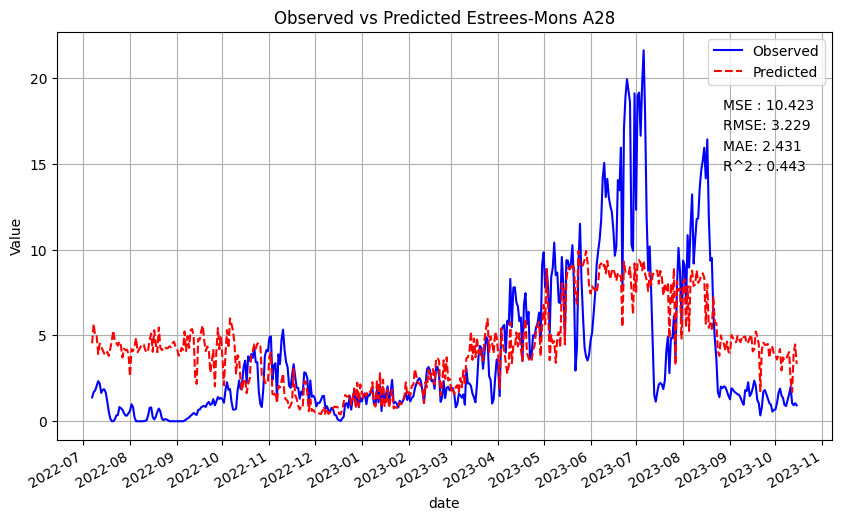

Torgnon
Mean Squared Error: 2.205000771857348
Root Mean Squared Error: 1.484924500389615
MAE: 1.1760164861883036
Test R^2 Score: 0.7483975426564955


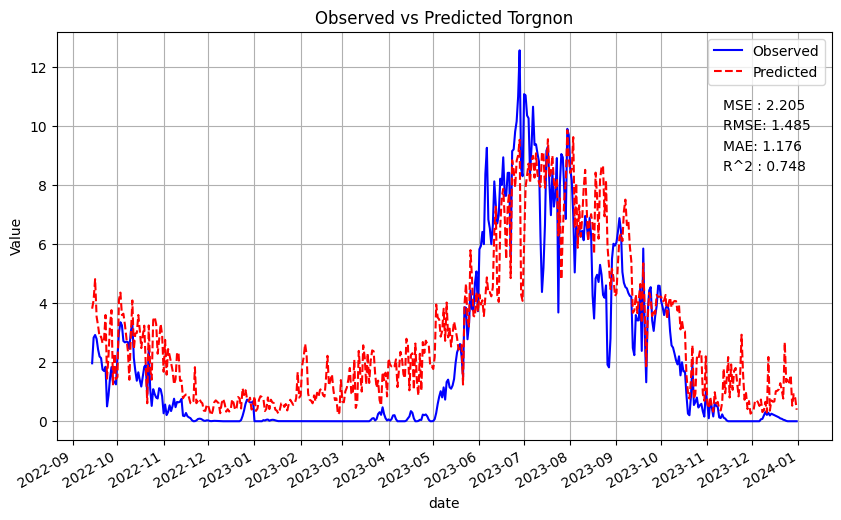

Hyytiala
Mean Squared Error: 1.246815144518409
Root Mean Squared Error: 1.116608769676474
MAE: 0.6931278259375214
Test R^2 Score: 0.8871598780226034


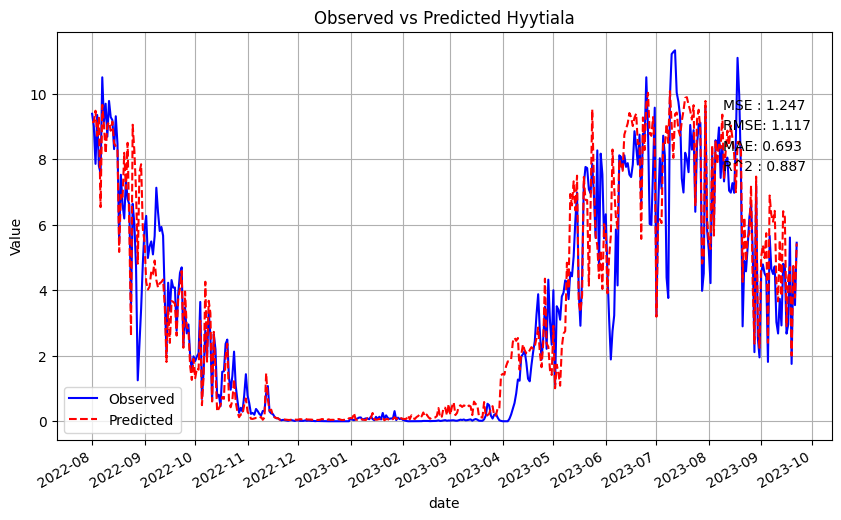

average MSE 5.316263860570688
average RMSE 2.1371233926424487
average MAE 1.56484592120123
average R2 0.7072488069711291
Mean Squared Error: 5.962172910845728
Root Mean Squared Error: 2.4417561120729747
MAE: 1.8749988256639092
Test R^2 Score: 0.7178284602467534


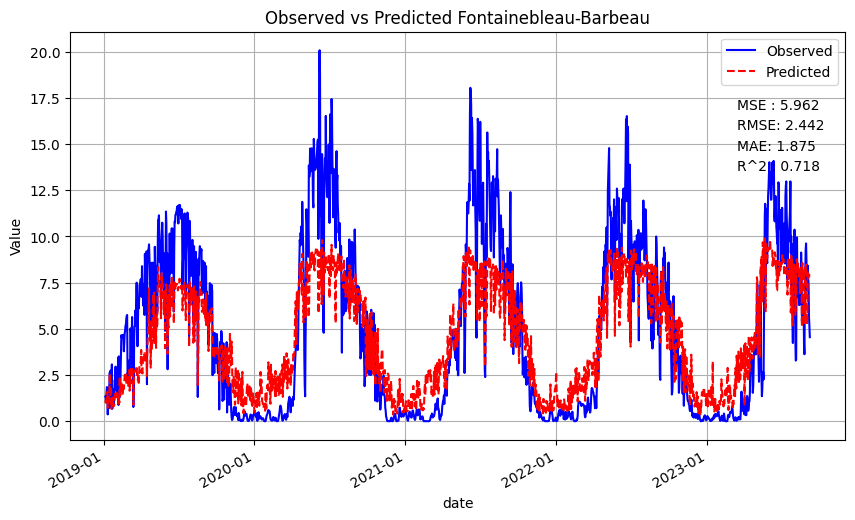

Mean Squared Error: 5.75443215233739
Root Mean Squared Error: 2.398839751283397
MAE: 1.6287712568117632
Test R^2 Score: 0.6160937513293238


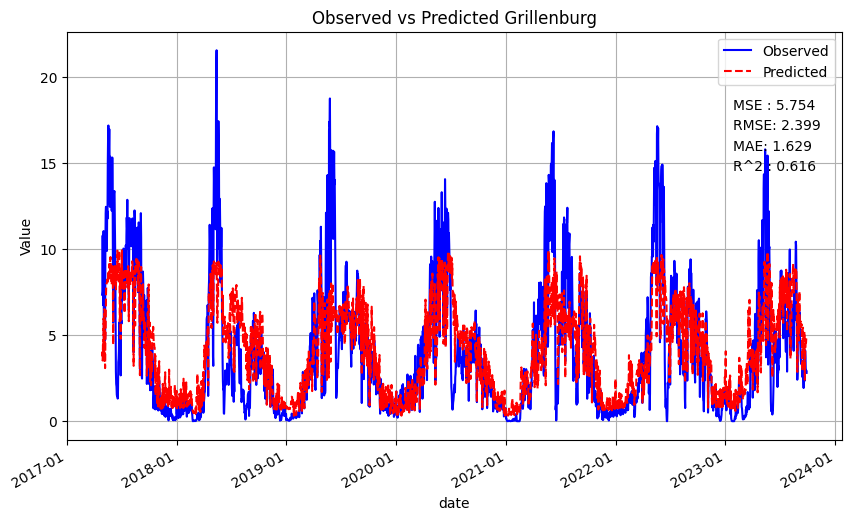

Mean Squared Error: 9.691716790689958
Root Mean Squared Error: 3.1131522273557324
MAE: 2.200624109937933
Test R^2 Score: 0.4598562727635428


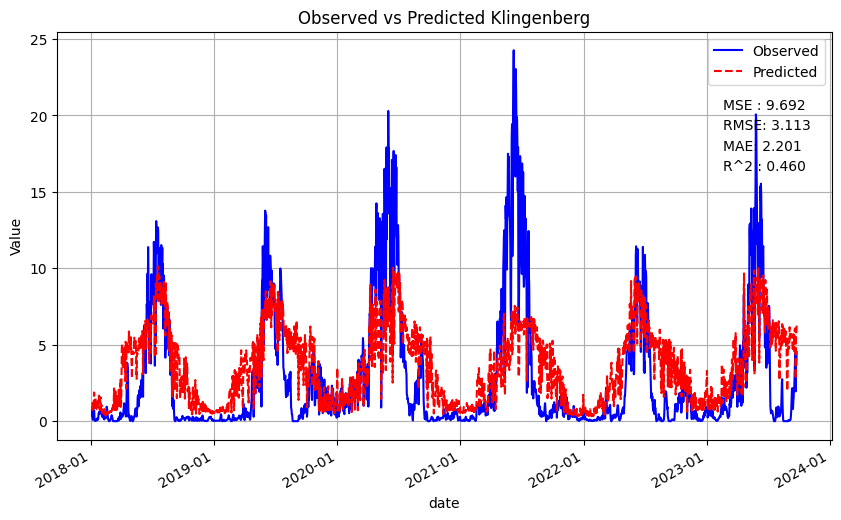

Mean Squared Error: 1.789057745032053
Root Mean Squared Error: 1.3375566324578758
MAE: 0.8528574179710732
Test R^2 Score: 0.8491412311836379


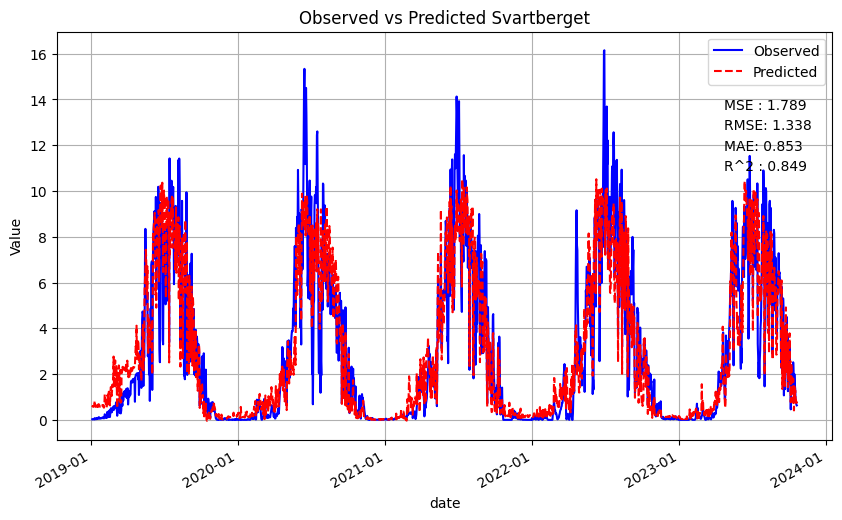

average MSE 5.799344899726282
average RMSE 2.322826180792495
average MAE 1.6393129025961697
average R2 0.6607299288808145


In [23]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 6
min_child_weight = 5
gamma = 0.1
alpha = 1
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,col2)

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.031081357130977
Root Mean Squared Error: 1.7410001025648956
MAE: 1.1408278184132254
Test R^2 Score: 0.8975981281207066


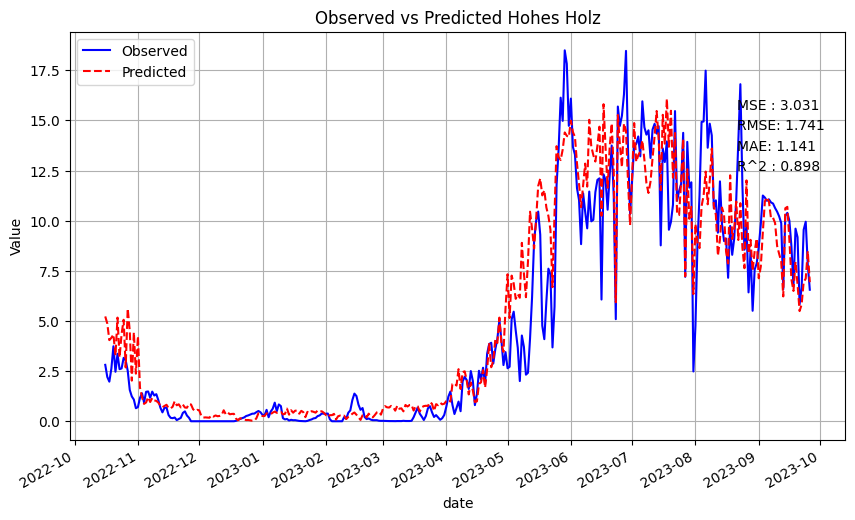

[('LE_F_MDS', 0.43509555), ('EVI2_lag_1', 0.066355385), ('EVI', 0.04445842), ('fall', 0.043572657), ('SW_IN_F', 0.038222708), ('LE_F_MDS_lag_3', 0.029863877), ('LSWI', 0.02845436), ('LE_F_MDS_lag_2', 0.025130989), ('NDII', 0.0141784735), ('EVI2', 0.011771101), ('NDII_lag_2', 0.008401199), ('LSWI_lag_3', 0.008317275), ('H_F_MDS', 0.008097194), ('summer', 0.0073425747), ('spring', 0.0073275957), ('NDII_lag_1', 0.0071020206), ('LE_F_MDS_lag_4', 0.0066276095), ('NDVI_lag_3', 0.0065844767), ('H_F_MDS_lag_3', 0.0063925064), ('VPD_F', 0.0062999483), ('LSWI_lag_1', 0.0062449044), ('EVI_lag_1', 0.005883799), ('LSWI_lag_2', 0.00578594), ('H_F_MDS_lag_4', 0.005693709), ('NDVI_lag_2', 0.005636861), ('NDVI_lag_4', 0.005488703), ('EVI2_lag_2', 0.0052697714), ('NDVI', 0.0052477606), ('EVI2_lag_3', 0.0050696954), ('MNDWI_lag_1', 0.004884129), ('CLr', 0.004739481), ('CLr_lag_2', 0.0046728626), ('NDII_lag_4', 0.0046339217), ('TA_F_lag_2', 0.0044016247), ('MNDVI', 0.004351525), ('MNDVI_lag_1', 0.00422786

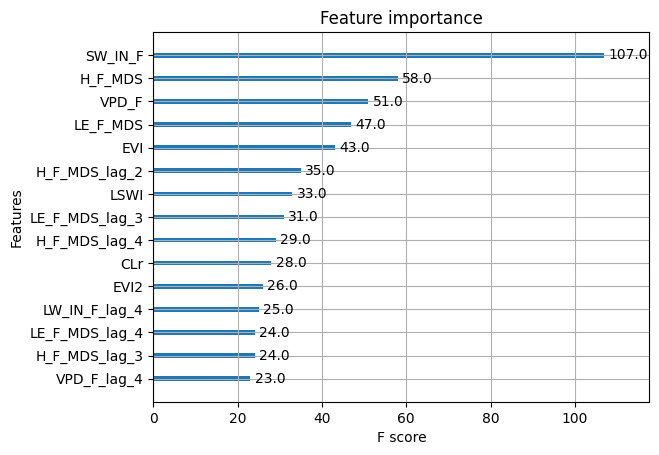

Retraining the model on the second site
Mean Squared Error: 8.200861197583228
Root Mean Squared Error: 2.8637145803280095
MAE: 1.7978431811351243
Test R^2 Score: 0.5618393056727021
[('LE_F_MDS', 0.26347405), ('MNDVI', 0.10876302), ('MNDVI_lag_1', 0.061876774), ('MNDVI_lag_2', 0.057444192), ('LE_F_MDS_lag_1', 0.031985905), ('NDII', 0.02858385), ('LE_F_MDS_lag_2', 0.028398408), ('MNDWI_lag_2', 0.023888038), ('CLr_lag_2', 0.017014332), ('EVI2', 0.016931035), ('CLr', 0.014777625), ('MNDWI', 0.013553428), ('SW_IN_F', 0.013123195), ('summer', 0.012546177), ('CLr_lag_4', 0.012368193), ('LE_F_MDS_lag_3', 0.011830952), ('EVI2_lag_4', 0.010940037), ('H_F_MDS_lag_2', 0.010053759), ('H_F_MDS_lag_4', 0.009135389), ('fall', 0.009104236), ('LW_IN_F', 0.008386224), ('LE_F_MDS_lag_4', 0.008262338), ('NDII_lag_1', 0.008201673), ('MNDVI_lag_4', 0.008200095), ('EVI2_lag_1', 0.008193452), ('H_F_MDS_lag_1', 0.008019221), ('MNDWI_lag_1', 0.0076149963), ('MNDWI_lag_4', 0.007461817), ('winter', 0.0070008705), 

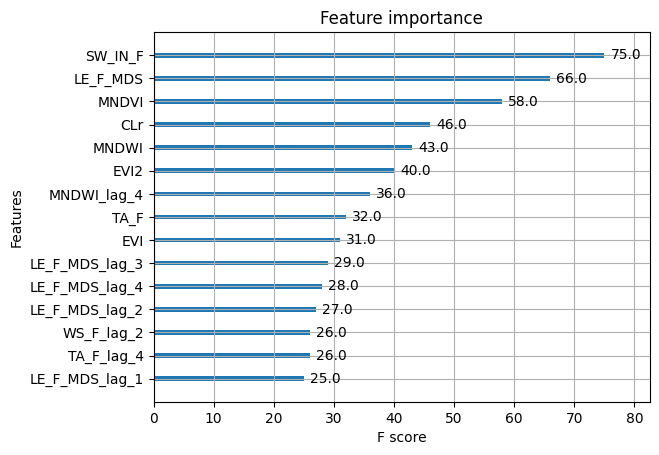

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 7.588780995611436
Root Mean Squared Error: 2.7547742186268978
MAE: 1.9901689275951988
Test R^2 Score: 0.7436210752296745


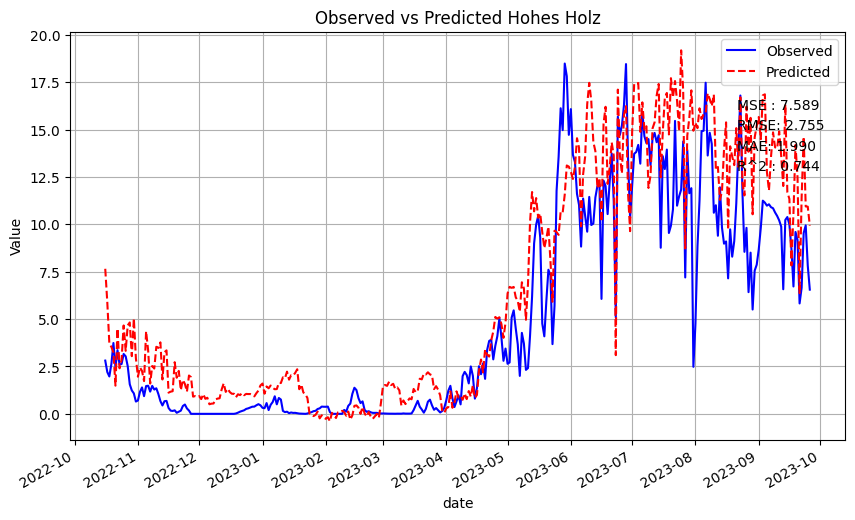

Estrees-Mons A28
Mean Squared Error: 8.200861197583228
Root Mean Squared Error: 2.8637145803280095
MAE: 1.7978431811351243
Test R^2 Score: 0.5618393056727021


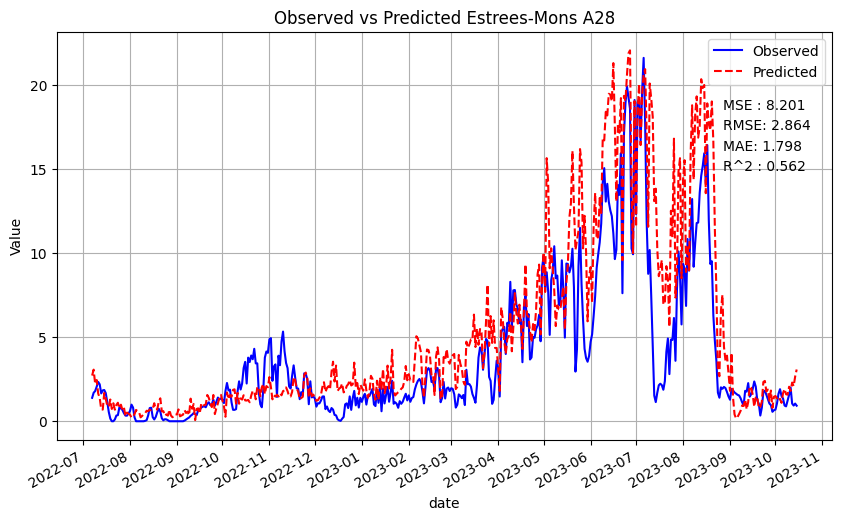

Retraining the model on the third site
Mean Squared Error: 1.0467921994619496
Root Mean Squared Error: 1.0231286329010392
MAE: 0.585763625711768
Test R^2 Score: 0.8805553752750898
[('CLr', 0.50969654), ('LE_F_MDS', 0.09113358), ('MNDVI', 0.028618203), ('MNDVI_lag_1', 0.027077379), ('LE_F_MDS_lag_4', 0.02116374), ('fall', 0.014937773), ('SW_IN_F', 0.013907312), ('EVI', 0.01188406), ('NDVI_lag_1', 0.011584234), ('NDVI_lag_4', 0.010376034), ('MNDWI_lag_2', 0.010056663), ('NDII_lag_2', 0.009485113), ('CLr_lag_4', 0.009445069), ('MNDVI_lag_4', 0.009224699), ('EVI2', 0.009162926), ('CLr_lag_1', 0.008744412), ('MNDWI_lag_1', 0.007952242), ('NDVI', 0.0071098306), ('EVI2_lag_2', 0.0064940634), ('P_F_lag_3', 0.006394811), ('H_F_MDS', 0.0063626827), ('MNDWI', 0.00612918), ('TA_F', 0.005797764), ('PA_F_lag_2', 0.005793946), ('NDII', 0.0055356803), ('LSWI_lag_3', 0.0051717726), ('LE_F_MDS_lag_1', 0.0051214993), ('SW_IN_F_lag_3', 0.0046625077), ('LSWI_lag_1', 0.0046152077), ('PA_F', 0.0045619486), (

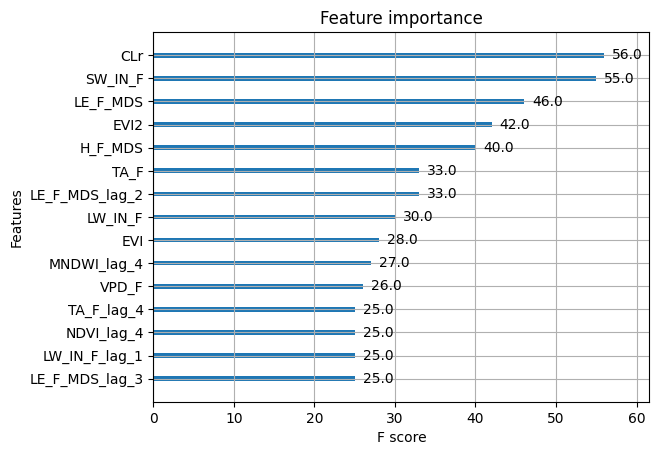

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 7.101066618182018
Root Mean Squared Error: 2.664782658713843
mae: 1.9962989778078708
Test R^2 Score: 0.7600979886829278


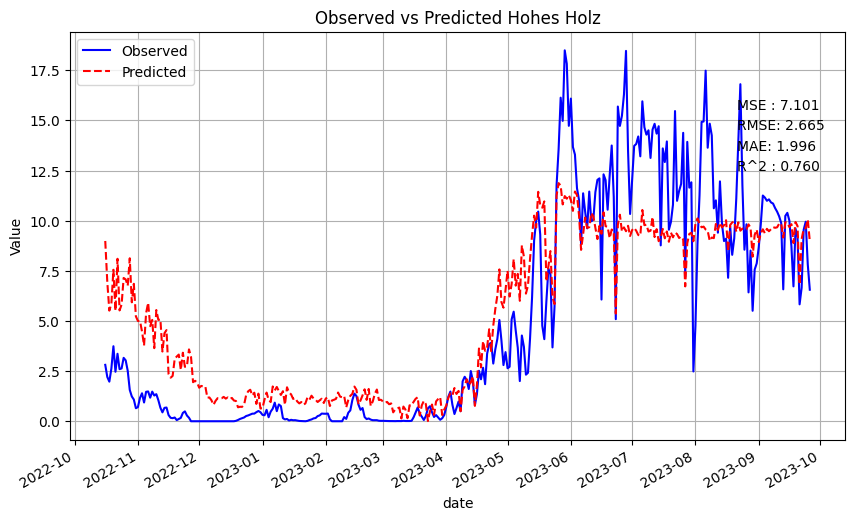

Estrees-Mons A28
Mean Squared Error: 8.110977449988054
Root Mean Squared Error: 2.8479777825657373
MAE: 2.118324669079057
Test R^2 Score: 0.5666416702422485


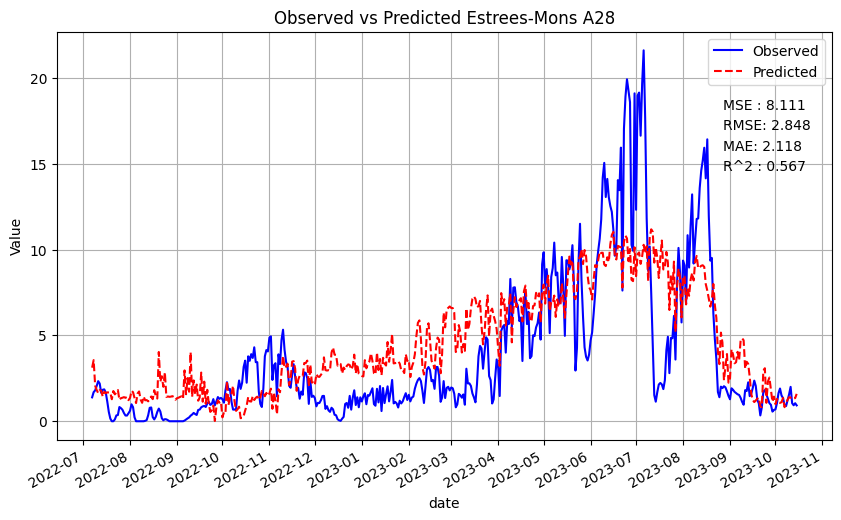

Torgnon
Mean Squared Error: 1.0467921994619496
Root Mean Squared Error: 1.0231286329010392
MAE: 0.585763625711768
Test R^2 Score: 0.8805553752750898


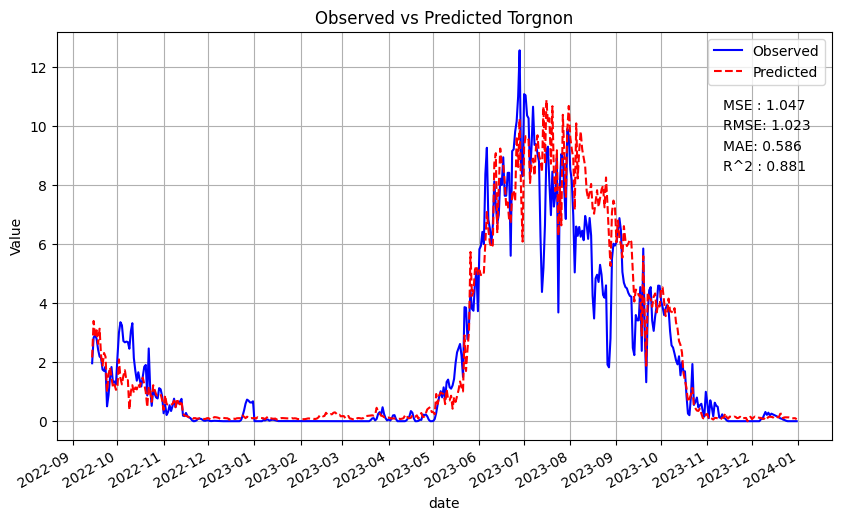

Retraining the model on the fourth site
Mean Squared Error: 1.1344391287770847
Root Mean Squared Error: 1.0651005251980137
MAE: 0.6615034832163347
Test R^2 Score: 0.8973302095102618
[('TA_F', 0.35670227), ('TA_F_lag_1', 0.17475922), ('summer', 0.08497182), ('TA_F_lag_4', 0.054991674), ('MNDVI', 0.03772882), ('SW_IN_F', 0.031178951), ('LE_F_MDS', 0.025257343), ('TA_F_lag_2', 0.024571747), ('TA_F_lag_3', 0.020874334), ('CLr_lag_4', 0.01654706), ('VPD_F', 0.012679953), ('CLr_lag_3', 0.0115252165), ('CLr_lag_2', 0.007676596), ('LSWI', 0.0058067883), ('SW_IN_F_lag_4', 0.005239786), ('LSWI_lag_4', 0.0047899634), ('NDVI_lag_1', 0.0046468694), ('MNDWI', 0.0045256815), ('CLr_lag_1', 0.004245012), ('EVI', 0.0040784967), ('CLr', 0.003546477), ('LE_F_MDS_lag_4', 0.003429091), ('EVI_lag_2', 0.0033716513), ('EVI2', 0.0032999334), ('H_F_MDS', 0.0032789789), ('LE_F_MDS_lag_2', 0.0032717113), ('LSWI_lag_3', 0.0032119076), ('NDVI_lag_2', 0.0031987089), ('LW_IN_F_lag_2', 0.0031312727), ('fall', 0.0031223

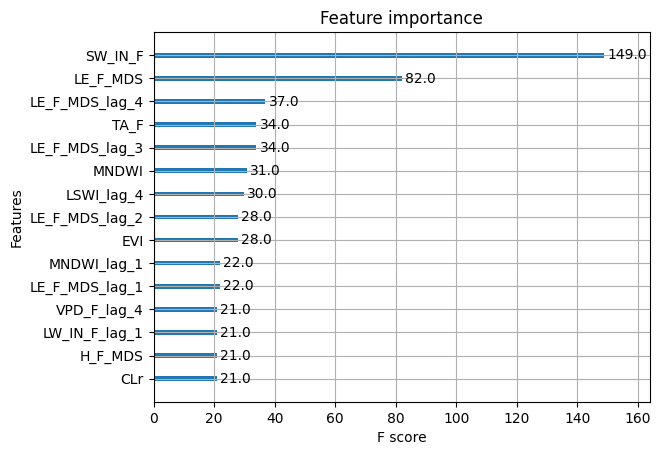

Hohes Holz
Retesting the model on the first, second, and third site
Mean Squared Error: 7.618491357356511
Root Mean Squared Error: 2.7601614730585076
MAE: 1.9845113892349644
Test R^2 Score: 0.7426173421395846


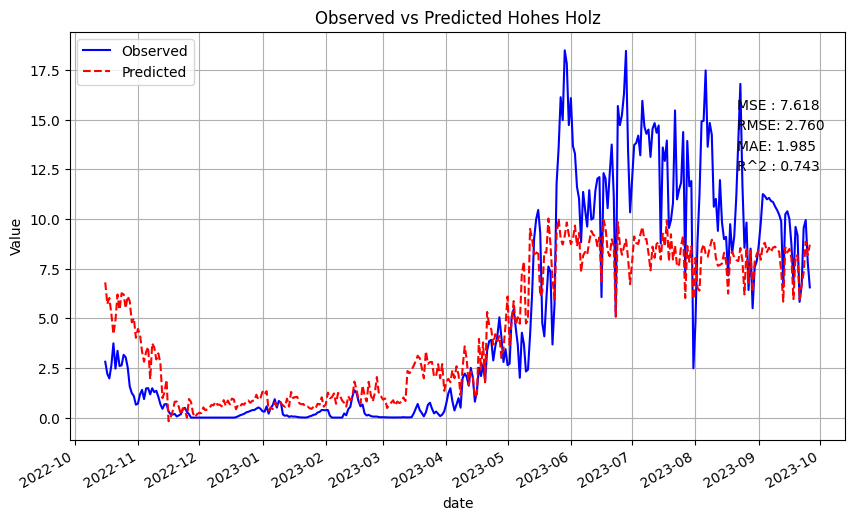

Estrees-Mons A28
Mean Squared Error: 10.538477092092725
Root Mean Squared Error: 3.2463020642097873
MAE: 2.519467547257512
Test R^2 Score: 0.4369437149863663


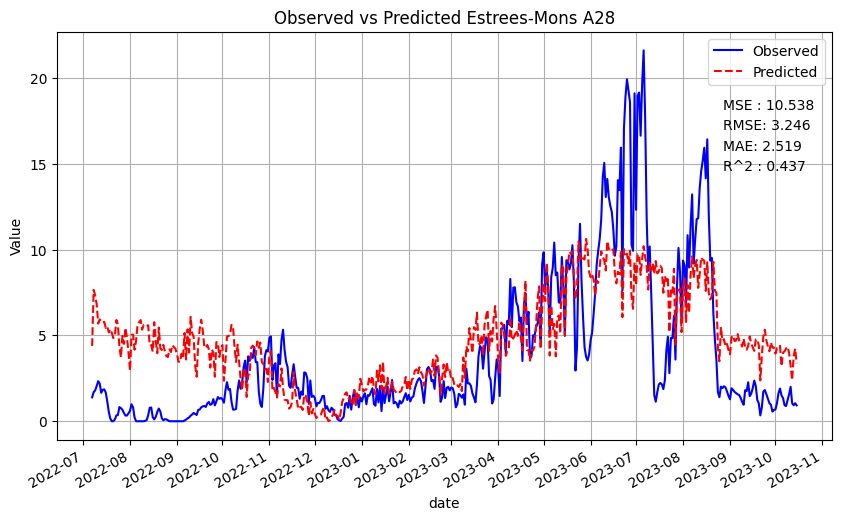

Torgnon
Mean Squared Error: 1.968742905699051
Root Mean Squared Error: 1.4031189919957079
MAE: 1.093498898046552
Test R^2 Score: 0.7753558369350455


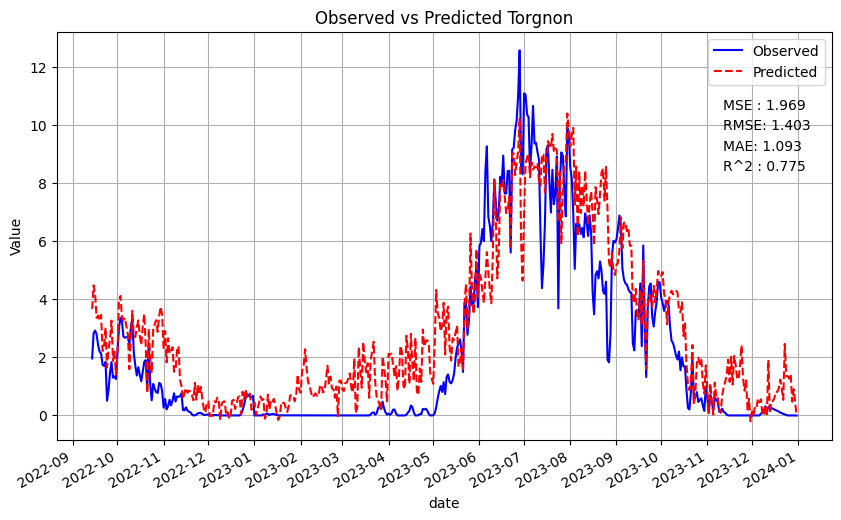

Hyytiala
Mean Squared Error: 1.1344391287770847
Root Mean Squared Error: 1.0651005251980137
MAE: 0.6615034832163347
Test R^2 Score: 0.8973302095102618


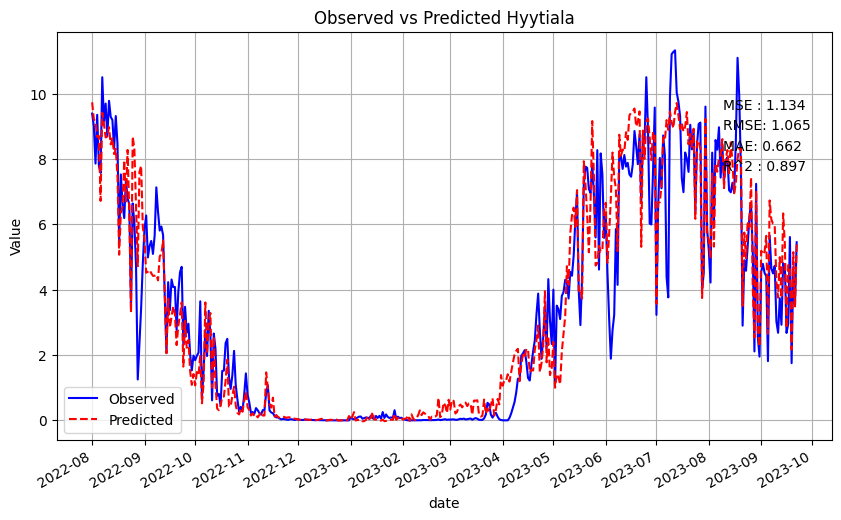

average MSE 5.315037620981343
average RMSE 2.118670763615504
average MAE 1.5647453294388407
average R2 0.7130617758928146
Mean Squared Error: 5.8795590511280444
Root Mean Squared Error: 2.4247802067668
MAE: 1.8230084631321313
Test R^2 Score: 0.7217383233704968


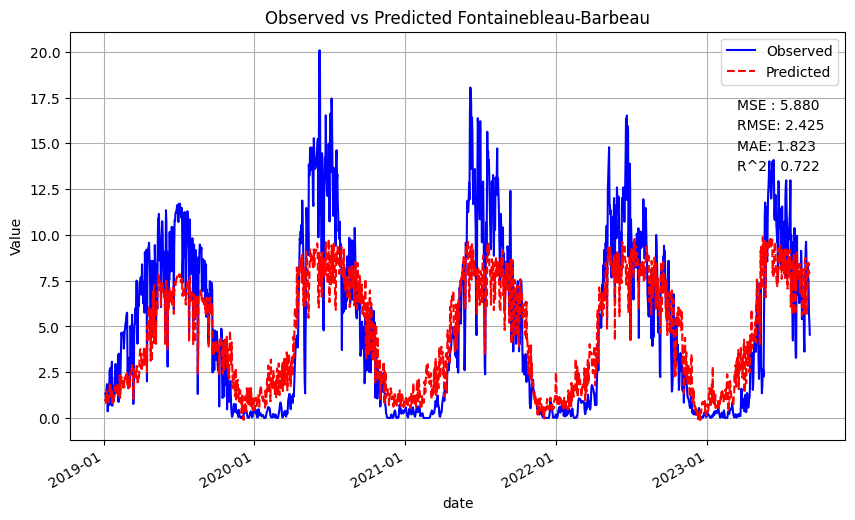

Mean Squared Error: 6.099521080360425
Root Mean Squared Error: 2.469720850695565
MAE: 1.7876242181708772
Test R^2 Score: 0.593071185017321


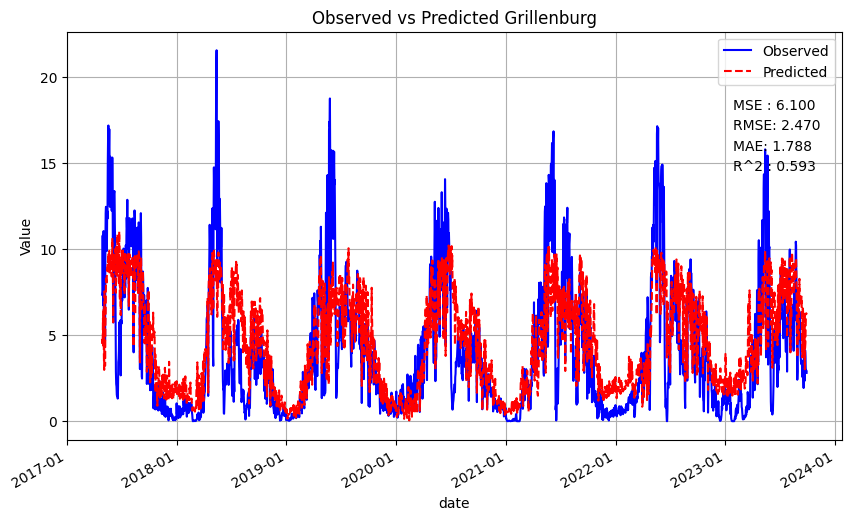

Mean Squared Error: 9.193378614600029
Root Mean Squared Error: 3.032058478097022
MAE: 2.2071979826373203
Test R^2 Score: 0.48762991139442047


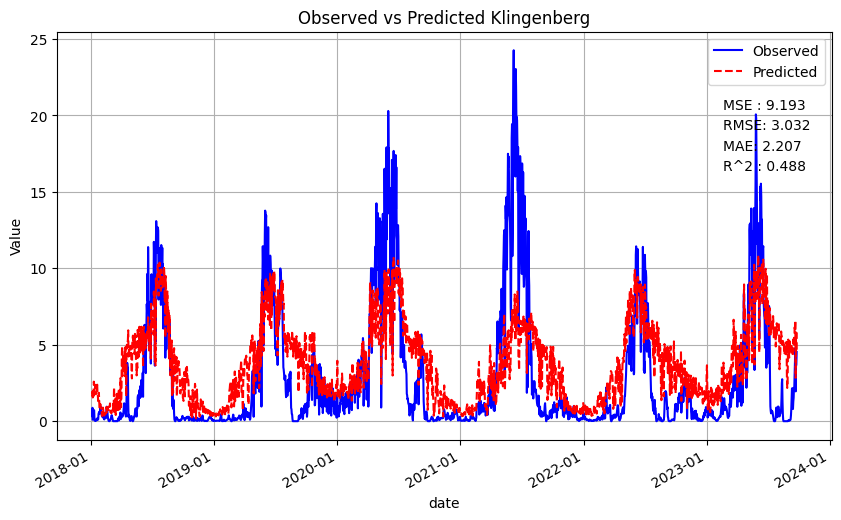

Mean Squared Error: 1.8342194955551478
Root Mean Squared Error: 1.3543335983261835
MAE: 0.8614157717399479
Test R^2 Score: 0.8453330555669344


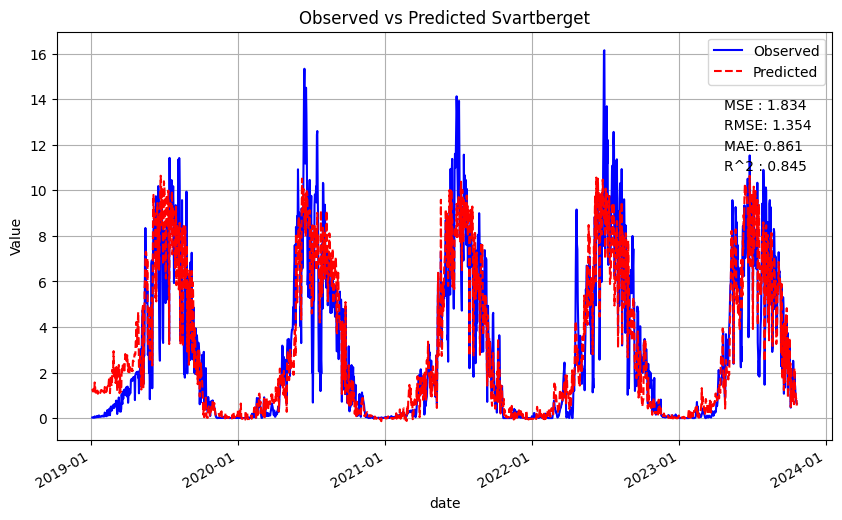

average MSE 5.751669560410911
average RMSE 2.3202232834713925
average MAE 1.6698116089200692
average R2 0.6619431188372932


In [24]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
col_general = ['date',
        
        'latitude',
 'longitude',
 'elevation',
 'canopy_height',
 'instrument_height',
 'biom_croplands',
 'biom_dbf',
 'biom_enf',
 'biom_grasslands',
 'winter',
 'spring',
 'summer',
 'fall','CLr', 'EVI', 'EVI2', 'LSWI',  'MNDVI', 'MNDWI', 'NDII', 'NDVI', 'H_F_MDS', 'LE_F_MDS',  'LW_IN_F', 'PA_F', 'P_F', 'SW_IN_F', 'TA_F', 'VPD_F', 'WS_F', target_col]
column = col_general
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


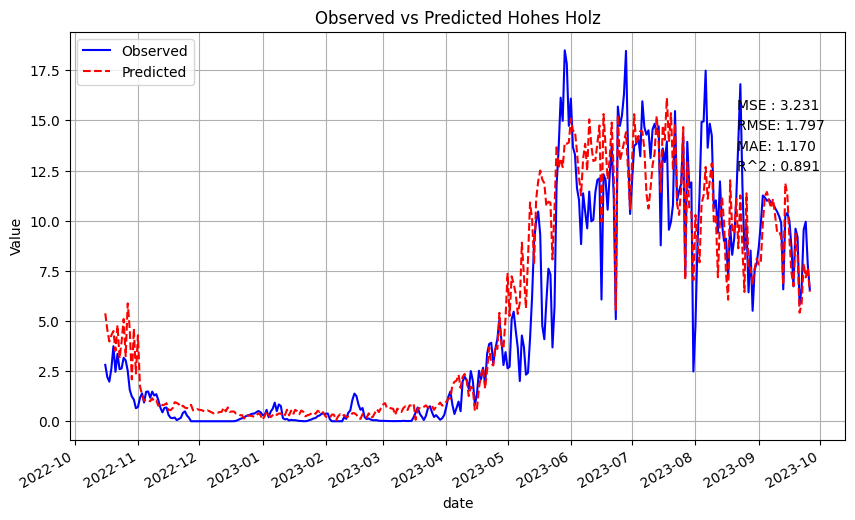

[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802763), ('CLr_lag_3', 0.004137076), ('MNDVI_lag_1', 0.0038376315), ('VPD_F_lag_1', 0.003605907), ('MNDVI_lag_4', 0.0035686286), ('H_F_MDS_lag_2', 0.0035593002), ('LW_IN_F', 0.003524408

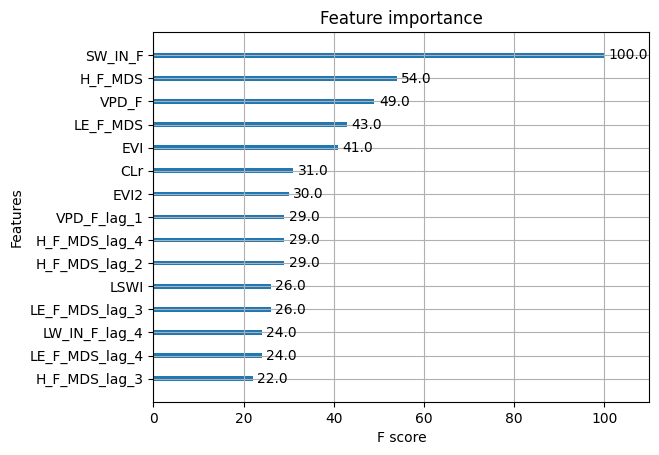

Retraining the model on the second site
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971
[('LE_F_MDS', 0.30837235), ('MNDVI', 0.1285871), ('MNDVI_lag_2', 0.026809068), ('LE_F_MDS_lag_2', 0.025664987), ('LE_F_MDS_lag_1', 0.025533214), ('MNDVI_lag_1', 0.024662469), ('MNDWI_lag_2', 0.024579242), ('LE_F_MDS_lag_3', 0.01966997), ('MNDWI', 0.015823487), ('EVI2', 0.013936798), ('EVI2_lag_4', 0.013723886), ('CLr_lag_2', 0.013663443), ('NDII_lag_1', 0.013500438), ('SW_IN_F', 0.013464811), ('CLr', 0.012967375), ('H_F_MDS_lag_2', 0.01279354), ('SW_IN_F_lag_2', 0.01272974), ('NDII', 0.0126902545), ('CLr_lag_4', 0.011405543), ('TA_F_lag_2', 0.011063257), ('TA_F_lag_3', 0.009907789), ('H_F_MDS_lag_3', 0.009108452), ('LE_F_MDS_lag_4', 0.008946519), ('LSWI_lag_2', 0.008938457), ('MNDWI_lag_4', 0.008272043), ('CLr_lag_3', 0.008150633), ('NDVI_lag_3', 0.0079636), ('H_F_MDS_lag_4', 0.007940694), ('CLr_lag_1', 0.00

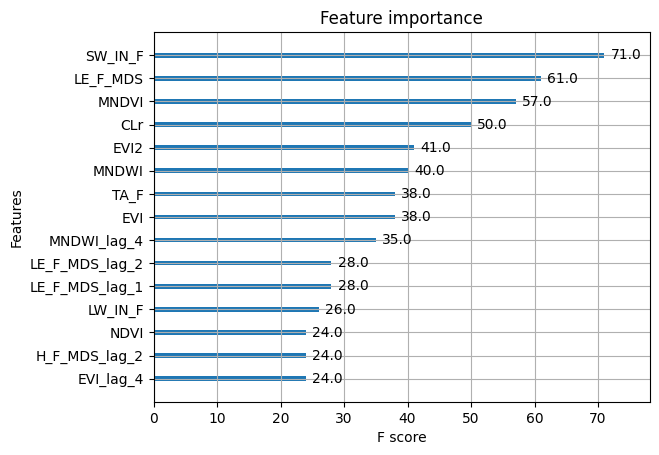

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 6.778769022325301
Root Mean Squared Error: 2.6036069254642302
MAE: 1.9021045773770613
Test R^2 Score: 0.7709864714484194


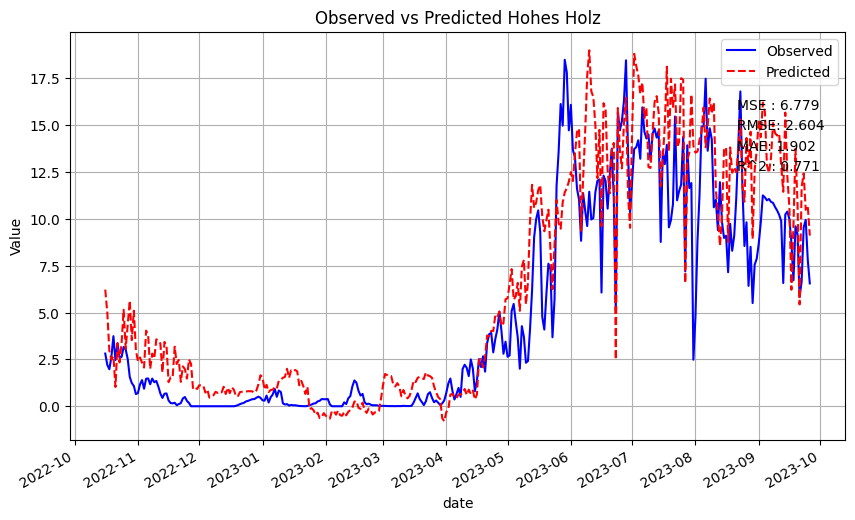

Estrees-Mons A28
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


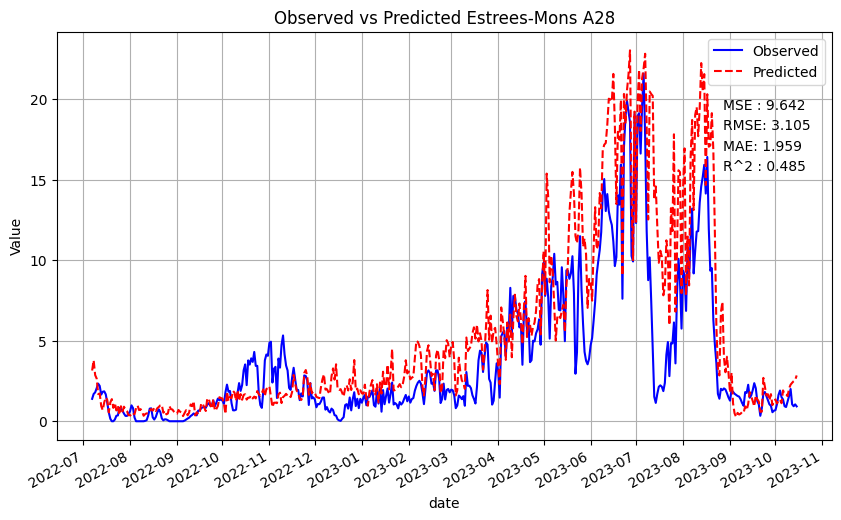

Retraining the model on the third site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675),

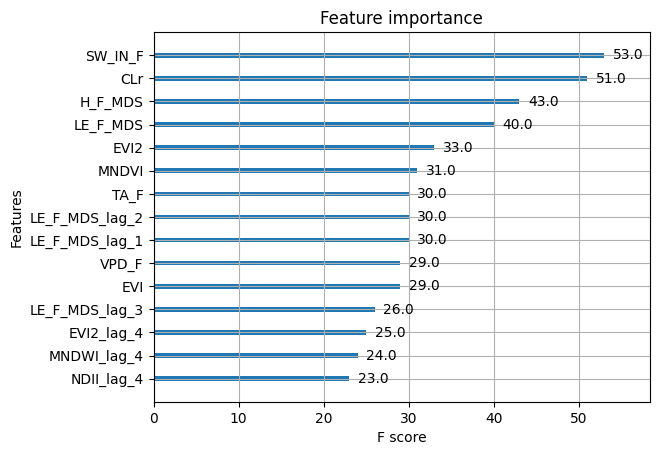

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
mae: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


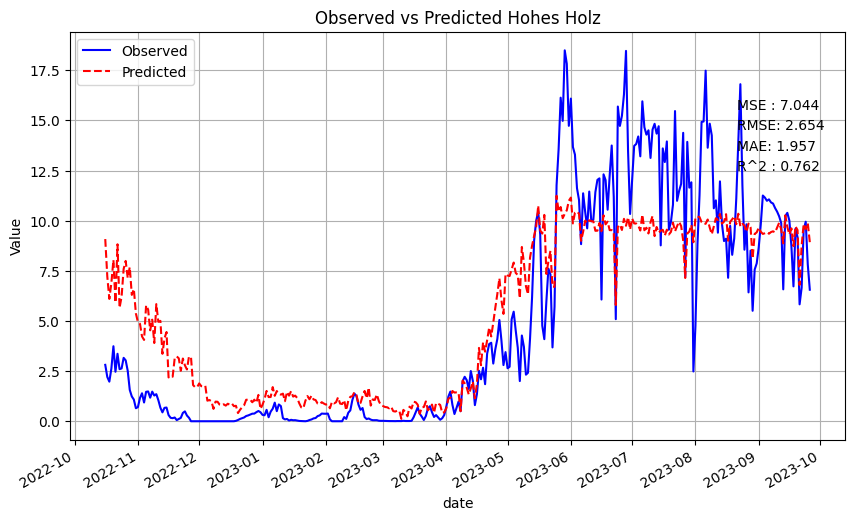

Estrees-Mons A28
Mean Squared Error: 7.6692101714802465
Root Mean Squared Error: 2.769333885879463
MAE: 1.9817319979385093
Test R^2 Score: 0.5902446861717345


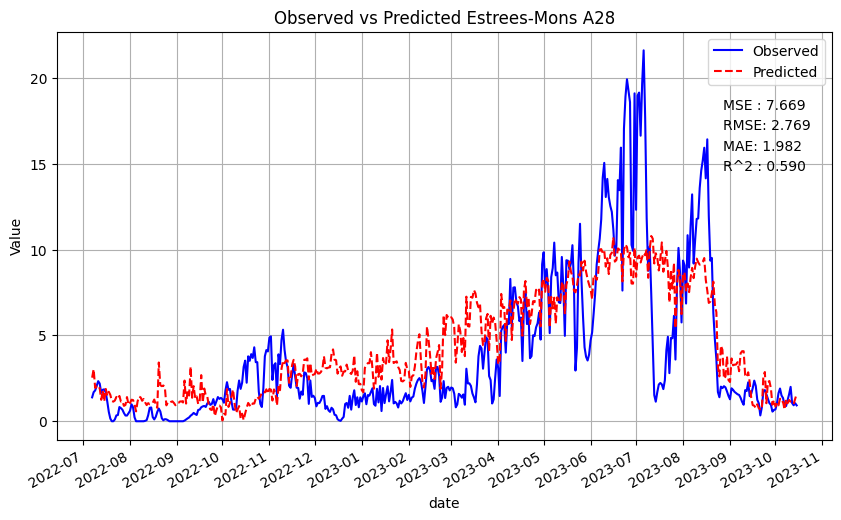

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


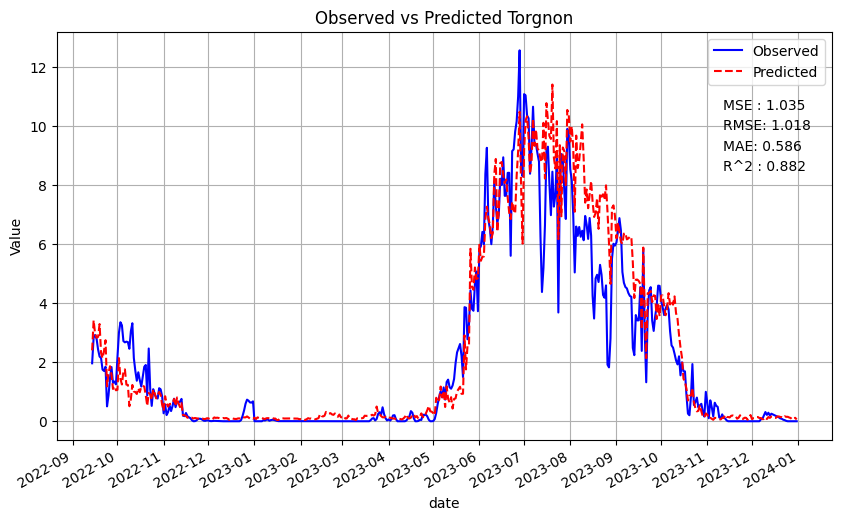

Retraining the model on the fourth site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.0030

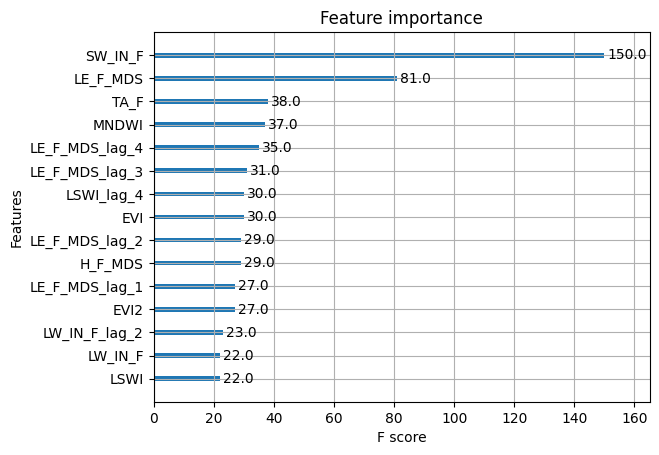

Hohes Holz
Retesting the model on the first, second, and third site
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
MAE: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


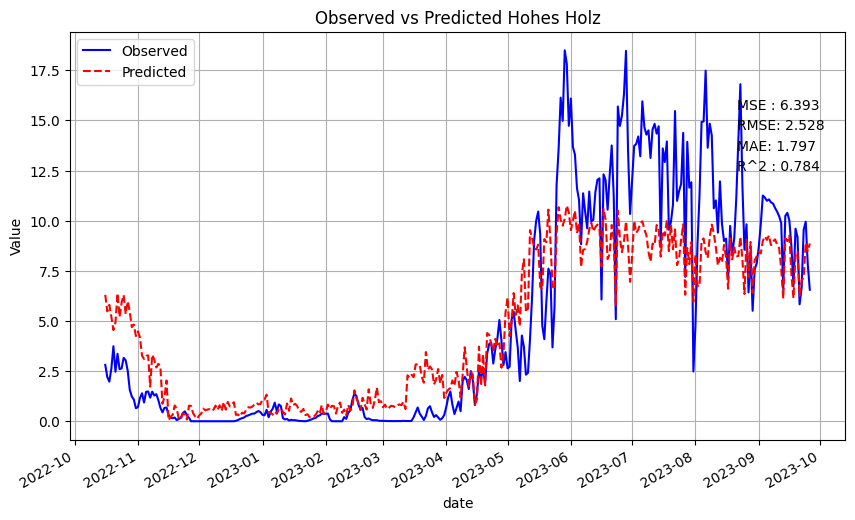

Estrees-Mons A28
Mean Squared Error: 10.316906012265028
Root Mean Squared Error: 3.211994086586248
MAE: 2.515258459566576
Test R^2 Score: 0.4487819519521088


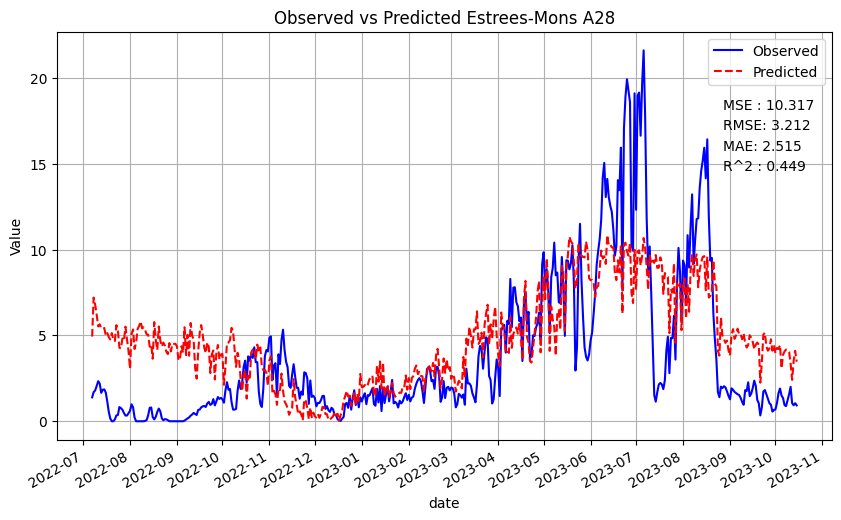

Torgnon
Mean Squared Error: 1.9876067368234545
Root Mean Squared Error: 1.4098250731290938
MAE: 1.077782998667483
Test R^2 Score: 0.7732033722618405


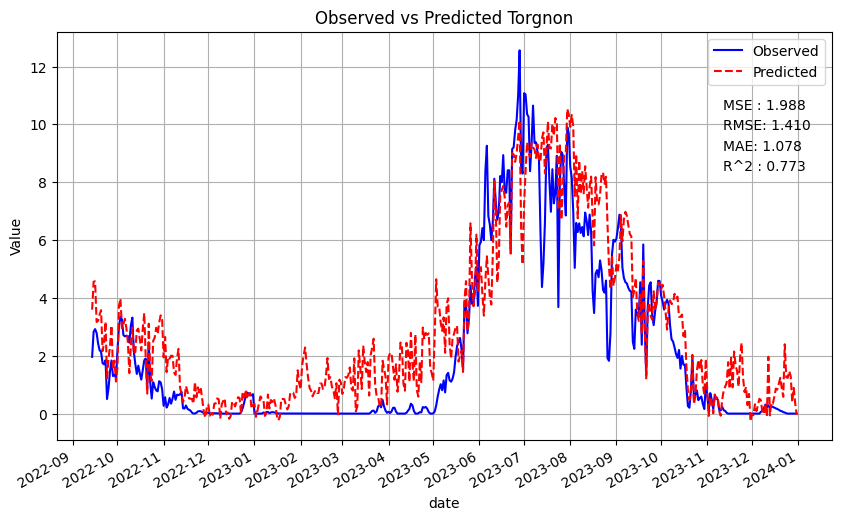

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


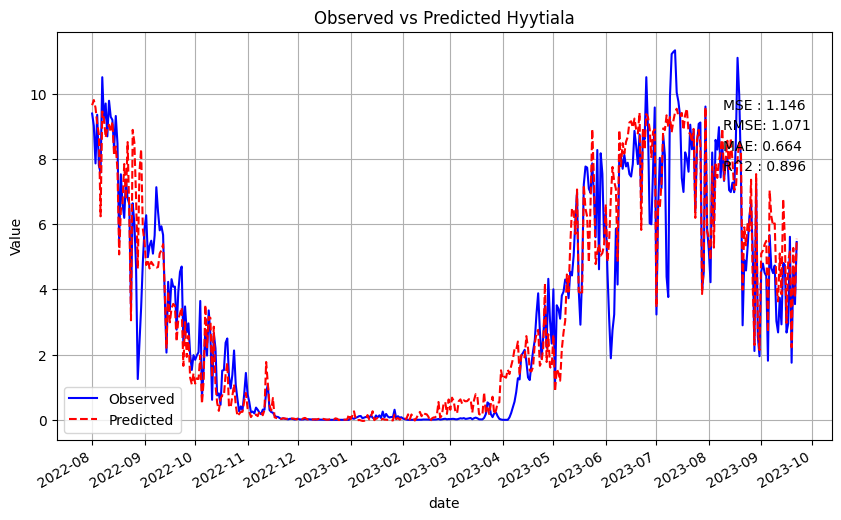

average MSE 4.960896337796415
average RMSE 2.0552096844108907
average MAE 1.513536099646507
average R2 0.7255687205032043
Mean Squared Error: 5.2195083189560005
Root Mean Squared Error: 2.2846243277519394
MAE: 1.7052134868950815
Test R^2 Score: 0.7529765202824721


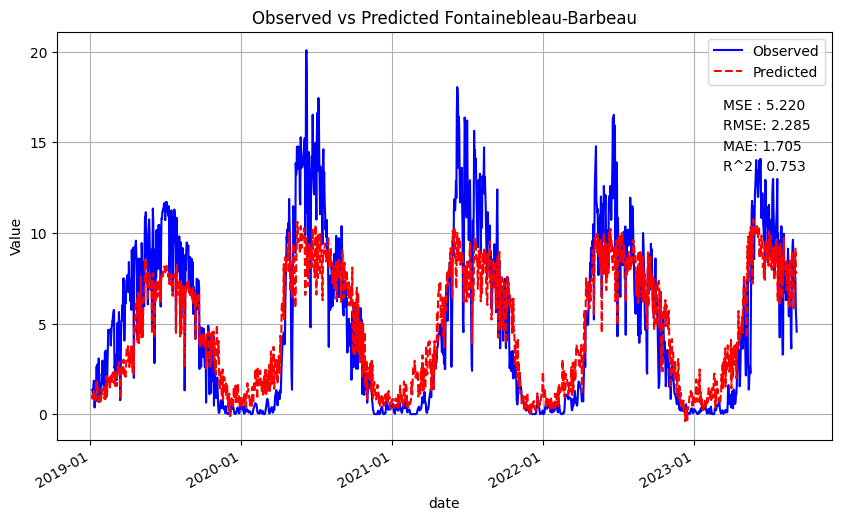

Mean Squared Error: 5.737907885112456
Root Mean Squared Error: 2.3953930544093294
MAE: 1.693880853430192
Test R^2 Score: 0.6171961658290377


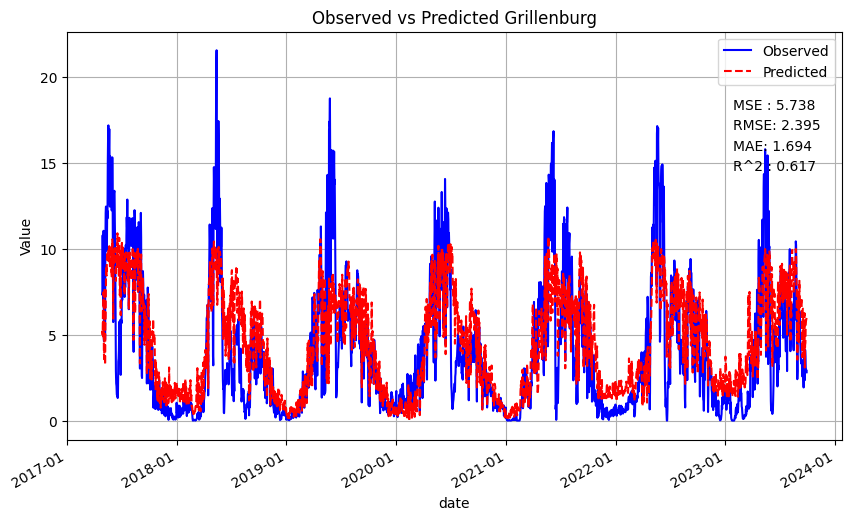

Mean Squared Error: 8.980963341236599
Root Mean Squared Error: 2.996825544010962
MAE: 2.134626296332218
Test R^2 Score: 0.4994683482734975


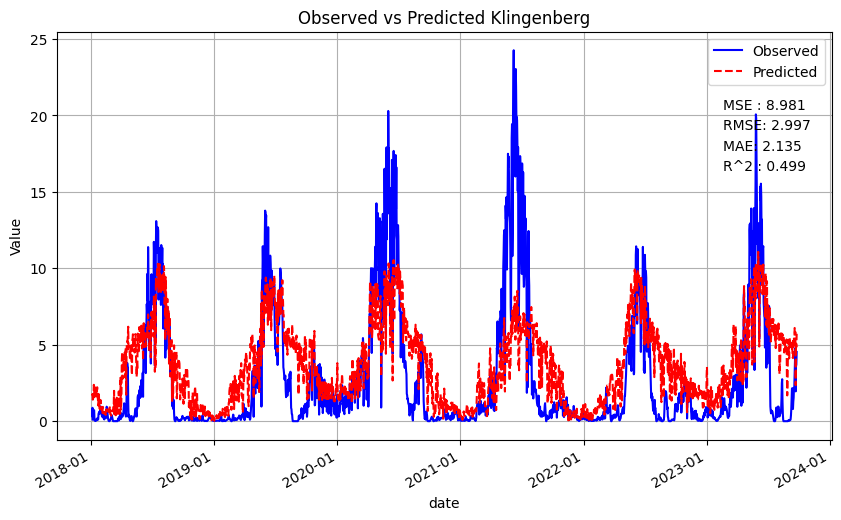

Mean Squared Error: 1.8724242897449048
Root Mean Squared Error: 1.368365554135628
MAE: 0.8839389400033311
Test R^2 Score: 0.842111511583598


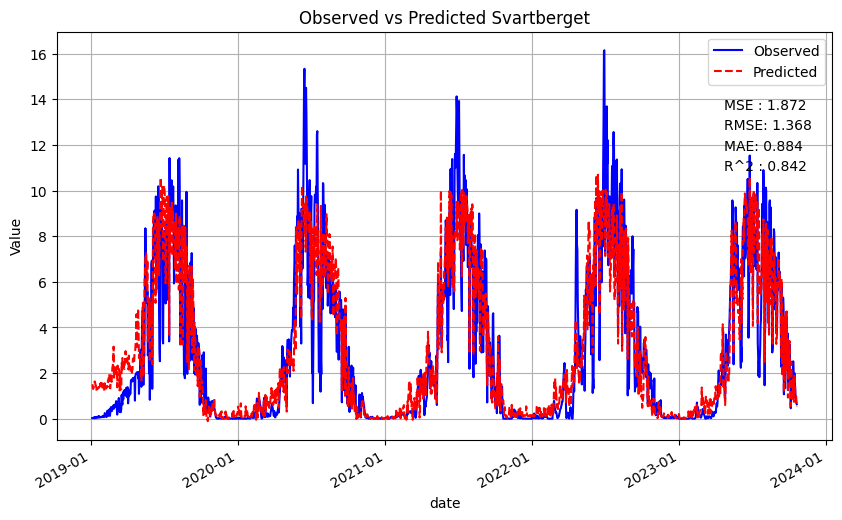

average MSE 5.45270095876249
average RMSE 2.261302120076965
average MAE 1.6044148941652057
average R2 0.6779381364921513


In [25]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


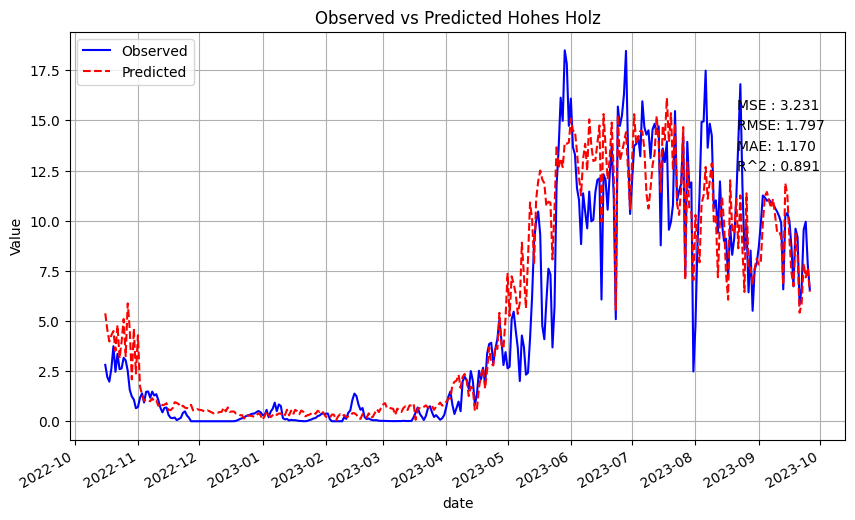

[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802763), ('CLr_lag_3', 0.004137076), ('MNDVI_lag_1', 0.0038376315), ('VPD_F_lag_1', 0.003605907), ('MNDVI_lag_4', 0.0035686286), ('H_F_MDS_lag_2', 0.0035593002), ('LW_IN_F', 0.003524408

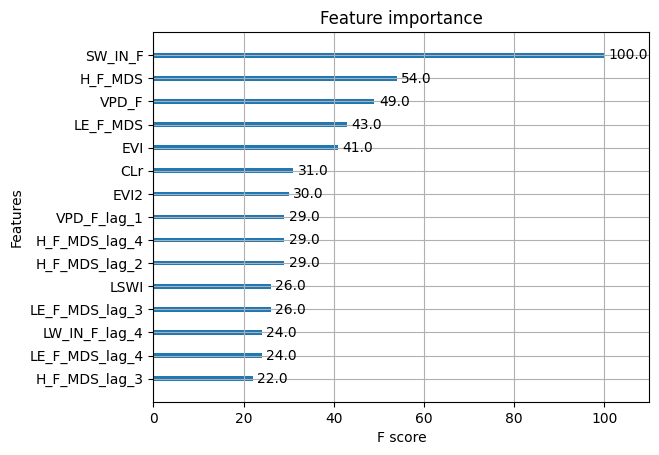

Retraining the model on the second site
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971
[('LE_F_MDS', 0.30837235), ('MNDVI', 0.1285871), ('MNDVI_lag_2', 0.026809068), ('LE_F_MDS_lag_2', 0.025664987), ('LE_F_MDS_lag_1', 0.025533214), ('MNDVI_lag_1', 0.024662469), ('MNDWI_lag_2', 0.024579242), ('LE_F_MDS_lag_3', 0.01966997), ('MNDWI', 0.015823487), ('EVI2', 0.013936798), ('EVI2_lag_4', 0.013723886), ('CLr_lag_2', 0.013663443), ('NDII_lag_1', 0.013500438), ('SW_IN_F', 0.013464811), ('CLr', 0.012967375), ('H_F_MDS_lag_2', 0.01279354), ('SW_IN_F_lag_2', 0.01272974), ('NDII', 0.0126902545), ('CLr_lag_4', 0.011405543), ('TA_F_lag_2', 0.011063257), ('TA_F_lag_3', 0.009907789), ('H_F_MDS_lag_3', 0.009108452), ('LE_F_MDS_lag_4', 0.008946519), ('LSWI_lag_2', 0.008938457), ('MNDWI_lag_4', 0.008272043), ('CLr_lag_3', 0.008150633), ('NDVI_lag_3', 0.0079636), ('H_F_MDS_lag_4', 0.007940694), ('CLr_lag_1', 0.00

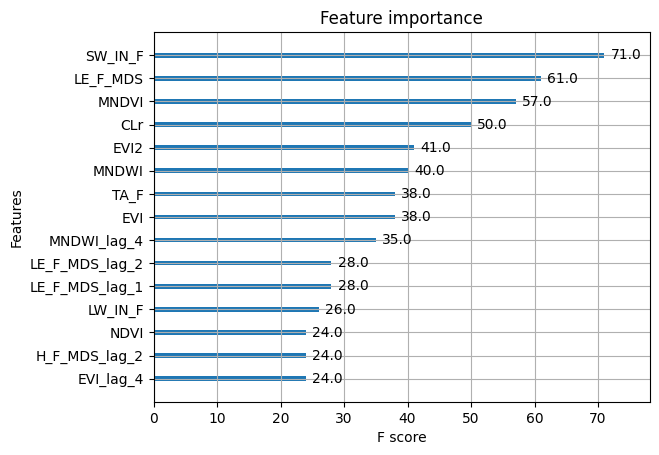

Retesting the model on the first site
Hohes Holz
Mean Squared Error: 6.778769022325301
Root Mean Squared Error: 2.6036069254642302
MAE: 1.9021045773770613
Test R^2 Score: 0.7709864714484194


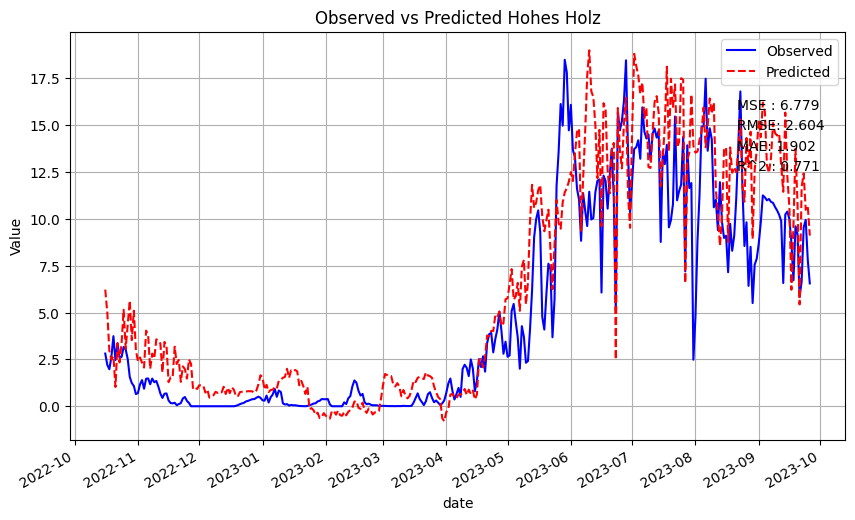

Estrees-Mons A28
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


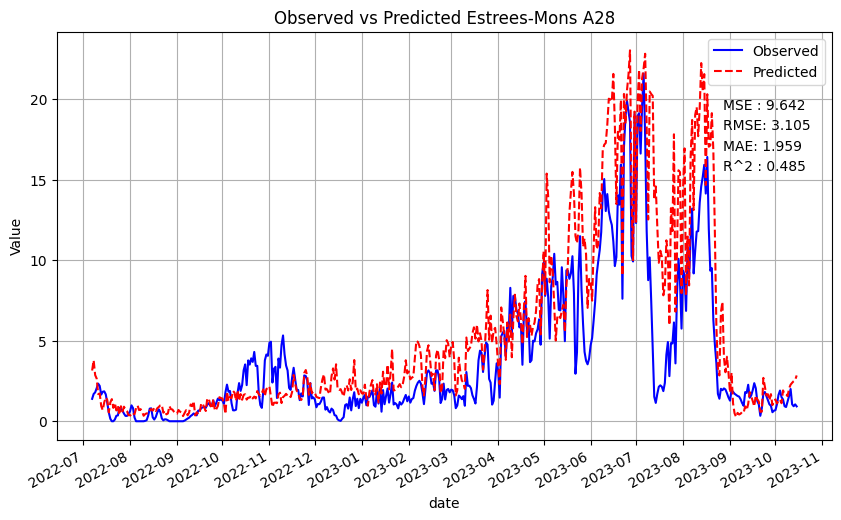

Retraining the model on the third site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.00305

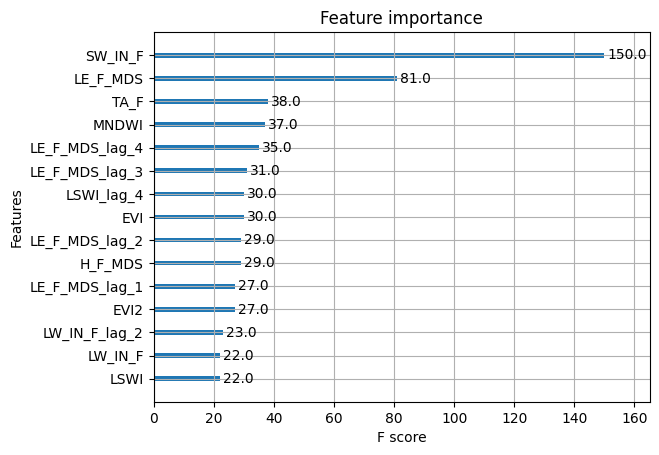

Hohes Holz
Retesting the model on the first and second site
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
mae: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


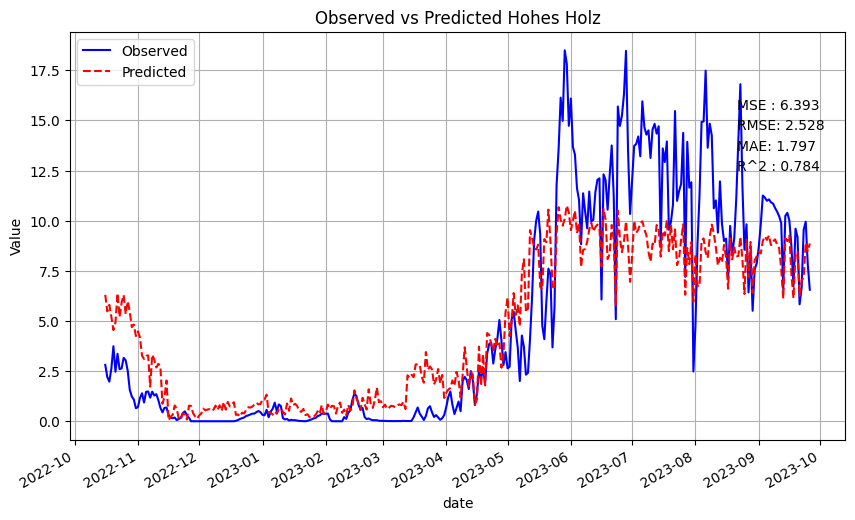

Estrees-Mons A28
Mean Squared Error: 10.316906012265028
Root Mean Squared Error: 3.211994086586248
MAE: 2.515258459566576
Test R^2 Score: 0.4487819519521088


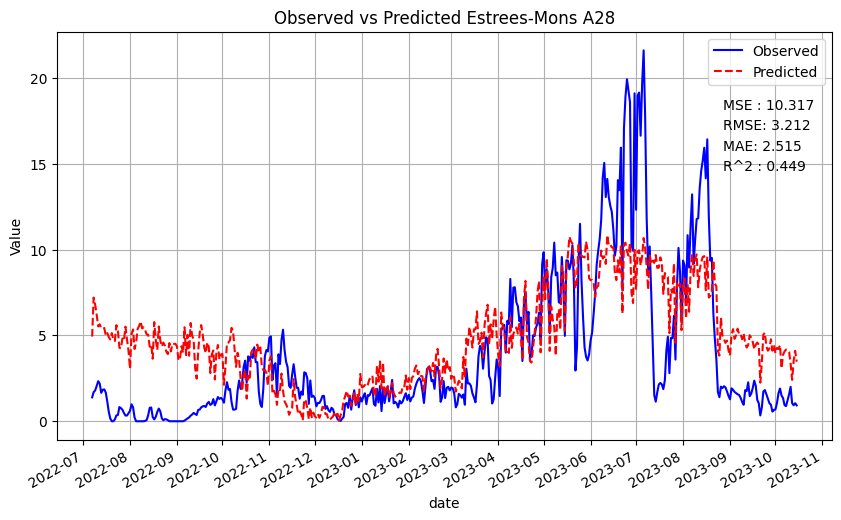

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


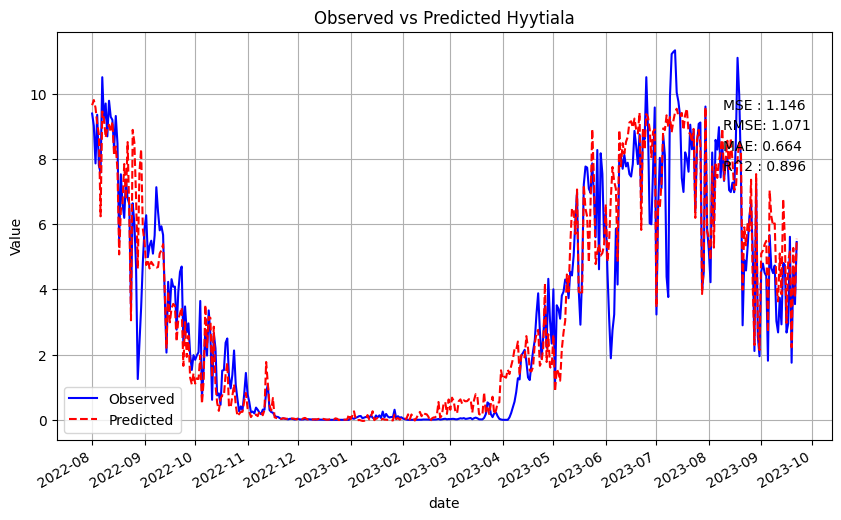

Retraining the model on the fourth site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675)

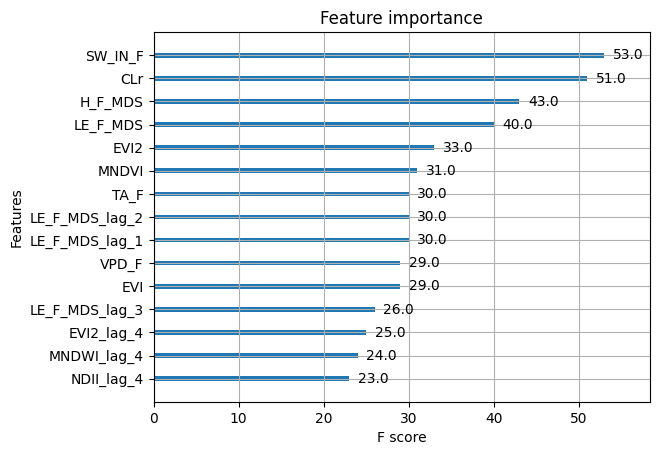

Hohes Holz
Retesting the model on the first, second, and third site
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
MAE: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


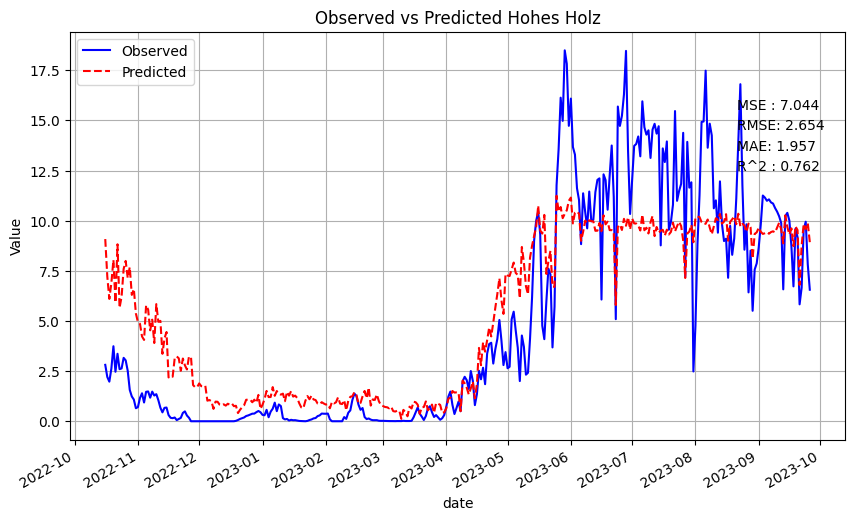

Estrees-Mons A28
Mean Squared Error: 7.6692101714802465
Root Mean Squared Error: 2.769333885879463
MAE: 1.9817319979385093
Test R^2 Score: 0.5902446861717345


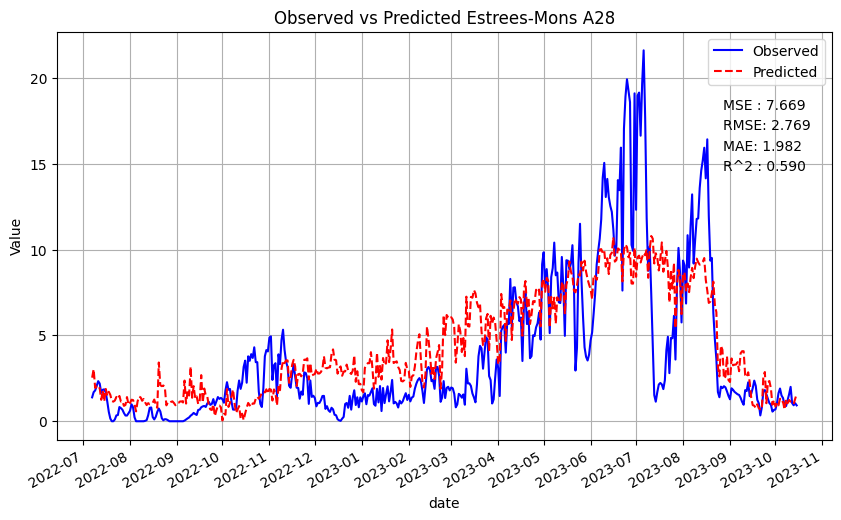

Hyytiala
Mean Squared Error: 4.769703115476459
Root Mean Squared Error: 2.183964998683921
MAE: 1.8498623255123605
Test R^2 Score: 0.5683290472428284


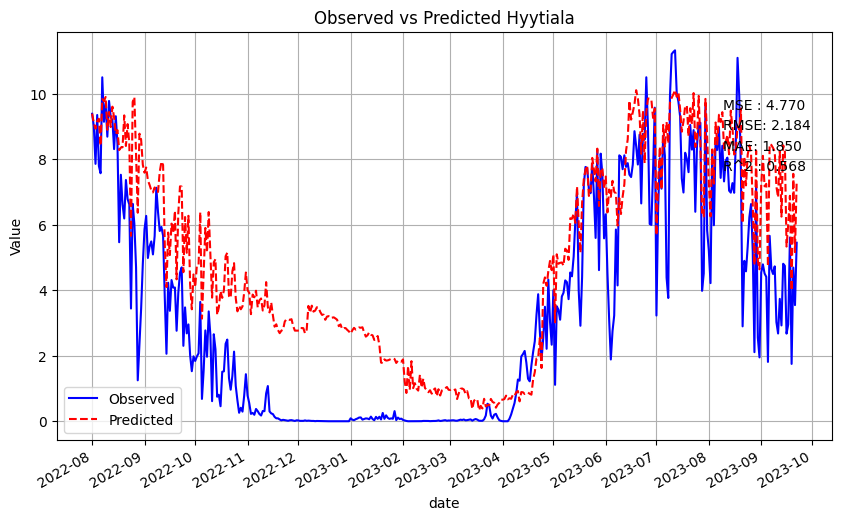

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


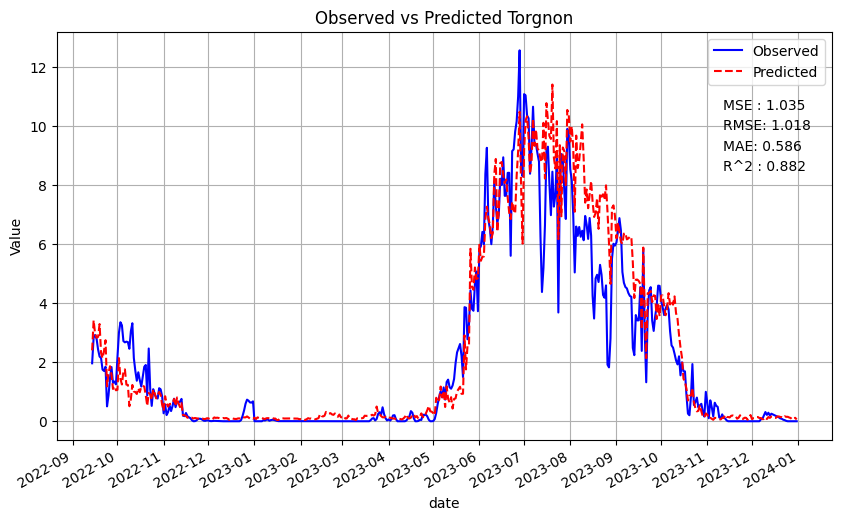

average MSE 5.129678120244028
average RMSE 2.1562470795054636
average MAE 1.5935974697183473
average R2 0.7006093928896935
Mean Squared Error: 7.010887217546346
Root Mean Squared Error: 2.6478080023948762
MAE: 2.169188281177406
Test R^2 Score: 0.6681959965279184


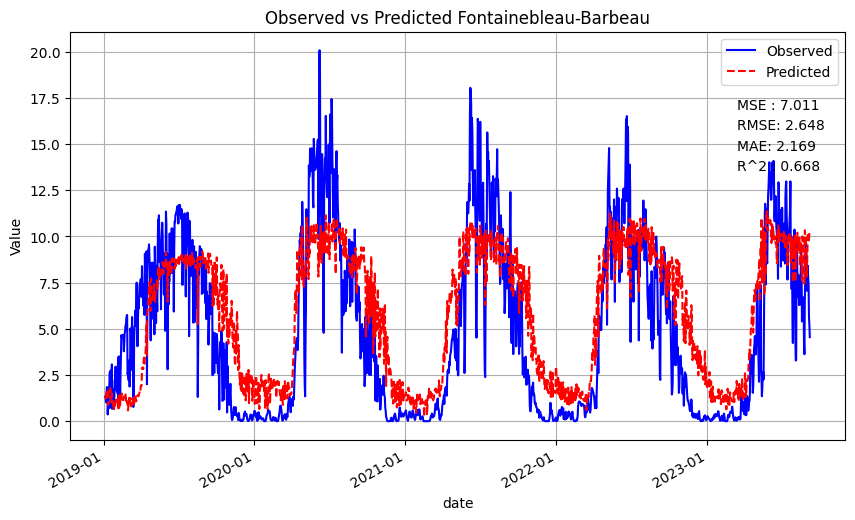

Mean Squared Error: 7.964564135762367
Root Mean Squared Error: 2.822155937534701
MAE: 2.243109424285924
Test R^2 Score: 0.46864506197791334


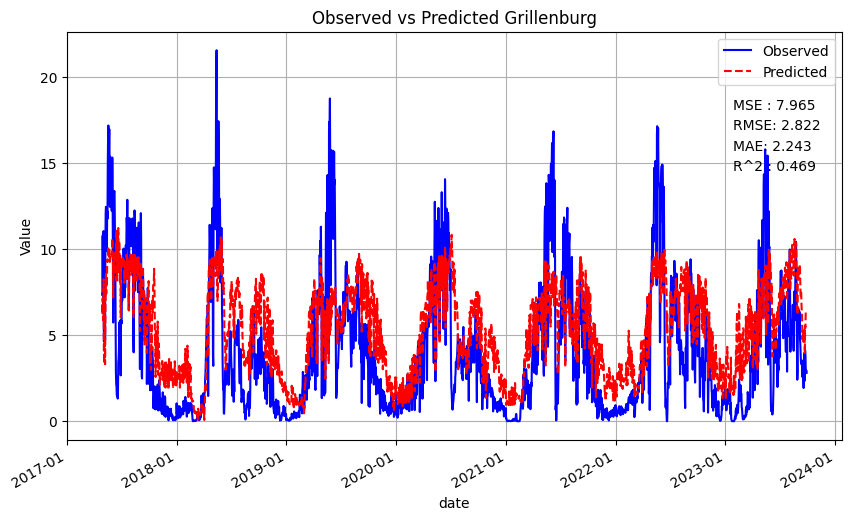

Mean Squared Error: 6.932499642925979
Root Mean Squared Error: 2.632964041327944
MAE: 1.6707181600318461
Test R^2 Score: 0.6136343769565649


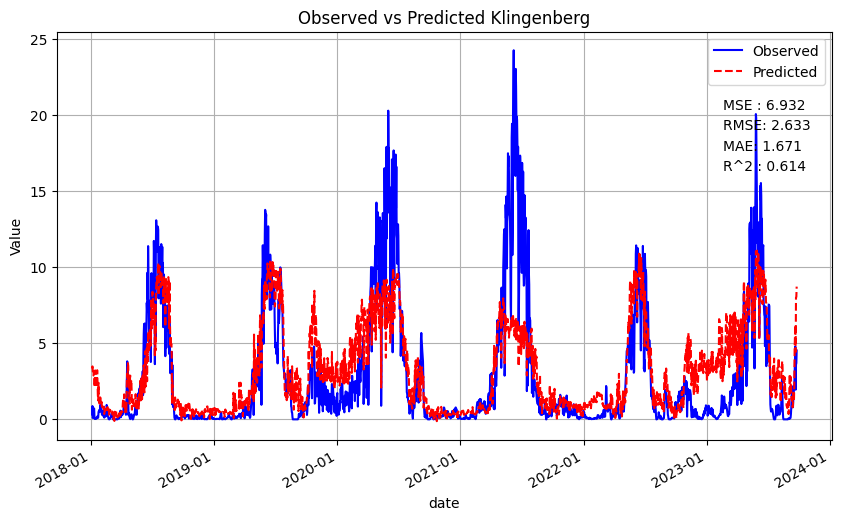

Mean Squared Error: 11.050387002417414
Root Mean Squared Error: 3.3242122378719166
MAE: 2.9661880328847645
Test R^2 Score: 0.06819789201429383


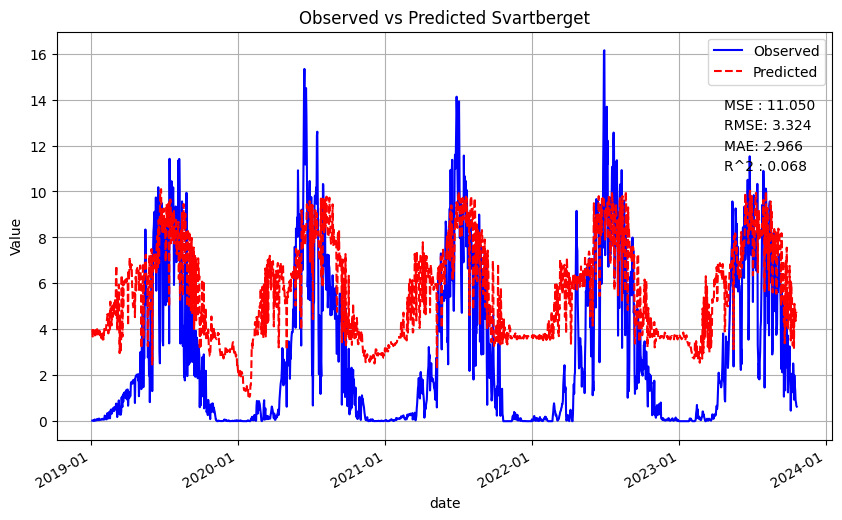

average MSE 8.239584499663026
average RMSE 2.85678505478236
average MAE 2.2623009745949854
average R2 0.4546683318691726


In [26]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =[
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv'
 ]

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,col2)

order as usual

eta_0.1_max_depth_4_min_child_weight_5_gamma_0.1_alpha_0.1_L_5
First training and testing the model on the first site
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


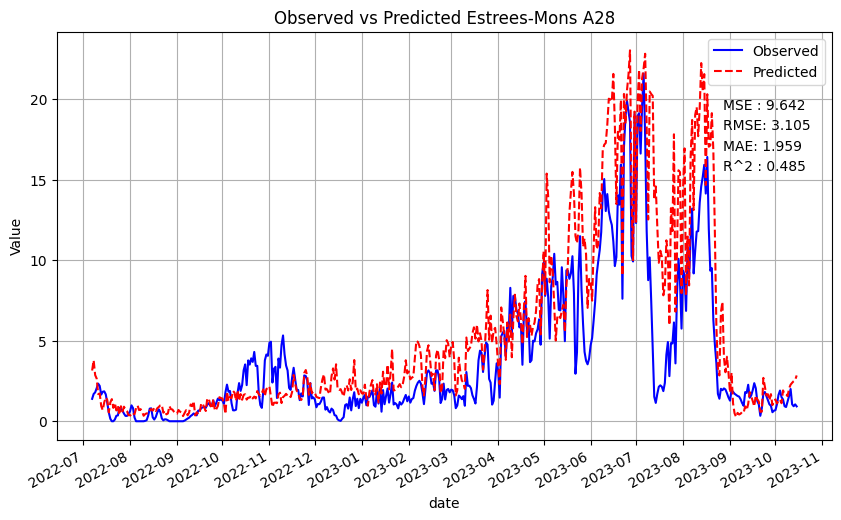

[('LE_F_MDS', 0.30837235), ('MNDVI', 0.1285871), ('MNDVI_lag_2', 0.026809068), ('LE_F_MDS_lag_2', 0.025664987), ('LE_F_MDS_lag_1', 0.025533214), ('MNDVI_lag_1', 0.024662469), ('MNDWI_lag_2', 0.024579242), ('LE_F_MDS_lag_3', 0.01966997), ('MNDWI', 0.015823487), ('EVI2', 0.013936798), ('EVI2_lag_4', 0.013723886), ('CLr_lag_2', 0.013663443), ('NDII_lag_1', 0.013500438), ('SW_IN_F', 0.013464811), ('CLr', 0.012967375), ('H_F_MDS_lag_2', 0.01279354), ('SW_IN_F_lag_2', 0.01272974), ('NDII', 0.0126902545), ('CLr_lag_4', 0.011405543), ('TA_F_lag_2', 0.011063257), ('TA_F_lag_3', 0.009907789), ('H_F_MDS_lag_3', 0.009108452), ('LE_F_MDS_lag_4', 0.008946519), ('LSWI_lag_2', 0.008938457), ('MNDWI_lag_4', 0.008272043), ('CLr_lag_3', 0.008150633), ('NDVI_lag_3', 0.0079636), ('H_F_MDS_lag_4', 0.007940694), ('CLr_lag_1', 0.006987298), ('LW_IN_F', 0.0065393858), ('LW_IN_F_lag_3', 0.0061915186), ('EVI2_lag_1', 0.006149974), ('NDII_lag_2', 0.00602621), ('NDVI', 0.0055614747), ('MNDWI_lag_3', 0.0054917517),

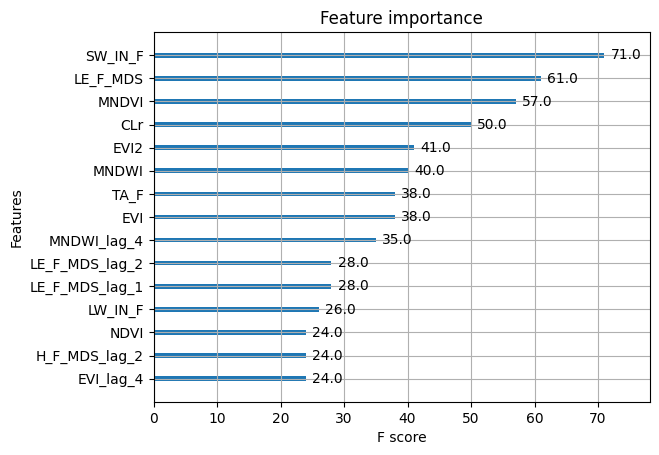

Retraining the model on the second site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585
[('LE_F_MDS', 0.45457795), ('EVI2_lag_1', 0.065680616), ('LE_F_MDS_lag_3', 0.053314924), ('EVI', 0.045494057), ('SW_IN_F', 0.03996278), ('LSWI', 0.03299866), ('LE_F_MDS_lag_2', 0.022927372), ('EVI_lag_4', 0.017259302), ('LSWI_lag_3', 0.014410694), ('EVI2', 0.011987579), ('H_F_MDS_lag_4', 0.008435284), ('H_F_MDS', 0.008415094), ('NDII_lag_1', 0.008176291), ('MNDWI_lag_2', 0.007892476), ('H_F_MDS_lag_3', 0.007691132), ('NDII_lag_4', 0.0075869844), ('NDVI_lag_3', 0.007415443), ('NDII', 0.0073430627), ('LE_F_MDS_lag_4', 0.00718385), ('MNDWI_lag_1', 0.0071418034), ('NDVI_lag_4', 0.006879423), ('VPD_F', 0.0060212743), ('NDVI_lag_1', 0.005382438), ('LSWI_lag_1', 0.0051316223), ('EVI_lag_3', 0.0050652646), ('MNDVI', 0.0050021107), ('TA_F_lag_3', 0.0044356813), ('MNDVI_lag_2', 0.0042595053), ('EVI2_lag_3', 0.0041802

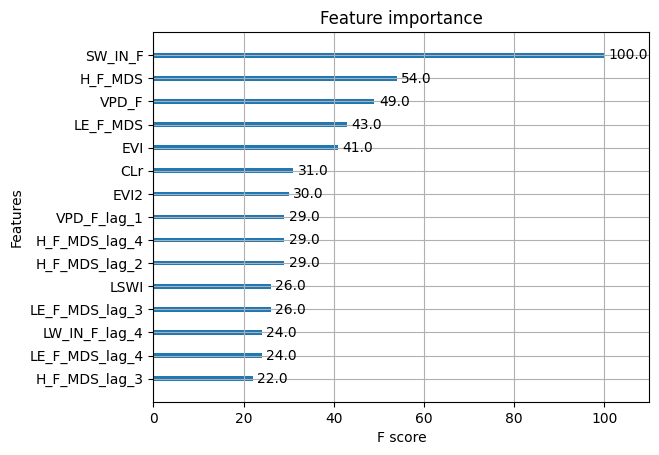

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 16.398530737101844
Root Mean Squared Error: 4.049509937893948
MAE: 3.0835000361674787
Test R^2 Score: 0.12384913723042446


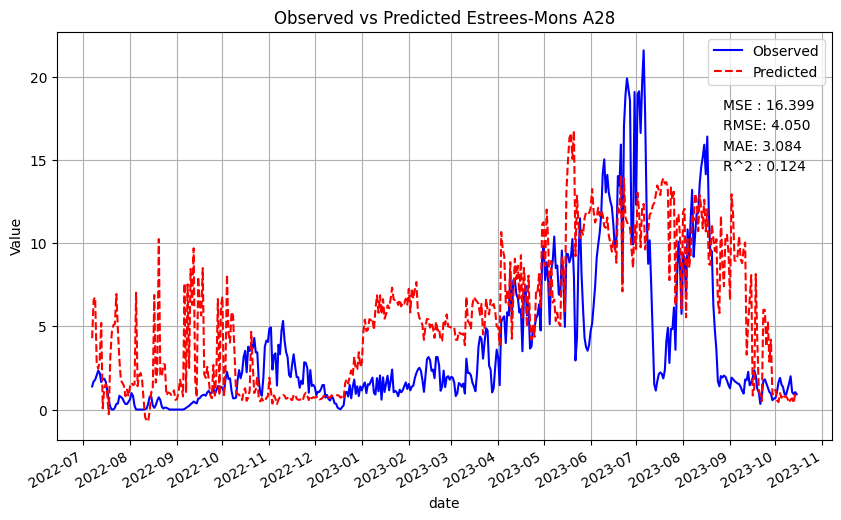

Hohes Holz
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


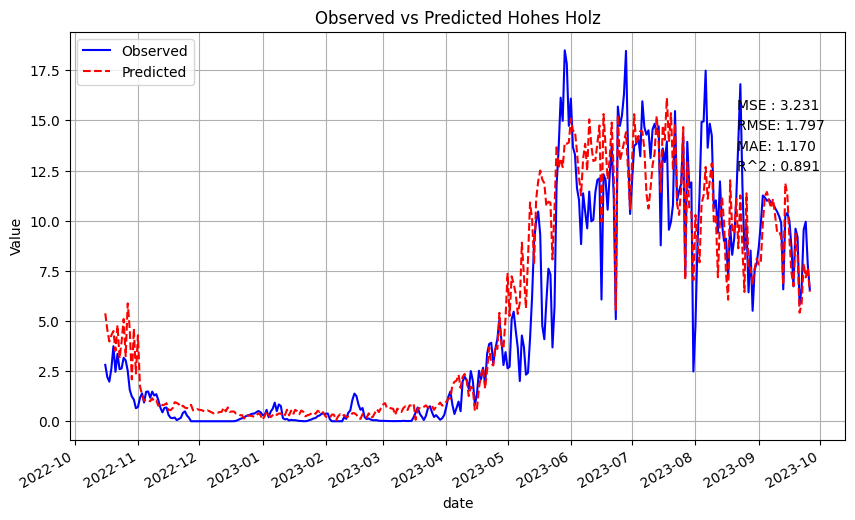

Retraining the model on the third site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.3477239), ('TA_F_lag_1', 0.1912164), ('TA_F_lag_4', 0.093197234), ('MNDVI', 0.052127928), ('TA_F_lag_2', 0.03458341), ('SW_IN_F', 0.034437444), ('LE_F_MDS', 0.028226603), ('CLr_lag_4', 0.018548196), ('CLr_lag_3', 0.014316784), ('MNDVI_lag_4', 0.012052559), ('VPD_F', 0.009530329), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.0070931544), ('LSWI', 0.00579112), ('LW_IN_F_lag_2', 0.005445865), ('CLr_lag_1', 0.005214915), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.0047189915), ('CLr', 0.0043988647), ('EVI2_lag_4', 0.003970076), ('MNDWI', 0.003838156), ('EVI', 0.00373046), ('LE_F_MDS_lag_4', 0.0036983707), ('LE_F_MDS_lag_2', 0.0036768764), ('NDVI_lag_2', 0.003586574), ('EVI2_lag_1', 0.0034675484), ('LSWI_lag_1', 0.003284447), ('NDII', 0.003230971), ('LSWI_lag_3', 0.003085542), ('H_F_MDS', 0.00305

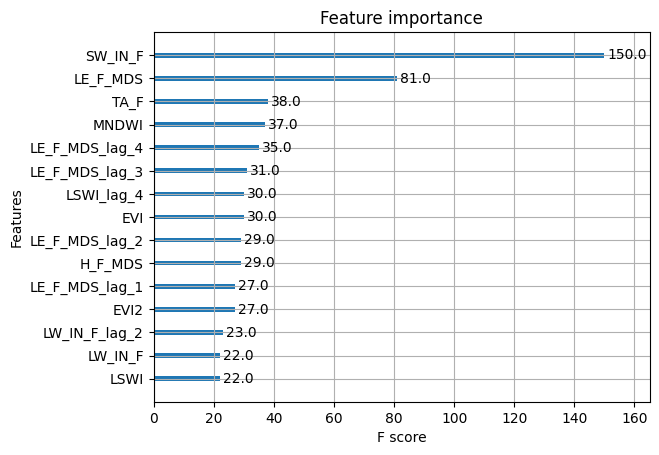

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 10.316906012265028
Root Mean Squared Error: 3.211994086586248
mae: 2.515258459566576
Test R^2 Score: 0.4487819519521088


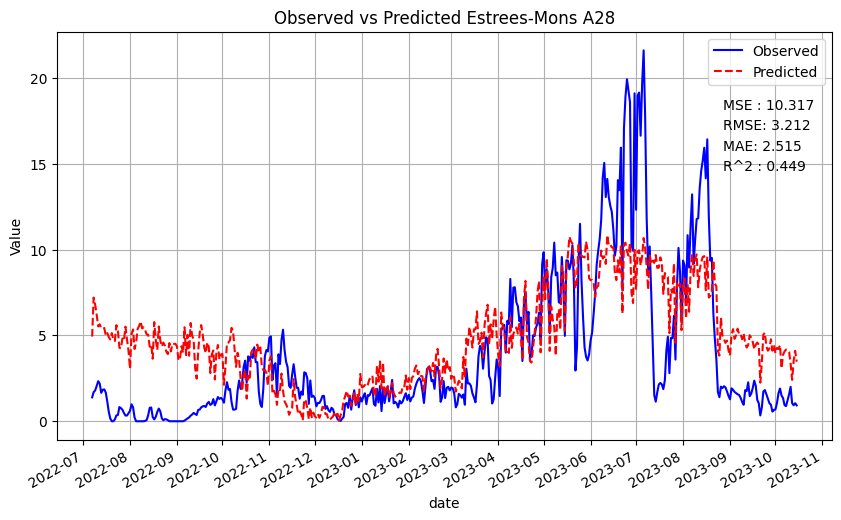

Hohes Holz
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
MAE: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


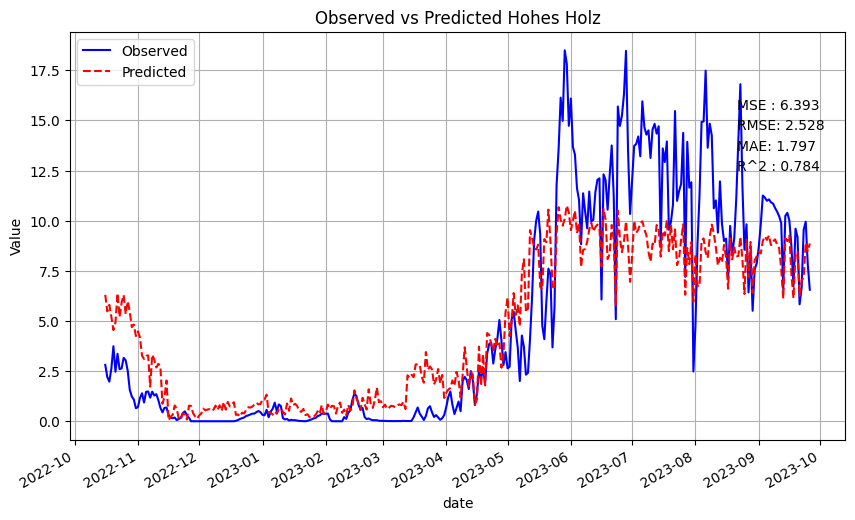

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


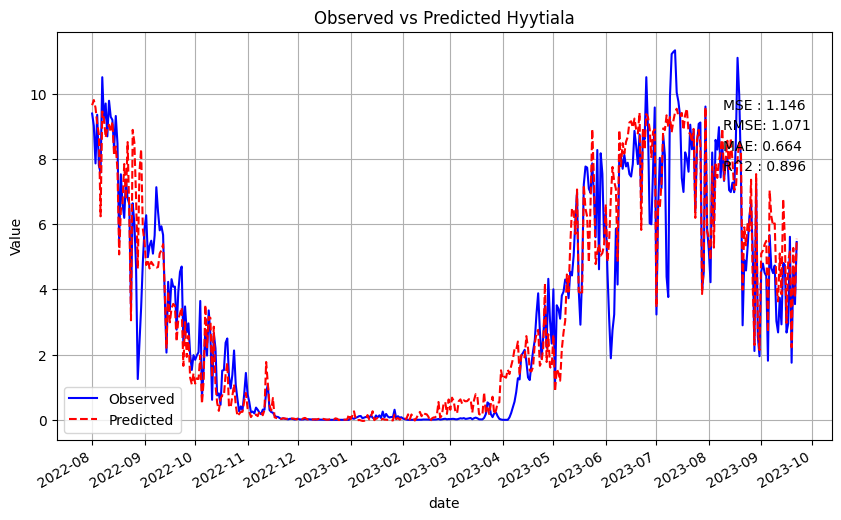

Retraining the model on the fourth site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308976), ('LE_F_MDS', 0.09950639), ('LE_F_MDS_lag_4', 0.025698015), ('MNDVI', 0.01915283), ('SW_IN_F', 0.014785028), ('MNDWI_lag_1', 0.014454928), ('NDVI_lag_4', 0.011595109), ('EVI', 0.010179486), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864086), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347098), ('NDII_lag_2', 0.00810241), ('EVI2', 0.007951391), ('MNDWI_lag_2', 0.0077875713), ('P_F_lag_4', 0.007503397), ('MNDVI_lag_1', 0.0068631927), ('NDII', 0.0067538903), ('TA_F', 0.0066642133), ('MNDWI', 0.0065339585), ('EVI2_lag_2', 0.006232212), ('LSWI_lag_1', 0.0061676414), ('H_F_MDS', 0.0055597182), ('LSWI', 0.0053302874), ('EVI_lag_1', 0.0052597714), ('LSWI_lag_3', 0.005246479), ('PA_F', 0.005167632), ('NDVI_lag_1', 0.0047519878), ('MNDVI_lag_4', 0.0045834663), ('SW_IN_F_lag_3', 0.0044187675)

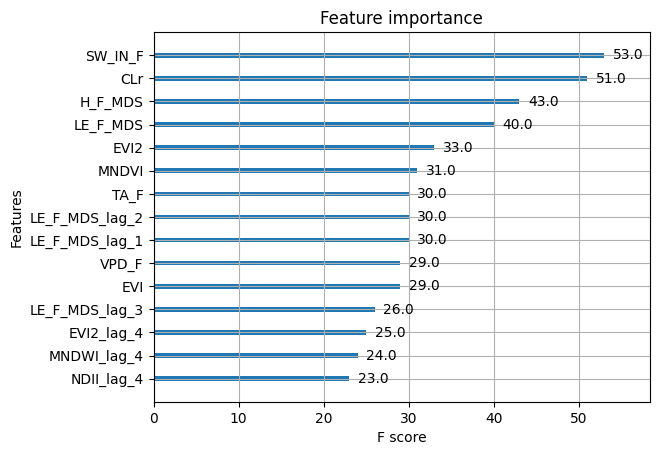

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 7.6692101714802465
Root Mean Squared Error: 2.769333885879463
MAE: 1.9817319979385093
Test R^2 Score: 0.5902446861717345


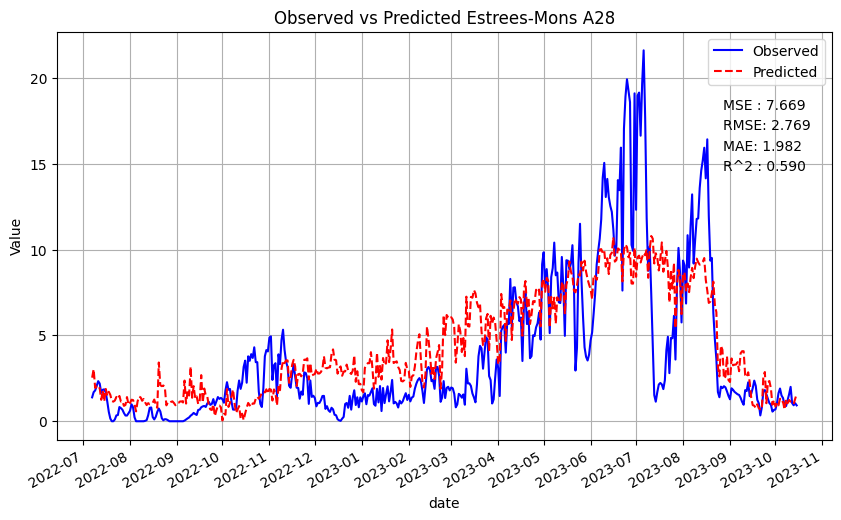

Hohes Holz
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
MAE: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


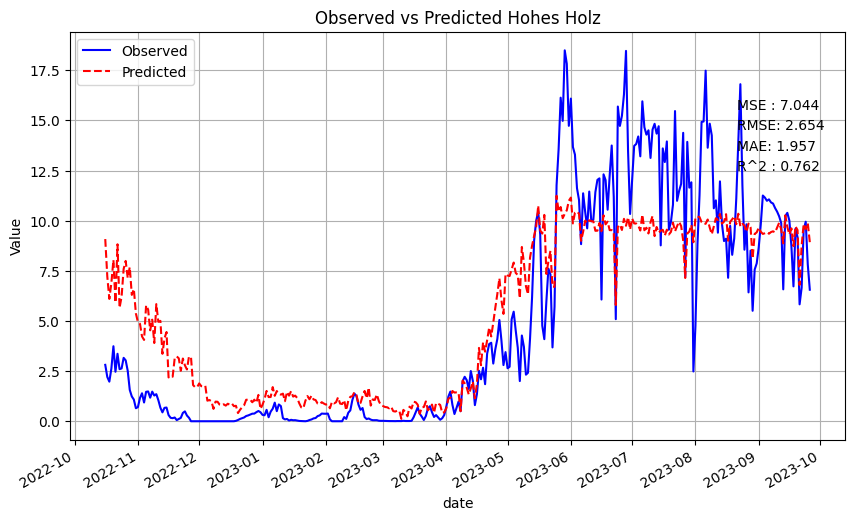

Hyytiala
Mean Squared Error: 4.769703115476459
Root Mean Squared Error: 2.183964998683921
MAE: 1.8498623255123605
Test R^2 Score: 0.5683290472428284


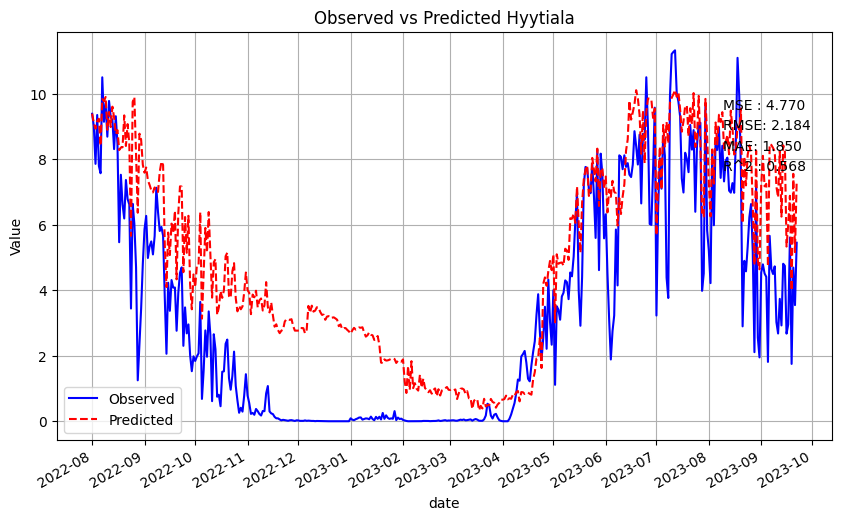

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


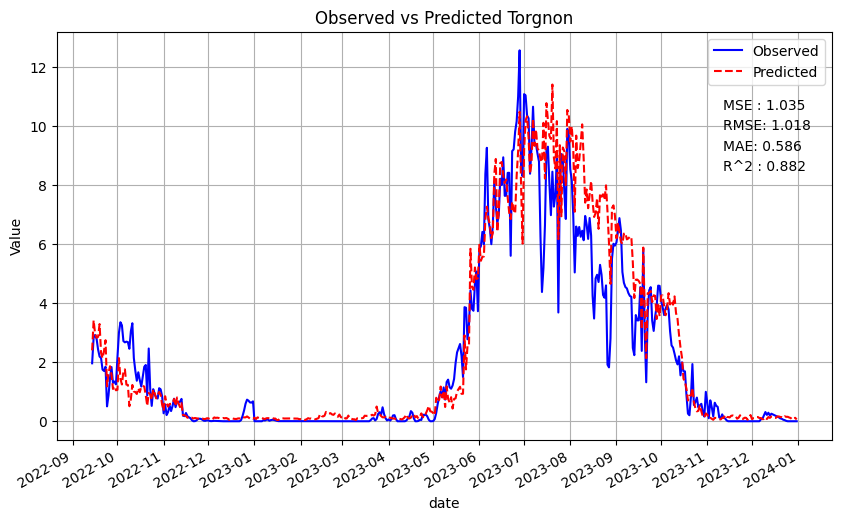

average MSE 5.129678120244029
average RMSE 2.1562470795054636
average MAE 1.5935974697183473
average R2 0.7006093928896935
Mean Squared Error: 7.010887217546346
Root Mean Squared Error: 2.6478080023948762
MAE: 2.169188281177406
Test R^2 Score: 0.6681959965279184


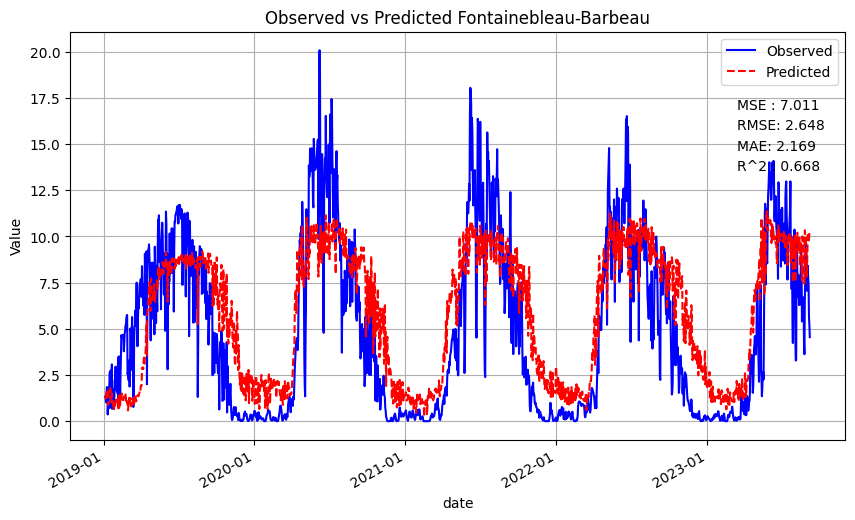

Mean Squared Error: 7.964564135762367
Root Mean Squared Error: 2.822155937534701
MAE: 2.243109424285924
Test R^2 Score: 0.46864506197791334


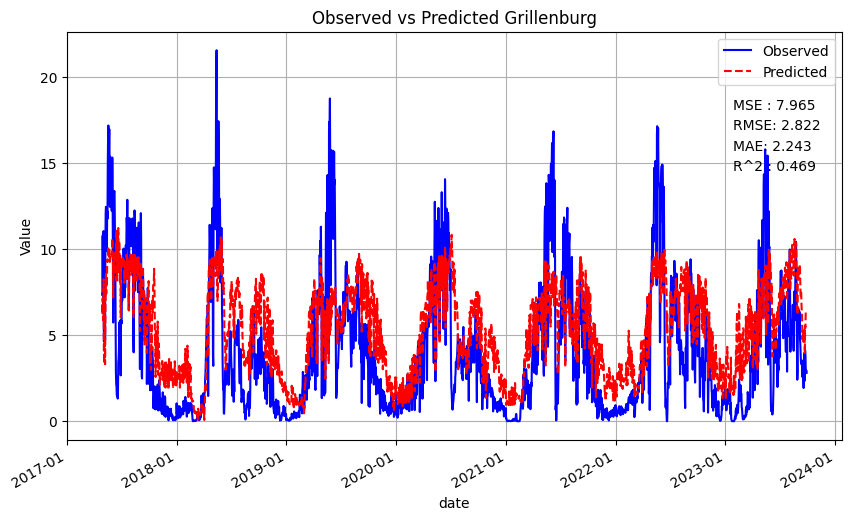

Mean Squared Error: 6.932499642925979
Root Mean Squared Error: 2.632964041327944
MAE: 1.6707181600318461
Test R^2 Score: 0.6136343769565649


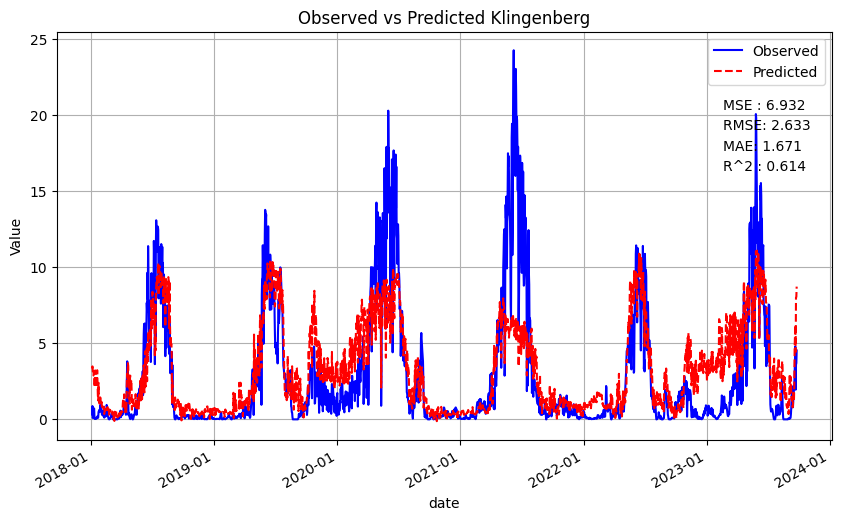

Mean Squared Error: 11.050387002417414
Root Mean Squared Error: 3.3242122378719166
MAE: 2.9661880328847645
Test R^2 Score: 0.06819789201429383


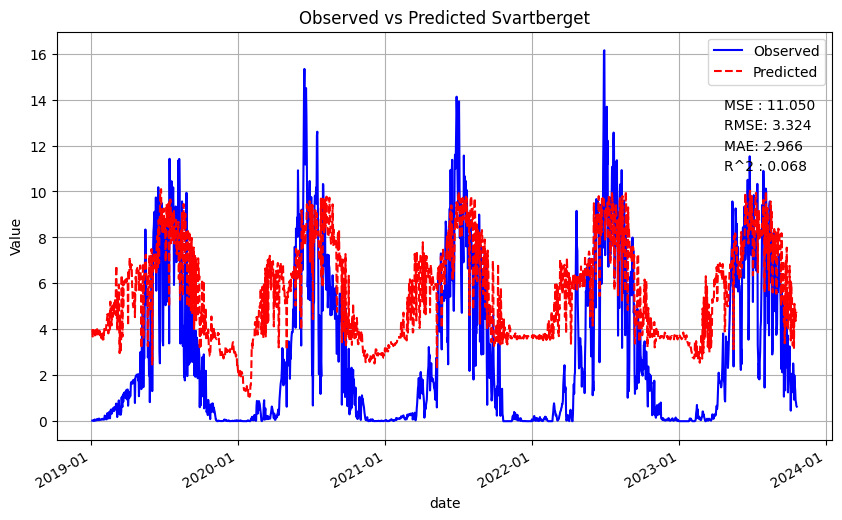

average MSE 8.239584499663026
average RMSE 2.85678505478236
average MAE 2.2623009745949854
average R2 0.4546683318691726


In [27]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}"
print(params)
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,col2)

First training and testing the model on the first site
Mean Squared Error: 9.465768371025092
Root Mean Squared Error: 3.076648886536306
MAE: 1.910149263594913
Test R^2 Score: 0.49425706131790215


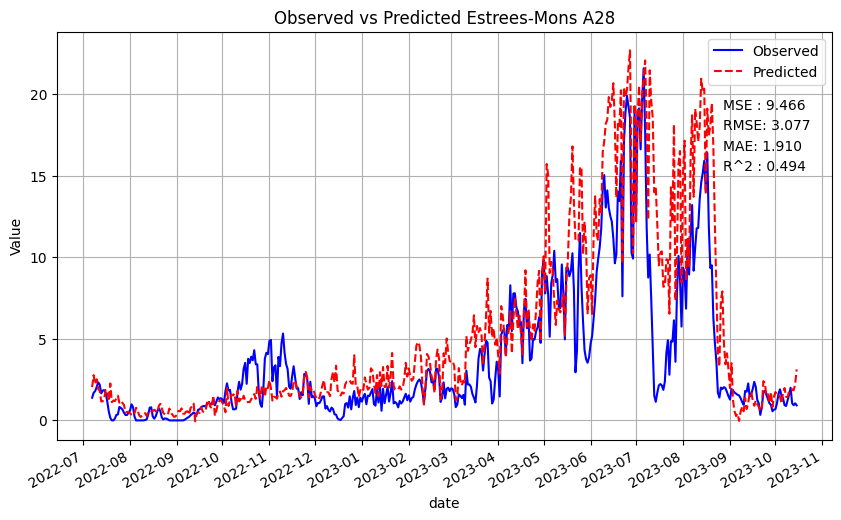

[('LE_F_MDS', 0.24894321), ('MNDVI', 0.10741146), ('MNDVI_lag_1', 0.063410826), ('fall', 0.041092247), ('MNDVI_lag_2', 0.04048228), ('LE_F_MDS_lag_2', 0.034225833), ('LE_F_MDS_lag_1', 0.02503818), ('MNDWI_lag_2', 0.021713726), ('NDII', 0.019451527), ('EVI2', 0.01826182), ('LE_F_MDS_lag_3', 0.015976664), ('NDII_lag_1', 0.014063095), ('summer', 0.013588612), ('CLr', 0.013096116), ('SW_IN_F', 0.012590115), ('MNDVI_lag_4', 0.012075021), ('CLr_lag_4', 0.011988441), ('MNDWI', 0.011918321), ('H_F_MDS_lag_4', 0.011882611), ('CLr_lag_2', 0.011849691), ('LW_IN_F', 0.011750524), ('LE_F_MDS_lag_4', 0.010452358), ('H_F_MDS_lag_2', 0.010197627), ('EVI2_lag_4', 0.01003931), ('MNDWI_lag_1', 0.008798148), ('H_F_MDS_lag_1', 0.0086675305), ('MNDWI_lag_4', 0.007973005), ('TA_F_lag_2', 0.0072843926), ('SW_IN_F_lag_4', 0.0070879557), ('NDVI_lag_3', 0.0069006397), ('NDVI_lag_4', 0.0062663937), ('TA_F_lag_3', 0.00605741), ('CLr_lag_1', 0.005855649), ('EVI2_lag_1', 0.00568416), ('NDVI_lag_2', 0.005575477), ('T

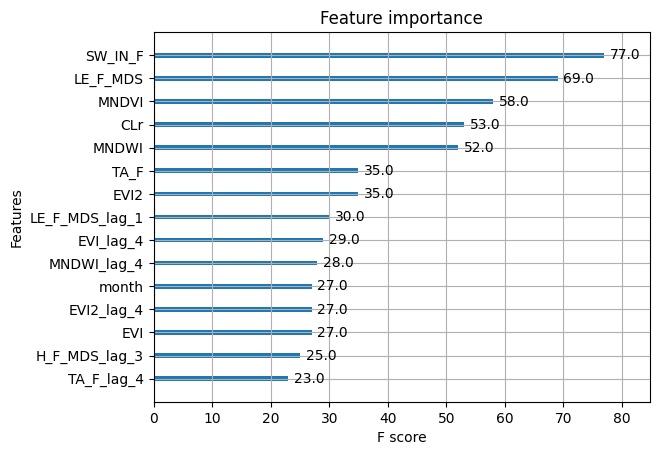

Retraining the model on the second site
Mean Squared Error: 3.7117558192956968
Root Mean Squared Error: 1.9265917624903561
MAE: 1.2611971187511535
Test R^2 Score: 0.8746022626675687
[('LE_F_MDS', 0.42523727), ('EVI', 0.05969915), ('month', 0.04833275), ('SW_IN_F', 0.03975431), ('LE_F_MDS_lag_3', 0.039602235), ('LSWI', 0.035668984), ('EVI2_lag_1', 0.032763563), ('fall', 0.03236487), ('LE_F_MDS_lag_2', 0.017012602), ('LSWI_lag_3', 0.015227992), ('spring', 0.010423303), ('NDVI_lag_4', 0.010051305), ('NDVI_lag_1', 0.008261673), ('EVI_lag_3', 0.00783051), ('NDII', 0.0075301626), ('EVI2', 0.007094128), ('LE_F_MDS_lag_4', 0.0067157354), ('H_F_MDS', 0.0064203674), ('CLr_lag_2', 0.0063144015), ('VPD_F', 0.0058115777), ('TA_F_lag_2', 0.0056527457), ('MNDVI_lag_1', 0.005624727), ('MNDVI', 0.0052670143), ('LSWI_lag_1', 0.00497759), ('NDII_lag_3', 0.004688695), ('CLr', 0.004642994), ('LSWI_lag_4', 0.004589651), ('NDII_lag_1', 0.004454336), ('TA_F_lag_4', 0.0043543074), ('EVI2_lag_3', 0.0043191807),

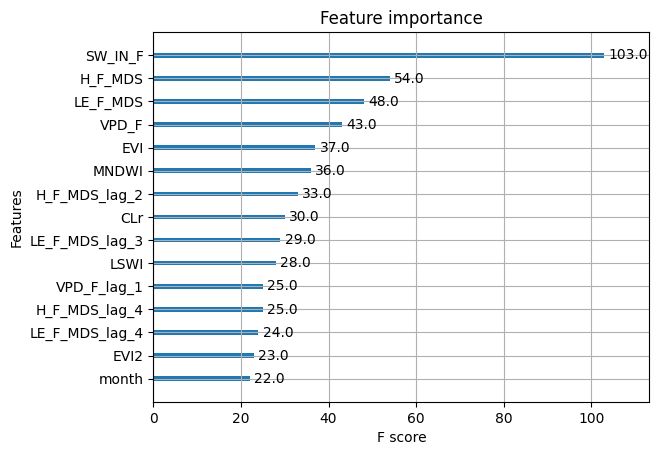

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 17.18938375915802
Root Mean Squared Error: 4.146008171622196
MAE: 3.2364936455024247
Test R^2 Score: 0.0815949518581498


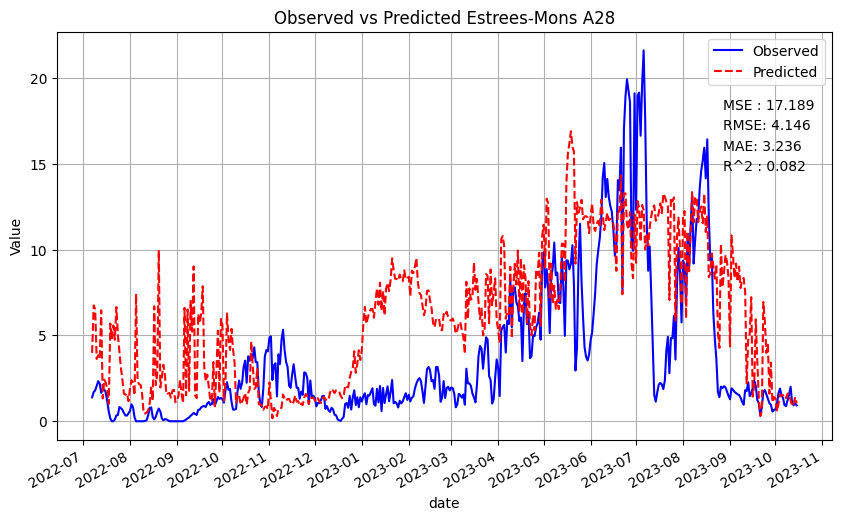

Hohes Holz
Mean Squared Error: 3.7117558192956968
Root Mean Squared Error: 1.9265917624903561
MAE: 1.2611971187511535
Test R^2 Score: 0.8746022626675687


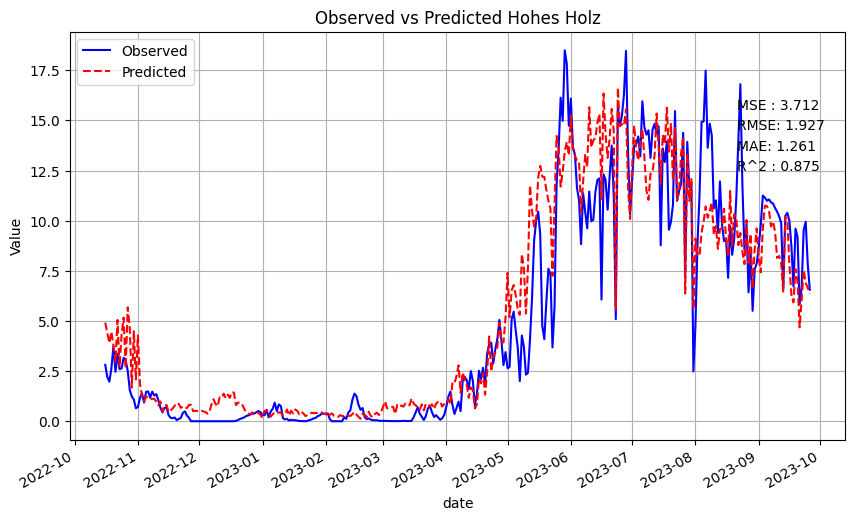

Retraining the model on the third site
Mean Squared Error: 1.09064877526237
Root Mean Squared Error: 1.0443413116708398
MAE: 0.6612642373612412
Test R^2 Score: 0.9012933542103868
[('TA_F', 0.38896132), ('TA_F_lag_1', 0.13181455), ('TA_F_lag_4', 0.07675126), ('TA_F_lag_3', 0.065015), ('MNDVI', 0.052454982), ('TA_F_lag_2', 0.04354237), ('SW_IN_F', 0.02609131), ('LE_F_MDS', 0.017945444), ('month', 0.016477315), ('CLr_lag_3', 0.012922014), ('MNDVI_lag_1', 0.012496817), ('CLr_lag_4', 0.009831054), ('CLr_lag_2', 0.008676651), ('NDVI_lag_4', 0.0077678706), ('VPD_F', 0.0058453744), ('LSWI_lag_4', 0.0054970263), ('LSWI', 0.005352938), ('EVI_lag_3', 0.0043314495), ('LSWI_lag_1', 0.004170301), ('MNDVI_lag_2', 0.004043171), ('LW_IN_F_lag_2', 0.0033190565), ('LW_IN_F_lag_1', 0.0031009398), ('LE_F_MDS_lag_1', 0.0030607206), ('CLr', 0.0030605793), ('EVI', 0.0029531545), ('MNDWI', 0.002743911), ('LE_F_MDS_lag_4', 0.0027402353), ('NDII', 0.0027299076), ('SW_IN_F_lag_3', 0.0026954664), ('fall', 0.002676

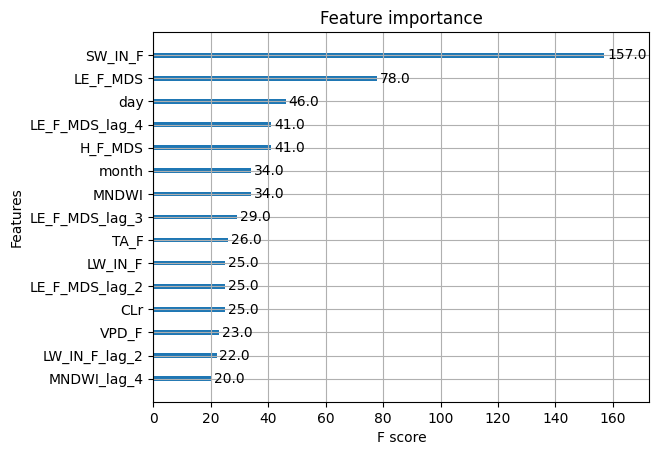

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 9.761177504861058
Root Mean Squared Error: 3.1242883197395623
mae: 2.3712579930816324
Test R^2 Score: 0.4784737590434609


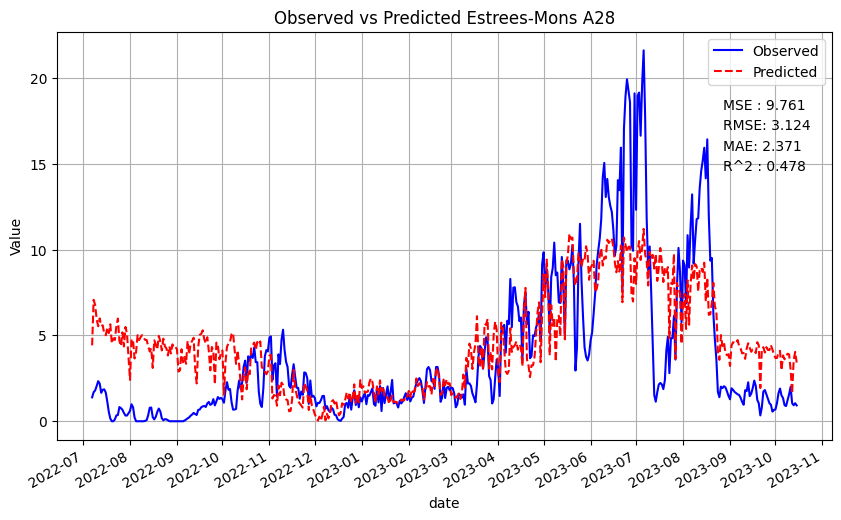

Hohes Holz
Mean Squared Error: 6.013353092906949
Root Mean Squared Error: 2.452213916628594
MAE: 1.7211117157732057
Test R^2 Score: 0.7968452375796122


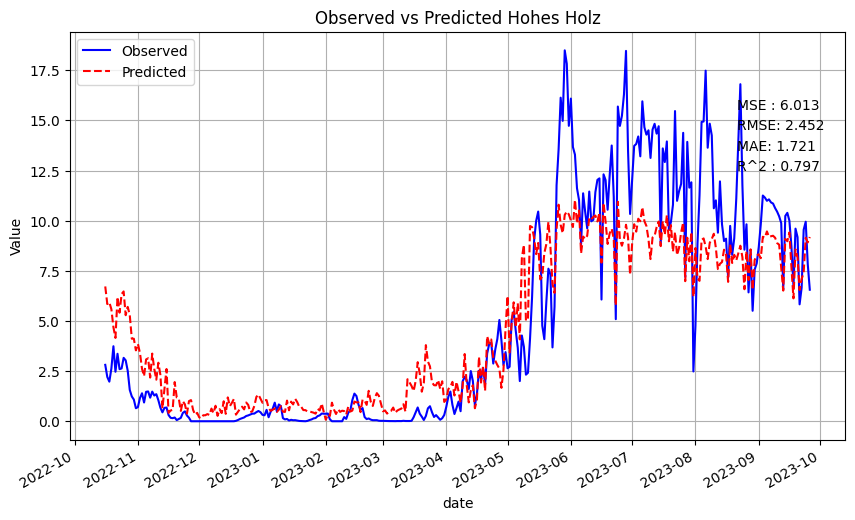

Hyytiala
Mean Squared Error: 1.09064877526237
Root Mean Squared Error: 1.0443413116708398
MAE: 0.6612642373612412
Test R^2 Score: 0.9012933542103868


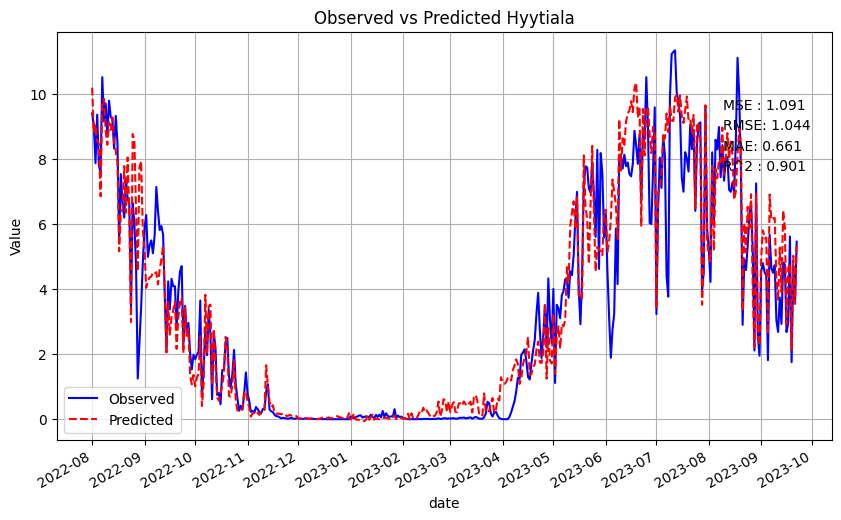

Retraining the model on the fourth site
Mean Squared Error: 0.8851235078125537
Root Mean Squared Error: 0.9408100274829949
MAE: 0.5579717588895009
Test R^2 Score: 0.899002643236921
[('CLr', 0.49456546), ('LE_F_MDS', 0.07603645), ('MNDVI', 0.041894007), ('month', 0.023001965), ('LE_F_MDS_lag_4', 0.021313123), ('MNDWI_lag_1', 0.020355694), ('CLr_lag_1', 0.014813367), ('SW_IN_F', 0.014545253), ('LSWI_lag_3', 0.014204092), ('EVI', 0.011131253), ('NDVI_lag_1', 0.010962533), ('NDVI_lag_4', 0.009209824), ('MNDWI_lag_2', 0.009062523), ('MNDWI_lag_3', 0.008353134), ('EVI_lag_1', 0.008260106), ('EVI2', 0.007919867), ('NDII_lag_2', 0.0075536063), ('NDVI', 0.0070972224), ('NDII', 0.006424899), ('H_F_MDS', 0.006394063), ('MNDVI_lag_4', 0.00611879), ('LSWI_lag_1', 0.0059990822), ('MNDWI', 0.005972872), ('EVI2_lag_1', 0.0054774643), ('LSWI_lag_4', 0.0051373476), ('PA_F', 0.0049649146), ('EVI_lag_2', 0.004826362), ('CLr_lag_3', 0.0047717853), ('LE_F_MDS_lag_3', 0.004690528), ('EVI2_lag_2', 0.004510707

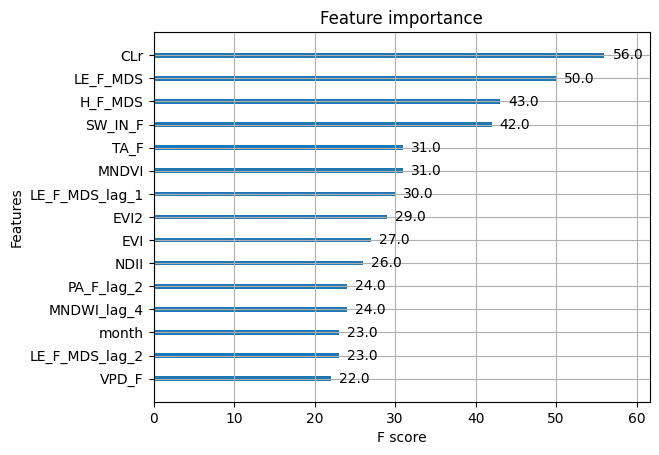

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 8.459331170936824
Root Mean Squared Error: 2.908492938092995
MAE: 2.19379265081224
Test R^2 Score: 0.5480296117565626


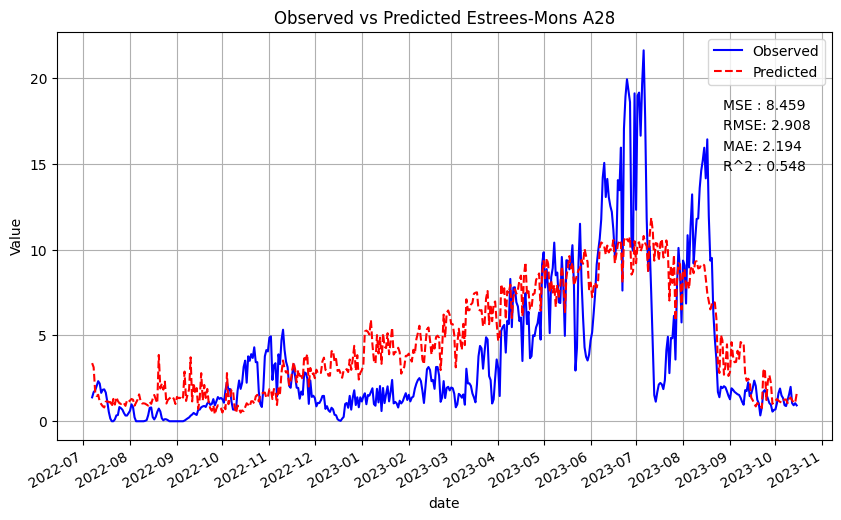

Hohes Holz
Mean Squared Error: 7.521188968994258
Root Mean Squared Error: 2.7424786177825085
MAE: 2.1598506571125373
Test R^2 Score: 0.7459046002275866


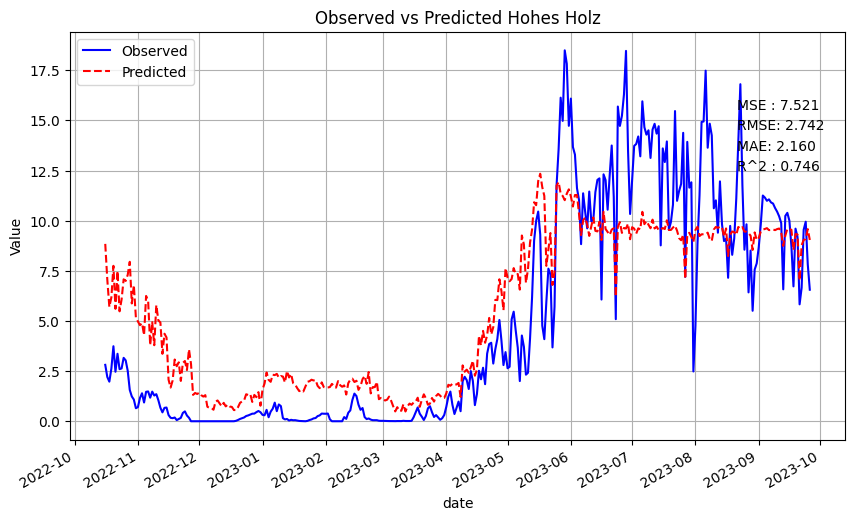

Hyytiala
Mean Squared Error: 5.187382965431506
Root Mean Squared Error: 2.2775827022155544
MAE: 2.0017931699614175
Test R^2 Score: 0.5305278981120702


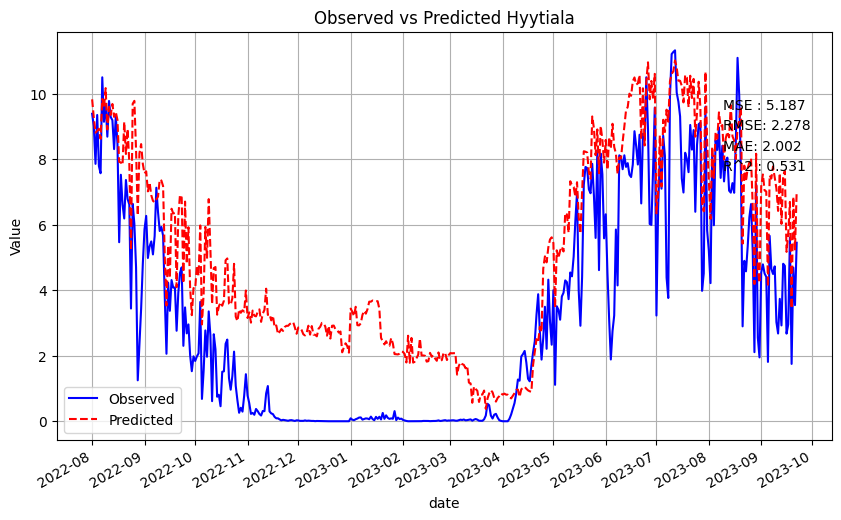

Torgnon
Mean Squared Error: 0.8851235078125537
Root Mean Squared Error: 0.9408100274829949
MAE: 0.5579717588895009
Test R^2 Score: 0.899002643236921


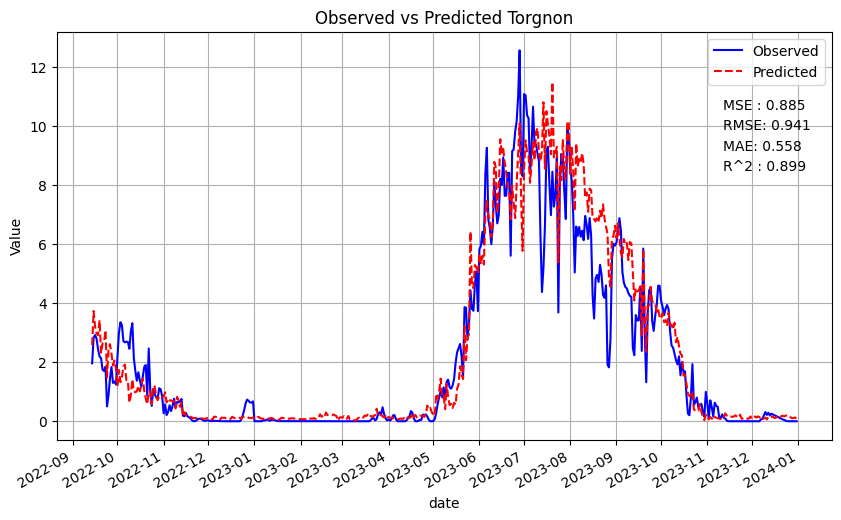

average MSE 5.5132566532937854
average RMSE 2.217341071393513
average MAE 1.7283520591939239
average R2 0.6808661883332852
Mean Squared Error: 6.897309882812098
Root Mean Squared Error: 2.6262730023385035
MAE: 2.2065751717360733
Test R^2 Score: 0.6735712669037127


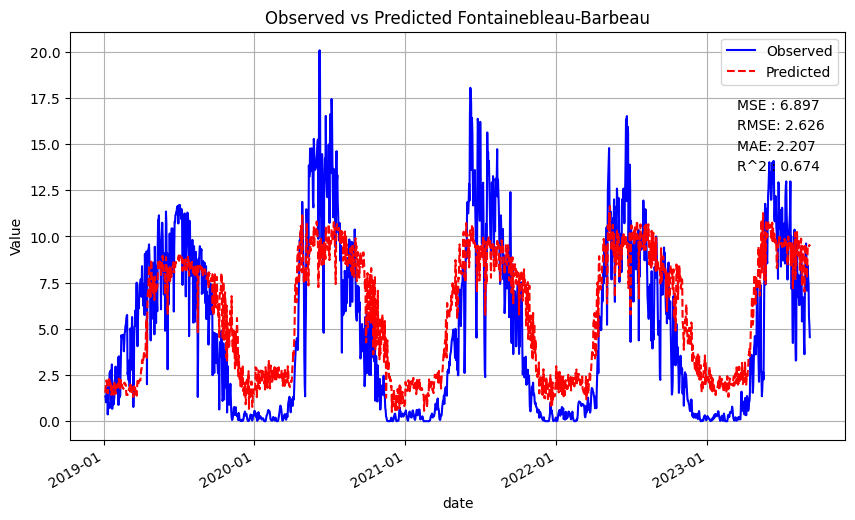

Mean Squared Error: 8.14402558997932
Root Mean Squared Error: 2.8537739206144765
MAE: 2.323072107038994
Test R^2 Score: 0.45667231265260777


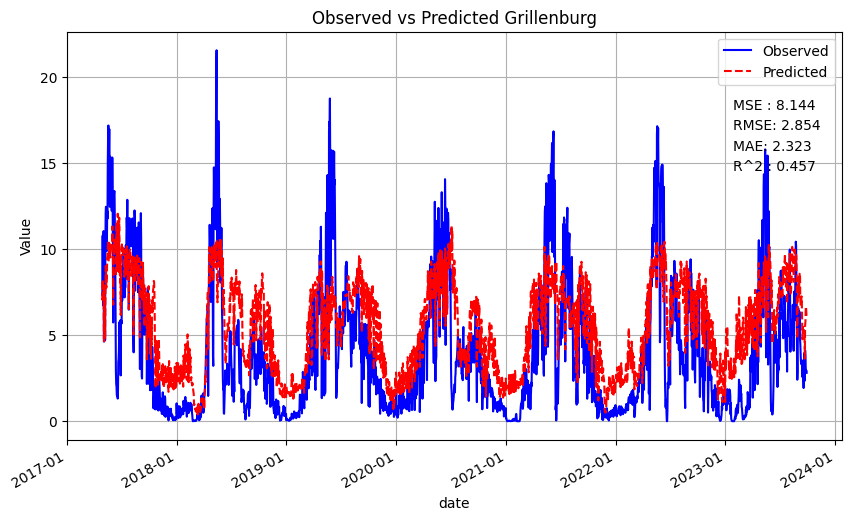

Mean Squared Error: 7.272791824366376
Root Mean Squared Error: 2.696811418020618
MAE: 1.8247494290709252
Test R^2 Score: 0.5946690386989294


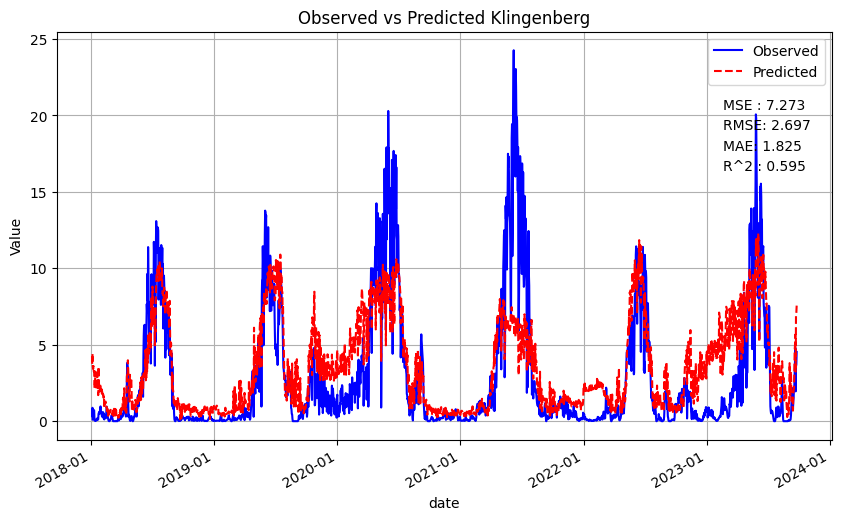

Mean Squared Error: 12.3784947420933
Root Mean Squared Error: 3.518308505815444
MAE: 3.1289747273266473
Test R^2 Score: -0.0437921759526827


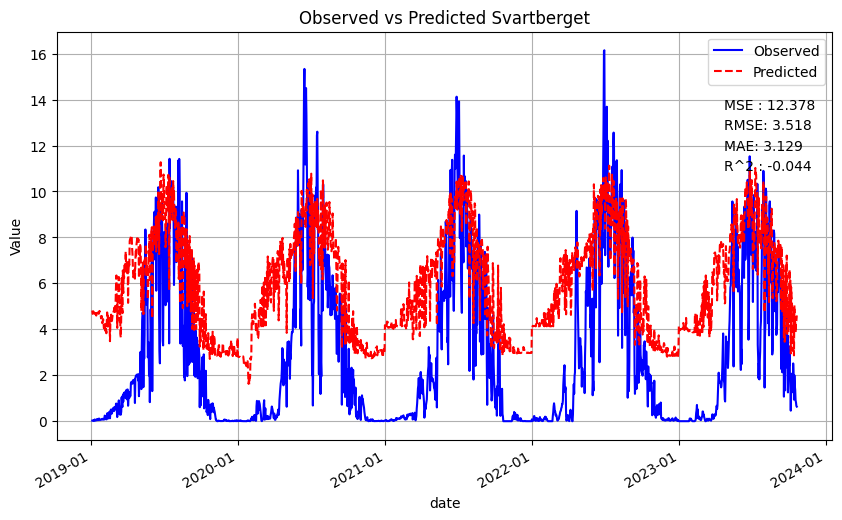

average MSE 8.673155509812773
average RMSE 2.9237917116972603
average MAE 2.37084285879316
average R2 0.4202801105756418


In [28]:
target_col = 'GPP_DT_VUT_USTAR50'
col_biom_season = ['date','day', 'month', 'winter', 'spring', 'summer', 'fall','latitude', 'longitude', 'elevation', 'canopy_height',  'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',  'biom_grasslands',
            'CLr', 'EVI', 'EVI2', 'LSWI',  'MNDVI', 'MNDWI', 'NDII', 'NDVI', 'H_F_MDS', 'LE_F_MDS',  'LW_IN_F', 'PA_F', 'P_F', 'SW_IN_F', 'TA_F', 'VPD_F', 'WS_F', target_col]

# 'day', 'month', 'winter', 'spring', 'summer', 'fall'
# Number of lag features
L = 5  # For example, create lag features for the previous 3 time points
column = col_biom_season
col_name = 'col2biomseason'
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

First training and testing the model on the first site
Mean Squared Error: 9.642435873162164
Root Mean Squared Error: 3.1052271854346123
MAE: 1.9593982943907404
Test R^2 Score: 0.4848179605287971


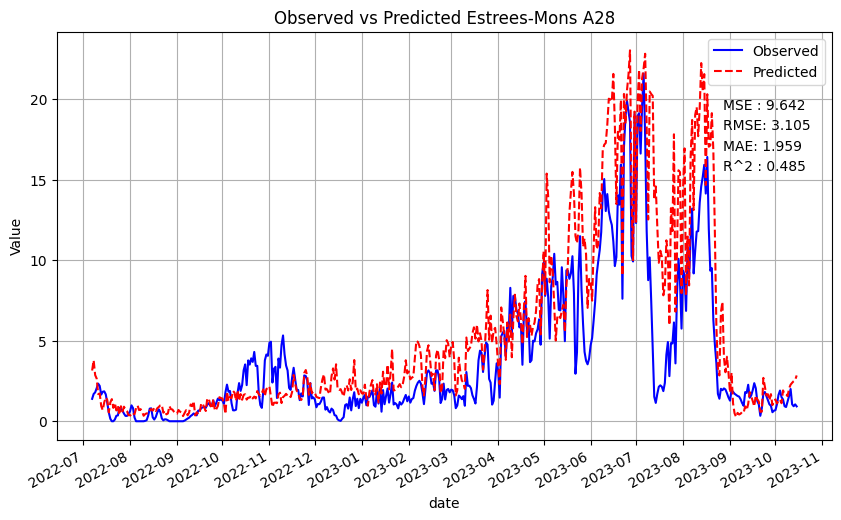

[('LE_F_MDS', 0.30837232), ('MNDVI', 0.12858708), ('MNDVI_lag_2', 0.026809067), ('LE_F_MDS_lag_2', 0.025664983), ('LE_F_MDS_lag_1', 0.02553321), ('MNDVI_lag_1', 0.024662465), ('MNDWI_lag_2', 0.02457924), ('LE_F_MDS_lag_3', 0.019669969), ('MNDWI', 0.015823485), ('EVI2', 0.013936796), ('EVI2_lag_4', 0.013723884), ('CLr_lag_2', 0.013663441), ('NDII_lag_1', 0.013500437), ('SW_IN_F', 0.013464809), ('CLr', 0.012967374), ('H_F_MDS_lag_2', 0.012793538), ('SW_IN_F_lag_2', 0.012729738), ('NDII', 0.012690254), ('CLr_lag_4', 0.0114055425), ('TA_F_lag_2', 0.011063256), ('TA_F_lag_3', 0.009907787), ('H_F_MDS_lag_3', 0.009108451), ('LE_F_MDS_lag_4', 0.008946518), ('LSWI_lag_2', 0.008938456), ('MNDWI_lag_4', 0.008272042), ('CLr_lag_3', 0.0081506325), ('NDVI_lag_3', 0.007963599), ('H_F_MDS_lag_4', 0.007940693), ('CLr_lag_1', 0.006987297), ('LW_IN_F', 0.006539385), ('LW_IN_F_lag_3', 0.006191518), ('EVI2_lag_1', 0.0061499733), ('NDII_lag_2', 0.006026209), ('NDVI', 0.005561474), ('MNDWI_lag_3', 0.00549175

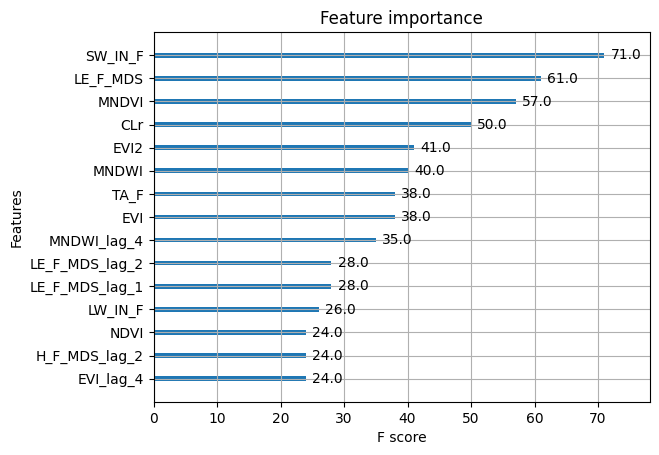

Retraining the model on the second site
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585
[('LE_F_MDS', 0.45457804), ('EVI2_lag_1', 0.06568062), ('LE_F_MDS_lag_3', 0.05331493), ('EVI', 0.04549406), ('SW_IN_F', 0.039962783), ('LSWI', 0.032998666), ('LE_F_MDS_lag_2', 0.022927376), ('EVI_lag_4', 0.017259305), ('LSWI_lag_3', 0.014410696), ('EVI2', 0.011987581), ('H_F_MDS_lag_4', 0.008435285), ('H_F_MDS', 0.008415095), ('NDII_lag_1', 0.008176293), ('MNDWI_lag_2', 0.007892477), ('H_F_MDS_lag_3', 0.0076911333), ('NDII_lag_4', 0.0075869854), ('NDVI_lag_3', 0.007415444), ('NDII', 0.0073430636), ('LE_F_MDS_lag_4', 0.0071838507), ('MNDWI_lag_1', 0.0071418043), ('NDVI_lag_4', 0.0068794237), ('VPD_F', 0.006021275), ('NDVI_lag_1', 0.005382439), ('LSWI_lag_1', 0.005131623), ('EVI_lag_3', 0.005065265), ('MNDVI', 0.0050021117), ('TA_F_lag_3', 0.0044356817), ('MNDVI_lag_2', 0.0042595062), ('EVI2_lag_3', 0.0041802

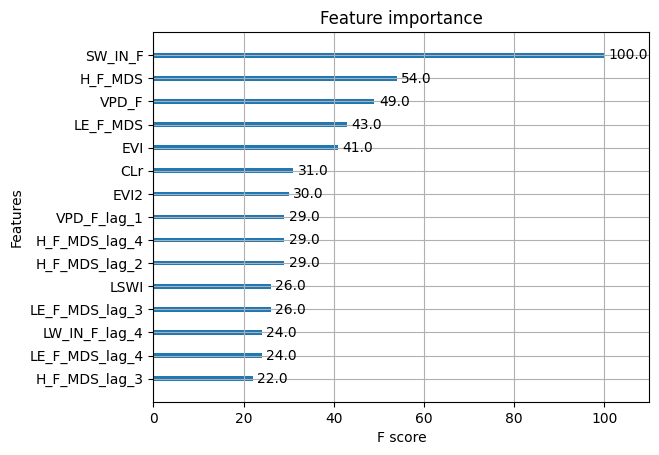

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 16.398530737101844
Root Mean Squared Error: 4.049509937893948
MAE: 3.0835000361674787
Test R^2 Score: 0.12384913723042446


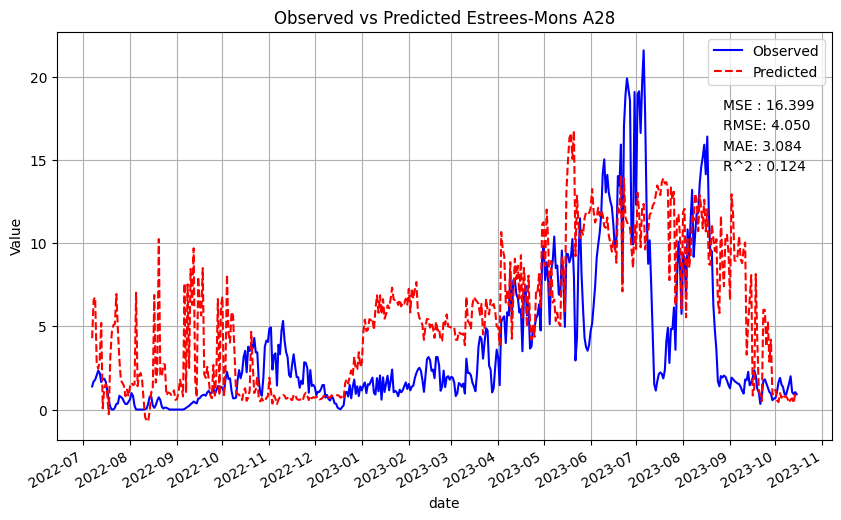

Hohes Holz
Mean Squared Error: 3.2309317928464387
Root Mean Squared Error: 1.7974792885723159
MAE: 1.1698976412529667
Test R^2 Score: 0.8908463929140585


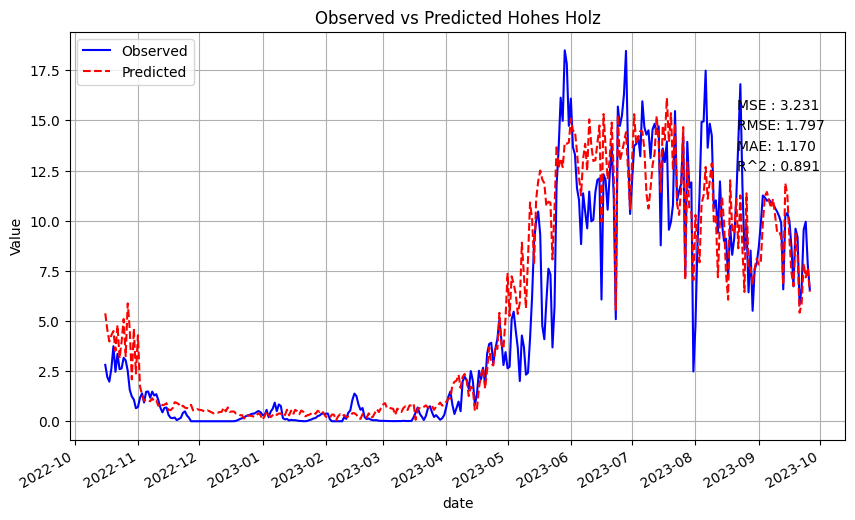

Retraining the model on the third site
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838
[('TA_F', 0.34772387), ('TA_F_lag_1', 0.19121638), ('TA_F_lag_4', 0.09319723), ('MNDVI', 0.052127924), ('TA_F_lag_2', 0.034583405), ('SW_IN_F', 0.03443744), ('LE_F_MDS', 0.028226601), ('CLr_lag_4', 0.018548194), ('CLr_lag_3', 0.014316782), ('MNDVI_lag_4', 0.012052558), ('VPD_F', 0.009530328), ('NDVI_lag_1', 0.008082906), ('CLr_lag_2', 0.007093154), ('LSWI', 0.0057911198), ('LW_IN_F_lag_2', 0.0054458645), ('CLr_lag_1', 0.0052149147), ('LSWI_lag_4', 0.004781042), ('SW_IN_F_lag_4', 0.004718991), ('CLr', 0.004398864), ('EVI2_lag_4', 0.0039700754), ('MNDWI', 0.0038381557), ('EVI', 0.0037304598), ('LE_F_MDS_lag_4', 0.0036983702), ('LE_F_MDS_lag_2', 0.0036768762), ('NDVI_lag_2', 0.0035865738), ('EVI2_lag_1', 0.0034675482), ('LSWI_lag_1', 0.0032844467), ('NDII', 0.0032309708), ('LSWI_lag_3', 0.0030855418), ('H_F_MDS

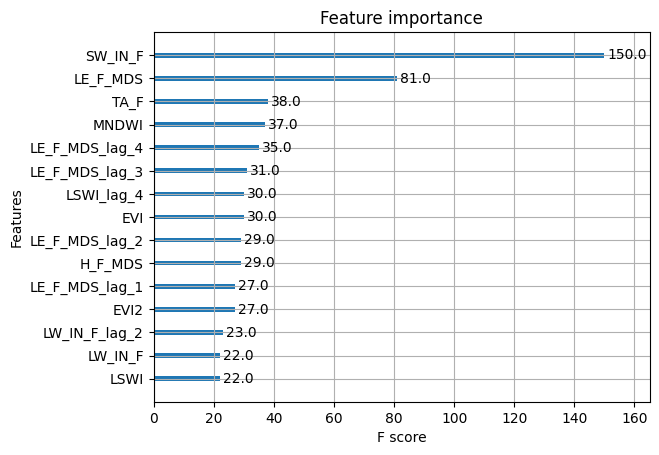

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 10.316906012265028
Root Mean Squared Error: 3.211994086586248
mae: 2.515258459566576
Test R^2 Score: 0.4487819519521088


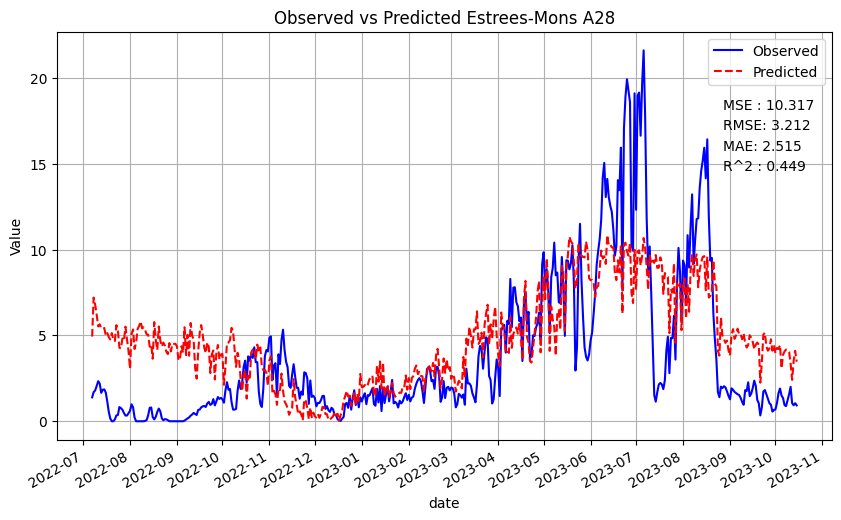

Hohes Holz
Mean Squared Error: 6.392875522505844
Root Mean Squared Error: 2.528413637541501
MAE: 1.7972201343336667
Test R^2 Score: 0.7840234744422842


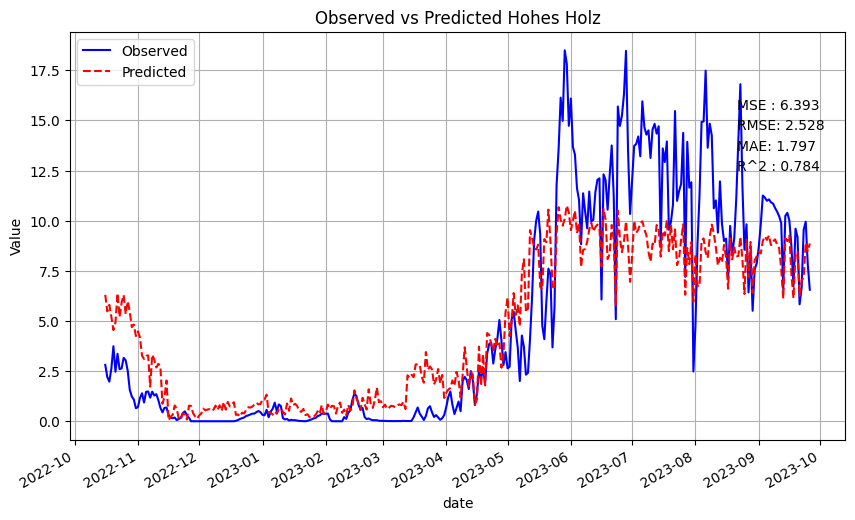

Hyytiala
Mean Squared Error: 1.1461970795913314
Root Mean Squared Error: 1.0706059403867192
MAE: 0.6638828060183026
Test R^2 Score: 0.8962660833565838


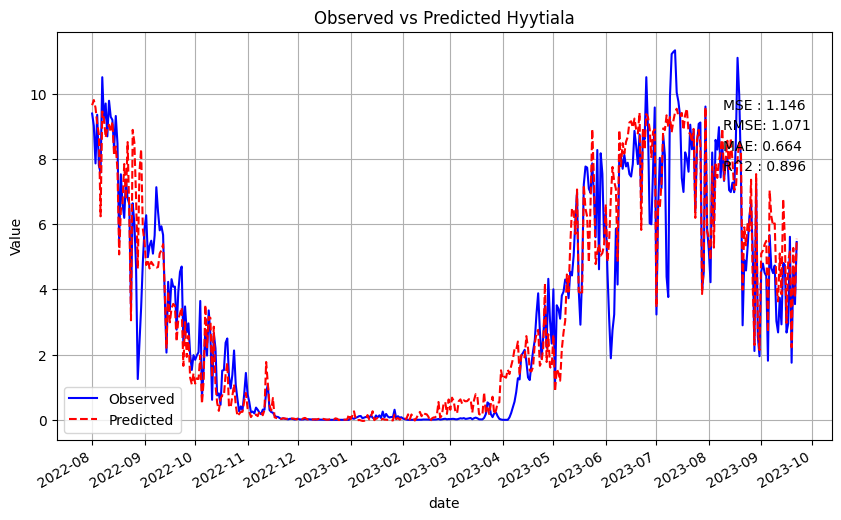

Retraining the model on the fourth site
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075
[('CLr', 0.5308977), ('LE_F_MDS', 0.0995064), ('LE_F_MDS_lag_4', 0.025698017), ('MNDVI', 0.019152831), ('SW_IN_F', 0.014785029), ('MNDWI_lag_1', 0.014454929), ('NDVI_lag_4', 0.0115951095), ('EVI', 0.010179487), ('CLr_lag_4', 0.0101044895), ('CLr_lag_1', 0.008864087), ('NDVI', 0.0084031625), ('MNDWI_lag_3', 0.008347099), ('NDII_lag_2', 0.0081024105), ('EVI2', 0.007951392), ('MNDWI_lag_2', 0.0077875718), ('P_F_lag_4', 0.0075033973), ('MNDVI_lag_1', 0.006863193), ('NDII', 0.006753891), ('TA_F', 0.0066642137), ('MNDWI', 0.006533959), ('EVI2_lag_2', 0.0062322123), ('LSWI_lag_1', 0.006167642), ('H_F_MDS', 0.0055597187), ('LSWI', 0.005330288), ('EVI_lag_1', 0.005259772), ('LSWI_lag_3', 0.0052464795), ('PA_F', 0.0051676324), ('NDVI_lag_1', 0.004751988), ('MNDVI_lag_4', 0.004583467), ('SW_IN_F_lag_3', 0.0044187675),

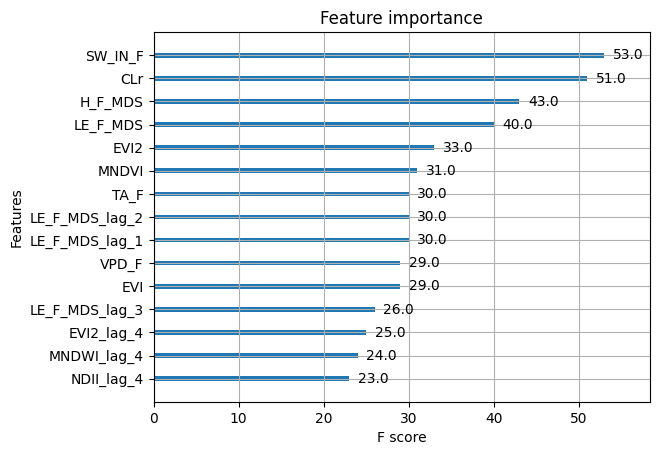

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 7.6692101714802465
Root Mean Squared Error: 2.769333885879463
MAE: 1.9817319979385093
Test R^2 Score: 0.5902446861717345


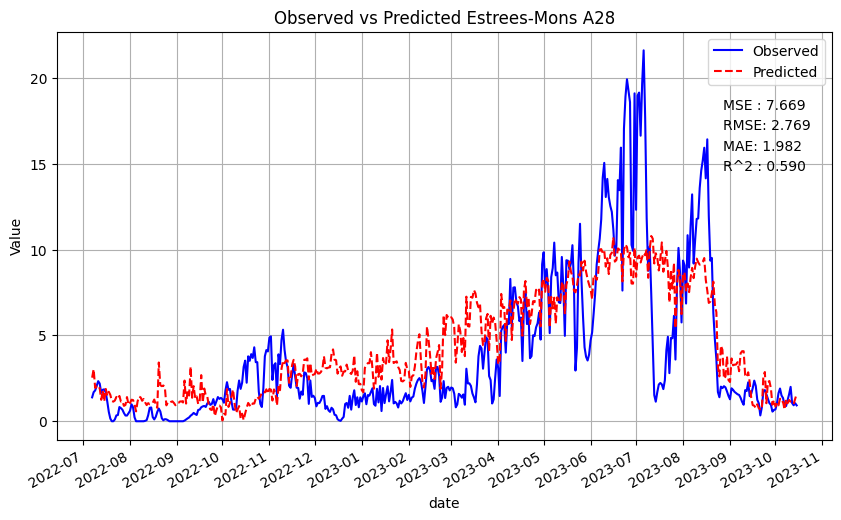

Hohes Holz
Mean Squared Error: 7.044350813723081
Root Mean Squared Error: 2.6541195929579136
MAE: 1.9566714539039933
Test R^2 Score: 0.7620140720398035


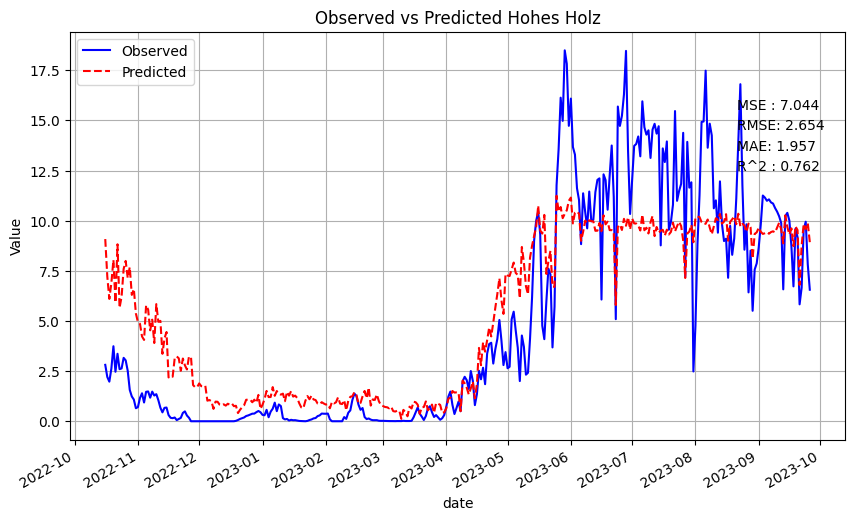

Hyytiala
Mean Squared Error: 4.769703115476459
Root Mean Squared Error: 2.183964998683921
MAE: 1.8498623255123605
Test R^2 Score: 0.5683290472428284


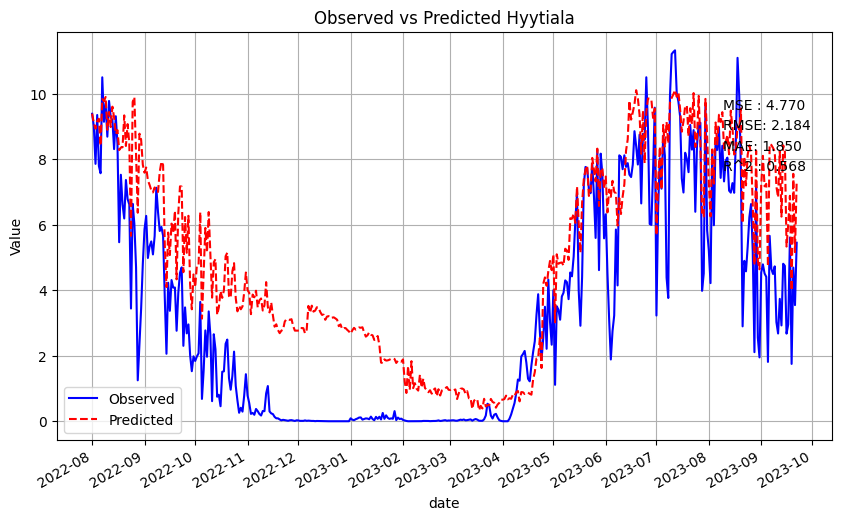

Torgnon
Mean Squared Error: 1.0354483802963281
Root Mean Squared Error: 1.0175698405005567
MAE: 0.5861241015185262
Test R^2 Score: 0.8818497661044075


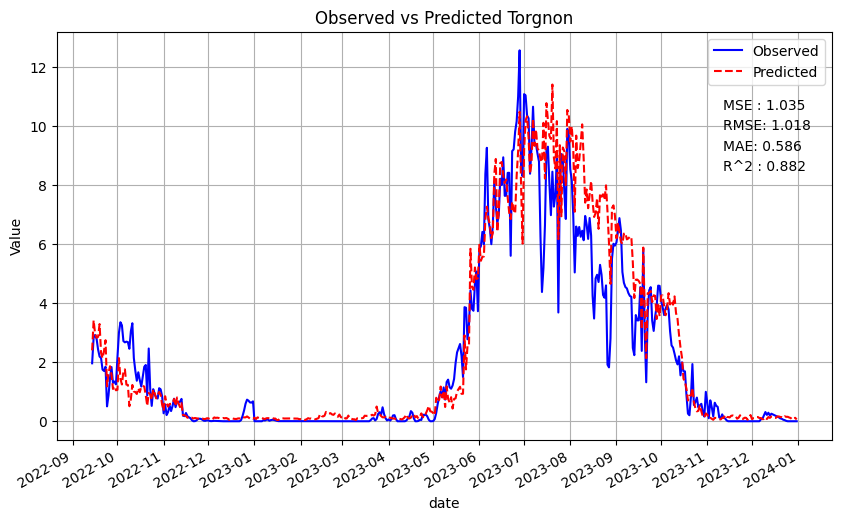

average MSE 5.129678120244029
average RMSE 2.1562470795054636
average MAE 1.5935974697183473
average R2 0.7006093928896935
Mean Squared Error: 7.010887217546346
Root Mean Squared Error: 2.6478080023948762
MAE: 2.169188281177406
Test R^2 Score: 0.6681959965279184


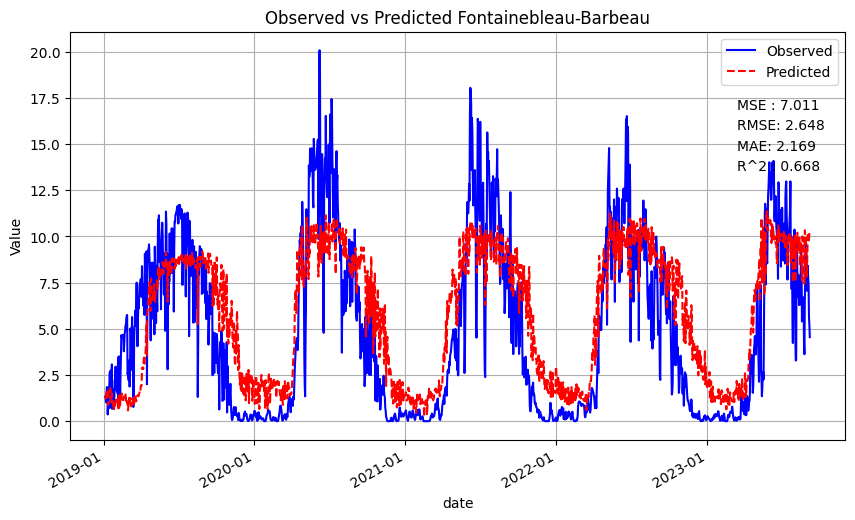

Mean Squared Error: 7.964564135762367
Root Mean Squared Error: 2.822155937534701
MAE: 2.243109424285924
Test R^2 Score: 0.46864506197791334


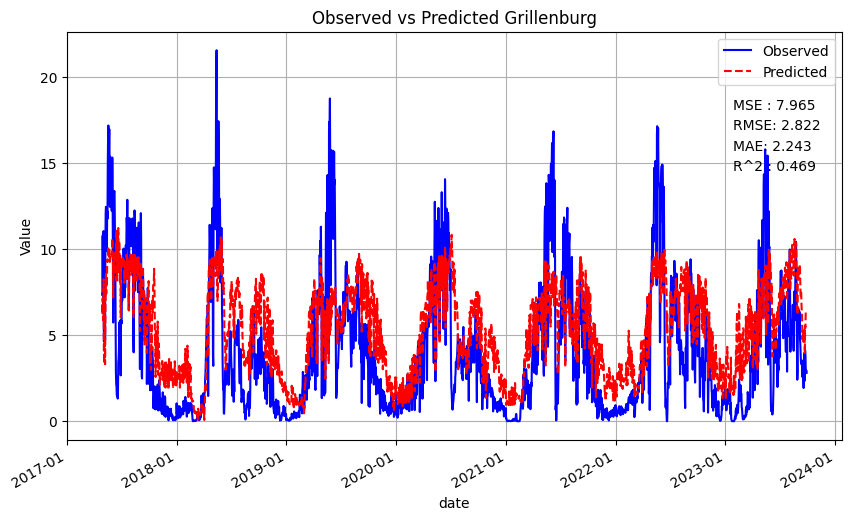

Mean Squared Error: 6.932499642925979
Root Mean Squared Error: 2.632964041327944
MAE: 1.6707181600318461
Test R^2 Score: 0.6136343769565649


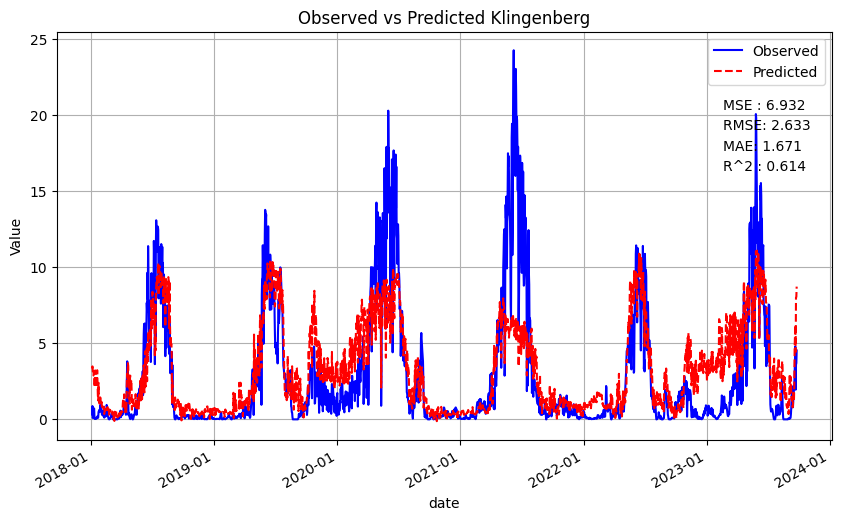

Mean Squared Error: 11.050387002417414
Root Mean Squared Error: 3.3242122378719166
MAE: 2.9661880328847645
Test R^2 Score: 0.06819789201429383


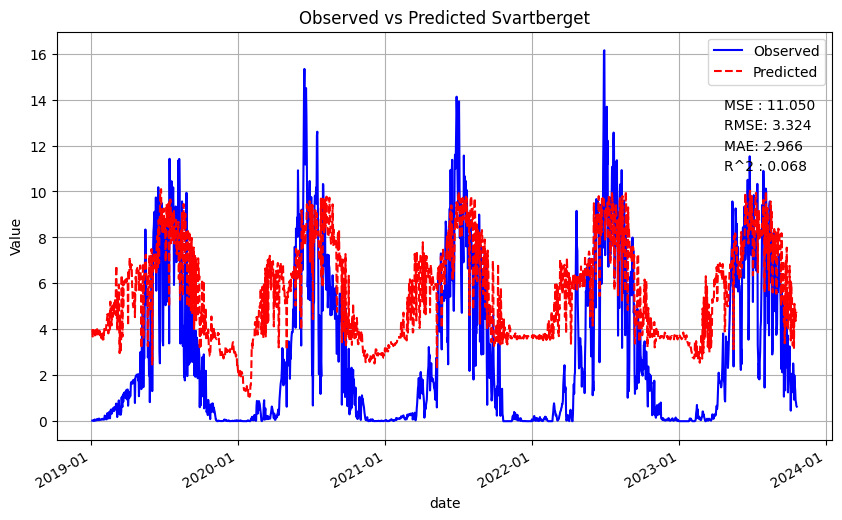

average MSE 8.239584499663026
average RMSE 2.85678505478236
average MAE 2.2623009745949854
average R2 0.4546683318691726


In [29]:
target_col = 'GPP_DT_VUT_USTAR50'
col_biom = ['date','latitude', 'longitude', 'elevation', 'canopy_height',  'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',  'biom_grasslands',
            'CLr', 'EVI', 'EVI2', 'LSWI',  'MNDVI', 'MNDWI', 'NDII', 'NDVI', 'H_F_MDS', 'LE_F_MDS',  'LW_IN_F', 'PA_F', 'P_F', 'SW_IN_F', 'TA_F', 'VPD_F', 'WS_F', target_col]

# 'day', 'month', 'winter', 'spring', 'summer', 'fall'
# Number of lag features
L = 5  # For example, create lag features for the previous 3 time points
column = col_biom
col_name = 'col2biom'
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

First training and testing the model on the first site
Mean Squared Error: 8.895151844031595
Root Mean Squared Error: 2.9824741145618674
MAE: 1.884321849266613
Test R^2 Score: 0.5247443147463327


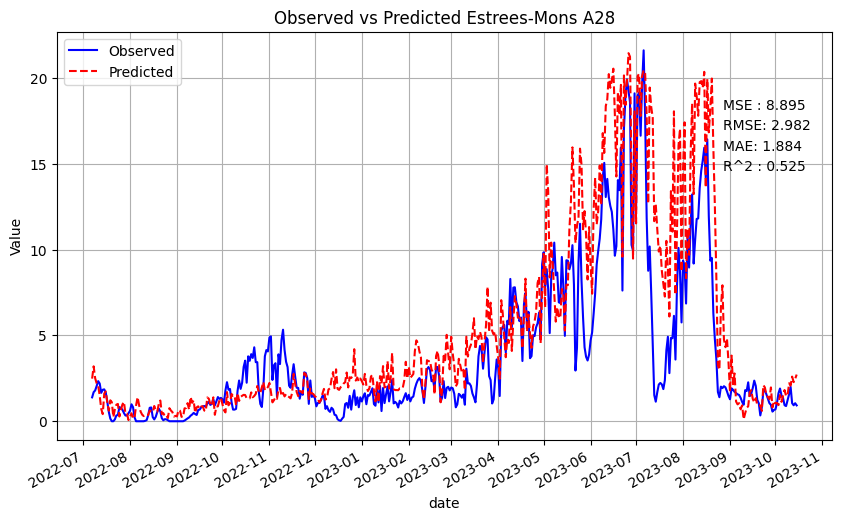

[('LE_F_MDS', 0.3583673), ('MNDVI', 0.14018045), ('LE_F_MDS_lag_2', 0.050383575), ('LE_F_MDS_lag_1', 0.03671227), ('MNDVI_lag_2', 0.03066417), ('LE_F_MDS_lag_3', 0.019880492), ('MNDWI_lag_2', 0.019080691), ('MNDVI_lag_1', 0.01808069), ('EVI2', 0.017760312), ('NDII_lag_1', 0.016211897), ('H_F_MDS_lag_2', 0.016167527), ('CLr', 0.015748786), ('SW_IN_F', 0.015109851), ('MNDWI', 0.012810818), ('CLr_lag_4', 0.012291093), ('EVI2_lag_4', 0.011554421), ('CLr_lag_2', 0.01101631), ('NDII', 0.01014055), ('NDII_lag_3', 0.009597332), ('MNDWI_lag_4', 0.009346445), ('TA_F_lag_3', 0.009123239), ('H_F_MDS_lag_3', 0.009041983), ('TA_F_lag_2', 0.008811751), ('CLr_lag_3', 0.00869345), ('CLr_lag_1', 0.008397092), ('H_F_MDS_lag_1', 0.0076954244), ('SW_IN_F_lag_2', 0.0076863095), ('LE_F_MDS_lag_4', 0.0074947565), ('H_F_MDS_lag_4', 0.006657693), ('EVI2_lag_1', 0.0062615485), ('TA_F', 0.0055876574), ('NDII_lag_4', 0.0052490234), ('SW_IN_F_lag_3', 0.005182028), ('EVI2_lag_2', 0.0048319423), ('VPD_F', 0.004666846

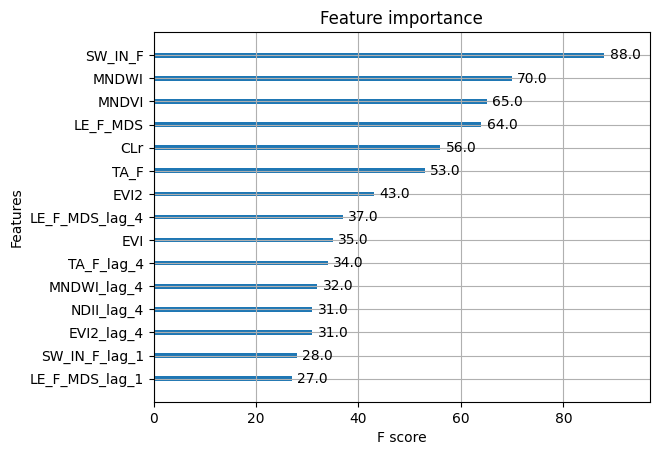

Retraining the model on the second site
Mean Squared Error: 3.5707076306417553
Root Mean Squared Error: 1.8896316124159638
MAE: 1.2266824147775268
Test R^2 Score: 0.8793674262648331
[('LE_F_MDS', 0.46004874), ('LE_F_MDS_lag_2', 0.06129605), ('EVI2_lag_1', 0.058362234), ('EVI', 0.054216705), ('SW_IN_F', 0.05039119), ('LE_F_MDS_lag_3', 0.040652882), ('NDII', 0.01903217), ('EVI2', 0.017380027), ('CLr_lag_3', 0.011842778), ('H_F_MDS', 0.010264742), ('VPD_F', 0.010036975), ('NDII_lag_1', 0.009938562), ('EVI2_lag_2', 0.008805402), ('LE_F_MDS_lag_1', 0.008489516), ('NDII_lag_3', 0.00802093), ('MNDVI', 0.007951773), ('LE_F_MDS_lag_4', 0.007918848), ('EVI_lag_4', 0.0077684117), ('CLr', 0.0077600726), ('H_F_MDS_lag_4', 0.007543273), ('H_F_MDS_lag_3', 0.0072415406), ('MNDWI_lag_1', 0.0071535474), ('MNDVI_lag_1', 0.006937077), ('MNDWI_lag_3', 0.006486921), ('TA_F_lag_3', 0.006483548), ('CLr_lag_2', 0.006158216), ('MNDVI_lag_2', 0.0053980784), ('NDII_lag_4', 0.0053144395), ('H_F_MDS_lag_2', 0.00463

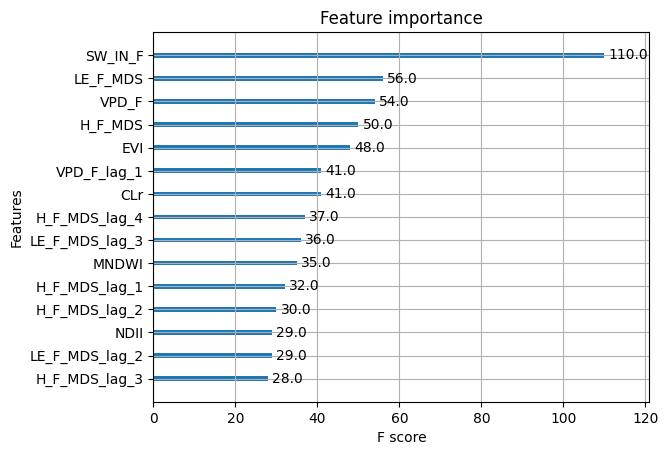

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 15.624926280103692
Root Mean Squared Error: 3.952837750288227
MAE: 2.968224399874854
Test R^2 Score: 0.16518175557944537


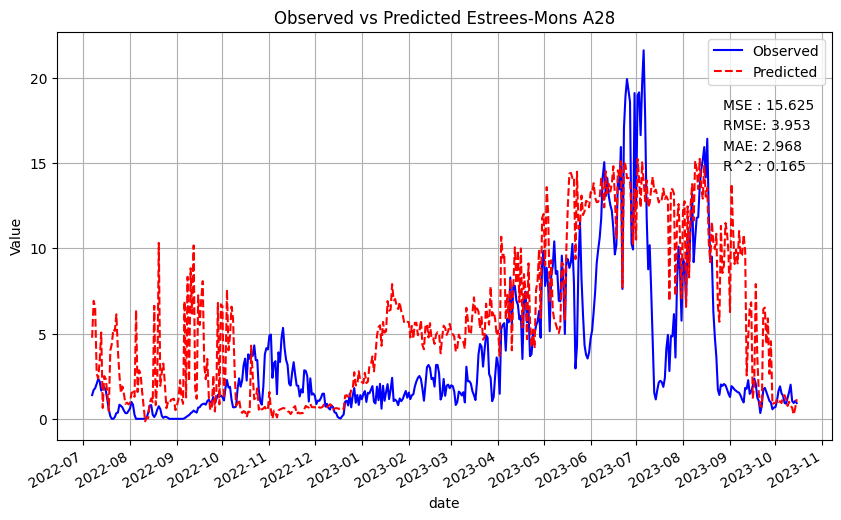

Hohes Holz
Mean Squared Error: 3.5707076306417553
Root Mean Squared Error: 1.8896316124159638
MAE: 1.2266824147775268
Test R^2 Score: 0.8793674262648331


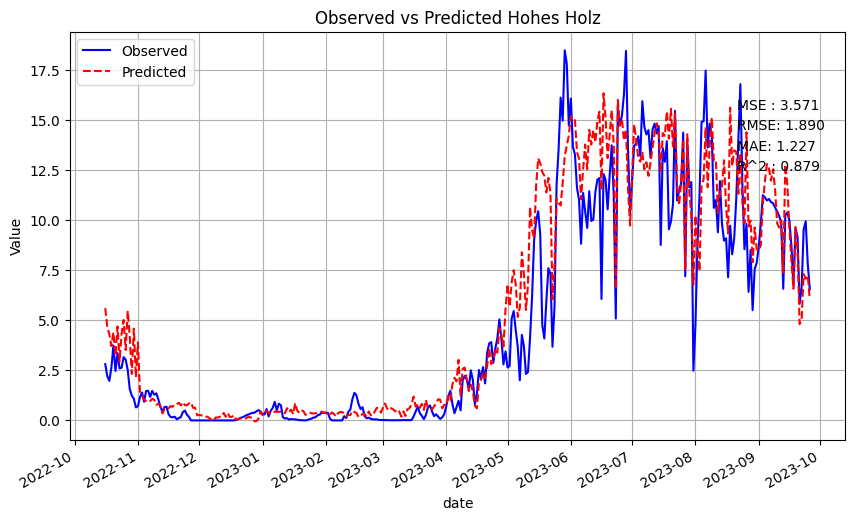

Retraining the model on the third site
Mean Squared Error: 1.257056008752393
Root Mean Squared Error: 1.1211850912103642
MAE: 0.6917063254826259
Test R^2 Score: 0.8862330522823185
[('TA_F', 0.42111316), ('TA_F_lag_1', 0.17306818), ('SW_IN_F', 0.04519427), ('MNDVI', 0.041627046), ('TA_F_lag_4', 0.0407224), ('LE_F_MDS', 0.03830588), ('CLr_lag_4', 0.029888038), ('TA_F_lag_2', 0.022551576), ('NDII_lag_1', 0.017771183), ('TA_F_lag_3', 0.01515485), ('CLr_lag_1', 0.009601735), ('CLr_lag_3', 0.0085764285), ('SW_IN_F_lag_4', 0.0068573267), ('LE_F_MDS_lag_1', 0.006824318), ('LE_F_MDS_lag_4', 0.006460352), ('EVI', 0.0057492116), ('MNDWI', 0.0056307223), ('CLr', 0.0053463313), ('EVI2', 0.005115938), ('EVI2_lag_3', 0.0049594883), ('VPD_F', 0.004956954), ('CLr_lag_2', 0.004932547), ('NDII_lag_4', 0.004888218), ('H_F_MDS', 0.004527143), ('NDII_lag_3', 0.0044449847), ('MNDWI_lag_3', 0.004237968), ('LE_F_MDS_lag_2', 0.0040819687), ('MNDWI_lag_2', 0.0040198425), ('VPD_F_lag_1', 0.0037670457), ('EVI_lag_

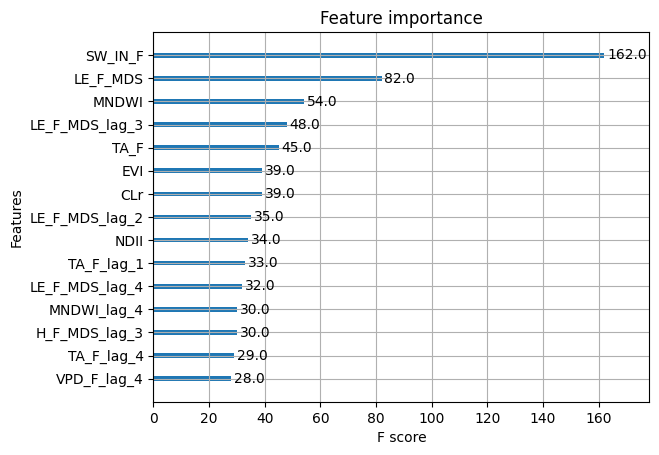

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 11.36512365302732
Root Mean Squared Error: 3.37121990576517
mae: 2.627328749634538
Test R^2 Score: 0.39277713023681393


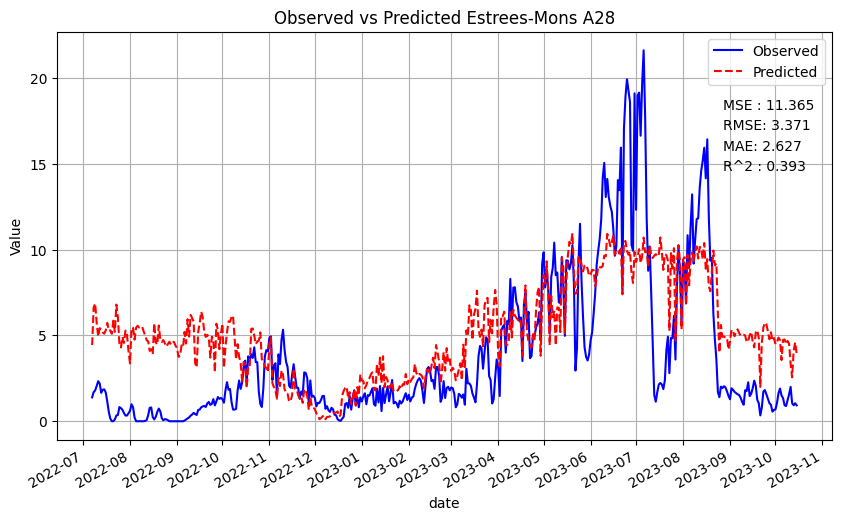

Hohes Holz
Mean Squared Error: 6.808090157707462
Root Mean Squared Error: 2.6092317179023143
MAE: 1.9219777110010066
Test R^2 Score: 0.7699958879585715


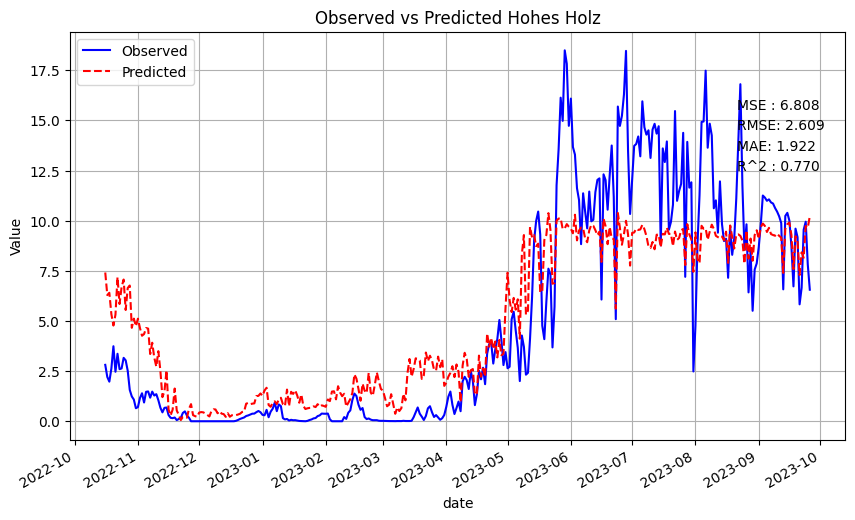

Hyytiala
Mean Squared Error: 1.257056008752393
Root Mean Squared Error: 1.1211850912103642
MAE: 0.6917063254826259
Test R^2 Score: 0.8862330522823185


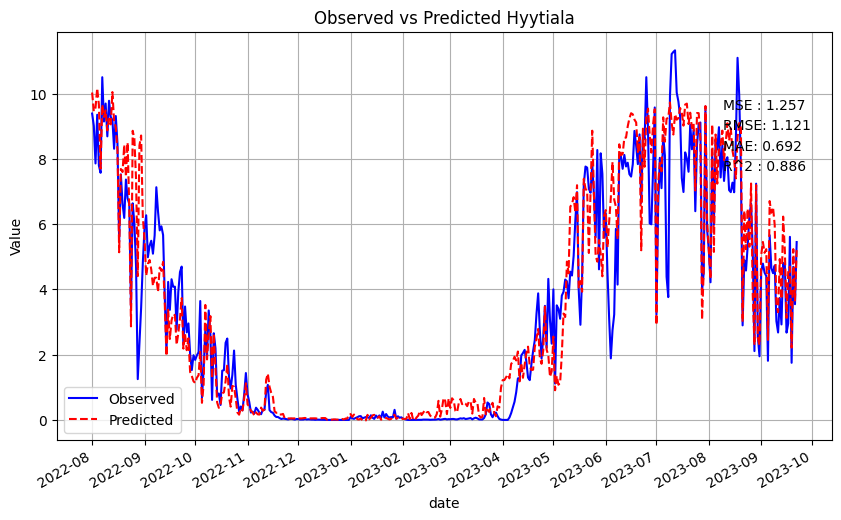

Retraining the model on the fourth site
Mean Squared Error: 1.0533926768184196
Root Mean Squared Error: 1.0263491982841024
MAE: 0.5694662236293727
Test R^2 Score: 0.879802225279079
[('CLr', 0.54493314), ('LE_F_MDS', 0.08988864), ('MNDVI', 0.03321507), ('LE_F_MDS_lag_4', 0.022833709), ('SW_IN_F', 0.018481946), ('CLr_lag_1', 0.016011706), ('EVI', 0.015000324), ('MNDWI_lag_2', 0.014101967), ('EVI2', 0.01207574), ('MNDVI_lag_4', 0.010330325), ('NDII_lag_2', 0.0099403085), ('EVI2_lag_1', 0.009455045), ('MNDWI_lag_3', 0.009442977), ('MNDWI', 0.009161967), ('MNDWI_lag_1', 0.008579462), ('EVI_lag_4', 0.008312515), ('TA_F', 0.007876633), ('H_F_MDS', 0.007627023), ('CLr_lag_4', 0.0074720304), ('NDII', 0.00720274), ('EVI2_lag_3', 0.0069899308), ('LE_F_MDS_lag_1', 0.0068922904), ('EVI2_lag_4', 0.0061286287), ('NDII_lag_3', 0.0057208994), ('SW_IN_F_lag_3', 0.005610861), ('EVI2_lag_2', 0.005497359), ('MNDVI_lag_3', 0.0053898166), ('MNDVI_lag_1', 0.005066096), ('LE_F_MDS_lag_3', 0.004662973), ('TA_F_

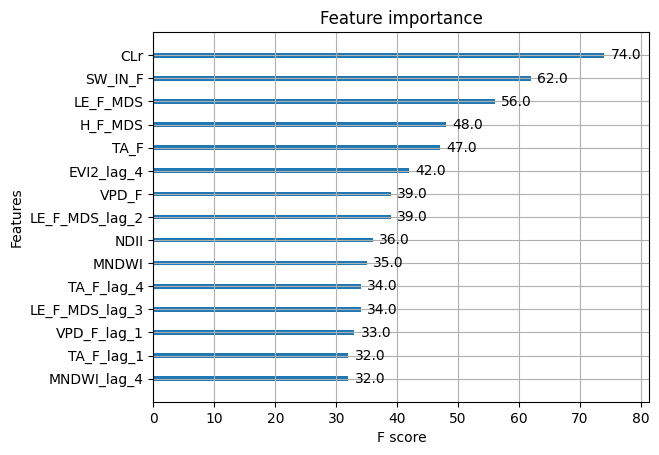

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 8.54544769967159
Root Mean Squared Error: 2.9232597728685676
MAE: 2.1208214707704642
Test R^2 Score: 0.5434285244909226


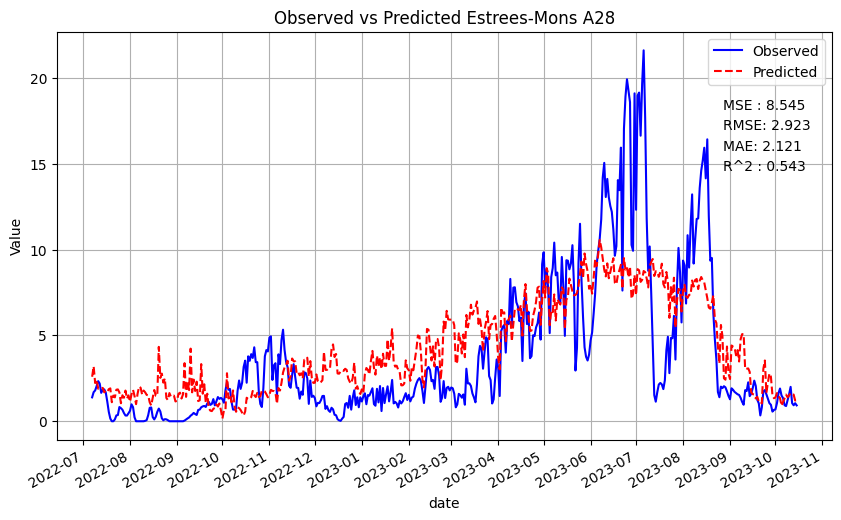

Hohes Holz
Mean Squared Error: 8.757604345167566
Root Mean Squared Error: 2.9593249813373936
MAE: 2.17910098208727
Test R^2 Score: 0.7041336168646295


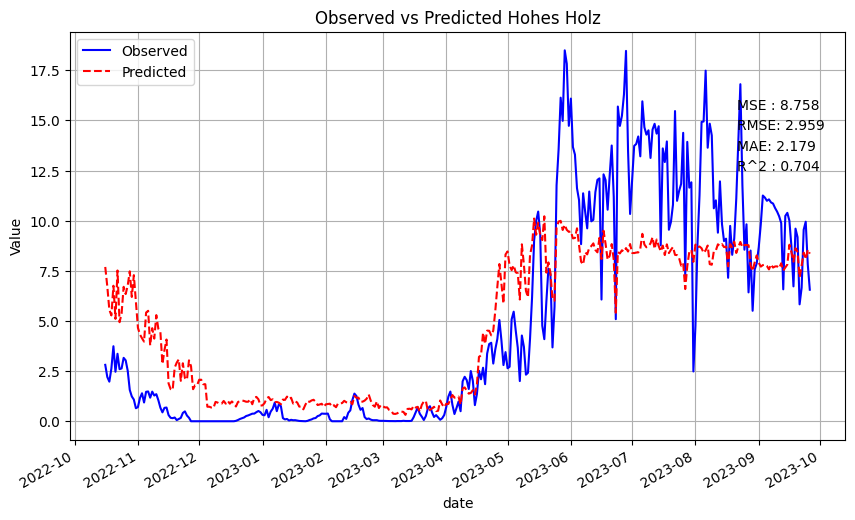

Hyytiala
Mean Squared Error: 4.307144000719165
Root Mean Squared Error: 2.0753659919925367
MAE: 1.738477746597627
Test R^2 Score: 0.6101918904721912


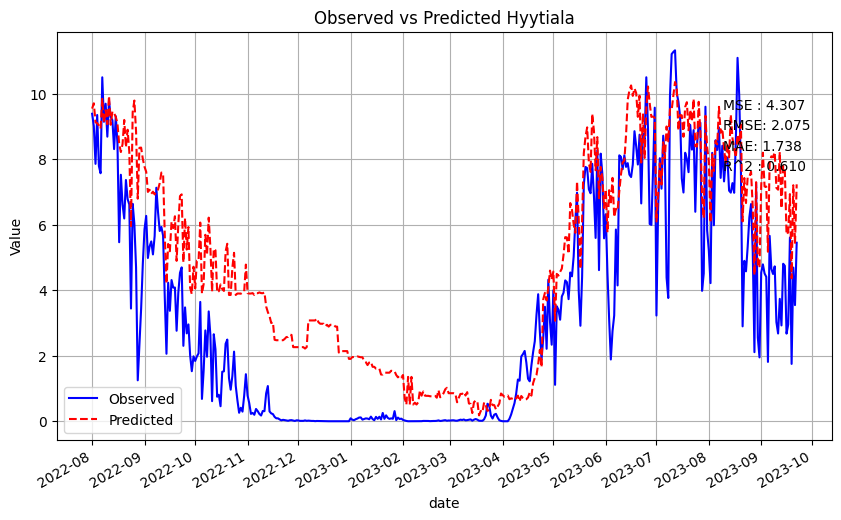

Torgnon
Mean Squared Error: 1.0533926768184196
Root Mean Squared Error: 1.0263491982841024
MAE: 0.5694662236293727
Test R^2 Score: 0.879802225279079


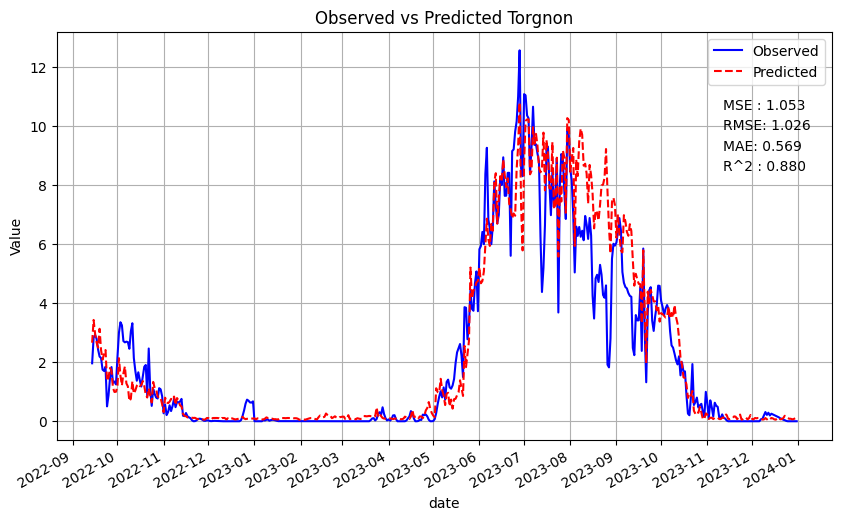

average MSE 5.665897180594185
average RMSE 2.24607498612065
average MAE 1.6519666057711835
average R2 0.6843890642767056
Mean Squared Error: 7.140362265776564
Root Mean Squared Error: 2.6721456295974146
MAE: 2.113391876695154
Test R^2 Score: 0.6620683356457109


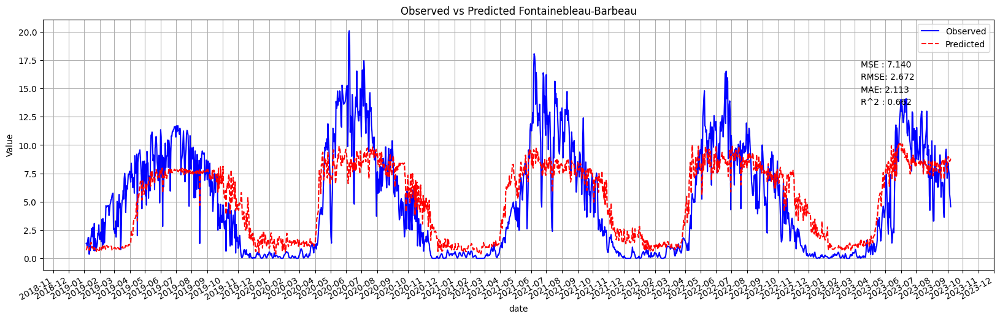

Mean Squared Error: 7.765290714670463
Root Mean Squared Error: 2.786627121570172
MAE: 2.139677539287099
Test R^2 Score: 0.4819395642895081


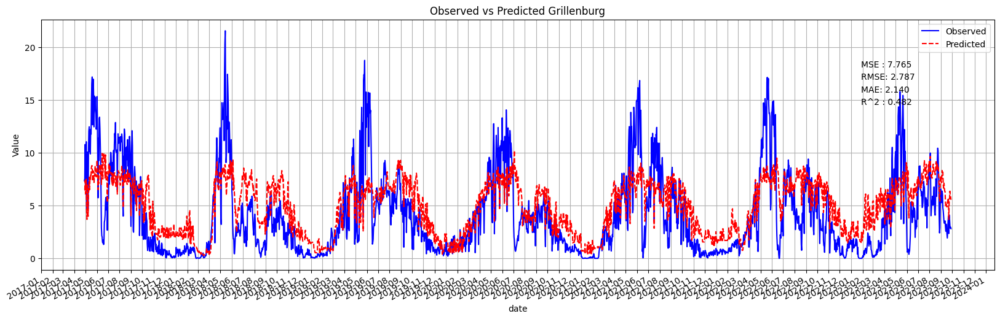

Mean Squared Error: 7.074085045829374
Root Mean Squared Error: 2.659715218934045
MAE: 1.6907613497505314
Test R^2 Score: 0.6057434667186615


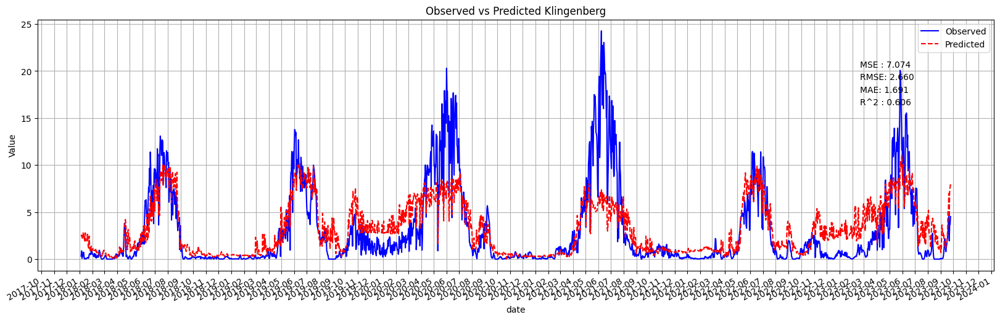

Mean Squared Error: 11.088550938020518
Root Mean Squared Error: 3.329947587878902
MAE: 2.950725836017537
Test R^2 Score: 0.06497979335076076


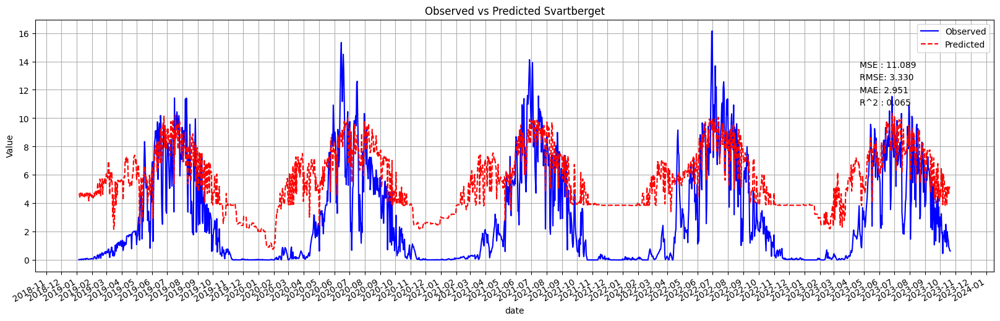

average MSE 8.26707224107423
average RMSE 2.862108889495133
average MAE 2.22363915043758
average R2 0.4536827900011603


In [61]:
target_col = 'GPP_DT_VUT_USTAR50'
col_biom = ['date','latitude', 'longitude', 'elevation', 'canopy_height',  'instrument_height', 'biom_croplands', 'biom_dbf', 'biom_enf',  'biom_grasslands',
            'CLr', 'EVI', 'EVI2', 'MNDVI', 'MNDWI', 'NDII',  'H_F_MDS', 'LE_F_MDS',   'SW_IN_F', 'TA_F', 'VPD_F', target_col]

# 'day', 'month', 'winter', 'spring', 'summer', 'fall'
# Number of lag features
L = 5  # For example, create lag features for the previous 3 time points
column = col_biom
col_name = 'colbiomreduce'
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']

params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

params lain col2, belum pake test

First training and testing the model on the first site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 8.95206951148287
Root Mean Squared Error: 2.9920009210364342
MAE: 1.899448529165593
Test R^2 Score: 0.5217032823365548


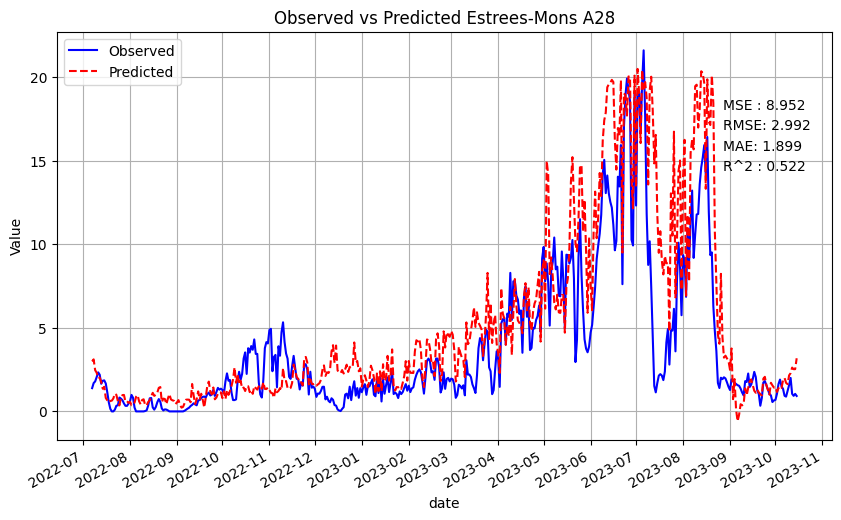

[('LE_F_MDS', 0.2884649), ('MNDVI', 0.11668618), ('MNDVI_lag_2', 0.052023016), ('LE_F_MDS_lag_2', 0.032040782), ('LE_F_MDS_lag_1', 0.020032454), ('MNDWI_lag_2', 0.017068945), ('LE_F_MDS_lag_3', 0.016830092), ('MNDWI', 0.016681755), ('H_F_MDS_lag_2', 0.014138426), ('EVI2_lag_1', 0.013714975), ('EVI2_lag_6', 0.012670058), ('MNDVI_lag_1', 0.011818129), ('SW_IN_F', 0.011771631), ('CLr_lag_4', 0.0117661245), ('H_F_MDS_lag_6', 0.011392309), ('CLr', 0.01122591), ('EVI2_lag_4', 0.010235991), ('EVI2_lag_5', 0.010196946), ('MNDWI_lag_5', 0.010196514), ('MNDVI_lag_3', 0.0097886585), ('MNDVI_lag_6', 0.009228765), ('MNDWI_lag_4', 0.008137806), ('LE_F_MDS_lag_5', 0.008093957), ('CLr_lag_1', 0.008038956), ('LE_F_MDS_lag_4', 0.007990713), ('TA_F_lag_2', 0.0076500005), ('CLr_lag_3', 0.007505193), ('TA_F_lag_6', 0.0074596307), ('LE_F_MDS_lag_6', 0.0067727324), ('NDVI_lag_5', 0.00648683), ('EVI2', 0.0063003525), ('LW_IN_F', 0.0062735067), ('TA_F_lag_3', 0.006138538), ('H_F_MDS_lag_5', 0.0059212623), ('ND

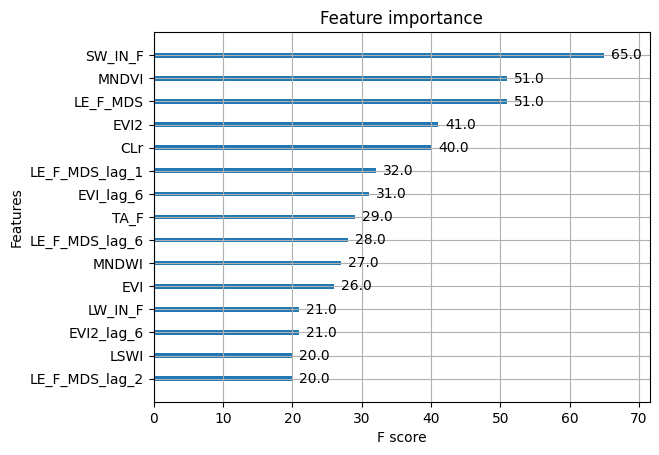

Retraining the model on the second site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 3.1330225142473593
Root Mean Squared Error: 1.7700346082061105
MAE: 1.1569475324168714
Test R^2 Score: 0.8944138242935167
[('LE_F_MDS', 0.44399908), ('EVI2_lag_1', 0.09642131), ('LE_F_MDS_lag_3', 0.045575526), ('LE_F_MDS_lag_2', 0.035375632), ('EVI', 0.034222532), ('SW_IN_F', 0.023310196), ('LSWI', 0.019815343), ('EVI2', 0.013000273), ('EVI_lag_3', 0.010816639), ('H_F_MDS_lag_3', 0.009557618), ('NDII', 0.008866408), ('EVI_lag_5', 0.008318293), ('NDVI_lag_3', 0.007868596), ('H_F_MDS_lag_4', 0.0075318366), ('LE_F_MDS_lag_4', 0.007166287), ('LSWI_lag_2', 0.006833811), ('LSWI_lag_3', 0.0065344917), ('H_F_MDS', 0.0063366615), ('LE_F_MDS_lag_6', 0.005688506), ('NDII_lag_4', 0.005687276), ('MNDWI_lag_3', 0.005257262), ('SW_IN_F_lag_6', 0.005242733), ('VPD_F_lag_3', 0.004728786), ('LSWI_lag_1', 0.0046602692), ('EVI2_lag_6', 0.004607068), ('MNDVI_lag_2', 0.004433971), ('VPD_F', 0.00438862), ('MNDWI_lag_1', 0.004156948), ('MNDVI', 0.0038467157), ('CLr_lag_5', 0.0037697705), (

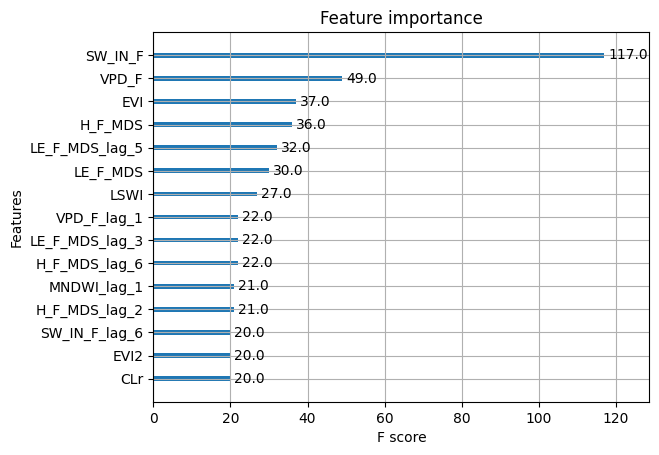

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 15.745071944341053
Root Mean Squared Error: 3.9680060413690215
MAE: 2.9983574087596563
Test R^2 Score: 0.15876253857353262


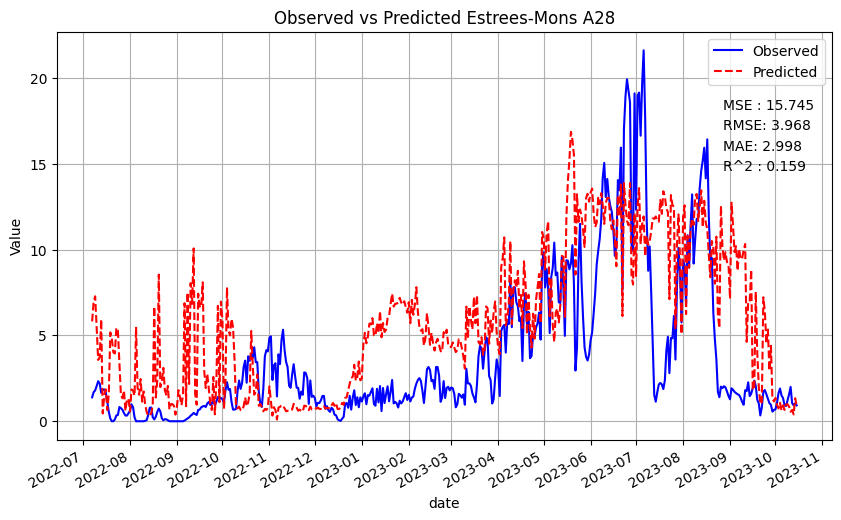

Hohes Holz
Mean Squared Error: 3.1330225142473593
Root Mean Squared Error: 1.7700346082061105
MAE: 1.1569475324168714
Test R^2 Score: 0.8944138242935167


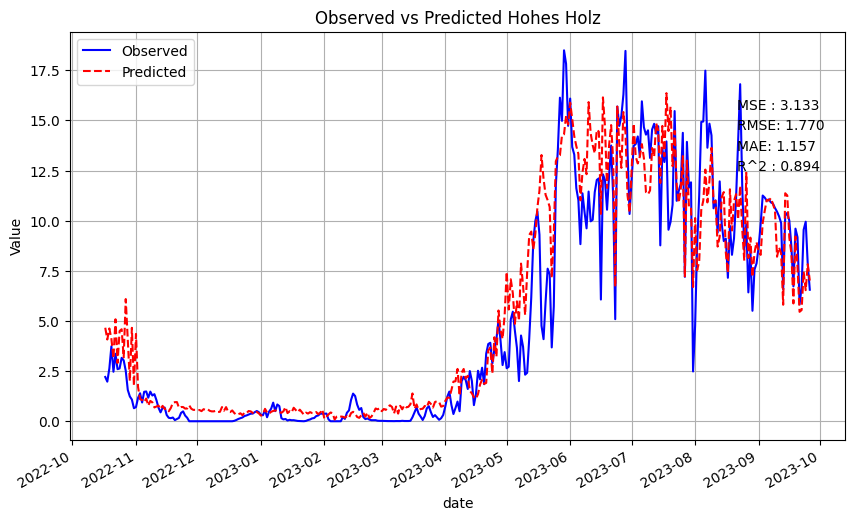

Retraining the model on the third site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 1.0570015429397708
Root Mean Squared Error: 1.0281058033781205
MAE: 0.63465702217474
Test R^2 Score: 0.9037892518076294
[('TA_F', 0.36024916), ('TA_F_lag_1', 0.20701818), ('MNDVI', 0.050829448), ('SW_IN_F', 0.030336058), ('TA_F_lag_2', 0.026414338), ('TA_F_lag_6', 0.023915367), ('TA_F_lag_4', 0.023564756), ('LE_F_MDS', 0.0233012), ('TA_F_lag_5', 0.020960871), ('CLr_lag_6', 0.015126631), ('CLr_lag_3', 0.009243546), ('LSWI', 0.00845921), ('CLr_lag_2', 0.00781223), ('CLr_lag_4', 0.0076564946), ('LSWI_lag_6', 0.00752912), ('SW_IN_F_lag_6', 0.006278803), ('LE_F_MDS_lag_4', 0.006221579), ('CLr', 0.0059778467), ('MNDWI', 0.005495541), ('LSWI_lag_5', 0.0048709745), ('LSWI_lag_4', 0.004751103), ('VPD_F', 0.00469519), ('EVI_lag_2', 0.004613053), ('LE_F_MDS_lag_5', 0.0044415086), ('H_F_MDS', 0.004142557), ('EVI_lag_3', 0.0041417736), ('CLr_lag_5', 0.003768641), ('MNDVI_lag_5', 0.0036584511), ('LW_IN_F_lag_2', 0.0034856307), ('LE_F_MDS_lag_6', 0.0034709417), ('SW_IN_F_lag_5', 0

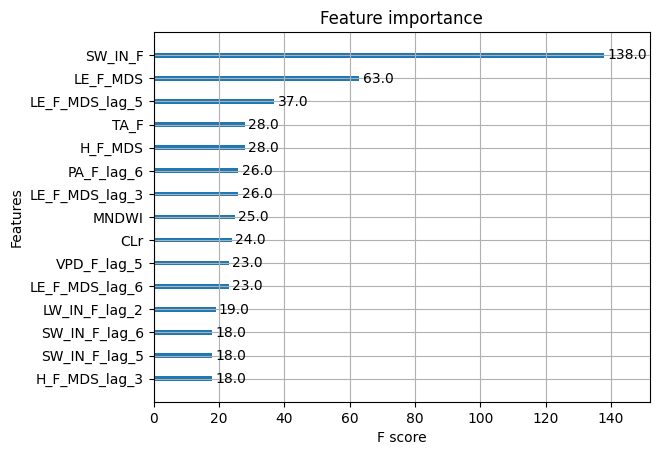

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 9.386245800423906
Root Mean Squared Error: 3.0636980596044228
mae: 2.360676012465977
Test R^2 Score: 0.4985058425019534


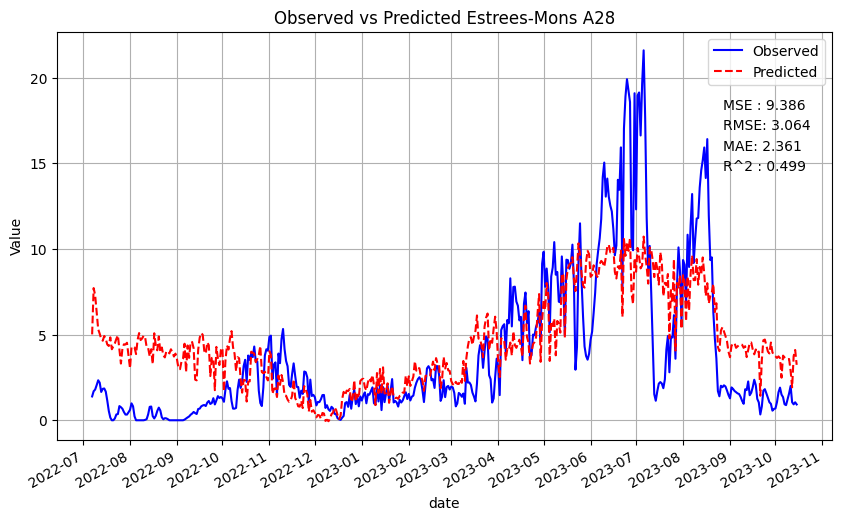

Hohes Holz
Mean Squared Error: 6.469456098289156
Root Mean Squared Error: 2.5435125512348384
MAE: 1.8063873308945377
Test R^2 Score: 0.781972480180713


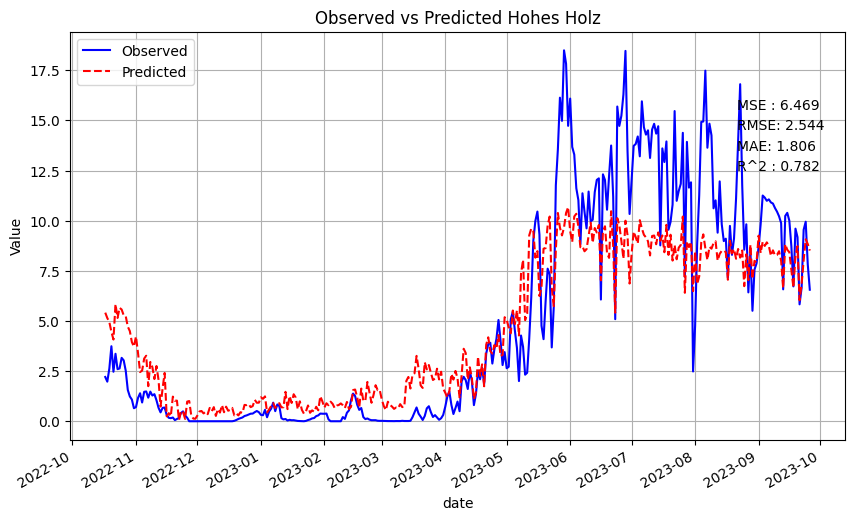

Hyytiala
Mean Squared Error: 1.0570015429397708
Root Mean Squared Error: 1.0281058033781205
MAE: 0.63465702217474
Test R^2 Score: 0.9037892518076294


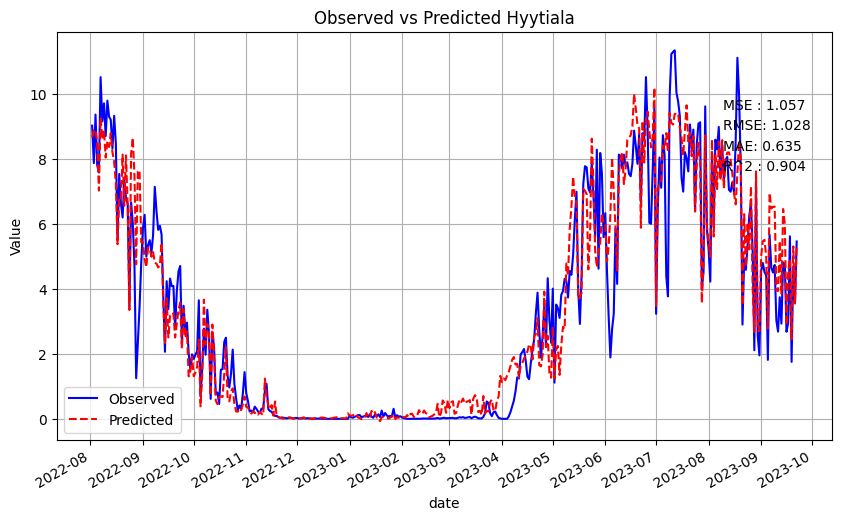

Retraining the model on the fourth site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 1.0206016522712769
Root Mean Squared Error: 1.0102483121843246
MAE: 0.5777885923975925
Test R^2 Score: 0.8837883463422682
[('CLr', 0.4093867), ('LE_F_MDS', 0.06775716), ('MNDVI', 0.037569243), ('CLr_lag_1', 0.03347029), ('MNDVI_lag_6', 0.025457717), ('LSWI_lag_3', 0.0179786), ('NDVI', 0.016972441), ('MNDWI_lag_1', 0.015586497), ('EVI', 0.015353123), ('LE_F_MDS_lag_4', 0.01447971), ('SW_IN_F', 0.014466776), ('MNDVI_lag_1', 0.009641812), ('EVI2_lag_2', 0.0096313115), ('NDII_lag_6', 0.009451282), ('CLr_lag_5', 0.008647639), ('NDVI_lag_6', 0.008293362), ('MNDVI_lag_5', 0.008072246), ('EVI2', 0.007852745), ('MNDWI_lag_2', 0.0076826527), ('NDII', 0.0076222275), ('EVI_lag_1', 0.007164069), ('CLr_lag_3', 0.007100708), ('EVI_lag_5', 0.006616218), ('H_F_MDS', 0.0063992534), ('LE_F_MDS_lag_1', 0.006289615), ('MNDWI_lag_4', 0.006221009), ('TA_F', 0.0059434264), ('EVI_lag_6', 0.0058743954), ('EVI2_lag_5', 0.0054080742), ('LSWI_lag_1', 0.0052651623), ('LSWI', 0.005176411), ('EVI2

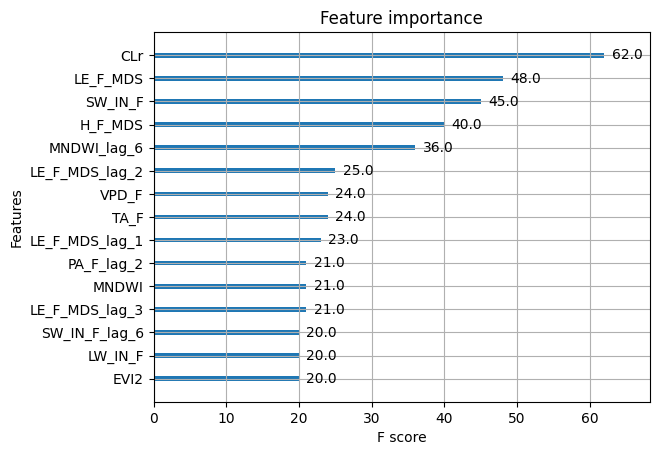

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 8.930994289153276
Root Mean Squared Error: 2.988476917955579
MAE: 2.242161531817288
Test R^2 Score: 0.5228293023759817


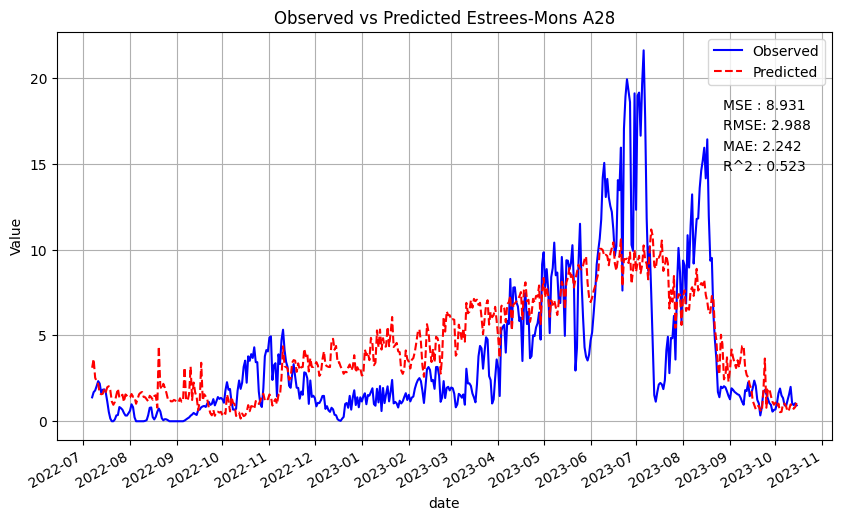

Hohes Holz
Mean Squared Error: 7.399059169363452
Root Mean Squared Error: 2.720121168140025
MAE: 1.9971869438501066
Test R^2 Score: 0.7506438725012637


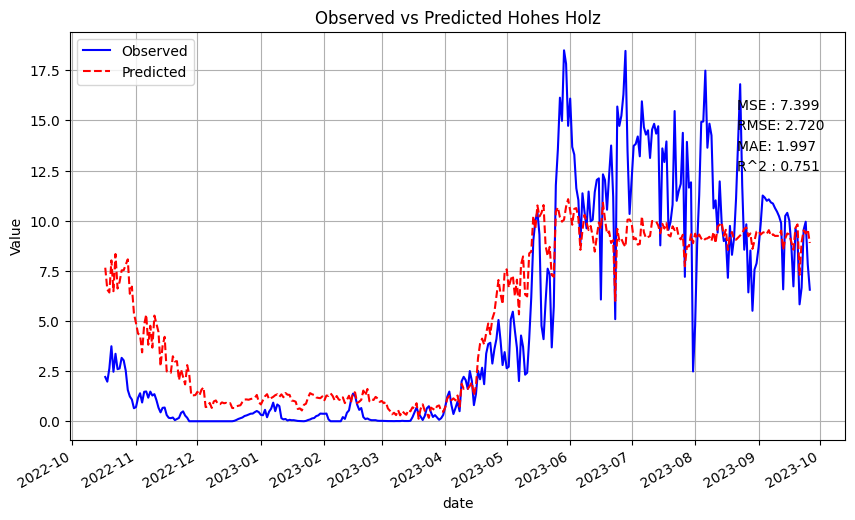

Hyytiala
Mean Squared Error: 5.238778079051016
Root Mean Squared Error: 2.288837713567962
MAE: 1.9335275188319796
Test R^2 Score: 0.5231541884059401


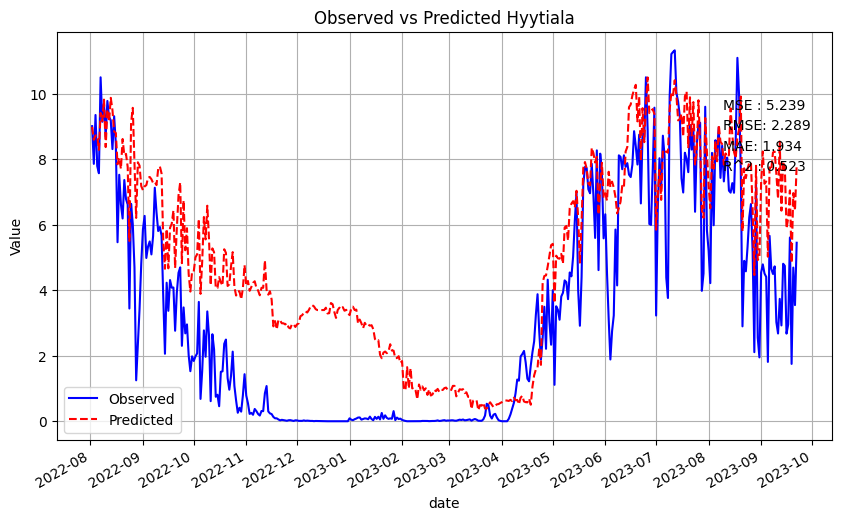

Torgnon
Mean Squared Error: 1.0206016522712769
Root Mean Squared Error: 1.0102483121843246
MAE: 0.5777885923975925
Test R^2 Score: 0.8837883463422682


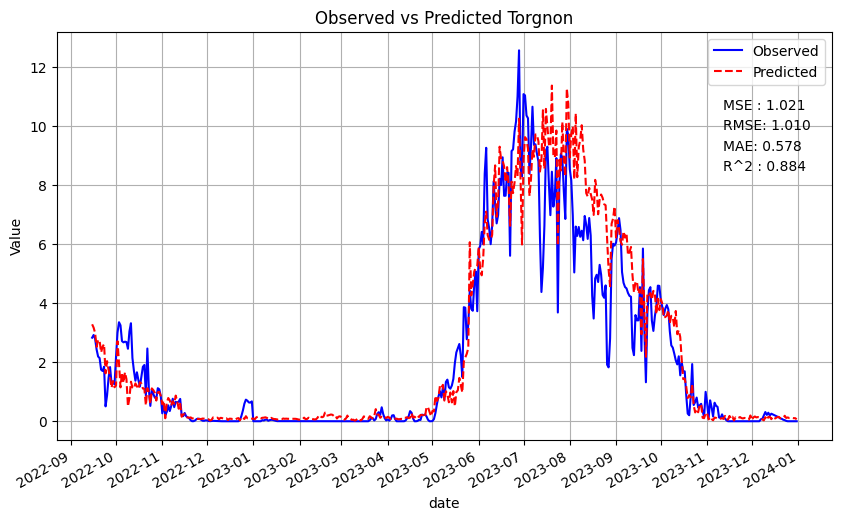

average MSE 5.647358297459755
average RMSE 2.2519210279619726
average MAE 1.6876661467242418
average R2 0.6701039274063635


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 7.071166692453641
Root Mean Squared Error: 2.6591665409397813
MAE: 2.1238182389299882
Test R^2 Score: 0.6654916292931912


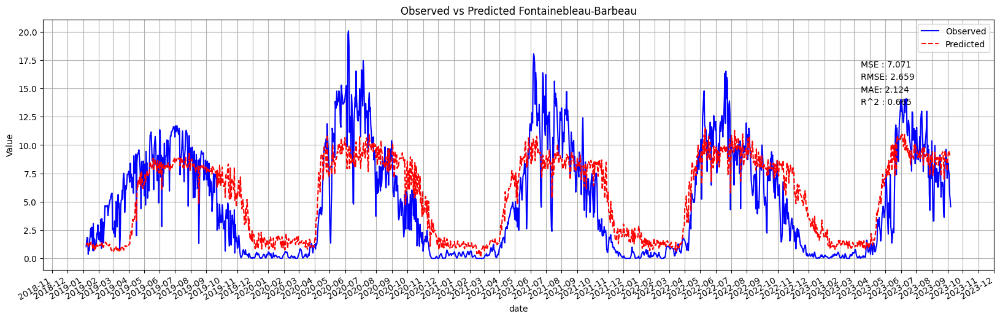

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 7.734838317979949
Root Mean Squared Error: 2.7811577297916688
MAE: 2.187874320125253
Test R^2 Score: 0.4840840572407229


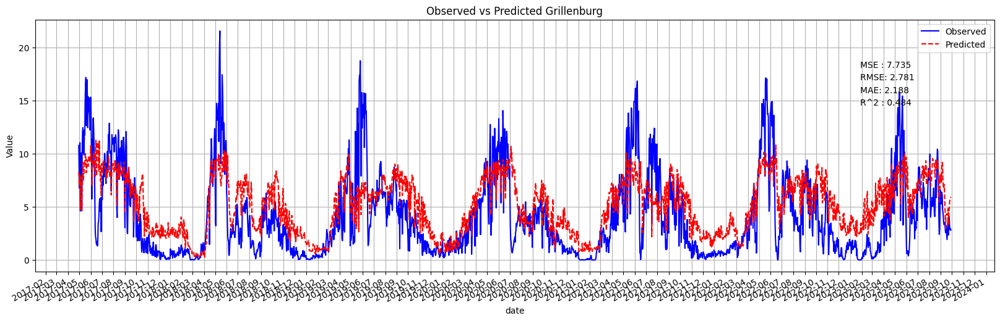

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 7.736769138251281
Root Mean Squared Error: 2.781504833404264
MAE: 1.7848726246207176
Test R^2 Score: 0.5690965433578967


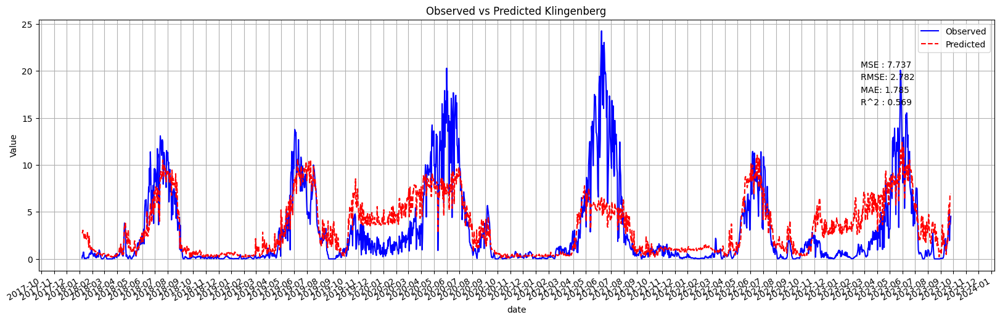

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 12.629595358643241
Root Mean Squared Error: 3.553814198666447
MAE: 3.1740601595949207
Test R^2 Score: -0.0646511318126759


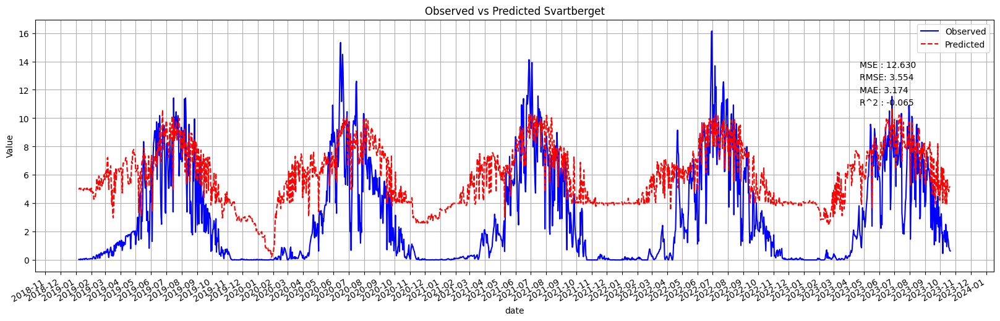

average MSE 8.793092376832028
average RMSE 2.9439108257005406
average MAE 2.31765633581772
average R2 0.41350527451978375


In [63]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 7  # For example, create lag features for the previous 3 time points
column = col2
eta = 0.1
max_depth = 4
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']


params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

First training and testing the model on the first site
Mean Squared Error: 6.848231831303138
Root Mean Squared Error: 2.6169126525933453
MAE: 1.7256755924547382
Test R^2 Score: 0.6341084257099289


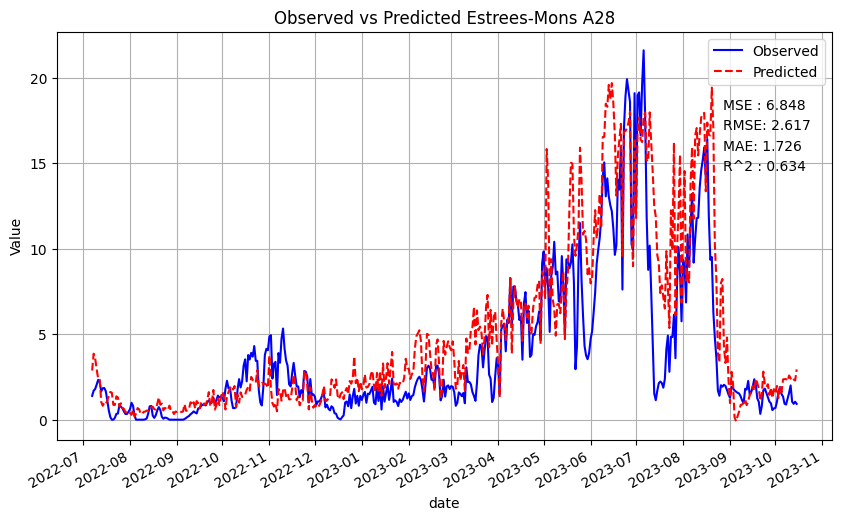

[('LE_F_MDS', 0.35179952), ('MNDVI', 0.177172), ('MNDVI_lag_1', 0.072375275), ('EVI2', 0.018380698), ('SW_IN_F', 0.015211916), ('MNDVI_lag_2', 0.014964051), ('LE_F_MDS_lag_1', 0.014845729), ('LE_F_MDS_lag_3', 0.011631834), ('CLr', 0.011111863), ('LE_F_MDS_lag_2', 0.010813636), ('H_F_MDS_lag_2', 0.010770702), ('EVI2_lag_4', 0.010766728), ('MNDWI_lag_4', 0.010550234), ('CLr_lag_4', 0.010548999), ('EVI2_lag_1', 0.010453494), ('MNDWI', 0.010343147), ('CLr_lag_1', 0.010103334), ('EVI2_lag_2', 0.009870187), ('EVI_lag_3', 0.009131351), ('CLr_lag_3', 0.008822429), ('TA_F', 0.008743533), ('EVI', 0.007482543), ('LE_F_MDS_lag_4', 0.0065223887), ('NDVI_lag_3', 0.0060288226), ('NDVI_lag_1', 0.0057588667), ('H_F_MDS_lag_1', 0.0056975153), ('MNDVI_lag_3', 0.005614268), ('LSWI_lag_3', 0.0053825965), ('TA_F_lag_4', 0.0053076455), ('H_F_MDS_lag_4', 0.0050169593), ('NDVI_lag_4', 0.0045931526), ('NDVI', 0.00457724), ('SW_IN_F_lag_2', 0.004561135), ('LSWI', 0.004509286), ('CLr_lag_2', 0.0044678045), ('MNDW

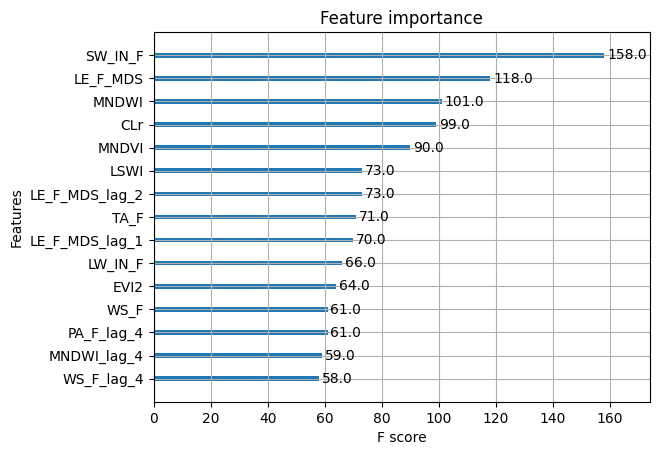

Retraining the model on the second site
Mean Squared Error: 2.9047828650538707
Root Mean Squared Error: 1.704342355588768
MAE: 1.1371544001967422
Test R^2 Score: 0.9018649888480839
[('LE_F_MDS', 0.5576562), ('EVI2_lag_1', 0.07009818), ('EVI', 0.051016014), ('SW_IN_F', 0.038427748), ('EVI2', 0.021626571), ('LE_F_MDS_lag_3', 0.015964579), ('LSWI', 0.01118823), ('CLr_lag_4', 0.00952322), ('CLr_lag_3', 0.008995619), ('EVI2_lag_4', 0.0075472), ('H_F_MDS', 0.006995212), ('VPD_F', 0.0065444256), ('NDII_lag_3', 0.0062051695), ('H_F_MDS_lag_4', 0.005686111), ('MNDWI_lag_3', 0.005675964), ('EVI2_lag_2', 0.005475701), ('LE_F_MDS_lag_4', 0.005450979), ('EVI2_lag_3', 0.005449064), ('MNDVI_lag_2', 0.0054258364), ('NDVI_lag_2', 0.005327334), ('H_F_MDS_lag_3', 0.0051330337), ('NDVI_lag_4', 0.0047188736), ('H_F_MDS_lag_2', 0.004664295), ('LE_F_MDS_lag_2', 0.0045977435), ('TA_F_lag_2', 0.004490206), ('LSWI_lag_3', 0.0044781296), ('CLr', 0.0044383556), ('TA_F', 0.0044169775), ('LSWI_lag_4', 0.0044113556)

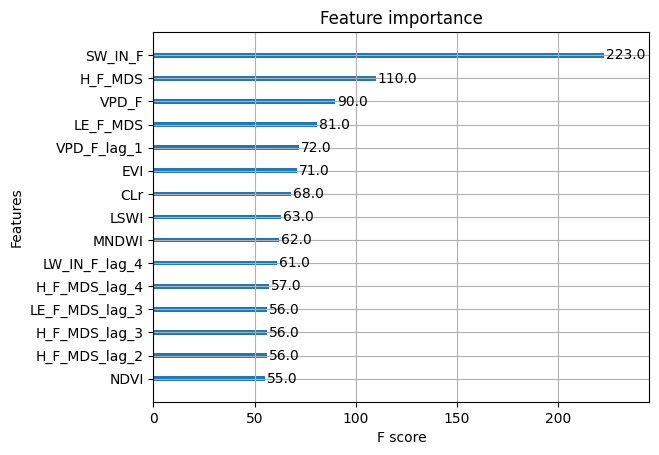

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 15.740384749032314
Root Mean Squared Error: 3.967415373896753
MAE: 3.0304882957118457
Test R^2 Score: 0.15901296894925088


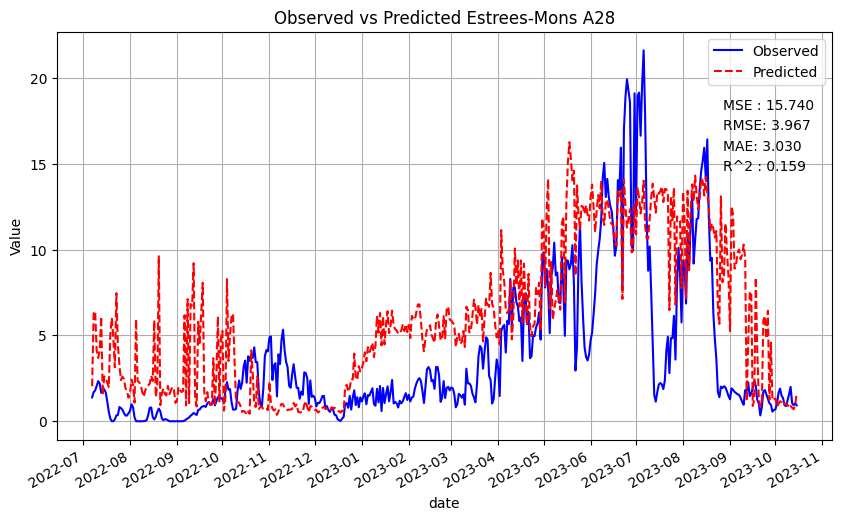

Hohes Holz
Mean Squared Error: 2.9047828650538707
Root Mean Squared Error: 1.704342355588768
MAE: 1.1371544001967422
Test R^2 Score: 0.9018649888480839


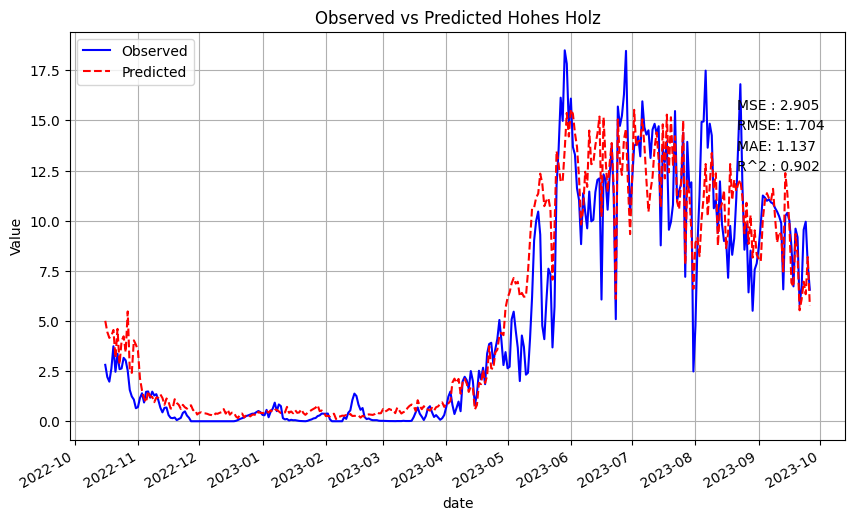

Retraining the model on the third site
Mean Squared Error: 1.297903427099057
Root Mean Squared Error: 1.1392556460685446
MAE: 0.7108229203576393
Test R^2 Score: 0.8825362511254159
[('TA_F', 0.6282043), ('TA_F_lag_1', 0.09524433), ('MNDVI', 0.058249813), ('LE_F_MDS', 0.024670497), ('SW_IN_F', 0.024034245), ('TA_F_lag_4', 0.010503026), ('LSWI_lag_1', 0.007151442), ('CLr_lag_4', 0.006216365), ('LSWI', 0.0055219643), ('CLr_lag_3', 0.0052810563), ('CLr', 0.0046808776), ('CLr_lag_1', 0.0045616315), ('MNDVI_lag_3', 0.004179585), ('TA_F_lag_2', 0.0041637006), ('LW_IN_F_lag_2', 0.0041432227), ('LSWI_lag_4', 0.003937955), ('TA_F_lag_3', 0.0037295641), ('NDII_lag_2', 0.0035354595), ('EVI2_lag_2', 0.0031821968), ('CLr_lag_2', 0.002905693), ('LW_IN_F_lag_3', 0.0028680253), ('LE_F_MDS_lag_3', 0.0028276306), ('NDVI_lag_1', 0.0027540491), ('LE_F_MDS_lag_2', 0.0025728745), ('EVI2', 0.0025146776), ('EVI2_lag_3', 0.0024944968), ('MNDWI', 0.002445561), ('MNDWI_lag_4', 0.0024396745), ('MNDWI_lag_1', 0.0022

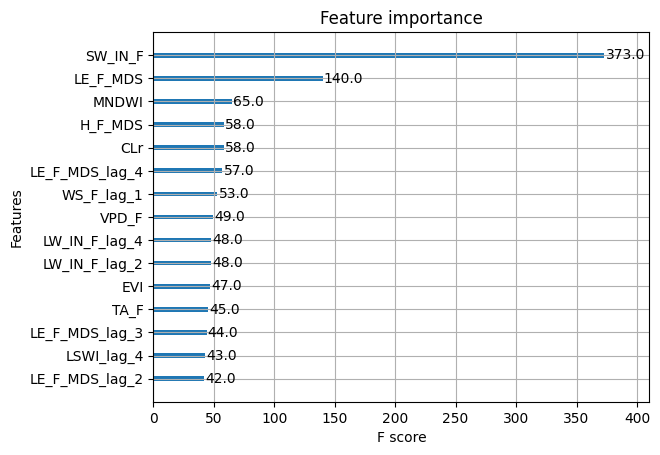

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 10.812419289254123
Root Mean Squared Error: 3.2882243368198165
mae: 2.4834673779459413
Test R^2 Score: 0.42230736150812953


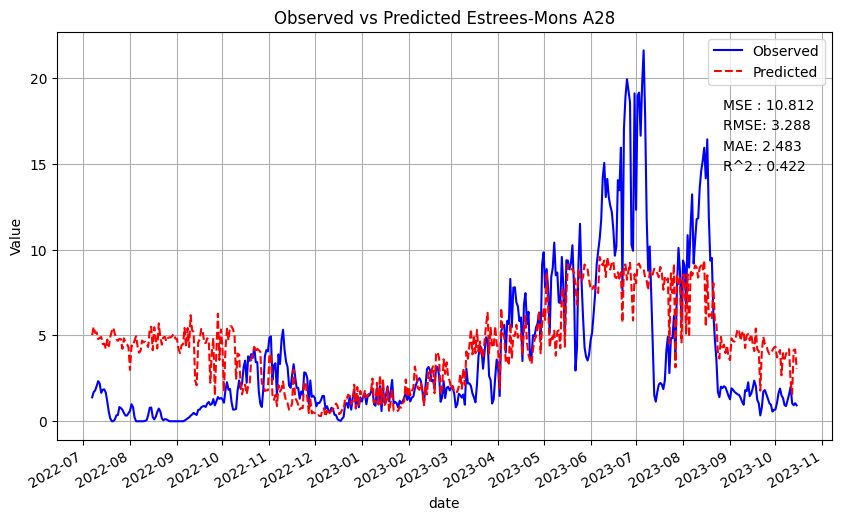

Hohes Holz
Mean Squared Error: 7.118660301687151
Root Mean Squared Error: 2.668081764430609
MAE: 1.8872858658286873
Test R^2 Score: 0.7595036047281919


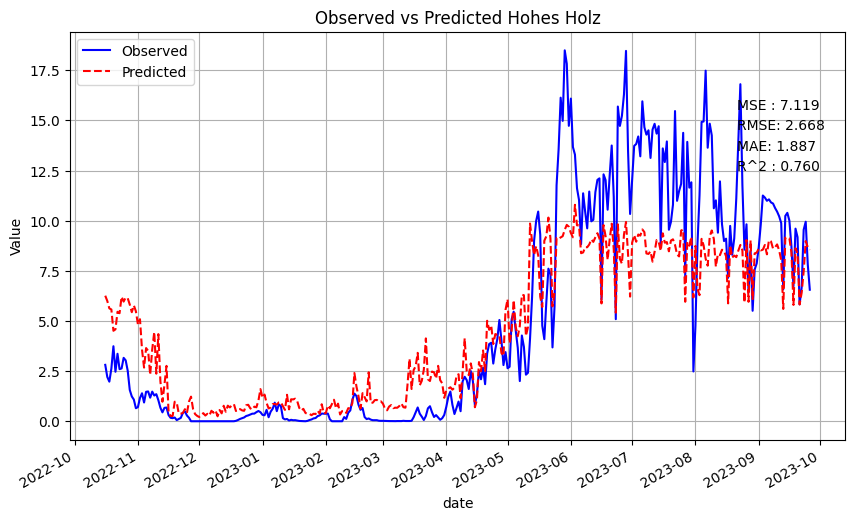

Hyytiala
Mean Squared Error: 1.297903427099057
Root Mean Squared Error: 1.1392556460685446
MAE: 0.7108229203576393
Test R^2 Score: 0.8825362511254159


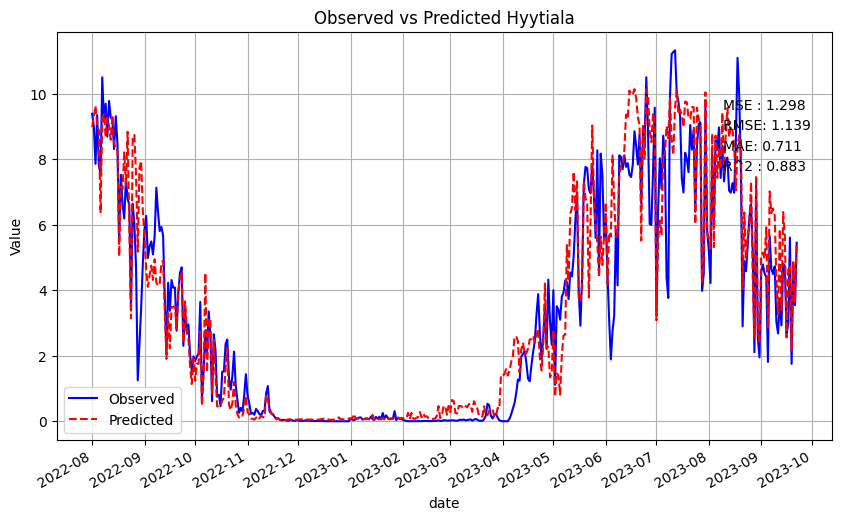

Retraining the model on the fourth site
Mean Squared Error: 1.110740478771821
Root Mean Squared Error: 1.053916732371121
MAE: 0.6048505411556901
Test R^2 Score: 0.8732585323793389
[('CLr', 0.550626), ('MNDVI', 0.03547959), ('LE_F_MDS', 0.034684353), ('SW_IN_F', 0.021456152), ('LE_F_MDS_lag_4', 0.019571982), ('EVI', 0.018499734), ('NDVI_lag_4', 0.01812321), ('NDVI', 0.013466691), ('MNDVI_lag_4', 0.012760733), ('MNDWI_lag_1', 0.011828746), ('NDII', 0.010442052), ('EVI2_lag_1', 0.009842294), ('H_F_MDS', 0.009547313), ('MNDWI_lag_2', 0.0084910765), ('EVI2', 0.00834659), ('CLr_lag_4', 0.007989771), ('EVI2_lag_2', 0.0077049136), ('EVI2_lag_4', 0.0066847703), ('LSWI_lag_3', 0.006373658), ('P_F_lag_1', 0.0061492557), ('MNDWI_lag_3', 0.0058592237), ('NDII_lag_2', 0.0057599386), ('LSWI_lag_4', 0.0053831837), ('MNDWI_lag_4', 0.005118903), ('TA_F', 0.004888298), ('CLr_lag_2', 0.0048145843), ('EVI_lag_1', 0.0046391), ('MNDVI_lag_1', 0.004565579), ('LE_F_MDS_lag_1', 0.0044495747), ('SW_IN_F_lag_3', 

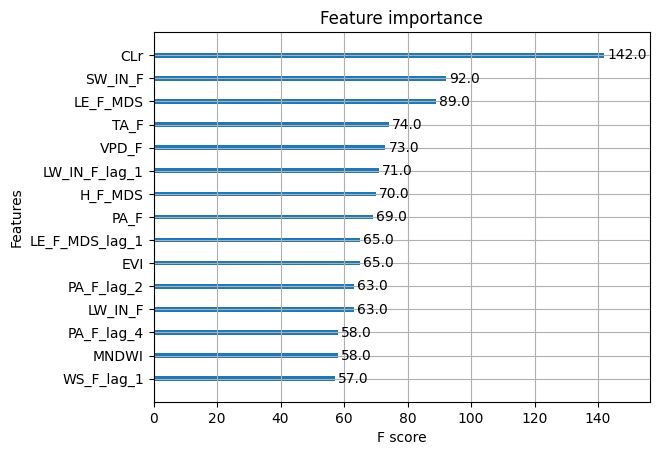

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 10.220920691898987
Root Mean Squared Error: 3.197017468187965
MAE: 2.4808218319968036
Test R^2 Score: 0.45391031513294233


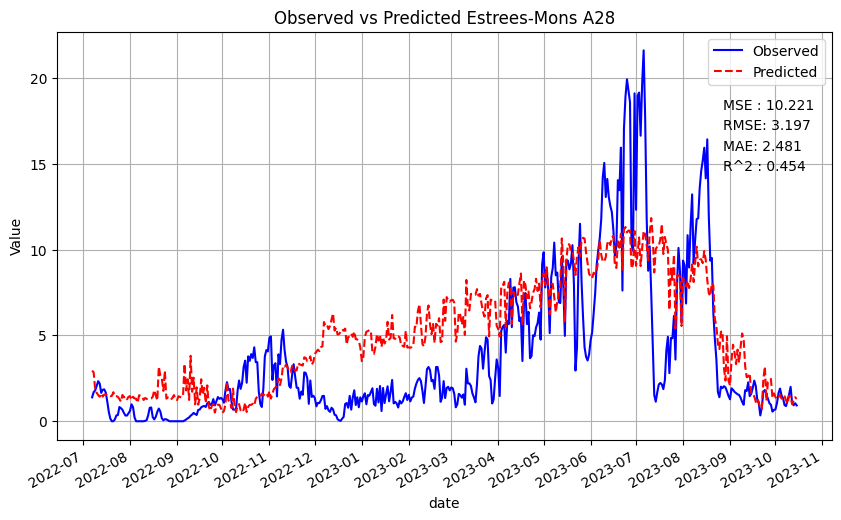

Hohes Holz
Mean Squared Error: 7.446597127410673
Root Mean Squared Error: 2.7288453835662203
MAE: 2.0782674555764356
Test R^2 Score: 0.7484246065570481


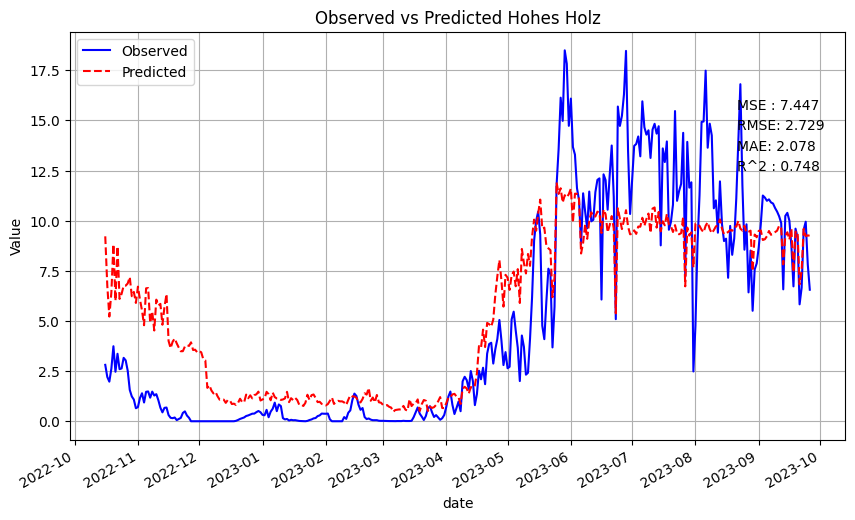

Hyytiala
Mean Squared Error: 8.51174370969461
Root Mean Squared Error: 2.917489281847426
MAE: 2.4197771760531195
Test R^2 Score: 0.22966431498290418


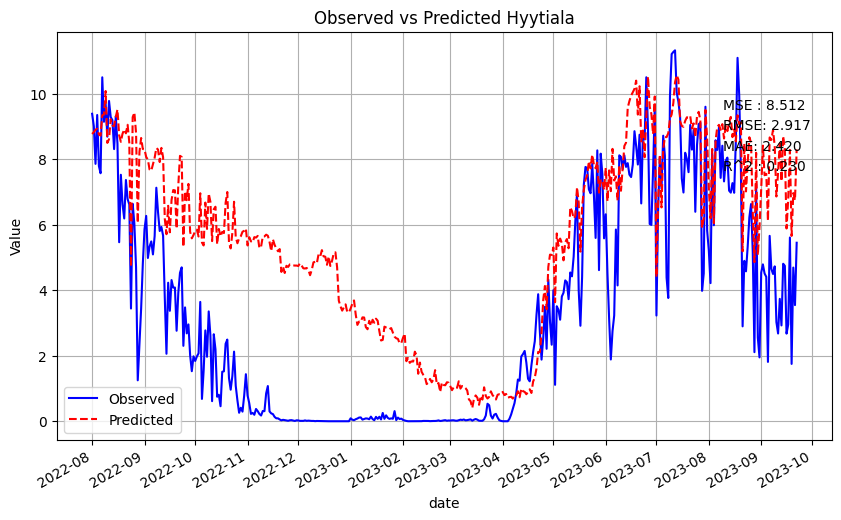

Torgnon
Mean Squared Error: 1.110740478771821
Root Mean Squared Error: 1.053916732371121
MAE: 0.6048505411556901
Test R^2 Score: 0.8732585323793389


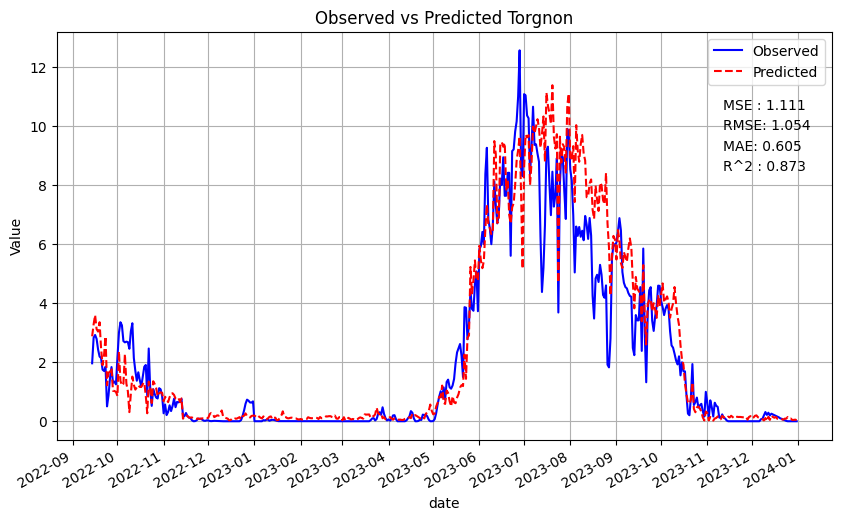

average MSE 6.822500501944023
average RMSE 2.474317216493183
average MAE 1.8959292511955121
average R2 0.5763144422630584
Mean Squared Error: 8.352418508293965
Root Mean Squared Error: 2.8900551047158194
MAE: 2.367316680033017
Test R^2 Score: 0.6047053940918814


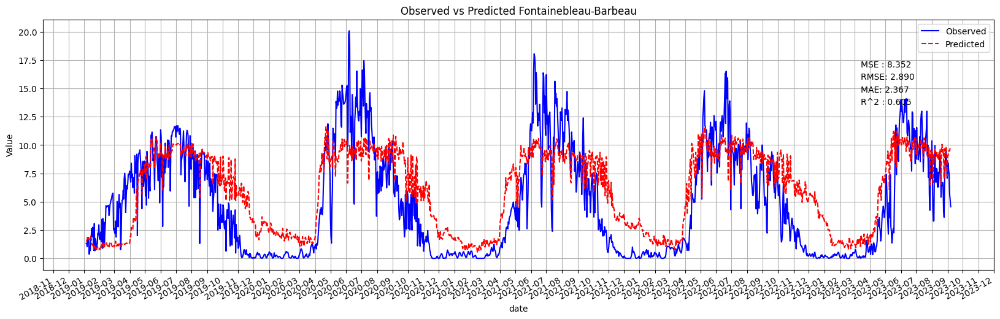

Mean Squared Error: 9.95599378602702
Root Mean Squared Error: 3.1553119950374193
MAE: 2.6201530795864896
Test R^2 Score: 0.33578707246905826


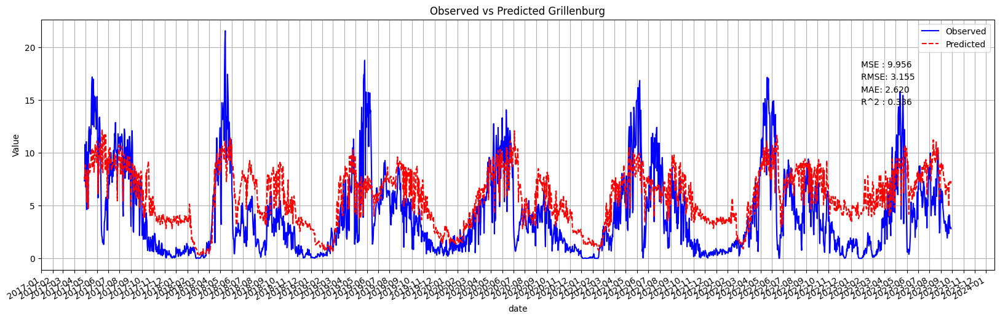

Mean Squared Error: 8.18743669722919
Root Mean Squared Error: 2.8613697239659874
MAE: 1.911346766017794
Test R^2 Score: 0.5436935818840523


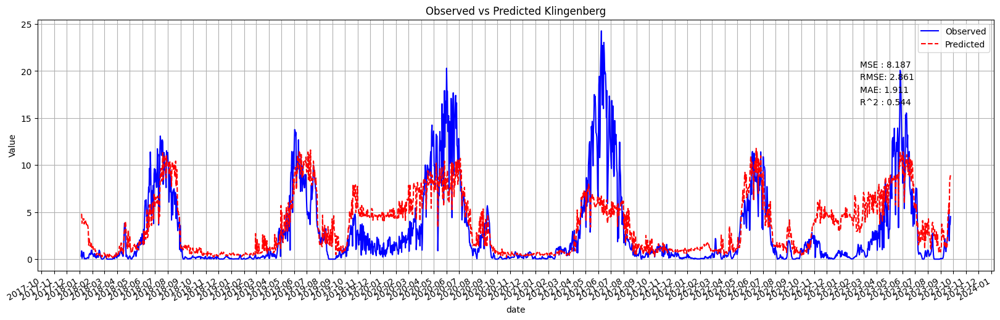

Mean Squared Error: 19.159111671048098
Root Mean Squared Error: 4.377112252507136
MAE: 3.937221523843597
Test R^2 Score: -0.6155543365413989


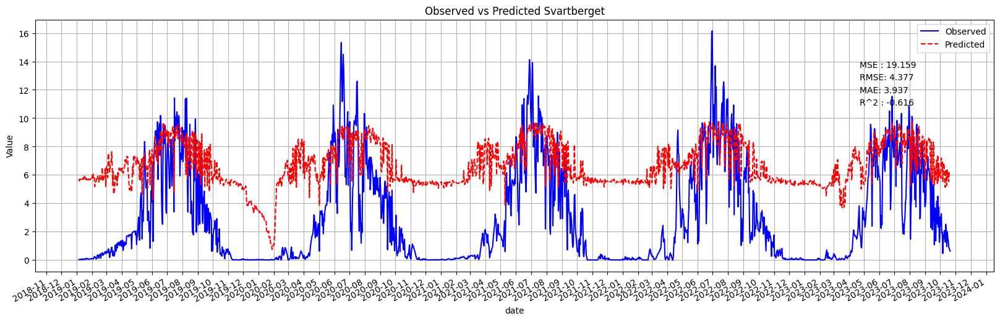

average MSE 11.413740165649568
average RMSE 3.320962269056591
average MAE 2.7090095123702245
average R2 0.21715792797589822


In [64]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 5  # For example, create lag features for the previous 3 time points
column = col2
eta = 0.1
max_depth = 6
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']


params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

First training and testing the model on the first site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 8.511866580664057
Root Mean Squared Error: 2.9175103394271042
MAE: 1.851446149951731
Test R^2 Score: 0.5452227173282509


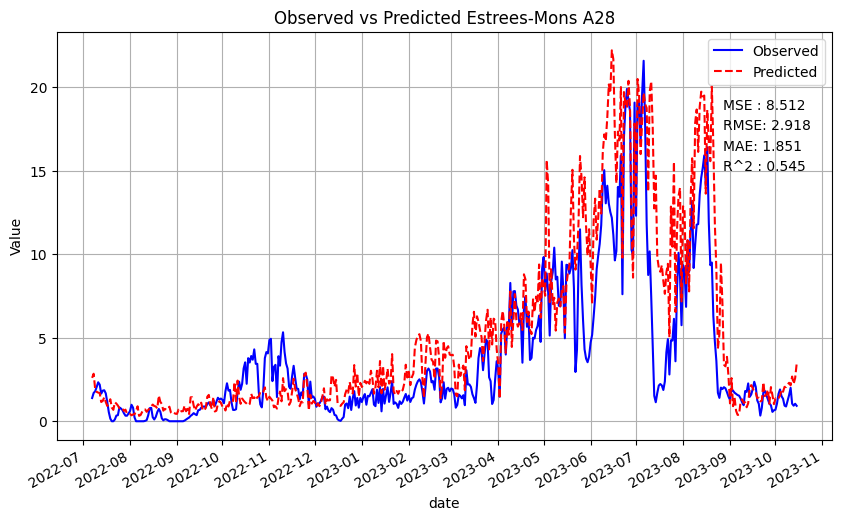

[('LE_F_MDS', 0.2993258), ('MNDVI', 0.16249867), ('MNDVI_lag_2', 0.04543119), ('MNDVI_lag_1', 0.034280382), ('LE_F_MDS_lag_1', 0.017450562), ('EVI2_lag_6', 0.017208278), ('EVI2_lag_1', 0.014278599), ('MNDWI_lag_2', 0.012759782), ('SW_IN_F', 0.011348263), ('CLr_lag_4', 0.011223165), ('CLr_lag_1', 0.010634323), ('CLr', 0.0104783), ('EVI2', 0.009944768), ('H_F_MDS_lag_5', 0.009388449), ('TA_F_lag_5', 0.009007149), ('NDVI_lag_1', 0.008882894), ('H_F_MDS_lag_2', 0.008001861), ('LE_F_MDS_lag_3', 0.007922228), ('LE_F_MDS_lag_2', 0.007548648), ('LE_F_MDS_lag_5', 0.007447888), ('MNDWI', 0.0074169715), ('CLr_lag_3', 0.007309915), ('NDVI_lag_6', 0.0069675054), ('MNDWI_lag_4', 0.0068244855), ('MNDVI_lag_3', 0.006686671), ('LSWI_lag_4', 0.0066850292), ('CLr_lag_2', 0.006060189), ('LE_F_MDS_lag_6', 0.0060251057), ('LSWI_lag_3', 0.005844101), ('H_F_MDS_lag_1', 0.0058317995), ('MNDWI_lag_3', 0.005710965), ('EVI_lag_3', 0.0056359293), ('H_F_MDS_lag_4', 0.0054582465), ('H_F_MDS_lag_6', 0.00541098), ('ND

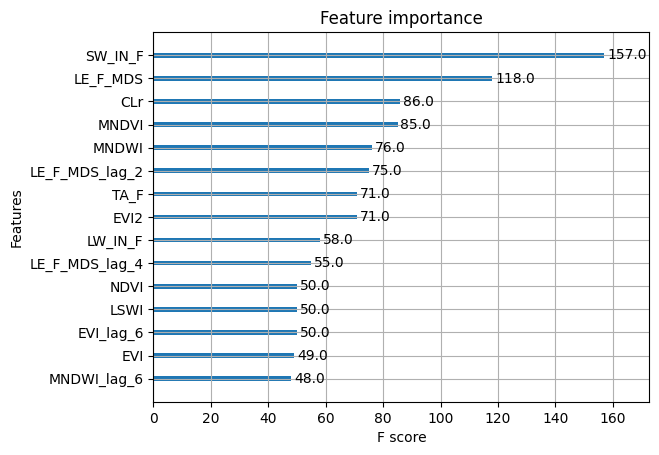

Retraining the model on the second site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 3.05895706459118
Root Mean Squared Error: 1.7489874398037226
MAE: 1.1550959666145846
Test R^2 Score: 0.8969099083610951
[('LE_F_MDS', 0.42669997), ('EVI2_lag_1', 0.07791832), ('EVI', 0.060012877), ('SW_IN_F', 0.039227694), ('EVI2', 0.023243973), ('EVI2_lag_6', 0.016757818), ('LE_F_MDS_lag_3', 0.01615455), ('LSWI', 0.011468284), ('LE_F_MDS_lag_2', 0.01088103), ('MNDVI_lag_2', 0.010157668), ('NDVI_lag_2', 0.009257805), ('EVI2_lag_2', 0.0082116), ('CLr', 0.008192203), ('EVI_lag_6', 0.008162296), ('LE_F_MDS_lag_6', 0.007861904), ('MNDVI', 0.007524686), ('SW_IN_F_lag_6', 0.007139264), ('H_F_MDS_lag_3', 0.007138877), ('NDII_lag_5', 0.0064206864), ('H_F_MDS', 0.0060612718), ('CLr_lag_1', 0.0058170357), ('H_F_MDS_lag_4', 0.0057859635), ('VPD_F', 0.0057585146), ('MNDWI_lag_2', 0.005681664), ('MNDWI_lag_4', 0.005164455), ('NDVI_lag_6', 0.004898415), ('TA_F_lag_3', 0.004889816), ('EVI2_lag_5', 0.004659911), ('TA_F_lag_5', 0.00455444), ('EVI2_lag_3', 0.004473083), ('NDVI_lag_3'

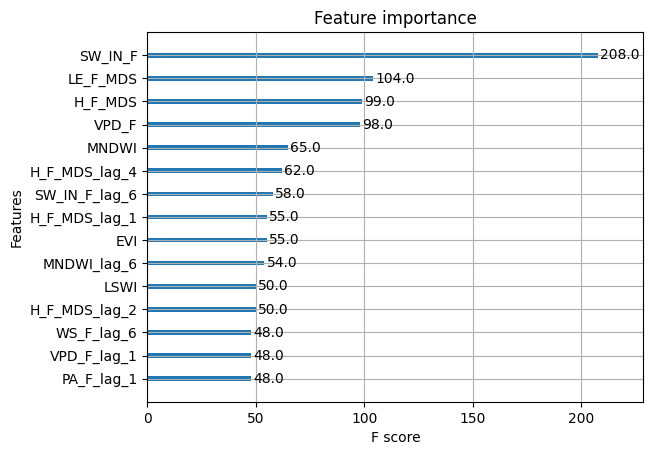

Retesting the model on the first site
Estrees-Mons A28
Mean Squared Error: 15.510626837108541
Root Mean Squared Error: 3.9383533154236607
MAE: 3.043109185360025
Test R^2 Score: 0.17128861705379128


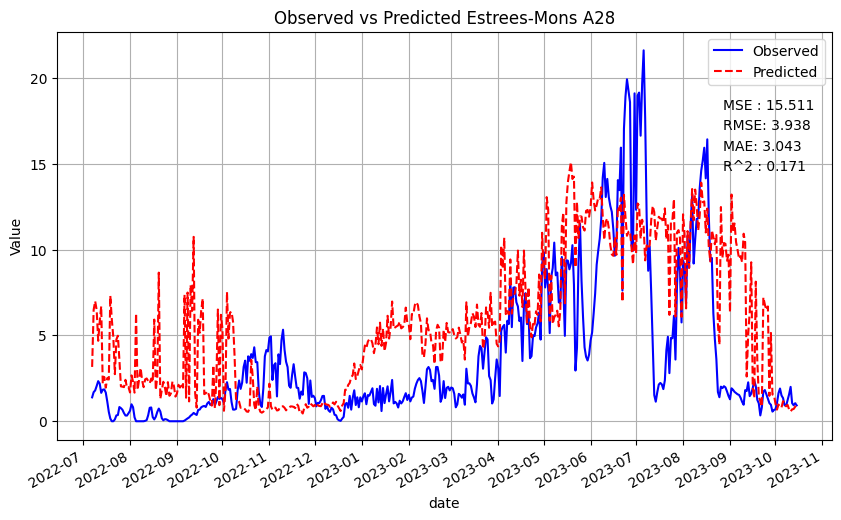

Hohes Holz
Mean Squared Error: 3.05895706459118
Root Mean Squared Error: 1.7489874398037226
MAE: 1.1550959666145846
Test R^2 Score: 0.8969099083610951


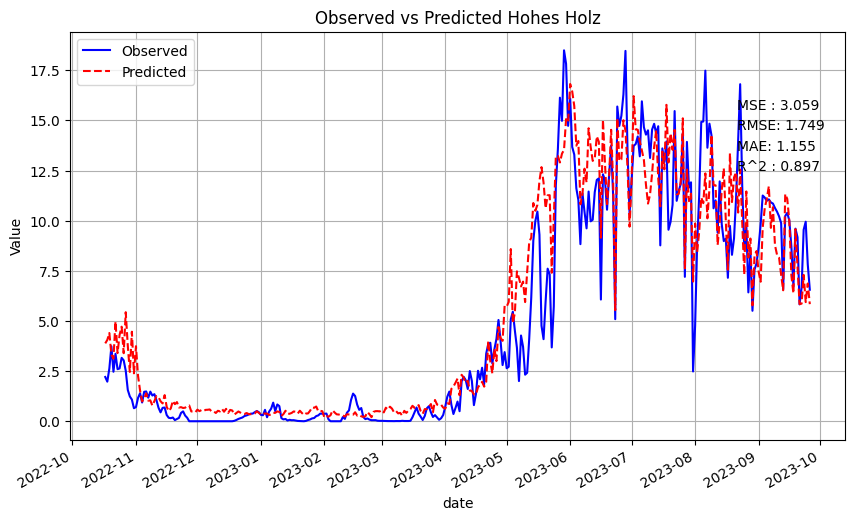

Retraining the model on the third site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 1.2960453471296722
Root Mean Squared Error: 1.1384398741829418
MAE: 0.7071193676173178
Test R^2 Score: 0.8820309266609162
[('TA_F', 0.5522134), ('TA_F_lag_1', 0.12974332), ('MNDVI', 0.051406346), ('LE_F_MDS', 0.028523112), ('SW_IN_F', 0.021982424), ('CLr_lag_6', 0.015621686), ('CLr', 0.007881806), ('CLr_lag_5', 0.006960431), ('LSWI_lag_5', 0.006760189), ('CLr_lag_2', 0.00631306), ('LSWI', 0.0057628714), ('NDII_lag_2', 0.004748671), ('EVI2_lag_2', 0.0044295504), ('TA_F_lag_5', 0.0042806296), ('TA_F_lag_4', 0.0040989798), ('LW_IN_F_lag_3', 0.0040345), ('LSWI_lag_2', 0.0038419222), ('LSWI_lag_6', 0.003715721), ('LE_F_MDS_lag_5', 0.003616905), ('MNDWI_lag_1', 0.0036131225), ('LW_IN_F_lag_2', 0.0033610032), ('LW_IN_F_lag_1', 0.0033320584), ('MNDWI_lag_6', 0.003279459), ('LSWI_lag_3', 0.003257842), ('VPD_F', 0.0031212675), ('LE_F_MDS_lag_6', 0.002897232), ('CLr_lag_1', 0.0028676838), ('EVI_lag_2', 0.0026825985), ('EVI2_lag_5', 0.002644205), ('TA_F_lag_6', 0.0024776284), (

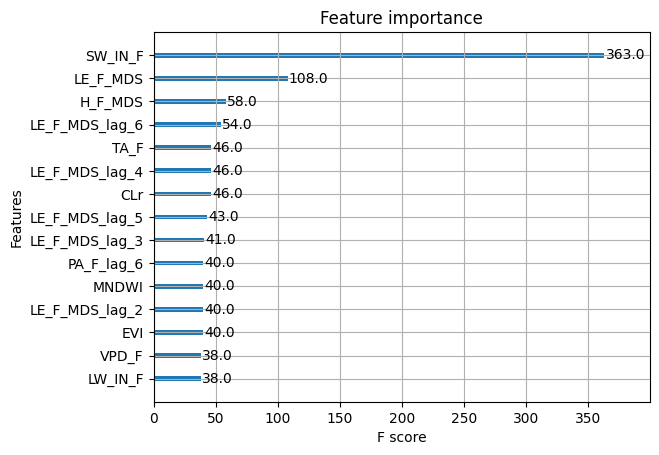

Estrees-Mons A28
Retesting the model on the first and second site
Mean Squared Error: 10.835434051363356
Root Mean Squared Error: 3.2917220495302084
mae: 2.4916813873724926
Test R^2 Score: 0.4210777145353787


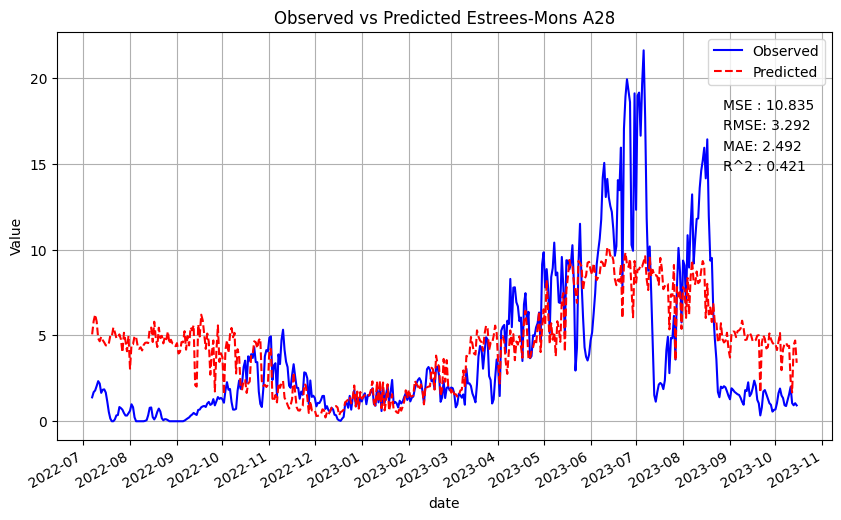

Hohes Holz
Mean Squared Error: 6.7678927843698675
Root Mean Squared Error: 2.60151740035885
MAE: 1.8144420557701026
Test R^2 Score: 0.7719148479005478


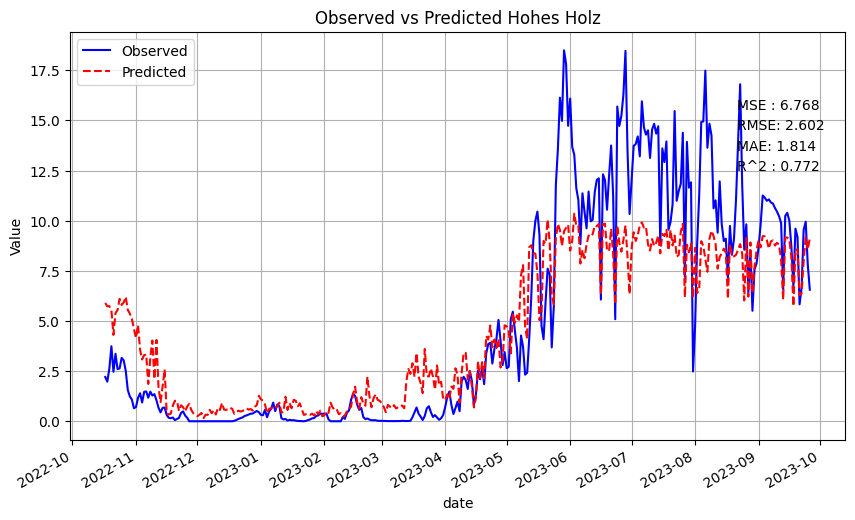

Hyytiala
Mean Squared Error: 1.2960453471296722
Root Mean Squared Error: 1.1384398741829418
MAE: 0.7071193676173178
Test R^2 Score: 0.8820309266609162


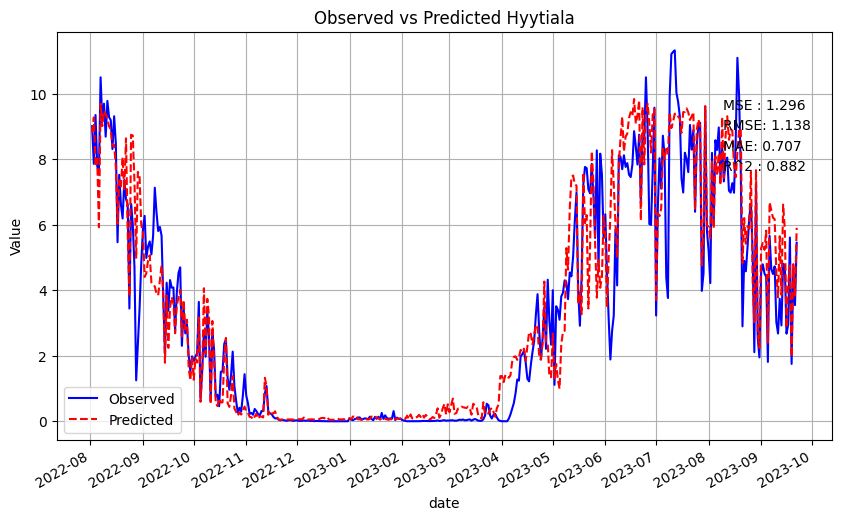

Retraining the model on the fourth site


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\2698491870.py:102: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perf

Mean Squared Error: 1.0853996011786815
Root Mean Squared Error: 1.0418251298460224
MAE: 0.6015599930791189
Test R^2 Score: 0.876410074144295
[('CLr', 0.54275304), ('MNDVI', 0.04165341), ('MNDVI_lag_6', 0.035980348), ('LE_F_MDS', 0.032369014), ('SW_IN_F', 0.013963791), ('EVI', 0.0106689455), ('NDVI_lag_6', 0.009292562), ('MNDWI_lag_2', 0.009273745), ('EVI_lag_1', 0.0090417685), ('EVI2_lag_2', 0.008611603), ('NDVI_lag_5', 0.008193301), ('NDVI', 0.007966884), ('MNDWI_lag_1', 0.007935505), ('EVI2_lag_6', 0.0077106105), ('NDII_lag_6', 0.007663668), ('LE_F_MDS_lag_4', 0.007623332), ('CLr_lag_5', 0.007580552), ('NDII', 0.0075476537), ('LSWI_lag_3', 0.0074893157), ('CLr_lag_2', 0.0074828994), ('LSWI_lag_4', 0.00745441), ('NDII_lag_5', 0.007148496), ('MNDVI_lag_5', 0.0058749793), ('CLr_lag_1', 0.005707689), ('MNDWI_lag_4', 0.0056262417), ('EVI2', 0.0054544867), ('H_F_MDS', 0.004678717), ('CLr_lag_6', 0.0044336035), ('H_F_MDS_lag_5', 0.004254812), ('MNDVI_lag_1', 0.0042220615), ('MNDWI_lag_6', 0

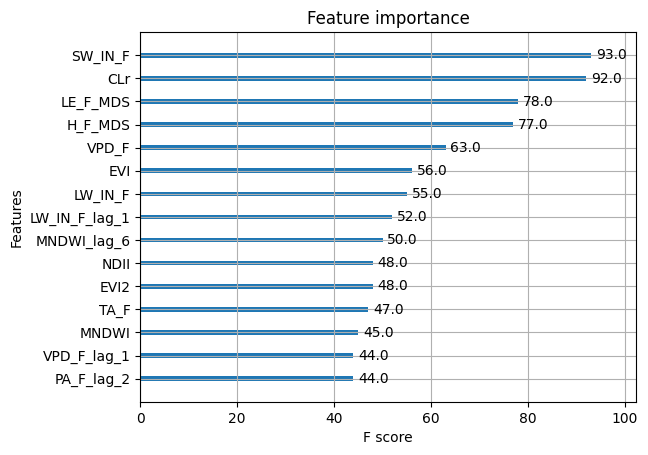

Estrees-Mons A28
Retesting the model on the first, second, and third site
Mean Squared Error: 8.677563789876656
Root Mean Squared Error: 2.945770491718025
MAE: 2.2332212522390025
Test R^2 Score: 0.5363697441480582


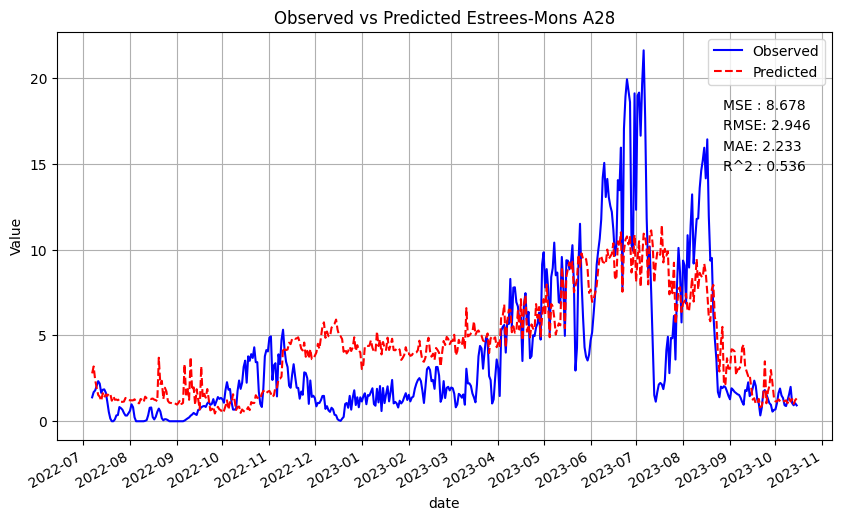

Hohes Holz
Mean Squared Error: 7.718649367138494
Root Mean Squared Error: 2.778245735556611
MAE: 2.1393336448091502
Test R^2 Score: 0.7398733444814702


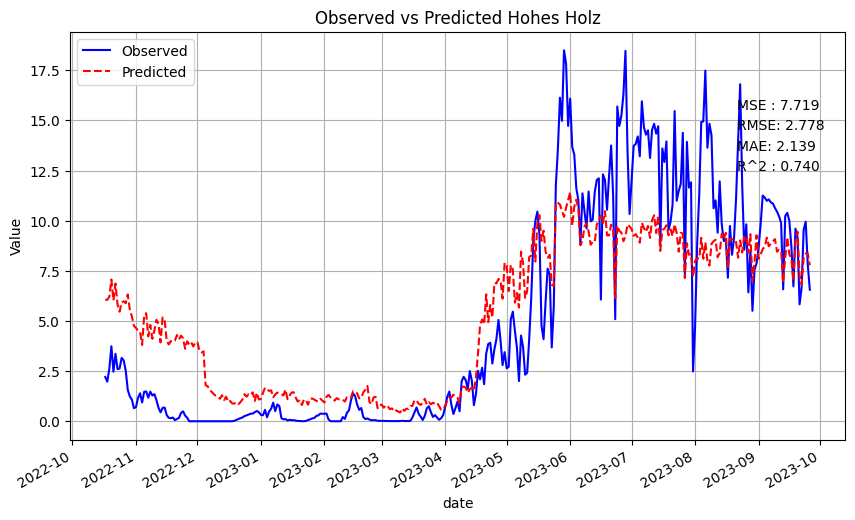

Hyytiala
Mean Squared Error: 6.573126008195407
Root Mean Squared Error: 2.5638108370539756
MAE: 2.1288481534912096
Test R^2 Score: 0.4016987246278353


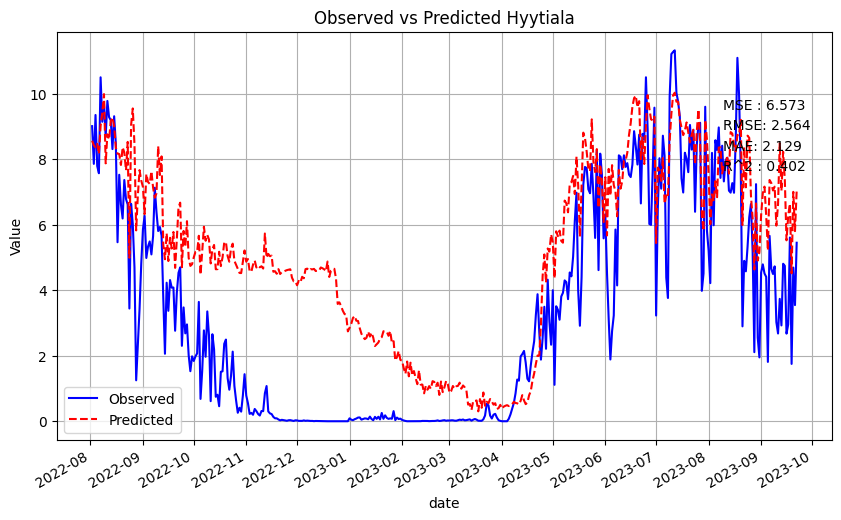

Torgnon
Mean Squared Error: 1.0853996011786815
Root Mean Squared Error: 1.0418251298460224
MAE: 0.6015599930791189
Test R^2 Score: 0.876410074144295


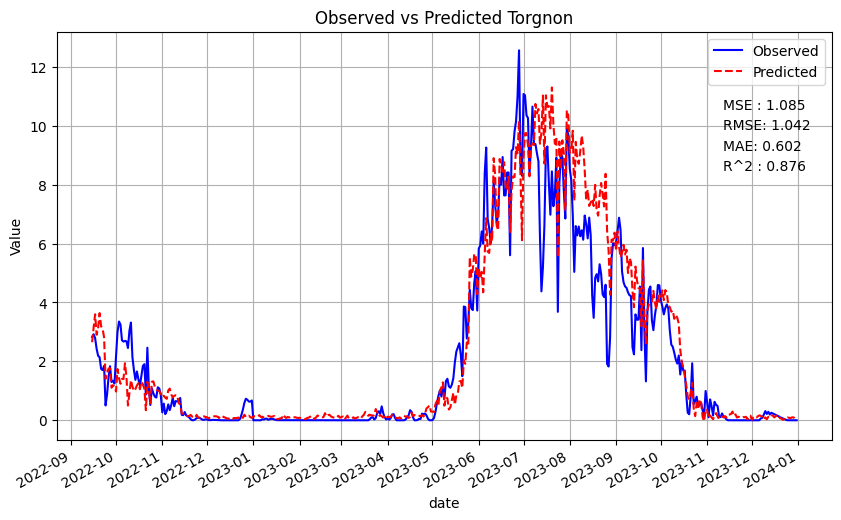

average MSE 6.013684691597309
average RMSE 2.3324130485436587
average MAE 1.7757407609046203
average R2 0.6385879718504146


C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 7.3755917536273055
Root Mean Squared Error: 2.7158040712885207
MAE: 2.2394345895916223
Test R^2 Score: 0.6510905077181335


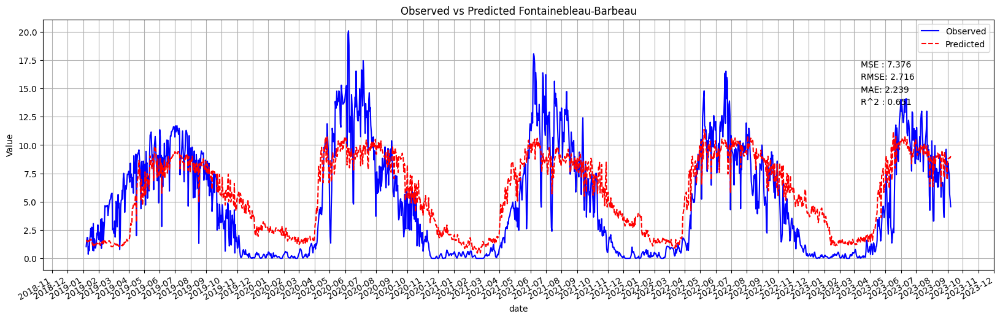

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 8.279148767229382
Root Mean Squared Error: 2.8773509982672225
MAE: 2.3338577687462645
Test R^2 Score: 0.4477783935624695


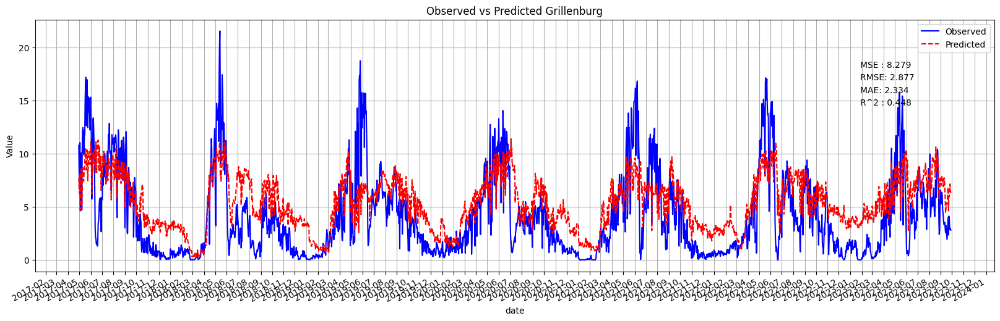

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 7.8275885263859495
Root Mean Squared Error: 2.797782787563386
MAE: 1.8041099738649884
Test R^2 Score: 0.5640383094132047


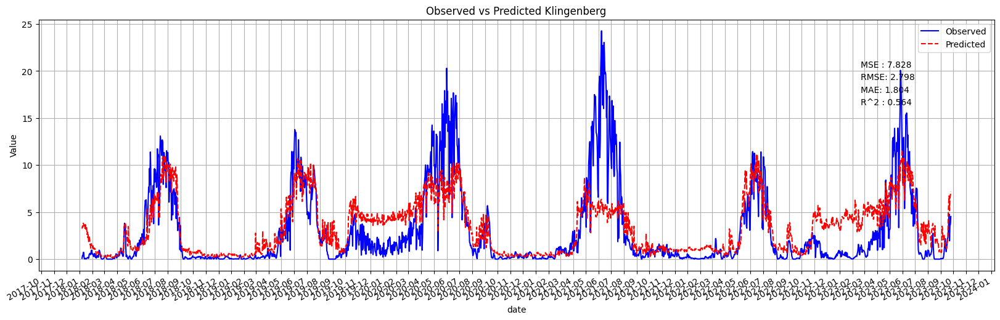

C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[f'{column}_lag_{i}'] = df[column].shift(i)
C:\Users\karisma\AppData\Local\Temp\ipykernel_22840\1233196204.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perform

Mean Squared Error: 16.300401092319806
Root Mean Squared Error: 4.037375520349799
MAE: 3.6294604294426365
Test R^2 Score: -0.37409315018649725


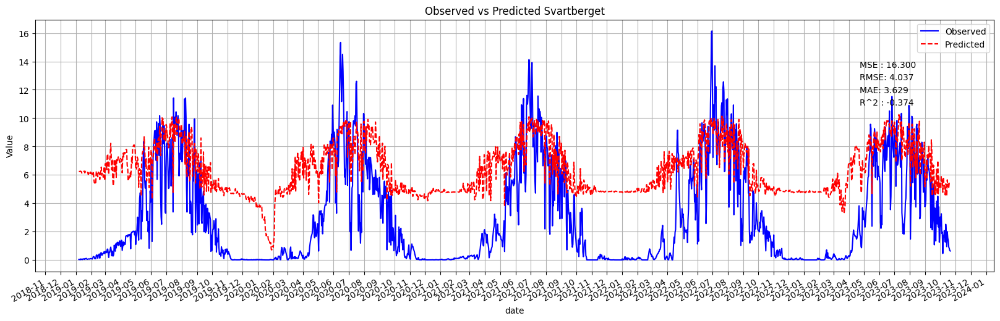

average MSE 9.945682534890611
average RMSE 3.107078344367232
average MAE 2.5017156904113778
average R2 0.3222035151268276


In [65]:
target_col = 'GPP_DT_VUT_USTAR50'
# Number of lag features
L = 7  # For example, create lag features for the previous 3 time points
column = col2
eta = 0.1
max_depth = 6
min_child_weight = 5
gamma = 0.1
alpha = 0.1 
files =['Estrees-Mons A28_preprocessed_26052017_15102023.csv',
 'Hohes Holz_preprocessed_01012019_26092023.csv',
 'Hyytiala_preprocessed_01012018_22092023.csv',
 'Torgnon_preprocessed_06072017_31122023.csv']



params = f"eta_{eta}_max_depth_{max_depth}_min_child_weight_{min_child_weight}_gamma_{gamma}_alpha_{alpha}_L_{L}_{col_name}"
model, features = retrain_XGBOOST(files,column, L, target_col, eta, max_depth, min_child_weight, gamma, alpha,plot_directory, params)
predict_all(model,params,L,column)

Coba kalau dicopy juga column yg static, udh dicoba tapi gak ngaruh kar